## Practical Work 1

For this practical work, the trainees will develop a Python program that is able to implement the gradient descent in order to achieve the linear regression (Single and Multivariables) of a set of datapoints.

#### Import numpy, matplotlib.pyplot and any library you will need

In [84]:
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns
from numpy.linalg import norm
from sklearn.metrics import r2_score
%matplotlib inline

#### Read RegData csv file into numpy array 

In [60]:
data = np.genfromtxt('RegData.csv',delimiter=',')

In [3]:
data

array([[2.9000001 , 4.        ],
       [6.69999981, 7.4000001 ],
       [4.9000001 , 5.        ],
       [7.9000001 , 7.19999981],
       [9.80000019, 7.9000001 ],
       [6.9000001 , 6.0999999 ],
       [6.0999999 , 6.        ],
       [6.19999981, 5.80000019],
       [6.        , 5.19999981],
       [5.0999999 , 4.19999981],
       [4.69999981, 4.        ],
       [4.4000001 , 4.4000001 ],
       [5.80000019, 5.19999981]])

#### Define variables X and y. 
#### Assign first column data to X and second column to y
<b>Note:</b> X is the independent variable (input to LR model) and y is the dependent variable (output)

In [61]:
X=data[:,0]
y=data[:,1]

#### Explore your data

In [62]:
X

array([2.9000001 , 6.69999981, 4.9000001 , 7.9000001 , 9.80000019,
       6.9000001 , 6.0999999 , 6.19999981, 6.        , 5.0999999 ,
       4.69999981, 4.4000001 , 5.80000019])

In [16]:
y

array([4.        , 7.4000001 , 5.        , 7.19999981, 7.9000001 ,
       6.0999999 , 6.        , 5.80000019, 5.19999981, 4.19999981,
       4.        , 4.4000001 , 5.19999981])

In [5]:
X

array([2.9000001 , 6.69999981, 4.9000001 , 7.9000001 , 9.80000019,
       6.9000001 , 6.0999999 , 6.19999981, 6.        , 5.0999999 ,
       4.69999981, 4.4000001 , 5.80000019])

In [6]:
y

array([4.        , 7.4000001 , 5.        , 7.19999981, 7.9000001 ,
       6.0999999 , 6.        , 5.80000019, 5.19999981, 4.19999981,
       4.        , 4.4000001 , 5.19999981])

#### Plot the original data (scatter plot of X,y)

Text(0, 0.5, 'y')

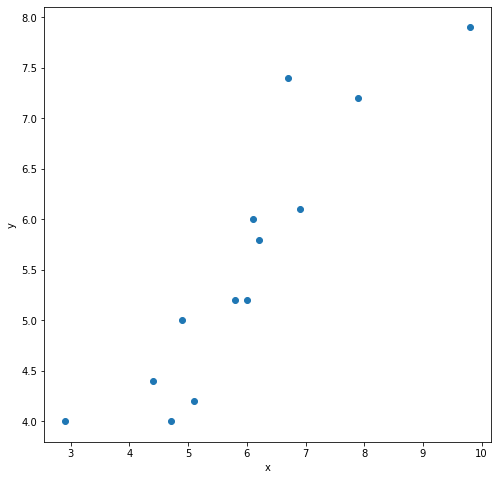

In [24]:
plt.figure(figsize=(8,8))
plt.scatter(X,y)
plt.xlabel('x')
plt.ylabel('y')

Text(0, 0.5, 'y')

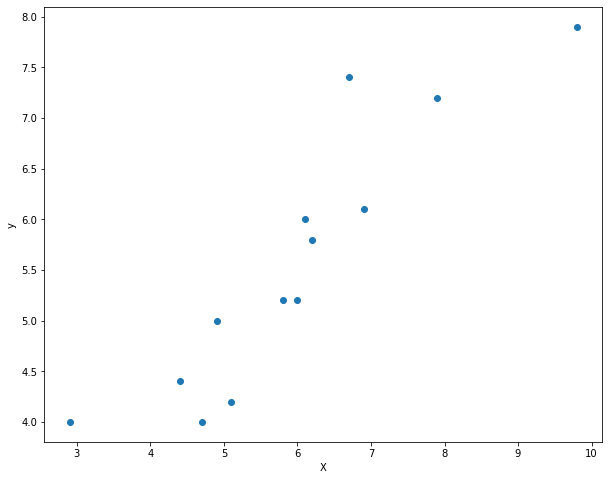

## LR Full Implementation

### Step1: Initialize parameters (theta_0 & theta_1) with random value or simply zero. Also choose the Learning rate.

In [63]:
theta_0=0
theta_1=0
learning_rate=0.01

### Step2: Use (theta_0 & theta_1) to predict the output h(x)= theta_0 + theta_1 * x.

In [64]:
h=theta_0 + theta_1 * X
print("h(x):",h)

h(x): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


### Step3: Calculate the MSE Cost function 𝑱(theta_0,theta_1 ).
<b>Note:</b> You better use either dot product or norm square of the error vector.

In [65]:
error_vector=(h-y)
print("Error Vector:\n",error_vector)
j=np.sum(error_vector**2)/(2*X.shape[0])
print("j= ",j)

Error Vector:
 [-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]
j=  16.305384479692318


In [66]:
#another solution
j=norm(error_vector)**2/(2*X.shape[0])
print("j= ",j)

j=  16.305384479692314


Error Vector:
[-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]

j = 16.305384479692318


### Step4: Calculate the gradient components for theta_0 and theta_1.
<b>Note:</b> You can use the error vector calculated in the previous step.

In [67]:
d_theta_0=np.sum(error_vector)/(X.shape[0])
print("d_theta_0",d_theta_0)

d_theta_0 -5.56923073976923


In [68]:
d_theta_1=np.sum(error_vector*X)/(X.shape[0])
print("d_theta_1",d_theta_1)

d_theta_1 -35.043846043215375


d_theta_0 : -5.56923073976923
d_theta_1 : -35.04384604321538


### Step5: Update the parameters (simultaneously).

In [69]:
theta_0=theta_0-learning_rate*d_theta_0
print("theta_0_new: ",theta_0)

theta_0_new:  0.0556923073976923


In [70]:
theta_1=theta_1-learning_rate*d_theta_1
print("theta_1_new: ",theta_1)

theta_1_new:  0.35043846043215376


theta_0_new : 0.0005569230739769231
theta_1_new : 0.0035043846043215383


### Step6: Repeat from 2 to 5 until converge to the minimum or achieve maximum iterations.
#### The objective from this step is to combine all the previous steps and iterate untill you either achieve the maximum number of iterations or reach the minimum.

In [73]:
def gradient_descent (X,y,num_of_iterations):
    theta_0=0
    theta_1=0
    learning_rate=0.01
    for i in range(0,num_of_iterations):
        print(f"****************** Iteration {i} ********************")
        h=theta_0 + theta_1 * X
        print("h(x): ",h)
        error_vector=(h-y)
        print("Error Vector:\n",error_vector)
        j=norm(error_vector)**2/(2*X.shape[0])
        print("j= ",j)
        d_theta_0=np.sum(error_vector)/(X.shape[0])
        d_theta_1=np.sum(error_vector*X)/(X.shape[0])
        Gradient_Vector=np.array([[d_theta_0],[d_theta_1]])
        print("Gradient Vector:\n",Gradient_Vector)
        Gradient_Vector_Norm=norm(Gradient_Vector)
        print("Gradient Vector Norm:\n",Gradient_Vector_Norm)
        if Gradient_Vector_Norm <0.01:
            break
        theta_0=theta_0-learning_rate*d_theta_0
        print("theta_0_new : ",theta_0)
        theta_1=theta_1-learning_rate*d_theta_1
        print("theta_1_new : ",theta_1)
        
    return h , error_vector , j,Gradient_Vector,Gradient_Vector_Norm,theta_0,theta_1
            
    
    
    

In [74]:
gradient_descent (X,y,1000)

****************** Iteration 0 ********************
h(x):  [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
Error Vector:
 [-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]
j=  16.305384479692314
Gradient Vector:
 [[ -5.56923074]
 [-35.04384604]]
Gradient Vector Norm:
 35.483622652335995
theta_0_new :  0.0556923073976923
theta_1_new :  0.35043846043215376
****************** Iteration 1 ********************
h(x):  [1.07196388 2.40362993 1.7728408  2.82415618 3.48998929 2.47371772
 2.19336688 2.2284107  2.15832307 1.84292842 1.702753   1.59762157
 2.08823544]
Error Vector:
 [-2.92803612 -4.99637017 -3.2271592  -4.37584363 -4.41001081 -3.62628219
 -3.80663312 -3.5715895  -3.04167674 -2.35707139 -2.297247   -2.80237853
 -3.11176436]
j=  6.175608808043304
Gradient Vector:
 [[ -3.42708175]
 [-21.33845263]]
Gradient Vector Norm:
 21.611905283072655
theta_0_new :  0.08996312489803082
theta_1_new

Gradient Vector:
 [[-0.08571033]
 [ 0.0133961 ]]
Gradient Vector Norm:
 0.08675088941160526
theta_0_new :  0.20071965536875203
theta_1_new :  0.8873021115887886
****************** Iteration 69 ********************
h(x):  [2.77389586 6.14564363 4.54850009 7.21040642 8.89628052 6.32310431
 5.61326245 5.70199258 5.52453232 4.72596034 4.37103941 4.10484903
 5.34707207]
Error Vector:
 [-1.22610414 -1.25435646 -0.45149991  0.01040661  0.99628042  0.2231044
 -0.38673755 -0.09800761  0.32453252  0.52596053  0.37103941 -0.29515106
  0.14707226]
j=  0.19656131217549933
Gradient Vector:
 [[-0.08565081]
 [ 0.0133868 ]]
Gradient Vector Norm:
 0.08669064668574204
theta_0_new :  0.20157616350477325
theta_1_new :  0.887168243612003
****************** Iteration 70 ********************
h(x):  [2.77436415 6.14560323 4.54870064 7.21020537 8.89582512 6.32303713
 5.61330237 5.7020191  5.52458563 4.72613412 4.37126674 4.10511652
 5.34715215]
Error Vector:
 [-1.22563585 -1.25439687 -0.45129936  0.01020556  0.

h(x):  [2.8107928  6.14245992 4.56430194 7.19456565 8.86039942 6.31781108
 5.61640726 5.70408263 5.52873189 4.73965269 4.38895078 4.12592466
 5.35338114]
Error Vector:
 [-1.1892072  -1.25754018 -0.43569806 -0.00543416  0.96039932  0.21781118
 -0.38359274 -0.09591756  0.32873208  0.53965288  0.38895078 -0.27407544
  0.15338133]
j=  0.19080197736963941
Gradient Vector:
 [[-0.08096444]
 [ 0.01265434]]
Gradient Vector Norm:
 0.08194738061410096
theta_0_new :  0.2690141142855544
theta_1_new :  0.8766280261290013
****************** Iteration 151 ********************
h(x):  [2.81123547 6.14242172 4.56449153 7.1943756  8.85996894 6.31774758
 5.61644499 5.70410771 5.52878227 4.73981696 4.38916567 4.12617751
 5.35345683]
Error Vector:
 [-1.18876453 -1.25757837 -0.43550847 -0.00562421  0.95996884  0.21774767
 -0.38355501 -0.09589248  0.32878246  0.53981716  0.38916567 -0.27382258
  0.15345702]
j=  0.19073484695464554
Gradient Vector:
 [[-0.08090822]
 [ 0.01264555]]
Gradient Vector Norm:
 0.081890

 0.07784124324868617
theta_0_new :  0.3273936117384908
theta_1_new :  0.867503600007238
****************** Iteration 225 ********************
h(x):  [2.84315413 6.13966757 4.57816133 7.18067213 8.82892906 6.31316853
 5.61916549 5.70591577 5.53241521 4.75166189 4.40466037 4.14440953
 5.35891466]
Error Vector:
 [-1.15684587 -1.26033253 -0.42183867 -0.01932767  0.92892896  0.21316863
 -0.38083451 -0.09408442  0.3324154   0.55166208  0.40466037 -0.25559056
  0.15891485]
j=  0.18601731044903888
Gradient Vector:
 [[-0.07685415]
 [ 0.01201192]]
Gradient Vector Norm:
 0.07778718767980737
theta_0_new :  0.32816215323256315
theta_1_new :  0.8673834807806238
****************** Iteration 226 ********************
h(x):  [2.84357433 6.13963131 4.57834129 7.18049173 8.82852043 6.31310825
 5.6192013  5.70593957 5.53246304 4.75181782 4.40486435 4.14464955
 5.35898651]
Error Vector:
 [-1.15642567 -1.26036879 -0.42165871 -0.01950808  0.92852034  0.21310835
 -0.3807987  -0.09406062  0.33246323  0.55181801

 [[-0.07285124]
 [ 0.01138629]]
Gradient Vector Norm:
 0.07373567792390451
theta_0_new :  0.38576497613553823
theta_1_new :  0.8583804450418027
****************** Iteration 303 ********************
h(x):  [2.87506835 6.13691379 4.59182924 7.16697057 8.7978935  6.30859013
 5.62188561 5.70772357 5.53604765 4.76350516 4.4201529  4.16263902
 5.36437172]
Error Vector:
 [-1.12493165 -1.2630863  -0.40817076 -0.03302924  0.89789341  0.20859022
 -0.37811439 -0.09227662  0.33604784  0.56350536  0.4201529  -0.23736108
  0.16437191]
j=  0.18154283646677338
Gradient Vector:
 [[-0.07280065]
 [ 0.01137838]]
Gradient Vector Norm:
 0.07368447339722309
theta_0_new :  0.3864929825973188
theta_1_new :  0.8582666612398431
****************** Iteration 304 ********************
h(x):  [2.87546638 6.13687945 4.5919997  7.16679969 8.79750643 6.30853303
 5.62191953 5.70774612 5.53609295 4.76365287 4.42034613 4.16286637
 5.36443978]
Error Vector:
 [-1.12453362 -1.26312065 -0.4080003  -0.03320012  0.89750633  0.20

 5.36954096]
Error Vector:
 [-1.09470068 -1.26569483 -0.39522374 -0.04600814  0.86849475  0.2042533
 -0.37553774 -0.09056416  0.33948869  0.57472398  0.43482832 -0.22009307
  0.16954116]
j=  0.1775279079740996
Gradient Vector:
 [[-0.06896094]
 [ 0.01077825]]
Gradient Vector Norm:
 0.06979814776406272
theta_0_new :  0.44174728054491014
theta_1_new :  0.8496306883122047
****************** Iteration 382 ********************
h(x):  [2.90567636 6.13427273 4.60493773 7.1538298  8.76812819 6.30419911
 5.6244944  5.70945739 5.53953141 4.77486371 4.43501135 4.18012239
 5.36960544]
Error Vector:
 [-1.09432364 -1.26572737 -0.39506227 -0.04617001  0.86812809  0.20419921
 -0.3755056  -0.09054281  0.3395316   0.5748639   0.43501135 -0.21987771
  0.16960563]
j=  0.1774792070754284
Gradient Vector:
 [[-0.06891305]
 [ 0.01077077]]
Gradient Vector Norm:
 0.06974967759032683
theta_0_new :  0.4424364110177457
theta_1_new :  0.8495229806346469
****************** Iteration 383 ********************
h(x):  [2

  0.17437665]
j=  0.1739690877888619
Gradient Vector:
 [[-0.06536914]
 [ 0.01021687]]
Gradient Vector Norm:
 0.06616274346362609
theta_0_new :  0.49343407453415583
theta_1_new :  0.8415522985726243
****************** Iteration 459 ********************
h(x):  [2.93393582 6.13183431 4.61704042 7.14169731 8.74064676 6.30014501
 5.62690302 5.71105816 5.54274787 4.78535072 4.44872972 4.19626427
 5.37443757]
Error Vector:
 [-1.06606418 -1.26816578 -0.38295958 -0.0583025   0.84064667  0.20014511
 -0.37309698 -0.08894203  0.34274806  0.58535091  0.44872972 -0.20373583
  0.17443776]
j=  0.17392532790207918
Gradient Vector:
 [[-0.06532374]
 [ 0.01020978]]
Gradient Vector Norm:
 0.06611679783651052
theta_0_new :  0.4940873119644858
theta_1_new :  0.8414502007997234
****************** Iteration 460 ********************
h(x):  [2.93429297 6.1318035  4.61719338 7.14154398 8.74029944 6.30009378
 5.62693346 5.7110784  5.54278852 4.78548326 4.4489031  4.19646828
 5.37449864]
Error Vector:
 [-1.06570703

  0.17867003]
j=  0.17096875464274544
Gradient Vector:
 [[-0.06218002]
 [ 0.00971843]]
Gradient Vector Norm:
 0.06293490477100104
theta_0_new :  0.5393262559116673
theta_1_new :  0.8343795780660245
****************** Iteration 531 ********************
h(x):  [2.95902711 6.12966927 4.62778627 7.130925   8.71624628 6.29654542
 5.6290416  5.71247948 5.54560372 4.79466202 4.46091011 4.21059648
 5.37872797]
Error Vector:
 [-1.04097289 -1.27033083 -0.37221373 -0.06907481  0.81624619  0.19654552
 -0.3709584  -0.08752071  0.34560392  0.59466222  0.46091011 -0.18940362
  0.17872816]
j=  0.17092916037292943
Gradient Vector:
 [[-0.06213684]
 [ 0.00971168]]
Gradient Vector Norm:
 0.06289120066328448
theta_0_new :  0.5399476242727491
theta_1_new :  0.8342824612707033
****************** Iteration 532 ********************
h(x):  [2.95936684 6.12963996 4.62793176 7.13077915 8.7159159  6.29649669
 5.62907056 5.71249872 5.54564239 4.7947881  4.46107503 4.21079053
 5.37878606]
Error Vector:
 [-1.04063316

 [ 0.00920585]]
Gradient Vector Norm:
 0.059615541513649346
theta_0_new :  0.5865196986980994
theta_1_new :  0.827003476850292
****************** Iteration 609 ********************
h(x):  [2.98482986 6.12744284 4.63883681 7.11984724 8.69115393 6.29284377
 5.63124083 5.7139411  5.54854056 4.80423735 4.47343588 4.22533508
 5.38314002]
Error Vector:
 [-1.01517014 -1.27255726 -0.36116319 -0.08015256  0.79115383  0.19284386
 -0.36875917 -0.08605909  0.34854075  0.60423754  0.47343588 -0.17466502
  0.18314021]
j=  0.16800429676749037
Gradient Vector:
 [[-0.05885957]
 [ 0.00919946]]
Gradient Vector Norm:
 0.059574142483057695
theta_0_new :  0.5871082943503869
theta_1_new :  0.826911482266933
****************** Iteration 610 ********************
h(x):  [2.98515167 6.12741507 4.63897464 7.11970908 8.69084098 6.2927976
 5.63126826 5.71395933 5.54857719 4.80435678 4.4735921  4.22551889
 5.38319505]
Error Vector:
 [-1.01484833 -1.27258503 -0.36102536 -0.08029073  0.79084088  0.1927977
 -0.36873174

  0.1872674 ]
j=  0.1654117067233346
Gradient Vector:
 [[-0.05579389]
 [ 0.00872031]]
Gradient Vector Norm:
 0.05647125077725171
theta_0_new :  0.631224027048858
theta_1_new :  0.8200164118847468
****************** Iteration 687 ********************
h(x):  [3.0092717  6.12533383 4.64930452 7.10935376 8.66738502 6.28933735
 5.63332406 5.71532562 5.5513225  4.81330765 4.48530101 4.23929632
 5.38731937]
Error Vector:
 [-0.9907283  -1.27466626 -0.35069548 -0.09064605  0.76738493  0.18933744
 -0.36667594 -0.08467457  0.35132269  0.61330784  0.48530101 -0.16070378
  0.18731956]
j=  0.1653798277744412
Gradient Vector:
 [[-0.05575515]
 [ 0.00871425]]
Gradient Vector Norm:
 0.056432035247557376
theta_0_new :  0.631781578516861
theta_1_new :  0.8199292693535358
****************** Iteration 688 ********************
h(x):  [3.00957654 6.12530753 4.64943508 7.10922288 8.66708857 6.28929361
 5.63335004 5.71534289 5.55135719 4.81342077 4.48544899 4.23947044
 5.3873715 ]
Error Vector:
 [-0.99042346 -1

 5.39112996]
Error Vector:
 [-0.96844308 -1.27658918 -0.34115138 -0.10021365  0.74571326  0.18614041
 -0.36477652 -0.0834122   0.35385916  0.62157782  0.49611922 -0.1479744
  0.19113015]
j=  0.1631108356685313
Gradient Vector:
 [[-0.05292465]
 [ 0.00827186]]
Gradient Vector Norm:
 0.053567170592392216
theta_0_new :  0.6725131332495224
theta_1_new :  0.813563129215342
****************** Iteration 763 ********************
h(x):  [3.03184629 6.12338594 4.65897254 7.09966193 8.64543195 6.2860988
 5.63524814 5.71660438 5.55389191 4.82168501 4.49625969 4.25219098
 5.39117944]
Error Vector:
 [-0.96815371 -1.27661415 -0.34102746 -0.10033788  0.74543186  0.1860989
 -0.36475186 -0.08339581  0.3538921   0.62168521  0.49625969 -0.14780912
  0.19117963]
j=  0.16308215121406144
Gradient Vector:
 [[-0.05288789]
 [ 0.00826612]]
Gradient Vector Norm:
 0.05352997175333526
theta_0_new :  0.6730420121779946
theta_1_new :  0.813480468059958
****************** Iteration 764 ********************
h(x):  [3.03

j=  0.1608606083281809
Gradient Vector:
 [[-0.04995942]
 [ 0.00780841]]
Gradient Vector Norm:
 0.0505659480759837
theta_0_new :  0.7151833721285548
theta_1_new :  0.8068939823532335
****************** Iteration 846 ********************
h(x):  [3.055176   6.1213729  4.66896396 7.08964591 8.62274455 6.28275193
 5.63723659 5.71792591 5.55654727 4.83034261 4.50758494 4.26551697
 5.39516862]
Error Vector:
 [-0.944824   -1.2786272  -0.33103604 -0.1103539   0.72274446  0.18275202
 -0.36276341 -0.08207428  0.35654746  0.6303428   0.50758494 -0.13448312
  0.19516881]
j=  0.16083504805517032
Gradient Vector:
 [[-0.04992473]
 [ 0.00780299]]
Gradient Vector Norm:
 0.05053083338645571
theta_0_new :  0.7156826194126629
theta_1_new :  0.8068159524770084
****************** Iteration 847 ********************
h(x):  [3.05544896 6.12134935 4.66908086 7.08952872 8.62247911 6.28271277
 5.63725985 5.71794137 5.55657833 4.8304439  4.50771744 4.26567289
 5.3952153 ]
Error Vector:
 [-0.94455104 -1.27865075 -0.

 [-0.92409242 -1.28041606 -0.32215732 -0.11925448  0.70258365  0.17977787
 -0.36099641 -0.08089993  0.3589071   0.63803623  0.51764894 -0.12264119
  0.19871374]
j=  0.1589468881618202
Gradient Vector:
 [[-0.04729156]
 [ 0.00739144]]
Gradient Vector Norm:
 0.04786569561725321
theta_0_new :  0.7535745333362897
theta_1_new :  0.8008936341239417
****************** Iteration 925 ********************
h(x):  [3.07616615 6.11956173 4.67795342 7.08063432 8.6023323  6.27974068
 5.63902563 5.71911491 5.55893634 4.83813199 4.51777446 4.2775066
 5.39875776]
Error Vector:
 [-0.92383385 -1.28043837 -0.32204658 -0.11936549  0.70233221  0.17974078
 -0.36097437 -0.08088528  0.35893653  0.63813218  0.51777446 -0.1224935
  0.19875796]
j=  0.15892398486882017
Gradient Vector:
 [[-0.04725872]
 [ 0.0073863 ]]
Gradient Vector Norm:
 0.0478324560735565
theta_0_new :  0.7540471205110213
theta_1_new :  0.800819771090684
****************** Iteration 926 ********************
h(x):  [3.07642453 6.11953943 4.6780640

h(x):  [3.09480993 6.11795302 4.68593799 7.07263008 8.58420182 6.27706605
 5.64061468 5.720171   5.56105835 4.84505065 4.52682496 4.28815597
 5.40194569]
Error Vector:
 [-0.90519007 -1.28204708 -0.31406201 -0.12736973  0.68420172  0.17706615
 -0.35938532 -0.07982919  0.36105854  0.64505084  0.52682496 -0.11184412
  0.20194589]
j=  0.15731447417481756
Gradient Vector:
 [[-0.04489072]
 [ 0.0070162 ]]
Gradient Vector Norm:
 0.045435715217517485
theta_0_new :  0.7881230693282719
theta_1_new :  0.7954938691717329


(array([3.09480993, 6.11795302, 4.68593799, 7.07263008, 8.58420182,
        6.27706605, 5.64061468, 5.720171  , 5.56105835, 4.84505065,
        4.52682496, 4.28815597, 5.40194569]),
 array([-0.90519007, -1.28204708, -0.31406201, -0.12736973,  0.68420172,
         0.17706615, -0.35938532, -0.07982919,  0.36105854,  0.64505084,
         0.52682496, -0.11184412,  0.20194589]),
 0.15731447417481756,
 array([[-0.04489072],
        [ 0.0070162 ]]),
 0.045435715217517485,
 0.7881230693282719,
 0.7954938691717329)

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Error Vector:
[-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]

j = 16.305384479692318

Gradient Vector:
[[ -5.56923074]
 [-35.04384604]]

Gradient Vector Norm:
35.483622652336

theta_0_new : 0.0556923073976923
theta_1_new : 0.3504384604321538

****************** Iteration 1 ********************

h(x):[1.07196388 2.40362993 1.7728408  2.82415618 3.48998929 2.47371772
 2.19336688 2.2284107  2.15832307 1.84292842 1.702753   1.59762157
 2.08823544]

Error Vector:
[-2.92803612 -4.99637017 -3.2271592  -4.37584363 -4.41001081 -3.62628219
 -3.80663312 -3.5715895  -3.04167674 -2.35707139 -2.297247   -2.80237853
 -3.11176436]

j = 6.175608808043303

Gradient Vector:
[[ -3.42708175]
 [-21.33845263]]

Gradient Vector Norm:
21.61190528307266

theta_0_new : 0.08996312489803082
theta_1_new : 0.


Gradient Vector:
[[-0.07595188]
 [ 0.0118709 ]]

Gradient Vector Norm:
0.07687396510683078

theta_0_new : 0.3411460040218954
theta_1_new : 0.865354169250514

****************** Iteration 243 ********************

h(x):[2.85067318 6.13901877 4.58138152 7.17744402 8.82161703 6.31208985
 5.61980635 5.70634169 5.53327102 4.75445218 4.40831043 4.14870443
 5.36020035]

Error Vector:
[-1.14932682 -1.26098132 -0.41861848 -0.02255579  0.92161693  0.21208995
 -0.38019365 -0.0936585   0.33327121  0.55445238  0.40831043 -0.25129566
  0.16020054]

j = 0.1849412905091068

Gradient Vector:
[[-0.07589914]
 [ 0.01186266]]

Gradient Vector Norm:
0.0768205812483209

theta_0_new : 0.34190499539372793
theta_1_new : 0.8652355426606753

****************** Iteration 244 ********************

h(x):[2.85108815 6.13898297 4.58155924 7.17726586 8.82121348 6.31203032
 5.61984172 5.70636519 5.53331825 4.75460618 4.40851188 4.14894147
 5.36027131]

Error Vector:
[-1.14891185 -1.26101713 -0.41844076 -0.02273394  0.9


j = 0.17293544955013765

Gradient Vector:
[[-0.06428833]
 [ 0.01004795]]

Gradient Vector Norm:
0.06506880983740468

theta_0_new : 0.5089872062641313
theta_1_new : 0.8391214211649073

****************** Iteration 483 ********************

h(x):[2.94243941 6.13110057 4.62068225 7.13804651 8.73237729 6.29892509
 5.6276278  5.71153986 5.54371573 4.78850637 4.45285773 4.20112154
 5.37589161]

Error Vector:
[-1.05756059 -1.26889953 -0.37931775 -0.0619533   0.8323772   0.19892519
 -0.3723722  -0.08846033  0.34371592  0.58850657  0.45285773 -0.19887856
  0.1758918 ]

j = 0.17289312475098512

Gradient Vector:
[[-0.06424368]
 [ 0.01004097]]

Gradient Vector Norm:
0.06502362387447248

theta_0_new : 0.5096296430783813
theta_1_new : 0.8390210114747716

****************** Iteration 484 ********************

h(x):[2.94279066 6.13107026 4.62083268 7.13789571 8.73203572 6.2988747
 5.62765773 5.71155975 5.54375571 4.78863672 4.45302824 4.20132217
 5.37595167]

Error Vector:
[-1.05720934 -1.26892984 -0

Gradient Vector Norm:
0.05519141445441589

theta_0_new : 0.6494202525279396
theta_1_new : 0.8171724320232779

****************** Iteration 720 ********************

h(x):[3.01922038 6.12447539 4.65356525 7.10508254 8.65771024 6.28791011
 5.63417201 5.71588917 5.55245484 4.81699958 4.49013053 4.24497903
 5.38902051]

Error Vector:
[-0.98077962 -1.2755247  -0.34643475 -0.09491727  0.75771015  0.18791021
 -0.36582799 -0.08411102  0.35245504  0.61699977  0.49013053 -0.15502106
  0.18902071]

j = 0.16435228866588872

Gradient Vector:
[[-0.05449154]
 [ 0.00851676]]

Gradient Vector Norm:
0.05515308768596957

theta_0_new : 0.6499651679269556
theta_1_new : 0.817087264447025

****************** Iteration 721 ********************

h(x):[3.01951831 6.12444968 4.65369284 7.10495463 8.65742052 6.28786737
 5.6341974  5.71590605 5.55248875 4.81711014 4.49027515 4.24514921
 5.38907146]

Error Vector:
[-0.98048169 -1.27555041 -0.34630716 -0.09504517  0.75742042  0.18786747
 -0.3658026  -0.08409414  0.3


Gradient Vector Norm:
0.046071381693519056

theta_0_new : 0.7790854054329481
theta_1_new : 0.7969064112477022

****************** Iteration 980 ********************

h(x):[3.09011407 6.11835821 4.6839269  7.07464613 8.58876839 6.27773972
 5.64021444 5.719905   5.56052387 4.84330803 4.52454539 4.28547369
 5.40114274]

Error Vector:
[-0.90988593 -1.28164189 -0.3160731  -0.12535368  0.68876829  0.17773981
 -0.35978556 -0.08009519  0.36052406  0.64330822  0.52454539 -0.1145264
  0.20114293]

j = 0.15771207196409032

Gradient Vector:
[[-0.04548716]
 [ 0.00710942]]

Gradient Vector Norm:
0.046039388181563945

theta_0_new : 0.7795402770028638
theta_1_new : 0.7968353170756783

****************** Iteration 981 ********************

h(x):[3.09036277 6.11833675 4.68403341 7.07453936 8.58852654 6.27770404
 5.64023564 5.71991909 5.56055218 4.84340032 4.52466612 4.28561575
 5.40118527]

Error Vector:
[-0.90963723 -1.28166335 -0.31596659 -0.12546045  0.68852644  0.17770414
 -0.35976436 -0.0800811   

In [75]:
def gradient_descent (X,y,num_of_iterations):
    theta_0=0
    theta_1=0
    learning_rate=0.01
    for i in range(0,num_of_iterations):
        print(f"****************** Iteration {i} ********************")
        h=theta_0 + theta_1 * X
        print("h(x): ",h)
        error_vector=(h-y)
        print("Error Vector:\n",error_vector)
        j=norm(error_vector)**2/(2*X.shape[0])
        print("j= ",j)
        d_theta_0=np.sum(error_vector)/(X.shape[0])
        d_theta_1=np.sum(error_vector*X)/(X.shape[0])
        Gradient_Vector=np.array([[d_theta_0],[d_theta_1]])
        print("Gradient Vector:\n",Gradient_Vector)
        Gradient_Vector_Norm=norm(Gradient_Vector)
        print("Gradient Vector Norm:\n",Gradient_Vector_Norm)
        if Gradient_Vector_Norm <0.1:
            break
        theta_0=theta_0-learning_rate*d_theta_0
        print("theta_0_new : ",theta_0)
        theta_1=theta_1-learning_rate*d_theta_1
        print("theta_1_new : ",theta_1)
        
    return h , error_vector , j,Gradient_Vector,Gradient_Vector_Norm,theta_0,theta_1
            

In [76]:
h , error_vector , j,Gradient_Vector,Gradient_Vector_Norm,theta_0,theta_1=gradient_descent (X,y,20)
print("****************** Training Report ********************")
print("Gradient Descent converged after 14 iterations")
print("theta_0_Opt :",theta_0)
print("theta_1_Opt :",theta_1)
print("Error Vector:\n",error_vector)
print('Cost =',j)
print("h(x) = y_predict:\n",h)
print("y_actual:\n",y)

****************** Iteration 0 ********************
h(x):  [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
Error Vector:
 [-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]
j=  16.305384479692314
Gradient Vector:
 [[ -5.56923074]
 [-35.04384604]]
Gradient Vector Norm:
 35.483622652335995
theta_0_new :  0.0556923073976923
theta_1_new :  0.35043846043215376
****************** Iteration 1 ********************
h(x):  [1.07196388 2.40362993 1.7728408  2.82415618 3.48998929 2.47371772
 2.19336688 2.2284107  2.15832307 1.84292842 1.702753   1.59762157
 2.08823544]
Error Vector:
 [-2.92803612 -4.99637017 -3.2271592  -4.37584363 -4.41001081 -3.62628219
 -3.80663312 -3.5715895  -3.04167674 -2.35707139 -2.297247   -2.80237853
 -3.11176436]
j=  6.175608808043304
Gradient Vector:
 [[ -3.42708175]
 [-21.33845263]]
Gradient Vector Norm:
 21.611905283072655
theta_0_new :  0.08996312489803082
theta_1_new

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Error Vector:
[-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]

j = 16.305384479692318

Gradient Vector:
[[ -5.56923074]
 [-35.04384604]]

Gradient Vector Norm:
35.483622652336

theta_0_new : 0.0556923073976923
theta_1_new : 0.3504384604321538

****************** Iteration 1 ********************

h(x):[1.07196388 2.40362993 1.7728408  2.82415618 3.48998929 2.47371772
 2.19336688 2.2284107  2.15832307 1.84292842 1.702753   1.59762157
 2.08823544]

Error Vector:
[-2.92803612 -4.99637017 -3.2271592  -4.37584363 -4.41001081 -3.62628219
 -3.80663312 -3.5715895  -3.04167674 -2.35707139 -2.297247   -2.80237853
 -3.11176436]

j = 6.175608808043303

Gradient Vector:
[[ -3.42708175]
 [-21.33845263]]

Gradient Vector Norm:
21.61190528307266

theta_0_new : 0.08996312489803082
theta_1_new : 0.

#### Predict y values using the LR equation
##### h(x)= theta_0 + theta_1 * x

In [77]:
h=theta_0 + theta_1 * X
print("h(x) = y_predict:\n",h)

h(x) = y_predict:
 [2.74498295 6.14196626 4.53286904 7.21469817 8.91319004 6.32075512
 5.60560052 5.69499474 5.5162063  4.71165748 4.35408017 4.08589751
 5.33741786]


In [78]:
print("y_actual:\n",y)

y_actual:
 [4.         7.4000001  5.         7.19999981 7.9000001  6.0999999
 6.         5.80000019 5.19999981 4.19999981 4.         4.4000001
 5.19999981]


h(x) = y_predict:
[2.74498295 6.14196626 4.53286904 7.21469817 8.91319004 6.32075512
 5.60560052 5.69499474 5.5162063  4.71165748 4.35408017 4.08589751
 5.33741786]

y_actual:
[4.         7.4000001  5.         7.19999981 7.9000001  6.0999999
 6.         5.80000019 5.19999981 4.19999981 4.         4.4000001
 5.19999981]



#### Plot  LR equation output (fitted line) with the original data (scatter plot of X,y)

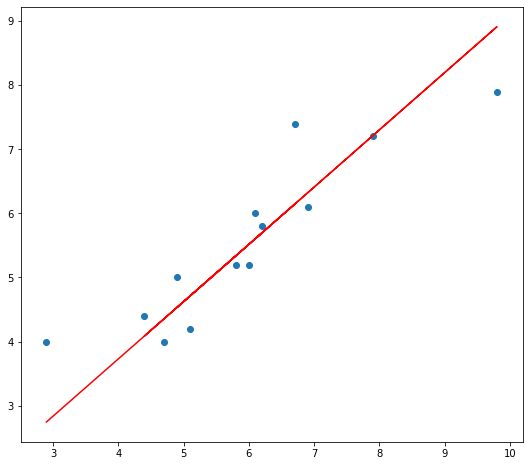

In [83]:
plt.figure(figsize=(9,8))
plt.plot(X,h,'r')
plt.scatter(X,y)
plt.xlabel('x')
plt.ylabel('y')

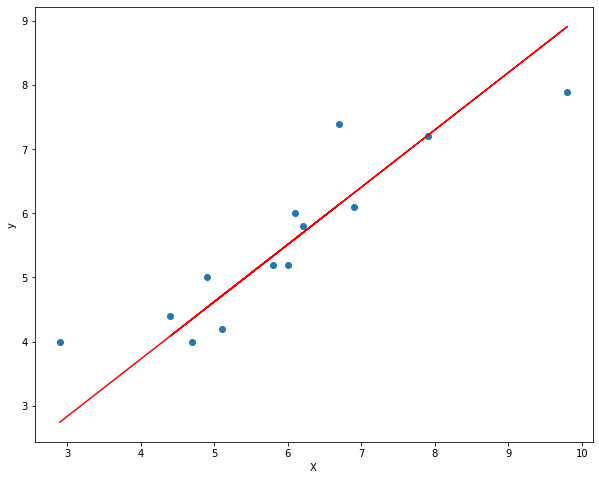

#### Use R2 score to evaluate LR equation output
https://www.youtube.com/watch?v=KccCy0hu-dM

In [85]:
r2_score(y, h)

0.7480324921408193

0.7480324921408193

In [86]:
def gradient_descent (X,y,num_of_iterations):
    theta_0=0
    theta_1=0
    learning_rate=0.01
    for i in range(0,num_of_iterations):
        print(f"****************** Iteration {i} ********************")
        h=theta_0 + theta_1 * X
        print("h(x): ",h)
        error_vector=(h-y)
        print("Error Vector:\n",error_vector)
        j=norm(error_vector)**2/(2*X.shape[0])
        print("j= ",j)
        d_theta_0=np.sum(error_vector)/(X.shape[0])
        d_theta_1=np.sum(error_vector*X)/(X.shape[0])
        Gradient_Vector=np.array([[d_theta_0],[d_theta_1]])
        print("Gradient Vector:\n",Gradient_Vector)
        Gradient_Vector_Norm=norm(Gradient_Vector)
        print("Gradient Vector Norm:\n",Gradient_Vector_Norm)
        if Gradient_Vector_Norm <0.001:
            break
        theta_0=theta_0-learning_rate*d_theta_0
        print("theta_0_new : ",theta_0)
        theta_1=theta_1-learning_rate*d_theta_1
        print("theta_1_new : ",theta_1)
        
    return h , error_vector , j,Gradient_Vector,Gradient_Vector_Norm,theta_0,theta_1
            

In [87]:
h , error_vector , j,Gradient_Vector,Gradient_Vector_Norm,theta_0,theta_1=gradient_descent (X,y,6500)
print("****************** Training Report ********************")
print("Gradient Descent converged after 6493 iterations")
print("theta_0_Opt :",theta_0)
print("theta_1_Opt :",theta_1)
print("Error Vector:\n",error_vector)
print('Cost =',j)
print("h(x) = y_predict:\n",h)
print("y_actual:\n",y)

****************** Iteration 0 ********************
h(x):  [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
Error Vector:
 [-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]
j=  16.305384479692314
Gradient Vector:
 [[ -5.56923074]
 [-35.04384604]]
Gradient Vector Norm:
 35.483622652335995
theta_0_new :  0.0556923073976923
theta_1_new :  0.35043846043215376
****************** Iteration 1 ********************
h(x):  [1.07196388 2.40362993 1.7728408  2.82415618 3.48998929 2.47371772
 2.19336688 2.2284107  2.15832307 1.84292842 1.702753   1.59762157
 2.08823544]
Error Vector:
 [-2.92803612 -4.99637017 -3.2271592  -4.37584363 -4.41001081 -3.62628219
 -3.80663312 -3.5715895  -3.04167674 -2.35707139 -2.297247   -2.80237853
 -3.11176436]
j=  6.175608808043304
Gradient Vector:
 [[ -3.42708175]
 [-21.33845263]]
Gradient Vector Norm:
 21.611905283072655
theta_0_new :  0.08996312489803082
theta_1_new

j=  0.19686286447681442
Gradient Vector:
 [[-0.08588914]
 [ 0.01342405]]
Gradient Vector Norm:
 0.08693186888742221
theta_0_new :  0.19814655809819376
theta_1_new :  0.8877042739398433
****************** Iteration 66 ********************
h(x):  [2.77248904 6.14576502 4.54789758 7.21101041 8.89764861 6.32330613
 5.61314254 5.70191289 5.5243722  4.72543827 4.37035648 4.10404545
 5.34683152]
Error Vector:
 [-1.22751096 -1.25423507 -0.45210242  0.0110106   0.99764852  0.22330623
 -0.38685746 -0.0980873   0.32437239  0.52543846  0.37035648 -0.29595465
  0.14683171]
j=  0.19678731921822262
Gradient Vector:
 [[-0.0858295 ]
 [ 0.01341473]]
Gradient Vector Norm:
 0.08687150048334359
theta_0_new :  0.199004853079221
theta_1_new :  0.8875701266880406
****************** Iteration 67 ********************
h(x):  [2.7729583  6.14572453 4.54809856 7.21080894 8.89719226 6.32323881
 5.61318254 5.70193947 5.52442561 4.72561241 4.37058428 4.10431349
 5.34691176]
Error Vector:
 [-1.2270417  -1.25427556 -0.

h(x):  [2.80277196 6.14315201 4.56086686 7.1980092  8.86819943 6.31896175
 5.61572363 5.70362829 5.52781897 4.73667618 4.38505712 4.12134313
 5.35200964]
Error Vector:
 [-1.19722804 -1.25684808 -0.43913314 -0.00199061  0.96819934  0.21896185
 -0.38427637 -0.0963719   0.32781916  0.53667637  0.38505712 -0.27865696
  0.15200983]
j=  0.19202641112610158
Gradient Vector:
 [[-0.08198319]
 [ 0.01281357]]
Gradient Vector Norm:
 0.08297849576394627
theta_0_new :  0.2543541117315499
theta_1_new :  0.8789193118728826
****************** Iteration 133 ********************
h(x):  [2.8032202  6.14311333 4.56105882 7.19781676 8.86776354 6.31889745
 5.61576183 5.70365368 5.52786998 4.73684252 4.38527471 4.12159917
 5.35208629]
Error Vector:
 [-1.1967798  -1.25688676 -0.43894118 -0.00218305  0.96776344  0.21889754
 -0.38423817 -0.09634651  0.32787017  0.53684271  0.38527471 -0.27840093
  0.15208648]
j=  0.19195758072587873
Gradient Vector:
 [[-0.08192626]
 [ 0.01280467]]
Gradient Vector Norm:
 0.082920

 5.35680915]
Error Vector:
 [-1.16915939 -1.25927004 -0.42711218 -0.01404117  0.94090347  0.21493512
 -0.38188402 -0.09478193  0.33101389  0.54709257  0.39868285 -0.26262408
  0.15680934]
j=  0.18780850789353326
Gradient Vector:
 [[-0.07841812]
 [ 0.01225636]]
Gradient Vector Norm:
 0.07937014601173778
theta_0_new :  0.30565625445640116
theta_1_new :  0.8709010412195866
****************** Iteration 197 ********************
h(x):  [2.83126936 6.14069306 4.57307144 7.18577456 8.84048662 6.31487352
 5.61815252 5.70524254 5.5310625  4.74725148 4.39889098 4.13762092
 5.35688246]
Error Vector:
 [-1.16873064 -1.25930703 -0.42692856 -0.01422525  0.94048653  0.21487362
 -0.38184748 -0.09475765  0.33106269  0.54725167  0.39889098 -0.26237918
  0.15688265]
j=  0.18774553356609094
Gradient Vector:
 [[-0.07836366]
 [ 0.01224785]]
Gradient Vector Norm:
 0.07931502872152504
theta_0_new :  0.30643989110009817
theta_1_new :  0.8707785626958979
****************** Iteration 198 ********************
h(x):

 [-1.14190121 -1.26162205 -0.41543832 -0.02574378  0.91439576  0.21102467
 -0.37956074 -0.09323787  0.33411638  0.557208    0.41191515 -0.24705414
  0.16147026]
j=  0.1838918462973127
Gradient Vector:
 [[-0.07495599]
 [ 0.01171525]]
Gradient Vector Norm:
 0.07586598615213604
theta_0_new :  0.35547706496346587
theta_1_new :  0.8631142954504138
****************** Iteration 262 ********************
h(x):  [2.8585086  6.13834268 4.58473719 7.17408008 8.81399733 6.31096579
 5.62047419 5.70678553 5.53416284 4.75735989 4.41211409 4.15318005
 5.36154014]
Error Vector:
 [-1.1414914  -1.26165742 -0.41526281 -0.02591973  0.91399723  0.21096588
 -0.37952581 -0.09321466  0.33416303  0.55736008  0.41211409 -0.24682005
  0.16154033]
j=  0.1838343098033386
Gradient Vector:
 [[-0.07490394]
 [ 0.01170711]]
Gradient Vector Norm:
 0.07581330226800394
theta_0_new :  0.35622610436614294
theta_1_new :  0.8629972243040319
****************** Iteration 263 ********************
h(x):  [2.85891814 6.13830734 4.58

 [[-0.07134871]
 [ 0.01115145]]
Gradient Vector Norm:
 0.07221491012993622
theta_0_new :  0.4073866735249811
theta_1_new :  0.8550010808974617
****************** Iteration 333 ********************
h(x):  [2.88688989 6.13589375 4.59689205 7.16189529 8.78639743 6.30689421
 5.62289319 5.70839321 5.53739316 4.7678921  4.42589159 4.16939151
 5.36639311]
Error Vector:
 [-1.11311011 -1.26410634 -0.40310795 -0.03810452  0.88639733  0.20689431
 -0.37710681 -0.09160698  0.33739335  0.5678923   0.42589159 -0.23060858
  0.1663933 ]
j=  0.1799469400675568
Gradient Vector:
 [[-0.07129916]
 [ 0.01114371]]
Gradient Vector Norm:
 0.07216476167539335
theta_0_new :  0.4080996651552439
theta_1_new :  0.8548896438392546
****************** Iteration 334 ********************
h(x):  [2.88727971 6.13586012 4.597059   7.16172793 8.78601834 6.30683829
 5.62292641 5.70841529 5.53743753 4.76803677 4.42608083 4.16961418
 5.36645976]
Error Vector:
 [-1.11272029 -1.26413998 -0.402941   -0.03827188  0.88601824  0.2068

 0.06869180832219463
theta_0_new :  0.4574767934376427
theta_1_new :  0.847172243402898
****************** Iteration 405 ********************
h(x):  [2.91427638 6.13353066 4.60862087 7.1501376  8.75976494 6.30296535
 5.6252274  5.70994454 5.54051025 4.77805515 4.43918618 4.18503474
 5.37107597]
Error Vector:
 [-1.08572362 -1.26646943 -0.39137913 -0.04986221  0.85976485  0.20296545
 -0.3747726  -0.09005565  0.34051044  0.57805535  0.43918618 -0.21496535
  0.17107616]
j=  0.1763775596796255
Gradient Vector:
 [[-0.06782074]
 [ 0.01060005]]
Gradient Vector Norm:
 0.06864410642765634
theta_0_new :  0.4581550008094059
theta_1_new :  0.8470662429519027
****************** Iteration 406 ********************
h(x):  [2.91464719 6.13349867 4.60877967 7.1499784  8.75940434 6.30291216
 5.625259   5.70996555 5.54055246 4.77819276 4.43936618 4.18524655
 5.37113937]
Error Vector:
 [-1.08535281 -1.26650143 -0.39122033 -0.05002141  0.85940425  0.20291225
 -0.374741   -0.09003465  0.34055265  0.57819295  

 [-1.06144048 -1.26856474 -0.38097939 -0.06028757  0.83615026  0.19948179
 -0.3727029  -0.08868011  0.34327432  0.58706675  0.45097426 -0.20109476
  0.17522837]
j=  0.17336194754279896
Gradient Vector:
 [[-0.06473647]
 [ 0.01011799]]
Gradient Vector Norm:
 0.06552240009706367
theta_0_new :  0.5025382326785238
theta_1_new :  0.8401293637750764
****************** Iteration 473 ********************
h(x):  [2.93891347 6.13140481 4.61917219 7.13956029 8.73580616 6.29943092
 5.62732727 5.71134013 5.54331442 4.78719791 4.45114608 4.19910751
 5.3752887 ]
Error Vector:
 [-1.06108653 -1.26859529 -0.38082781 -0.06043952  0.83580606  0.19943102
 -0.37267273 -0.08866006  0.34331461  0.5871981   0.45114608 -0.20089258
  0.17528889]
j=  0.17331903060031167
Gradient Vector:
 [[-0.06469152]
 [ 0.01011096]]
Gradient Vector Norm:
 0.06547689914584884
theta_0_new :  0.5031851478762285
theta_1_new :  0.8400282541358017
****************** Iteration 474 ********************
h(x):  [2.93926716 6.13137429 4.61

j=  0.17041940964927674
Gradient Vector:
 [[-0.06157822]
 [ 0.00962437]]
Gradient Vector Norm:
 0.06232580141939204
theta_0_new :  0.5479862554195616
theta_1_new :  0.8330260630620971
****************** Iteration 545 ********************
h(x):  [2.96376192 6.12926072 4.62981404 7.12889223 8.71164183 6.29586617
 5.62944516 5.71274769 5.54614263 4.7964191  4.46320859 4.21330101
 5.37953758]
Error Vector:
 [-1.03623808 -1.27073938 -0.37018596 -0.07110758  0.81164174  0.19586626
 -0.37055484 -0.0872525   0.34614282  0.59641929  0.46320859 -0.18669908
  0.17953777]
j=  0.1703805780817051
Gradient Vector:
 [[-0.06153546]
 [ 0.00961769]]
Gradient Vector Norm:
 0.06228252029346238
theta_0_new :  0.5486016099866654
theta_1_new :  0.8329298861929701
****************** Iteration 546 ********************
h(x):  [2.96409836 6.12923169 4.62995813 7.12874779 8.71131465 6.2958179
 5.62947384 5.71276675 5.54618093 4.79654395 4.46337192 4.21349319
 5.37959511]
Error Vector:
 [-1.03590164 -1.27076841 -0.

****************** Iteration 616 ********************
h(x):  [2.98707785 6.12724886 4.63979956 7.11888213 8.68896783 6.29252127
 5.63143243 5.71406844 5.54879642 4.80507158 4.47452715 4.22661913
 5.38352441]
Error Vector:
 [-1.01292215 -1.27275123 -0.36020044 -0.08111768  0.78896773  0.19252137
 -0.36856757 -0.08593175  0.34879661  0.60507177  0.47452715 -0.17338096
  0.1835246 ]
j=  0.1677569795593901
Gradient Vector:
 [[-0.05857404]
 [ 0.00915483]]
Gradient Vector Norm:
 0.059285153120384
theta_0_new :  0.5912170350623371
theta_1_new :  0.8262693064566685
****************** Iteration 617 ********************
h(x):  [2.9873981  6.12722123 4.63993672 7.11874463 8.6886564  6.29247533
 5.63145973 5.71408658 5.54883287 4.80519042 4.47468262 4.22680206
 5.38357917]
Error Vector:
 [-1.0126019  -1.27277886 -0.36006328 -0.08125517  0.7886563   0.19247542
 -0.36854027 -0.08591361  0.34883306  0.60519061  0.47468262 -0.17319803
  0.18357936]
j=  0.16772184446931457
Gradient Vector:
 [[-0.058533

Gradient Vector:
 [[-0.05579389]
 [ 0.00872031]]
Gradient Vector Norm:
 0.05647125077725171
theta_0_new :  0.631224027048858
theta_1_new :  0.8200164118847468
****************** Iteration 687 ********************
h(x):  [3.0092717  6.12533383 4.64930452 7.10935376 8.66738502 6.28933735
 5.63332406 5.71532562 5.5513225  4.81330765 4.48530101 4.23929632
 5.38731937]
Error Vector:
 [-0.9907283  -1.27466626 -0.35069548 -0.09064605  0.76738493  0.18933744
 -0.36667594 -0.08467457  0.35132269  0.61330784  0.48530101 -0.16070378
  0.18731956]
j=  0.1653798277744412
Gradient Vector:
 [[-0.05575515]
 [ 0.00871425]]
Gradient Vector Norm:
 0.056432035247557376
theta_0_new :  0.631781578516861
theta_1_new :  0.8199292693535358
****************** Iteration 688 ********************
h(x):  [3.00957654 6.12530753 4.64943508 7.10922288 8.66708857 6.28929361
 5.63335004 5.71534289 5.55135719 4.81342077 4.48544899 4.23947044
 5.3873715 ]
Error Vector:
 [-0.99042346 -1.27469257 -0.35056492 -0.09077692  0.

 [[-0.05318263]
 [ 0.00831218]]
Gradient Vector Norm:
 0.05382828727464653
theta_0_new :  0.6688006756939179
theta_1_new :  0.8141433679322579
****************** Iteration 756 ********************
h(x):  [3.02981652 6.12356109 4.65810326 7.10053336 8.64740584 6.28638999
 5.63507514 5.7164894  5.55366088 4.82093177 4.49527435 4.25103157
 5.39083237]
Error Vector:
 [-0.97018348 -1.27643901 -0.34189674 -0.09946645  0.74740574  0.18639009
 -0.36492486 -0.08351079  0.35366107  0.62093197  0.49527435 -0.14896852
  0.19083256]
j=  0.1632837818277098
Gradient Vector:
 [[-0.0531457 ]
 [ 0.00830641]]
Gradient Vector Norm:
 0.05379090710741169
theta_0_new :  0.6693321326773739
theta_1_new :  0.8140603038396569
****************** Iteration 757 ********************
h(x):  [3.03010709 6.12353601 4.6582277  7.10040861 8.64712327 6.28634831
 5.63509991 5.71650586 5.55369396 4.8210396  4.49541541 4.25119755
 5.39088205]
Error Vector:
 [-0.96989291 -1.27646408 -0.3417723  -0.0995912   0.74712317  0.1863

j=  0.16153779458497095
Gradient Vector:
 [[-0.05086996]
 [ 0.00795072]]
Gradient Vector Norm:
 0.05148754482973877
theta_0_new :  0.7020804604257839
theta_1_new :  0.8089419025140452
****************** Iteration 820 ********************
h(x):  [3.04801205 6.12199105 4.66589586 7.09272157 8.62971126 6.28377966
 5.63662599 5.7175201  5.55573188 4.82768409 4.50410725 4.26142491
 5.39394365]
Error Vector:
 [-0.95198795 -1.27800904 -0.33410414 -0.10727824  0.72971116  0.18377976
 -0.36337401 -0.08248009  0.35573207  0.62768428  0.50410725 -0.13857519
  0.19394384]
j=  0.16151129411684773
Gradient Vector:
 [[-0.05083464]
 [ 0.0079452 ]]
Gradient Vector Norm:
 0.05145179015252914
theta_0_new :  0.7025888068110432
theta_1_new :  0.8088624504934055
****************** Iteration 821 ********************
h(x):  [3.04828999 6.12196707 4.66601489 7.09260224 8.62944098 6.28373979
 5.63664968 5.71753585 5.55576351 4.82778723 4.50424217 4.26158367
 5.39399117]
Error Vector:
 [-0.95171001 -1.27803302 -

theta_0_new :  0.729521661348162
theta_1_new :  0.8046529788090998
****************** Iteration 875 ********************
h(x):  [3.06301538 6.12069647 4.67232133 7.08628027 8.61512101 6.28162729
 5.63790476 5.71836998 5.55743953 4.83325178 4.51139051 4.26999484
 5.39650909]
Error Vector:
 [-0.93698462 -1.27930363 -0.32767867 -0.11371954  0.71512091  0.18162739
 -0.36209524 -0.08163021  0.35743973  0.63325197  0.51139051 -0.13000525
  0.19650928]
j=  0.16010903902190796
Gradient Vector:
 [[-0.04892903]
 [ 0.00764736]]
Gradient Vector Norm:
 0.04952304635634684
theta_0_new :  0.730010951643556
theta_1_new :  0.8045765051608637
****************** Iteration 876 ********************
h(x):  [3.06328289 6.12067338 4.6724359  7.08616542 8.61486086 6.28158891
 5.63792756 5.71838513 5.55746998 4.83335105 4.51152037 4.27014765
 5.39655484]
Error Vector:
 [-0.93671711 -1.27932671 -0.3275641  -0.11383439  0.71486076  0.18158901
 -0.36207244 -0.08161506  0.35747017  0.63335124  0.51152037 -0.1298524

 [ 0.00730974]]
Gradient Vector Norm:
 0.04733662388030085
theta_0_new :  0.7610966738228657
theta_1_new :  0.7997179608457908
****************** Iteration 941 ********************
h(x):  [3.08027884 6.11920686 4.67971476 7.07886864 8.59833284 6.27915068
 5.63937616 5.71934788 5.55940444 4.8396582  4.51977094 4.27985578
 5.399461  ]
Error Vector:
 [-0.91972116 -1.28079324 -0.32028524 -0.12113117  0.69833275  0.17915077
 -0.36062384 -0.08065231  0.35940463  0.63965839  0.51977094 -0.12014432
  0.19946119]
j=  0.15856182691252366
Gradient Vector:
 [[-0.04673635]
 [ 0.00730466]]
Gradient Vector Norm:
 0.047303751741755024
theta_0_new :  0.7615640373710696
theta_1_new :  0.799644914239471
****************** Iteration 942 ********************
h(x):  [3.08053436 6.11918481 4.67982419 7.07875894 8.59808435 6.27911402
 5.63939794 5.71936235 5.55943352 4.83975302 4.51989498 4.28000174
 5.39950469]
Error Vector:
 [-0.91946564 -1.28081528 -0.32017581 -0.12124087  0.69808425  0.17911412
 -0.360602

 [[-0.044549  ]
 [ 0.00696279]]
Gradient Vector Norm:
 0.04508984488350428
theta_0_new :  0.7930405220305716
theta_1_new :  0.794725295685372
****************** Iteration 1011 ********************
h(x):  [3.09774396 6.11769985 4.68719455 7.07137043 8.58134857 6.27664514
 5.64086475 5.7203372  5.5613923  4.84613945 4.52824926 4.2898319
 5.40244739]
Error Vector:
 [-0.90225604 -1.28230024 -0.31280545 -0.12862938  0.68134848  0.17664523
 -0.35913525 -0.07966299  0.36139249  0.64613965  0.52824926 -0.1101682
  0.20244758]
j=  0.15706871398682767
Gradient Vector:
 [[-0.04451807]
 [ 0.00695795]]
Gradient Vector Norm:
 0.045058532983615306
theta_0_new :  0.7934857026996874
theta_1_new :  0.7946557161531148
****************** Iteration 1012 ********************
h(x):  [3.09798736 6.11767885 4.68729879 7.07126594 8.58111187 6.27661022
 5.6408855  5.72035099 5.56142    4.84622978 4.52836742 4.28997093
 5.40248901]
Error Vector:
 [-0.90201264 -1.28232125 -0.31270121 -0.12873387  0.68111178  0.176

 5.40537129]
Error Vector:
 [-0.88515635 -1.28377572 -0.30548217 -0.1359707   0.66471957  0.17419212
 -0.3576778  -0.07869436  0.36333875  0.65248529  0.53655019 -0.10040081
  0.20537148]
j=  0.1556771711970679
Gradient Vector:
 [[-0.04234619]
 [ 0.0066185 ]]
Gradient Vector Norm:
 0.04286029166858589
theta_0_new :  0.8247394606310748
theta_1_new :  0.7897709086827814
****************** Iteration 1084 ********************
h(x):  [3.11507517 6.1162044  4.69461699 7.06392971 8.56449452 6.27415881
 5.64234193 5.72131894 5.56336491 4.85257102 4.53666258 4.29973153
 5.40541088]
Error Vector:
 [-0.88492483 -1.2837957  -0.30538301 -0.13607009  0.66449442  0.1741589
 -0.35765807 -0.07868125  0.3633651   0.65257121  0.53666258 -0.10026856
  0.20541107]
j=  0.15565880752943664
Gradient Vector:
 [[-0.04231679]
 [ 0.0066139 ]]
Gradient Vector Norm:
 0.04283052804519338
theta_0_new :  0.8251626284945442
theta_1_new :  0.7897047696429508
****************** Iteration 1085 ********************
h(x):  

 5.40792606]
Error Vector:
 [-0.87021549 -1.28506492 -0.29908344 -0.14238518  0.65019006  0.1720487
 -0.35640436 -0.07784803  0.3650393   0.6580298   0.54380313 -0.09186655
  0.20792625]
j=  0.1545182727094911
Gradient Vector:
 [[-0.04044852]
 [ 0.0063219 ]]
Gradient Vector Norm:
 0.04093957754701333
theta_0_new :  0.8520474426076686
theta_1_new :  0.785502806438826
****************** Iteration 1150 ********************
h(x):  [3.13000566 6.1149161  4.70101127 7.05751969 8.5499751  6.27201688
 5.64361449 5.72216469 5.56506428 4.85811168 4.54391048 4.30825987
 5.40796387]
Error Vector:
 [-0.86999434 -1.285084   -0.29898873 -0.14248012  0.649975    0.17201698
 -0.35638551 -0.0778355   0.36506447  0.65811187  0.54391048 -0.09174023
  0.20796406]
j=  0.154501518038917
Gradient Vector:
 [[-0.04042043]
 [ 0.00631751]]
Gradient Vector Norm:
 0.04091114773189726
theta_0_new :  0.8524516468929747
theta_1_new :  0.7854396313122783
****************** Iteration 1151 ********************
h(x):  [3.

 [-0.8563671  -1.28625985 -0.29315259 -0.14833063  0.63672294  0.17006202
 -0.35522403 -0.07706357  0.36661551  0.6631689   0.55052573 -0.08395631
  0.21029421]
j=  0.15349155226406663
Gradient Vector:
 [[-0.0386896 ]
 [ 0.00604699]]
Gradient Vector Norm:
 0.03915930528325088
theta_0_new :  0.8773586757298839
theta_1_new :  0.7815467861448766
****************** Iteration 1214 ********************
h(x):  [3.14384443 6.11372199 4.706938   7.05157836 8.53651733 6.27003157
 5.644794   5.7229486  5.56663939 4.86324721 4.55062842 4.31616461
 5.41033018]
Error Vector:
 [-0.85615557 -1.2862781  -0.293062   -0.14842145  0.63651723  0.17003167
 -0.355206   -0.07705159  0.36663958  0.6632474   0.55062842 -0.08383549
  0.21033038]
j=  0.1534762230765636
Gradient Vector:
 [[-0.03866273]
 [ 0.00604279]]
Gradient Vector Norm:
 0.039132111748877034
theta_0_new :  0.8777453030463706
theta_1_new :  0.7814863582114436
****************** Iteration 1215 ********************
h(x):  [3.14405582 6.11370375 4.

  0.21276642]
j=  0.15246832656655065
Gradient Vector:
 [[-0.03685324]
 [ 0.00575998]]
Gradient Vector Norm:
 0.037300653410188865
theta_0_new :  0.9037842802903294
theta_1_new :  0.7774165951179823
****************** Iteration 1284 ********************
h(x):  [3.15829248 6.11247532 4.71312567 7.04537546 8.52246706 6.26795886
 5.64602544 5.72376702 5.56828385 4.86860884 4.55764213 4.32441737
 5.41280068]
Error Vector:
 [-0.84170752 -1.28752478 -0.28687433 -0.15462435  0.62246697  0.16795896
 -0.35397456 -0.07623317  0.36828404  0.66860903  0.55764213 -0.07558272
  0.21280087]
j=  0.1524544180100637
Gradient Vector:
 [[-0.03682765]
 [ 0.00575598]]
Gradient Vector Norm:
 0.0372747505859855
theta_0_new :  0.9041525567811115
theta_1_new :  0.7773590353276598
****************** Iteration 1285 ********************
h(x):  [3.15849383 6.11245795 4.7132119  7.04528901 8.52227125 6.26792997
 5.6460426  5.72377843 5.56830677 4.86868356 4.55773987 4.32453239
 5.41283511]
Error Vector:
 [-0.8415061

 0.03553022033366192
theta_0_new :  0.9289556235951734
theta_1_new :  0.773482438909191
****************** Iteration 1354 ********************
h(x):  [3.17205477 6.11128782 4.71901965 7.03946696 8.50908367 6.26598453
 5.64719843 5.7245466  5.56985026 4.87371599 4.56432294 4.33227843
 5.41515392]
Error Vector:
 [-0.82794523 -1.28871228 -0.28098035 -0.16053284  0.60908358  0.16598462
 -0.35280157 -0.07545359  0.36985045  0.67371618  0.56432294 -0.06772167
  0.21515411]
j=  0.15152730863240266
Gradient Vector:
 [[-0.03507967]
 [ 0.00548278]]
Gradient Vector Norm:
 0.03550554695753926
theta_0_new :  0.9293064202613149
theta_1_new :  0.7734276111288294
****************** Iteration 1355 ********************
h(x):  [3.17224657 6.11127127 4.71910179 7.03938462 8.50889716 6.26595701
 5.64721477 5.72455746 5.56987209 4.87378716 4.56441604 4.33238798
 5.41518671]
Error Vector:
 [-0.82775343 -1.28872883 -0.28089821 -0.16061519  0.60889706  0.16595711
 -0.35278523 -0.07544273  0.36987228  0.6737873

h(x):  [3.18406502 6.11025149 4.72416328 7.03431067 8.49740408 6.26426154
 5.64822209 5.72522693 5.57121725 4.87817296 4.57015323 4.33913872
 5.41720757]
Error Vector:
 [-0.81593498 -1.2897486  -0.27583672 -0.16568914  0.59740399  0.16426163
 -0.35177791 -0.07477326  0.37121744  0.67817315  0.57015323 -0.06086138
  0.21720776]
j=  0.15075505864279645
Gradient Vector:
 [[-0.03355421]
 [ 0.00524436]]
Gradient Vector Norm:
 0.03396157546966463
theta_0_new :  0.9512580189347994
theta_1_new :  0.7699966850487912
****************** Iteration 1419 ********************
h(x):  [3.18424848 6.11023566 4.72424185 7.0342319  8.49722568 6.26423522
 5.64823772 5.72523732 5.57123813 4.87824104 4.57024229 4.33924351
 5.41723894]
Error Vector:
 [-0.81575152 -1.28976443 -0.27575815 -0.16576791  0.59722558  0.16423531
 -0.35176228 -0.07476287  0.37123832  0.67824123  0.57024229 -0.06075659
  0.21723913]
j=  0.15074352876147115
Gradient Vector:
 [[-0.03353091]
 [ 0.00524072]]
Gradient Vector Norm:
 0.03393

 5.41932174]
Error Vector:
 [-0.80357082 -1.29081547 -0.27054152 -0.17099738  0.58538024  0.16248787
 -0.35072409 -0.07407289  0.37262471  0.68276145  0.57615533 -0.05379894
  0.21932193]
j=  0.1499959131305673
Gradient Vector:
 [[-0.03198381]
 [ 0.00499891]]
Gradient Vector Norm:
 0.03237210820584665
theta_0_new :  0.9738564592259494
theta_1_new :  0.7664646608296738
****************** Iteration 1488 ********************
h(x):  [3.19660405 6.10916954 4.72953337 7.02892735 8.48521028 6.26246269
 5.64929082 5.72593721 5.57264442 4.88282616 4.57624022 4.34630104
 5.41935164]
Error Vector:
 [-0.80339595 -1.29083055 -0.27046663 -0.17107246  0.58521019  0.16246279
 -0.35070918 -0.07406298  0.37264462  0.68282635  0.57624022 -0.05369906
  0.21935183]
j=  0.1499854372353403
Gradient Vector:
 [[-0.0319616 ]
 [ 0.00499544]]
Gradient Vector Norm:
 0.032349627928658864
theta_0_new :  0.9741760752465635
theta_1_new :  0.7664147064296761
****************** Iteration 1489 ********************
h(x): 

 [ 0.00475173]]
Gradient Vector Norm:
 0.03077140769089684
theta_0_new :  0.9966146096040934
theta_1_new :  0.762907674715486
****************** Iteration 1561 ********************
h(x):  [3.20904694 6.10809588 4.73486229 7.02358531 8.47310997 6.26067764
 5.65035135 5.72664205 5.57406066 4.88744368 4.58228054 4.35340845
 5.42147927]
Error Vector:
 [-0.79095306 -1.29190421 -0.26513771 -0.1764145   0.57310987  0.16067773
 -0.34964865 -0.07335814  0.37406085  0.68744387  0.58228054 -0.04659164
  0.22147946]
j=  0.14925870439856367
Gradient Vector:
 [[-0.0303812 ]
 [ 0.00474843]]
Gradient Vector Norm:
 0.030750038993808813
theta_0_new :  0.9969184216021356
theta_1_new :  0.7628601904058913
****************** Iteration 1562 ********************
h(x):  [3.20921305 6.10808155 4.73493343 7.023514   8.47294843 6.26065381
 5.65036551 5.72665146 5.57407956 4.88750532 4.58236117 4.35350333
 5.42150767]
Error Vector:
 [-0.79078695 -1.29191854 -0.26506657 -0.17648581  0.57294834  0.1606539
 -0.34963

  0.22336661]
j=  0.14864494600609912
Gradient Vector:
 [[-0.02897943]
 [ 0.00452934]]
Gradient Vector Norm:
 0.02933124643483383
theta_0_new :  1.0170902739324006
theta_1_new :  0.7597074298588344
****************** Iteration 1630 ********************
h(x):  [3.22024189 6.10712991 4.73965675 7.01877904 8.46222323 6.25907161
 5.65130552 5.72727619 5.57533485 4.89159809 4.58771505 4.35980304
 5.42339351]
Error Vector:
 [-0.77975811 -1.29287019 -0.26034325 -0.18122077  0.56222314  0.15907171
 -0.34869448 -0.072724    0.37533504  0.69159829  0.58771505 -0.04019706
  0.2233937 ]
j=  0.14863634577310714
Gradient Vector:
 [[-0.0289593]
 [ 0.0045262]]
Gradient Vector Norm:
 0.029310877834002203
theta_0_new :  1.0173798669427025
theta_1_new :  0.7596621679065538
****************** Iteration 1631 ********************
h(x):  [3.22040023 6.10711625 4.73972456 7.01871107 8.46206926 6.2590489
 5.65131902 5.72728516 5.57535287 4.89165685 4.58779191 4.35989348
 5.42342059]
Error Vector:
 [-0.77959977

theta_1_new :  0.7567865734238262
****************** Iteration 1696 ********************
h(x):  [3.2304595  6.10624827 4.74403265 7.01439237 8.45228693 6.2576058
 5.65217639 5.72785498 5.57649781 4.89538982 4.59267512 4.36563936
 5.42514064]
Error Vector:
 [-0.7695405  -1.29375183 -0.25596735 -0.18560744  0.55228684  0.15760589
 -0.34782361 -0.07214521  0.376498    0.69539001  0.59267512 -0.03436073
  0.22514083]
j=  0.1480943538650927
Gradient Vector:
 [[-0.02766154]
 [ 0.00432336]]
Gradient Vector Norm:
 0.02799735861190326
theta_0_new :  1.0360549830571302
theta_1_new :  0.7567433398121735
****************** Iteration 1697 ********************
h(x):  [3.23061074 6.10623522 4.74409742 7.01432744 8.45213986 6.2575841
 5.65218928 5.72786355 5.57651502 4.89544594 4.59274854 4.36572575
 5.4251665 ]
Error Vector:
 [-0.76938926 -1.29376488 -0.25590258 -0.18567237  0.55213976  0.15758419
 -0.34781072 -0.07213665  0.37651521  0.69544614  0.59274854 -0.03427434
  0.22516669]
j=  0.14808651806

theta_0_new :  1.0541572400994674
theta_1_new :  0.753914046751658
****************** Iteration 1764 ********************
h(x):  [3.24050805 6.10538121 4.74833614 7.01007828 8.44251504 6.25616423
 5.65303285 5.72842419 5.57764152 4.89911881 4.59755312 4.37137912
 5.42685886]
Error Vector:
 [-0.75949195 -1.29461889 -0.25166386 -0.18992153  0.54251495  0.15616433
 -0.34696715 -0.07157601  0.37764171  0.699119    0.59755312 -0.02862098
  0.22685905]
j=  0.14758556192581893
Gradient Vector:
 [[-0.02638525]
 [ 0.00412388]]
Gradient Vector Norm:
 0.026705573450995806
theta_0_new :  1.0544210925658217
theta_1_new :  0.7538728079188256
****************** Iteration 1765 ********************
h(x):  [3.24065231 6.10536876 4.74839792 7.01001635 8.44237475 6.25614354
 5.65304515 5.72843236 5.57765794 4.89917234 4.59762315 4.37146152
 5.42688352]
Error Vector:
 [-0.75934769 -1.29463133 -0.25160208 -0.18998346  0.54237466  0.15614363
 -0.34695485 -0.07156783  0.37765813  0.69917253  0.59762315 -0.028

Gradient Vector Norm:
 0.025526533179345175
theta_0_new :  1.0711842381720786
theta_1_new :  0.7512528113391025
****************** Iteration 1830 ********************
h(x):  [3.24981746 6.10457793 4.75232309 7.00608152 8.43346193 6.25482871
 5.65382632 5.72895152 5.57870111 4.9025735  4.60207231 4.37669668
 5.42845069]
Error Vector:
 [-0.75018254 -1.29542216 -0.24767691 -0.19391829  0.53346184  0.1548288
 -0.34617368 -0.07104867  0.3787013   0.7025737   0.60207231 -0.02330342
  0.22845088]
j=  0.14713563812488797
Gradient Vector:
 [[-0.02520283]
 [ 0.00393908]]
Gradient Vector Norm:
 0.025508806698948307
theta_0_new :  1.0714362665201544
theta_1_new :  0.7512134205573565
****************** Iteration 1831 ********************
h(x):  [3.24995526 6.10456604 4.7523821  7.00602236 8.43332793 6.25480894
 5.65383806 5.72895933 5.57871679 4.90262464 4.6021392  4.37677539
 5.42847425]
Error Vector:
 [-0.75004474 -1.29543405 -0.2476179  -0.19397745  0.53332784  0.15480903
 -0.34616194 -0.0710408

 [ 0.00377302]]
Gradient Vector Norm:
 0.024433470117819517
theta_0_new :  1.0867249925447204
theta_1_new :  0.7488238684509942
****************** Iteration 1893 ********************
h(x):  [3.25831428 6.10384477 4.75596202 7.00243362 8.42519905 6.25360976
 5.65455052 5.72943283 5.5796682  4.90572665 4.60619703 4.38155008
 5.42990357]
Error Vector:
 [-0.74168572 -1.29615533 -0.24403798 -0.19756618  0.52519895  0.15360985
 -0.34544948 -0.07056736  0.37966839  0.70572684  0.60619703 -0.01845001
  0.22990376]
j=  0.14674298992065457
Gradient Vector:
 [[-0.02412363]
 [ 0.0037704 ]]
Gradient Vector Norm:
 0.02441650269705671
theta_0_new :  1.0869662288719684
theta_1_new :  0.7487861644086182
****************** Iteration 1894 ********************
h(x):  [3.25844618 6.10383339 4.75601851 7.002377   8.42507078 6.25359083
 5.65456176 5.72944031 5.57968322 4.9057756  4.60626106 4.38162542
 5.42992613]
Error Vector:
 [-0.74155382 -1.29616671 -0.24398149 -0.19762281  0.52507069  0.15359093
 -0.345

****************** Iteration 1952 ********************
h(x):  [3.2659414  6.10318665 4.75922848 6.99915912 8.41778192 6.25251557
 5.6552006  5.72986488 5.58053631 4.90855705 4.60989956 4.38590671
 5.43120775]
Error Vector:
 [-0.7340586  -1.29681345 -0.24077152 -0.20084069  0.51778182  0.15251567
 -0.3447994  -0.07013531  0.3805365   0.70855724  0.60989956 -0.01409338
  0.23120794]
j=  0.14640516519115632
Gradient Vector:
 [[-0.02315489]
 [ 0.003619  ]]
Gradient Vector Norm:
 0.02343600308202123
theta_0_new :  1.1009065990263365
theta_1_new :  0.7466073536422853
****************** Iteration 1953 ********************
h(x):  [3.266068   6.10317573 4.7592827  6.99910476 8.41765881 6.25249741
 5.65521139 5.72987205 5.58055072 4.90860403 4.60996102 4.38597903
 5.43122939]
Error Vector:
 [-0.733932   -1.29682437 -0.2407173  -0.20089505  0.51765871  0.15249751
 -0.34478861 -0.07012814  0.38055091  0.70860422  0.60996102 -0.01402107
  0.23122958]
j=  0.14639967463582676
Gradient Vector:
 [[-0.0

****************** Iteration 2027 ********************
h(x):  [3.27519636 6.10238807 4.76319211 6.99518573 8.40878176 6.25118786
 5.65598942 5.73038913 5.5815897  4.91199154 4.61439232 4.39119317
 5.43279027]
Error Vector:
 [-0.72480364 -1.29761203 -0.23680789 -0.20481408  0.50878167  0.15118795
 -0.34401058 -0.06961106  0.38158989  0.71199173  0.61439232 -0.00880692
  0.23279046]
j=  0.1460138302282536
Gradient Vector:
 [[-0.0219794 ]
 [ 0.00343527]]
Gradient Vector Norm:
 0.022246236018092364
theta_0_new :  1.1178222540804654
theta_1_new :  0.7439635205917
****************** Iteration 2028 ********************
h(x):  [3.27531653 6.1023777  4.76324358 6.99513414 8.4086649  6.25117062
 5.65599966 5.73039594 5.58160338 4.91203614 4.61445066 4.39126182
 5.43281082]
Error Vector:
 [-0.72468347 -1.2976224  -0.23675642 -0.20486567  0.5086648   0.15117071
 -0.34400034 -0.06960425  0.38160357  0.71203633  0.61445066 -0.00873828
  0.23281101]
j=  0.1460088829964424
Gradient Vector:
 [[-0.02196

Gradient Vector:
 [[-0.02095072]
 [ 0.00327449]]
Gradient Vector Norm:
 0.021205069246382723
theta_0_new :  1.132625166766502
theta_1_new :  0.7416498987024479
****************** Iteration 2097 ********************
h(x):  [3.28340994 6.10167935 4.76670974 6.99165944 8.40079432 6.25000954
 5.65668948 5.7308544  5.58252456 4.91503958 4.61837955 4.39588479
 5.43419472]
Error Vector:
 [-0.71659006 -1.29832075 -0.23329026 -0.20834037  0.50079422  0.15000963
 -0.34331052 -0.06914579  0.38252475  0.71503977  0.61837955 -0.0041153
  0.23419491]
j=  0.1456836017200669
Gradient Vector:
 [[-0.02093617]
 [ 0.00327222]]
Gradient Vector Norm:
 0.021190343735414584
theta_0_new :  1.1328345284740027
theta_1_new :  0.741617176505167
****************** Iteration 2098 ********************
h(x):  [3.28352441 6.10166947 4.76675876 6.99161029 8.400683   6.24999312
 5.65669923 5.73086088 5.58253759 4.91508206 4.61843512 4.39595018
 5.43421429]
Error Vector:
 [-0.71647559 -1.29833063 -0.23324124 -0.20838952  

  2.35345551e-01]
j=  0.14542501737617083
Gradient Vector:
 [[-0.02008148]
 [ 0.00313864]]
Gradient Vector Norm:
 0.020325273434250272
theta_0_new :  1.145133768598993
theta_1_new :  0.7396948662289476
****************** Iteration 2158 ********************
h(x):  [3.29024895 6.10108923 4.76963868 6.98872328 8.3941436  6.24902842
 5.65727238 5.7312418  5.58330297 4.91757752 4.6216995  4.39979125
 5.43536413]
Error Vector:
 [-7.09751049e-01 -1.29891086e+00 -2.30361317e-01 -2.11276527e-01
  4.94143504e-01  1.49028511e-01 -3.42727618e-01 -6.87583931e-02
  3.83303157e-01  7.17577707e-01  6.21699499e-01 -2.08844723e-04
  2.35364325e-01]
j=  0.1454208876431797
Gradient Vector:
 [[-0.02006753]
 [ 0.00313646]]
Gradient Vector Norm:
 0.020311158882988525
theta_0_new :  1.1453344439140403
theta_1_new :  0.7396635016717573
****************** Iteration 2159 ********************
h(x):  [3.29035867 6.10107976 4.76968567 6.98867618 8.3940369  6.24901268
 5.65728173 5.73124801 5.58331545 4.91761823 4.6

  0.23646722]
j=  0.14518331543715574
Gradient Vector:
 [[-0.0192483 ]
 [ 0.00300841]]
Gradient Vector Norm:
 0.019481980246186376
theta_0_new :  1.1571233900226015
theta_1_new :  0.7378209478212769
****************** Iteration 2219 ********************
h(x):  [3.29680421 6.1005236  4.7724461  6.98590895 8.38776882 6.248088
 5.6578311  5.73161313 5.58404908 4.92001015 4.6248817  4.40353563
 5.43648503]
Error Vector:
 [-0.70319579 -1.2994765  -0.2275539  -0.21409086  0.48776872  0.1480881
 -0.3421689  -0.06838707  0.38404927  0.72001034  0.6248817   0.00353554
  0.23648522]
j=  0.14517952127946537
Gradient Vector:
 [[-0.01923493]
 [ 0.00300632]]
Gradient Vector Norm:
 0.01946845130598523
theta_0_new :  1.1573157393425892
theta_1_new :  0.7377908845758505
****************** Iteration 2220 ********************
h(x):  [3.29690937 6.10051453 4.77249114 6.9858638  8.38766655 6.24807291
 5.65784007 5.73161908 5.58406105 4.92004918 4.62493276 4.4035957
 5.43650301]
Error Vector:
 [-0.70309063 

 [-0.69721534 -1.29999253 -0.22499265 -0.21665842  0.48195292  0.14723014
 -0.34165917 -0.0680483   0.38472996  0.72222967  0.62778487  0.00695159
  0.23750783]
j=  0.14496824004700104
Gradient Vector:
 [[-0.01847534]
 [ 0.0028876 ]]
Gradient Vector Norm:
 0.018699637485287492
theta_0_new :  1.1682464414825735
theta_1_new :  0.7360824700041819
****************** Iteration 2278 ********************
h(x):  [3.30288567 6.09999885 4.77505061 6.98329802 8.38185479 6.24721555
 5.65834944 5.73195761 5.58474126 4.92226697 4.62783391 4.40700938
 5.43752491]
Error Vector:
 [-0.69711433 -1.30000125 -0.22494939 -0.21670178  0.48185469  0.14721565
 -0.34165056 -0.06804258  0.38474145  0.72226716  0.62783391  0.00700928
  0.2375251 ]
j=  0.14496474449671554
Gradient Vector:
 [[-0.01846251]
 [ 0.0028856 ]]
Gradient Vector Norm:
 0.018686651830126917
theta_0_new :  1.168431066582736
theta_1_new :  0.7360536140160328
****************** Iteration 2279 ********************
h(x):  [3.30298662 6.09999014 4

  0.23858942]
j=  0.14475403392875266
Gradient Vector:
 [[-0.01767193]
 [ 0.00276204]]
Gradient Vector Norm:
 0.01788647701925088
theta_0_new :  1.1798076473388752
theta_1_new :  0.7342755108264438
****************** Iteration 2342 ********************
h(x):  [3.3092067  6.09945343 4.77775772 6.98058425 8.37570779 6.24630874
 5.65888819 5.73231567 5.58546071 4.92461268 4.63090241 4.41061996
 5.43860575]
Error Vector:
 [-0.6907933  -1.30054667 -0.22224228 -0.21941556  0.4757077   0.14630884
 -0.34111181 -0.06768452  0.3854609   0.72461287  0.63090241  0.01061987
  0.23860594]
j=  0.14475083577898792
Gradient Vector:
 [[-0.01765966]
 [ 0.00276012]]
Gradient Vector Norm:
 0.017874056049978434
theta_0_new :  1.1799842439501105
theta_1_new :  0.7342479096513246
****************** Iteration 2343 ********************
h(x):  [3.30930325 6.0994451  4.77779907 6.9805428  8.3756139  6.24629489
 5.65889642 5.73232114 5.5854717  4.92464851 4.63094928 4.41067512
 5.43862226]
Error Vector:
 [-0.69069

h(x):  [3.31617352 6.09885229 4.7807414  6.97759323 8.36893279 6.24530928
 5.65948199 5.73271031 5.58625367 4.92719805 4.6342844  4.41459943
 5.43979702]
Error Vector:
 [-0.68382648 -1.30114781 -0.2192586  -0.22240658  0.46893269  0.14530938
 -0.34051801 -0.06728988  0.38625386  0.72719824  0.6342844   0.01459933
  0.23979721]
j=  0.14452608834868014
Gradient Vector:
 [[-0.01677479]
 [ 0.00262182]]
Gradient Vector Norm:
 0.01697844073111971
theta_0_new :  1.1927177615052018
theta_1_new :  0.7322577239650694
****************** Iteration 2417 ********************
h(x):  [3.31626523 6.09884437 4.78078068 6.97755385 8.3688436  6.24529613
 5.65948981 5.73271551 5.58626411 4.92723208 4.63432892 4.41465182
 5.4398127 ]
Error Vector:
 [-0.68373477 -1.30115572 -0.21921932 -0.22244596  0.4688435   0.14529622
 -0.34051019 -0.06728468  0.3862643   0.72723228  0.63432892  0.01465172
  0.23981289]
j=  0.14452320667509647
Gradient Vector:
 [[-0.01676314]
 [ 0.00262   ]]
Gradient Vector Norm:
 0.01696

 [[-0.01601193]
 [ 0.00250258]]
Gradient Vector Norm:
 0.016206317548632228
theta_0_new :  1.2036955148909139
theta_1_new :  0.7305419555168806
****************** Iteration 2484 ********************
h(x):  [3.32226726 6.09832648 4.78335117 6.97497703 8.36300682 6.24443508
 5.66000137 5.7330555  5.58694725 4.92945942 4.63724257 4.41808019
 5.440839  ]
Error Vector:
 [-0.67773274 -1.30167362 -0.21664883 -0.22502278  0.46300672  0.14443517
 -0.33999863 -0.06694469  0.38694744  0.72945961  0.63724257  0.01808009
  0.24083919]
j=  0.14433897631982323
Gradient Vector:
 [[-0.01600081]
 [ 0.00250085]]
Gradient Vector Norm:
 0.01619506333842229
theta_0_new :  1.203855522966099
theta_1_new :  0.7305169470477328
****************** Iteration 2485 ********************
h(x):  [3.32235474 6.09831893 4.78338863 6.97493947 8.36292174 6.24442253
 5.66000883 5.73306046 5.58695721 4.92949188 4.63728503 4.41813016
 5.44085396]
Error Vector:
 [-0.67764526 -1.30168117 -0.21661137 -0.22506033  0.46292165  0.1

 0.015469307968057735
theta_0_new :  1.214174036455814
theta_1_new :  0.7289042145280803
****************** Iteration 2551 ********************
h(x):  [3.32799633 6.09783213 4.78580476 6.9725174  8.35743548 6.24361319
 5.66048968 5.73338003 5.58759932 4.93158546 4.64002371 4.42135265
 5.44181862]
Error Vector:
 [-0.67200367 -1.30216796 -0.21419524 -0.22748241  0.45743538  0.14361328
 -0.33951032 -0.06662016  0.38759951  0.73158565  0.64002371  0.02135255
  0.24181881]
j=  0.14417112132371848
Gradient Vector:
 [[-0.01527314]
 [ 0.00238712]]
Gradient Vector Norm:
 0.015458565562008164
theta_0_new :  1.2143267678943401
theta_1_new :  0.7288803433611791
****************** Iteration 2552 ********************
h(x):  [3.32807983 6.09782493 4.78584052 6.97248155 8.35735427 6.24360121
 5.66049679 5.73338476 5.58760883 4.93161645 4.64006424 4.42140035
 5.4418329 ]
Error Vector:
 [-0.67192017 -1.30217517 -0.21415948 -0.22751826  0.45735418  0.1436013
 -0.33950321 -0.06661543  0.38760902  0.731616

 0.014837792072429986
theta_0_new :  1.223152688979915
theta_1_new :  0.7275008956369716
****************** Iteration 2611 ********************
h(x):  [3.33290536 6.09740855 4.78790715 6.97040983 8.35266161 6.24290894
 5.66090808 5.7336581  5.58815806 4.93340719 4.64240676 4.4241567
 5.44265802]
Error Vector:
 [-0.66709464 -1.30259154 -0.21209285 -0.22958998  0.45266151  0.14290903
 -0.33909192 -0.06634209  0.38815825  0.73340738  0.64240676  0.0241566
  0.24265821]
j=  0.14403350669333517
Gradient Vector:
 [[-0.01464964]
 [ 0.00228967]]
Gradient Vector Norm:
 0.014827488212189495
theta_0_new :  1.223299185341126
theta_1_new :  0.7274779989817537
****************** Iteration 2612 ********************
h(x):  [3.33298545 6.09740164 4.78794145 6.97037545 8.35258371 6.24289745
 5.66091491 5.73366264 5.58816718 4.93343691 4.64244564 4.42420245
 5.44267172]
Error Vector:
 [-0.66701455 -1.30259846 -0.21205855 -0.22962436  0.45258362  0.14289754
 -0.33908509 -0.06633755  0.38816737  0.7334371 

Error Vector:
 [-0.66223242 -1.30301109 -0.21001051 -0.23167745  0.44793315  0.1422115
 -0.3386775  -0.06606666  0.38871167  0.73521174  0.64476709  0.02693392
  0.24348961]
j=  0.1439028574278006
Gradient Vector:
 [[-0.01403207]
 [ 0.00219314]]
Gradient Vector Norm:
 0.014202427986166444
theta_0_new :  1.2321860536130937
theta_1_new :  0.7260890255143684
****************** Iteration 2674 ********************
h(x):  [3.3378443  6.09698239 4.79002235 6.96828942 8.34785864 6.2422004
 5.66132904 5.73393787 5.58872021 4.93524001 4.64480433 4.42697783
 5.44350254]
Error Vector:
 [-0.6621557  -1.30301771 -0.20997765 -0.23171038  0.44785855  0.14220049
 -0.33867096 -0.06606232  0.3887204   0.73524021  0.64480433  0.02697774
  0.24350273]
j=  0.14390084103856102
Gradient Vector:
 [[-0.01402233]
 [ 0.00219162]]
Gradient Vector Norm:
 0.01419256534404749
theta_0_new :  1.232326276903067
theta_1_new :  0.7260671093090953
****************** Iteration 2675 ********************
h(x):  [3.33792096 6.

h(x):  [3.34242483 6.09658715 4.79198405 6.96632289 8.34340422 6.24154328
 5.66171945 5.73419734 5.58924156 4.93693984 4.64702792 4.42959425
 5.44428577]
Error Vector:
 [-0.65757517 -1.30341295 -0.20801595 -0.23367692  0.44340413  0.14154337
 -0.33828055 -0.06580285  0.38924175  0.73694003  0.64702792  0.02959415
  0.24428596]
j=  0.14378299115827667
Gradient Vector:
 [[-0.01344054]
 [ 0.00210069]]
Gradient Vector Norm:
 0.01360371748846991
theta_0_new :  1.240698291481637
theta_1_new :  0.7247586049223615
****************** Iteration 2736 ********************
h(x):  [3.34249831 6.09658081 4.79201552 6.96629134 8.34333276 6.24153273
 5.66172571 5.7342015  5.58924992 4.93696711 4.6470636  4.42963622
 5.44429834]
Error Vector:
 [-0.65750169 -1.30341929 -0.20798448 -0.23370847  0.44333266  0.14153283
 -0.33827429 -0.06579869  0.38925011  0.7369673   0.6470636   0.02963613
  0.24429853]
j=  0.14378114118954483
Gradient Vector:
 [[-0.01343121]
 [ 0.00209923]]
Gradient Vector Norm:
 0.013594

 5.44516854]
Error Vector:
 [-0.65241257 -1.30385841 -0.20580496 -0.23589335  0.43838366  0.14080275
 -0.33784053 -0.06551041  0.38982935  0.73885586  0.64953407  0.03254304
  0.24516873]
j=  0.14365615073629687
Gradient Vector:
 [[-0.01278483]
 [ 0.00199821]]
Gradient Vector Norm:
 0.012940041779542161
theta_0_new :  1.2501341799848469
theta_1_new :  0.7232838223137901
****************** Iteration 2808 ********************
h(x):  [3.34765733 6.09613565 4.79422498 6.96407644 8.33831578 6.24079262
 5.66216543 5.73449374 5.58983711 4.93888161 4.64956801 4.43258307
 5.44518049]
Error Vector:
 [-0.65234267 -1.30386444 -0.20577502 -0.23592336  0.43831568  0.14079272
 -0.33783457 -0.06550645  0.3898373   0.7388818   0.64956801  0.03258297
  0.24518068]
j=  0.1436544768708804
Gradient Vector:
 [[-0.01277595]
 [ 0.00199682]]
Gradient Vector Norm:
 0.012931055780725658
theta_0_new :  1.2502619394941707
theta_1_new :  0.7232638541356619
****************** Iteration 2809 ********************
h(x)

Gradient Vector Norm:
 0.012360154895619754
theta_0_new :  1.2583787908807422
theta_1_new :  0.7219952304912426
****************** Iteration 2874 ********************
h(x):  [3.35216503 6.0957467  4.79615549 6.96214118 8.33393219 6.24014595
 5.66254963 5.73474908 5.59035017 4.9405544  4.65175624 4.43515787
 5.44595127]
Error Vector:
 [-0.64783497 -1.3042534  -0.20384451 -0.23785863  0.43393209  0.14014604
 -0.33745037 -0.06525111  0.39035036  0.74055459  0.65175624  0.03515778
  0.24595146]
j=  0.14354898885541256
Gradient Vector:
 [[-0.01220342]
 [ 0.00190733]]
Gradient Vector Norm:
 0.012351571589695697
theta_0_new :  1.2585008250558658
theta_1_new :  0.7219761571544749
****************** Iteration 2875 ********************
h(x):  [3.35223175 6.09574094 4.79618406 6.96211254 8.3338673  6.24013638
 5.66255532 5.73475286 5.59035777 4.94057916 4.65178863 4.43519599
 5.44596267]
Error Vector:
 [-0.64776825 -1.30425915 -0.20381594 -0.23788727  0.43386721  0.14013647
 -0.33744468 -0.065247

j=  0.14349105306070134
Gradient Vector:
 [[-0.01187724]
 [ 0.00185635]]
Gradient Vector Norm:
 0.01202143124238532
theta_0_new :  1.2631946347971694
theta_1_new :  0.7212425379545382
****************** Iteration 2914 ********************
h(x):  [3.35479806 6.0955195  4.79728314 6.96101075 8.33137164 6.23976822
 5.66277405 5.73489823 5.59064986 4.94153151 4.65303443 4.43666187
 5.44640149]
Error Vector:
 [-0.64520194 -1.30448059 -0.20271686 -0.23898906  0.43137155  0.13976831
 -0.33722595 -0.06510196  0.39065005  0.7415317   0.65303443  0.03666178
  0.24640168]
j=  0.14348960841438993
Gradient Vector:
 [[-0.01186899]
 [ 0.00185506]]
Gradient Vector Norm:
 0.012013083157521545
theta_0_new :  1.26331332468883
theta_1_new :  0.7212239873127014
****************** Iteration 2915 ********************
h(x):  [3.35486296 6.0955139  4.79731093 6.96098289 8.33130854 6.23975891
 5.66277958 5.73490191 5.59065725 4.94155559 4.65306593 4.43669894
 5.44641259]
Error Vector:
 [-0.64513704 -1.30448619 

  0.24663309]
j=  0.1434597299039969
Gradient Vector:
 [[-0.0116971]
 [ 0.0018282]]
Gradient Vector Norm:
 0.01183910634699335
theta_0_new :  1.265786860730914
theta_1_new :  0.7208373858882251
****************** Iteration 2936 ********************
h(x):  [3.35621535 6.09539721 4.79789012 6.96040228 8.32999338 6.23956489
 5.66289485 5.73497852 5.59081118 4.94205746 4.65372244 4.43747143
 5.44664384]
Error Vector:
 [-0.64378465 -1.30460289 -0.20210988 -0.23959753  0.42999329  0.13956499
 -0.33710515 -0.06502168  0.39081137  0.74205765  0.65372244  0.03747133
  0.24664403]
j=  0.14345832874628045
Gradient Vector:
 [[-0.01168898]
 [ 0.00182693]]
Gradient Vector Norm:
 0.011830884874649145
theta_0_new :  1.2659037504939838
theta_1_new :  0.7208191165975657
****************** Iteration 2937 ********************
h(x):  [3.35627926 6.09539169 4.79791749 6.96037484 8.32993123 6.23955572
 5.66290029 5.73498214 5.59081845 4.94208118 4.65375346 4.43750793
 5.44665476]
Error Vector:
 [-0.64372074 

h(x):  [3.35761114 6.09527677 4.79848789 6.95980303 8.32863602 6.23936465
 5.66301381 5.73505758 5.59097004 4.94257543 4.65440001 4.43826871
 5.4468825 ]
Error Vector:
 [-0.64238886 -1.30472332 -0.20151211 -0.24019678  0.42863592  0.13936475
 -0.33698619 -0.06494261  0.39097023  0.74257562  0.65440001  0.03826861
  0.2468827 ]
j=  0.14342799069883408
Gradient Vector:
 [[-0.01151169]
 [ 0.00179922]]
Gradient Vector Norm:
 0.011651449930200944
theta_0_new :  1.268454888205697
theta_1_new :  0.720420386416722
****************** Iteration 2959 ********************
h(x):  [3.35767408 6.09527134 4.79851485 6.95977601 8.32857481 6.23935562
 5.66301918 5.73506115 5.59097721 4.94259879 4.65443057 4.43830466
 5.44689327]
Error Vector:
 [-0.64232592 -1.30472876 -0.20148515 -0.2402238   0.42857472  0.13935572
 -0.33698082 -0.06493904  0.3909774   0.74259898  0.65443057  0.03830456
  0.24689346]
j=  0.14342663360734803
Gradient Vector:
 [[-0.0115037 ]
 [ 0.00179797]]
Gradient Vector Norm:
 0.011643

j=  0.14339462269024217
Gradient Vector:
 [[-0.0113135 ]
 [ 0.00176824]]
Gradient Vector Norm:
 0.011450847685452195
theta_0_new :  1.271306974532618
theta_1_new :  0.7199746194588297
****************** Iteration 2984 ********************
h(x):  [3.35923344 6.09513679 4.79918268 6.95910654 8.32705838 6.23913192
 5.66315208 5.73514948 5.59115469 4.94317747 4.65518755 4.43919537
 5.4471599 ]
Error Vector:
 [-0.64076656 -1.30486331 -0.20081732 -0.24089327  0.42705829  0.13913201
 -0.33684792 -0.06485071  0.39115488  0.74317766  0.65518755  0.03919527
  0.2471601 ]
j=  0.1433933119263922
Gradient Vector:
 [[-0.01130564]
 [ 0.00176702]]
Gradient Vector Norm:
 0.011442895832938687
theta_0_new :  1.2714200309436063
theta_1_new :  0.7199569493021023
****************** Iteration 2985 ********************
h(x):  [3.35929525 6.09513145 4.79920915 6.95908    8.32699827 6.23912305
 5.66315735 5.73515298 5.59116173 4.9432004  4.65521756 4.43923068
 5.44717047]
Error Vector:
 [-0.64070475 -1.30486864

 [ 0.00170788]]
Gradient Vector Norm:
 0.011059944999711975
theta_0_new :  1.2768646800635473
theta_1_new :  0.7191059776284617
****************** Iteration 3034 ********************
h(x):  [3.36227208 6.09487459 4.80048404 6.95780197 8.3241034  6.23869599
 5.66341108 5.7353216  5.59150055 4.9443051  4.65666264 4.44093105
 5.44767949]
Error Vector:
 [-0.63772792 -1.3051255  -0.19951596 -0.24219784  0.4241033   0.13869609
 -0.33658892 -0.06467859  0.39150074  0.74430529  0.65666264  0.04093095
  0.24767968]
j=  0.14333004228373064
Gradient Vector:
 [[-0.0109197 ]
 [ 0.00170669]]
Gradient Vector Norm:
 0.011052264603128085
theta_0_new :  1.2769738770174972
theta_1_new :  0.719088910685742
****************** Iteration 3035 ********************
h(x):  [3.36233179 6.09486944 4.80050961 6.95777634 8.32404534 6.23868743
 5.66341616 5.73532499 5.59150734 4.94432725 4.65669162 4.44096515
 5.4476897 ]
Error Vector:
 [-0.63766821 -1.30513065 -0.19949039 -0.24222347  0.42404524  0.13868752
 -0.336

theta_0_new :  1.2830743658046673
theta_1_new :  0.7181354345224699
****************** Iteration 3092 ********************
h(x):  [3.36566719 6.09458164 4.80193806 6.95634437 8.32080176 6.23820893
 5.66370045 5.73551392 5.59188697 4.94556501 4.65831077 4.44287035
 5.44826002]
Error Vector:
 [-0.63433281 -1.30541846 -0.19806194 -0.24365544  0.42080167  0.13820903
 -0.33629955 -0.06448627  0.39188716  0.7455652   0.65831077  0.04287025
  0.24826021]
j=  0.14326194956747332
Gradient Vector:
 [[-0.01048847]
 [ 0.0016393 ]]
Gradient Vector Norm:
 0.010615808017889512
theta_0_new :  1.2831792505446638
theta_1_new :  0.7181190415574196
****************** Iteration 3093 ********************
h(x):  [3.36572454 6.09457669 4.80196262 6.95631975 8.32074599 6.23820071
 5.66370534 5.73551717 5.5918935  4.94558629 4.65833861 4.4429031
 5.44826983]
Error Vector:
 [-0.63427546 -1.3054234  -0.19803738 -0.24368006  0.4207459   0.1382008
 -0.33629466 -0.06448302  0.39189369  0.74558649  0.65833861  0.0429

Gradient Vector Norm:
 0.010203672980678407
theta_0_new :  1.2890388295635693
theta_1_new :  0.7172032183969729
****************** Iteration 3150 ********************
h(x):  [3.36892823 6.09430026 4.80333467 6.95494432 8.31763051 6.2377411
 5.66397839 5.73569865 5.59225814 4.94677518 4.65989382 4.44473306
 5.44881763]
Error Vector:
 [-0.63107177 -1.30569984 -0.19666533 -0.24505549  0.41763041  0.1377412
 -0.33602161 -0.06430154  0.39225833  0.74677537  0.65989382  0.04473296
  0.24881782]
j=  0.1431991286575072
Gradient Vector:
 [[-0.01007428]
 [ 0.00157456]]
Gradient Vector Norm:
 0.010196587208090429
theta_0_new :  1.2891395723799777
theta_1_new :  0.717187472794052
****************** Iteration 3151 ********************
h(x):  [3.36898331 6.0942955  4.80335826 6.95492068 8.31757694 6.2377332
 5.66398309 5.73570177 5.59226441 4.94679562 4.65992056 4.44476452
 5.44882705]
Error Vector:
 [-0.63101669 -1.30570459 -0.19664174 -0.24507913  0.41757685  0.1377333
 -0.33601691 -0.06429842  0.

  0.24945258]
j=  0.14313069668676895
Gradient Vector:
 [[-0.00960279]
 [ 0.00150087]]
Gradient Vector Norm:
 0.009719367251542842
theta_0_new :  1.2959245039978105
theta_1_new :  0.7161270216084616
****************** Iteration 3220 ********************
h(x):  [3.37269293 6.09397541 4.80494698 6.95332804 8.31396945 6.23720102
 5.66429927 5.7359119  5.59268663 4.94817225 4.66172137 4.44688347
 5.44946137]
Error Vector:
 [-0.62730707 -1.30602468 -0.19505302 -0.24667177  0.41396936  0.13720112
 -0.33570073 -0.06408829  0.39268682  0.74817244  0.66172137  0.04688337
  0.24946156]
j=  0.14312975235377345
Gradient Vector:
 [[-0.00959612]
 [ 0.00149983]]
Gradient Vector Norm:
 0.00971261779708914
theta_0_new :  1.2960204651710547
theta_1_new :  0.7161120233526694
****************** Iteration 3221 ********************
h(x):  [3.3727454  6.09397088 4.80496945 6.95330552 8.31391843 6.23719349
 5.66430374 5.73591487 5.59269261 4.94819172 4.66174684 4.44691344
 5.44947034]
Error Vector:
 [-0.62725

  0.25007474]
j=  0.1430668054924905
Gradient Vector:
 [[-0.00914065]
 [ 0.00142864]]
Gradient Vector Norm:
 0.009251619443560769
theta_0_new :  1.3025747642143117
theta_1_new :  0.715087618895465
****************** Iteration 3291 ********************
h(x):  [3.37632893 6.09366167 4.80650416 6.95176702 8.31043357 6.2366794
 5.66460917 5.73611786 5.59310048 4.94952155 4.66348644 4.44896036
 5.45008309]
Error Vector:
 [-0.62367107 -1.30633842 -0.19349584 -0.24823279  0.41043347  0.1366795
 -0.33539083 -0.06388233  0.39310067  0.74952174  0.66348644  0.04896026
  0.25008328]
j=  0.1430659498650585
Gradient Vector:
 [[-0.0091343 ]
 [ 0.00142765]]
Gradient Vector Norm:
 0.009245194808865813
theta_0_new :  1.302666107223917
theta_1_new :  0.7150733424357618
****************** Iteration 3292 ********************
h(x):  [3.37637887 6.09365736 4.80652555 6.95174558 8.310385   6.23667224
 5.66461343 5.73612069 5.59310616 4.94954009 4.66351068 4.44898888
 5.45009163]
Error Vector:
 [-0.62362113 -

 5.45056871]
Error Vector:
 [-0.62083107 -1.30658348 -0.19227955 -0.24945207  0.40767166  0.13627207
 -0.33514877 -0.06372145  0.39342391  0.75057566  0.6648651   0.05058248
  0.2505689 ]
j=  0.1430183034483582
Gradient Vector:
 [[-0.00877359]
 [ 0.00137127]]
Gradient Vector Norm:
 0.008880099844074502
theta_0_new :  1.3078568884059196
theta_1_new :  0.7142620490626456
****************** Iteration 3350 ********************
h(x):  [3.3792169  6.09341248 4.807741   6.95052714 8.30762511 6.23626509
 5.66485532 5.73628146 5.59342918 4.95059327 4.66488838 4.45060997
 5.45057691]
Error Vector:
 [-0.6207831  -1.30658761 -0.192259   -0.24947267  0.40762501  0.13626519
 -0.33514468 -0.06371873  0.39342937  0.75059346  0.66488838  0.05060988
  0.2505771 ]
j=  0.1430175151604275
Gradient Vector:
 [[-0.00876749]
 [ 0.00137032]]
Gradient Vector Norm:
 0.008873933205044267
theta_0_new :  1.307944563331407
theta_1_new :  0.7142483459063108
****************** Iteration 3351 ********************
h(x): 

****************** Iteration 3420 ********************
h(x):  [3.38249326 6.09312977 4.80914417 6.94912052 8.30443895 6.23579507
 5.66513457 5.73646705 5.59380209 4.95180912 4.66647887 4.45248144
 5.45113714]
Error Vector:
 [-0.61750674 -1.30687032 -0.19085583 -0.25087929  0.40443885  0.13579516
 -0.33486543 -0.06353314  0.39380229  0.75180931  0.66647887  0.05248134
  0.25113733]
j=  0.1429649698705261
Gradient Vector:
 [[-0.00835135]
 [ 0.00130528]]
Gradient Vector Norm:
 0.008452742061491622
theta_0_new :  1.3139328986217318
theta_1_new :  0.7133123987787604
****************** Iteration 3421 ********************
h(x):  [3.38253892 6.09312583 4.80916372 6.94910092 8.30439454 6.23578852
 5.66513846 5.73646963 5.59380729 4.95182606 4.66650104 4.45250752
 5.45114495]
Error Vector:
 [-0.61746108 -1.30687426 -0.19083628 -0.25089889  0.40439445  0.13578861
 -0.33486154 -0.06353056  0.39380748  0.75182626  0.66650104  0.05250743
  0.25114514]
j=  0.14296425563012502
Gradient Vector:
 [[-0.0

 [ 0.00124246]]
Gradient Vector Norm:
 0.008045951015492846
theta_0_new :  1.3197164988085615
theta_1_new :  0.7124084507332143
****************** Iteration 3492 ********************
h(x):  [3.38570107 6.09285298 4.81051798 6.94774333 8.30131945 6.23533488
 5.66540798 5.73664876 5.5941672  4.95299953 4.66803608 4.45431375
 5.45168565]
Error Vector:
 [-0.61429893 -1.30714711 -0.18948202 -0.25225648  0.40131936  0.13533497
 -0.33459202 -0.06335143  0.39416739  0.75299972  0.66803608  0.05431365
  0.25168584]
j=  0.14291599901370772
Gradient Vector:
 [[-0.00794392]
 [ 0.0012416 ]]
Gradient Vector Norm:
 0.00804036363737351
theta_0_new :  1.319795938023001
theta_1_new :  0.7123960347777
****************** Iteration 3493 ********************
h(x):  [3.38574451 6.09284923 4.81053658 6.94772468 8.30127721 6.23532865
 5.66541168 5.73665122 5.59417215 4.95301565 4.66805717 4.45433856
 5.45169308]
Error Vector:
 [-0.61425549 -1.30715086 -0.18946342 -0.25227513  0.40127712  0.13532874
 -0.3345883

 5.45208655]
Error Vector:
 [-0.61195436 -1.30734942 -0.18847792 -0.25326306  0.39903934  0.13499862
 -0.33439219 -0.06321862  0.39443425  0.75386978  0.66917424  0.05565288
  0.25208674]
j=  0.14288175557034288
Gradient Vector:
 [[-0.00764613]
 [ 0.00119505]]
Gradient Vector Norm:
 0.007738959129606945
theta_0_new :  1.3240811925402196
theta_1_new :  0.7117262707344786
****************** Iteration 3548 ********************
h(x):  [3.38808745 6.09264707 4.81153999 6.9467188  8.29899878 6.23499253
 5.66561138 5.73678394 5.59443882 4.95388511 4.66919453 4.45567685
 5.4520937 ]
Error Vector:
 [-0.61191255 -1.30735302 -0.18846001 -0.25328101  0.39899869  0.13499262
 -0.33438862 -0.06321626  0.39443901  0.7538853   0.66919453  0.05567676
  0.25209389]
j=  0.14288115686341185
Gradient Vector:
 [[-0.00764082]
 [ 0.00119422]]
Gradient Vector Norm:
 0.007733584936944708
theta_0_new :  1.324157600765009
theta_1_new :  0.711714328507625
****************** Iteration 3549 ********************
h(x):

h(x):  [3.38993892 6.09248731 4.81233292 6.94592392 8.29719828 6.23472692
 5.66576918 5.73688881 5.59464955 4.95457218 4.67009331 4.45673442
 5.45241029]
Error Vector:
 [-0.61006108 -1.30751278 -0.18766708 -0.25407589  0.39719819  0.13472701
 -0.33423082 -0.06311138  0.39464974  0.75457237  0.67009331  0.05673432
  0.25241048]
j=  0.14285505811997432
Gradient Vector:
 [[-0.00740566]
 [ 0.00115747]]
Gradient Vector Norm:
 0.007495569858276661
theta_0_new :  1.3275416085178682
theta_1_new :  0.7111854248670731
****************** Iteration 3594 ********************
h(x):  [3.38997941 6.09248382 4.81235026 6.94590653 8.29715891 6.23472111
 5.66577263 5.73689111 5.59465416 4.95458721 4.67011297 4.45675755
 5.45241721]
Error Vector:
 [-0.61002059 -1.30751628 -0.18764974 -0.25409328  0.39715881  0.1347212
 -0.33422737 -0.06310908  0.39465435  0.7545874   0.67011297  0.05675745
  0.2524174 ]
j=  0.14285449647937806
Gradient Vector:
 [[-0.00740052]
 [ 0.00115666]]
Gradient Vector Norm:
 0.00749

  0.2528374 ]
j=  0.14282115554834768
Gradient Vector:
 [[-0.00708855]
 [ 0.0011079 ]]
Gradient Vector Norm:
 0.007174604591289313
theta_0_new :  1.33210497046099
theta_1_new :  0.7104721940114899
****************** Iteration 3657 ********************
h(x):  [3.3924744  6.09226853 4.81341879 6.94483537 8.29473261 6.23436318
 5.66598529 5.73703244 5.59493813 4.95551309 4.67132415 4.45818269
 5.45284383]
Error Vector:
 [-0.6075256  -1.30773156 -0.18658121 -0.25516444  0.39473251  0.13436327
 -0.33401471 -0.06296775  0.39493833  0.75551328  0.67132415  0.0581826
  0.25284402]
j=  0.14282064097756692
Gradient Vector:
 [[-0.00708362]
 [ 0.00110714]]
Gradient Vector Norm:
 0.007169622305338058
theta_0_new :  1.3321758067054004
theta_1_new :  0.7104611226575546
****************** Iteration 3658 ********************
h(x):  [3.39251313 6.09226519 4.81343538 6.94481874 8.29469494 6.23435762
 5.66598859 5.73703463 5.59494254 4.95552746 4.67134295 4.45820481
 5.45285045]
Error Vector:
 [-0.6074868

 5.45327751]
Error Vector:
 [-0.60498932 -1.30795041 -0.185495   -0.25625333  0.39226606  0.13399942
 -0.33379854 -0.06282408  0.395227    0.75645449  0.67255537  0.05963133
  0.25327771]
j=  0.142787743581315
Gradient Vector:
 [[-0.00676148]
 [ 0.00105679]]
Gradient Vector Norm:
 0.006843571657972958
theta_0_new :  1.336811470650232
theta_1_new :  0.7097365913574344
****************** Iteration 3725 ********************
h(x):  [3.39504765 6.0920465  4.81452084 6.94373061 8.2922302  6.23399402
 5.66620461 5.7371782  5.59523102 4.95646802 4.67257331 4.45965254
 5.45328384]
Error Vector:
 [-0.60495235 -1.3079536  -0.18547916 -0.2562692   0.39223011  0.13399411
 -0.33379539 -0.06282199  0.39523121  0.75646821  0.67257331  0.05965245
  0.25328403]
j=  0.14278727539920164
Gradient Vector:
 [[-0.00675679]
 [ 0.00105605]]
Gradient Vector Norm:
 0.006838819252388278
theta_0_new :  1.3368790385431293
theta_1_new :  0.7097260308306426
****************** Iteration 3726 ********************
h(x): 

 [[-0.00647195]
 [ 0.00101153]]
Gradient Vector Norm:
 0.006550525385857717
theta_0_new :  1.3409778909557586
theta_1_new :  0.7090854005125553
****************** Iteration 3788 ********************
h(x):  [3.39732562 6.09184994 4.81549642 6.94275262 8.29001495 6.23366722
 5.66639877 5.73730724 5.59549029 4.95731337 4.67367914 4.46095372
 5.45367335]
Error Vector:
 [-0.60267438 -1.30815016 -0.18450358 -0.25724719  0.39001486  0.13366732
 -0.33360123 -0.06269295  0.39549049  0.75731356  0.67367914  0.06095363
  0.25367354]
j=  0.1427590535425753
Gradient Vector:
 [[-0.00646746]
 [ 0.00101083]]
Gradient Vector Norm:
 0.006545976481428468
theta_0_new :  1.3410425655467195
theta_1_new :  0.7090752921945169
****************** Iteration 3789 ********************
h(x):  [3.39736098 6.09184689 4.81551156 6.94273744 8.28998056 6.23366215
 5.66640178 5.73730924 5.59549432 4.95732649 4.6736963  4.46097392
 5.4536794 ]
Error Vector:
 [-0.60263902 -1.30815321 -0.18448844 -0.25726237  0.38998047  0.

 0.0062700275492513355
theta_0_new :  1.3449659023836378
theta_1_new :  0.7084620940910541
****************** Iteration 3851 ********************
h(x):  [3.39950604 6.0916618  4.81643023 6.94181651 8.28789456 6.23335442
 5.66658461 5.73743075 5.59573847 4.95812251 4.67473761 4.46219918
 5.45404618]
Error Vector:
 [-0.60049396 -1.3083383  -0.18356977 -0.2581833   0.38789446  0.13335451
 -0.33341539 -0.06256944  0.39573866  0.75812271  0.67473761  0.06219909
  0.25404637]
j=  0.142733196895289
Gradient Vector:
 [[-0.00619052]
 [ 0.00096755]]
Gradient Vector Norm:
 0.006265673431923353
theta_0_new :  1.3450278075657682
theta_1_new :  0.7084524186178907
****************** Iteration 3852 ********************
h(x):  [3.39953989 6.09165888 4.81644473 6.94180198 8.28786165 6.23334956
 5.66658749 5.73743267 5.59574232 4.95813508 4.67475404 4.46221852
 5.45405197]
Error Vector:
 [-0.60046011 -1.30834122 -0.18355527 -0.25819783  0.38786155  0.13334966
 -0.33341251 -0.06256752  0.39574251  0.75813

  0.25444194]
j=  0.14270700077398102
Gradient Vector:
 [[-0.00589669]
 [ 0.00092162]]
Gradient Vector Norm:
 0.0059682803710402925
theta_0_new :  1.3492560288587476
theta_1_new :  0.7077915685849598
****************** Iteration 3922 ********************
h(x):  [3.40185164 6.0914594  4.81743478 6.94080949 8.28561354 6.23301792
 5.66678453 5.73756362 5.59600544 4.95899296 4.67587627 4.463539
 5.45444726]
Error Vector:
 [-0.59814836 -1.30854069 -0.18256522 -0.25919032  0.38561344  0.13301801
 -0.33321547 -0.06243657  0.39600563  0.75899315  0.67587627  0.0635389
  0.25444745]
j=  0.14270664469395505
Gradient Vector:
 [[-0.0058926 ]
 [ 0.00092098]]
Gradient Vector Norm:
 0.005964135797068635
theta_0_new :  1.3493149548332306
theta_1_new :  0.7077823587471866
****************** Iteration 3923 ********************
h(x):  [3.40188386 6.09145662 4.81744858 6.94079566 8.28558221 6.2330133
 5.66678728 5.73756544 5.59600911 4.95900492 4.67589191 4.4635574
 5.45445277]
Error Vector:
 [-0.59811614

 [ 0.00088216]]
Gradient Vector Norm:
 0.00571271465169327
theta_0_new :  1.3528895649375305
theta_1_new :  0.7072236649037343
****************** Iteration 3985 ********************
h(x):  [3.40383826 6.09128798 4.81828559 6.93995658 8.28368162 6.23273292
 5.66695385 5.73767615 5.59623155 4.95973019 4.67684065 4.46467376
 5.45478696]
Error Vector:
 [-0.59616174 -1.30871211 -0.18171441 -0.26004322  0.38368152  0.13273301
 -0.33304615 -0.06232404  0.39623175  0.75973038  0.67684065  0.06467366
  0.25478715]
j=  0.14268518031256067
Gradient Vector:
 [[-0.00564027]
 [ 0.00088155]]
Gradient Vector Norm:
 0.005708747551124909
theta_0_new :  1.352945967662749
theta_1_new :  0.7072148494373159
****************** Iteration 3986 ********************
h(x):  [3.4038691  6.09128532 4.8182988  6.93994335 8.28365163 6.2327285
 5.66695648 5.7376779  5.59623506 4.95974163 4.67685562 4.46469137
 5.45479223]
Error Vector:
 [-0.5961309  -1.30871477 -0.1817012  -0.26005646  0.38365153  0.13272859
 -0.33304

h(x):  [3.4058283  6.09111627 4.81913786 6.93910221 8.28174637 6.23244743
 5.66712347 5.73778888 5.59645806 4.96046869 4.67780671 4.46581047
 5.45512724]
Error Vector:
 [-0.5941717  -1.30888382 -0.18086214 -0.2608976   0.38174627  0.13244752
 -0.33287653 -0.06221131  0.39645825  0.76046888  0.67780671  0.06581038
  0.25512743]
j=  0.14266462060994933
Gradient Vector:
 [[-0.00538751]
 [ 0.00084204]]
Gradient Vector Norm:
 0.005452919333185491
theta_0_new :  1.356583235846561
theta_1_new :  0.7066463624465708
****************** Iteration 4052 ********************
h(x):  [3.40585775 6.09111373 4.81915048 6.93908957 8.28171772 6.2324432
 5.66712598 5.73779055 5.59646141 4.96047962 4.677821   4.4658273
 5.45513227]
Error Vector:
 [-0.59414225 -1.30888637 -0.18084952 -0.26091024  0.38171763  0.1324433
 -0.33287402 -0.06220964  0.3964616   0.76047981  0.677821    0.0658272
  0.25513246]
j=  0.14266432336989945
Gradient Vector:
 [[-0.00538377]
 [ 0.00084146]]
Gradient Vector Norm:
 0.005449132

 5.45547629]
Error Vector:
 [-0.59213036 -1.30905996 -0.17998789 -0.261774    0.37976113  0.13215467
 -0.33270254 -0.06209568  0.39669059  0.76122641  0.67879766  0.0669764
  0.25547648]
j=  0.14264451009610643
Gradient Vector:
 [[-0.00512824]
 [ 0.00080152]]
Gradient Vector Norm:
 0.00519049576185728
theta_0_new :  1.3603142742533576
theta_1_new :  0.7060632196347005
****************** Iteration 4123 ********************
h(x):  [3.40789768 6.09093771 4.82002412 6.93821378 8.27973396 6.23215056
 5.66729985 5.7379061  5.59669359 4.96123663 4.67881127 4.46699251
 5.45548108]
Error Vector:
 [-0.59210232 -1.30906238 -0.17997588 -0.26178603  0.37973387  0.13215065
 -0.33270015 -0.06209409  0.39669378  0.76123682  0.67881127  0.06699241
  0.25548127]
j=  0.14264424077718837
Gradient Vector:
 [[-0.00512468]
 [ 0.00080096]]
Gradient Vector Norm:
 0.005186891307592915
theta_0_new :  1.3603655210115195
theta_1_new :  0.70605521002038
****************** Iteration 4124 ********************
h(x):  

 [ 0.00076826]]
Gradient Vector Norm:
 0.0049751427073063004
theta_0_new :  1.3633760819769698
theta_1_new :  0.7055846742618894
****************** Iteration 4184 ********************
h(x):  [3.4095717  6.09079326 4.82074105 6.93749508 8.27810602 6.2319104
 5.66744253 5.73800093 5.59688413 4.96185785 4.67962392 4.46794872
 5.45576733]
Error Vector:
 [-0.5904283  -1.30920683 -0.17925895 -0.26250473  0.37810593  0.1319105
 -0.33255747 -0.06199926  0.39688432  0.76185804  0.67962392  0.06794862
  0.25576752]
j=  0.14262850016440315
Gradient Vector:
 [[-0.00491205]
 [ 0.00076773]]
Gradient Vector Norm:
 0.00497168780142249
theta_0_new :  1.3634252025132039
theta_1_new :  0.7055769969655186
****************** Iteration 4185 ********************
h(x):  [3.40959856 6.09079095 4.82075255 6.93748355 8.27807991 6.23190655
 5.66744482 5.73800245 5.59688718 4.96186782 4.67963695 4.46796406
 5.45577192]
Error Vector:
 [-0.59040144 -1.30920915 -0.17924745 -0.26251626  0.37807981  0.13190664
 -0.3325

j=  0.1426129066914913
Gradient Vector:
 [[-0.00469193]
 [ 0.00073333]]
Gradient Vector Norm:
 0.004748889714977312
theta_0_new :  1.366592860865236
theta_1_new :  0.7050819076640835
****************** Iteration 4251 ********************
h(x):  [3.41133046 6.09064151 4.82149428 6.93674    8.27639569 6.23165809
 5.66759243 5.73810055 5.59708431 4.96251052 4.68047769 4.46895332
 5.45606806]
Error Vector:
 [-0.58866954 -1.30935859 -0.17850572 -0.26325981  0.3763956   0.13165819
 -0.33240757 -0.06189964  0.3970845   0.76251071  0.68047769  0.06895323
  0.25606825]
j=  0.14261268125026025
Gradient Vector:
 [[-0.00468867]
 [ 0.00073282]]
Gradient Vector Norm:
 0.004745591926756474
theta_0_new :  1.36663974756237
theta_1_new :  0.705074579505693
****************** Iteration 4252 ********************
h(x):  [3.4113561  6.0906393  4.82150525 6.93672899 8.27637076 6.23165441
 5.66759462 5.73810201 5.59708722 4.96252004 4.68049014 4.46896796
 5.45607244]
Error Vector:
 [-0.5886439  -1.3093608  -0

h(x):  [3.41296024 6.09050088 4.82219226 6.93604029 8.27481078 6.23142428
 5.66773134 5.73819287 5.59726981 4.96311533 4.68126886 4.46988426
 5.45634674]
Error Vector:
 [-0.58703976 -1.30949922 -0.17780774 -0.26395952  0.37481068  0.13142438
 -0.33226866 -0.06180732  0.39727     0.76311552  0.68126886  0.06988416
  0.25634693]
j=  0.14259867949532384
Gradient Vector:
 [[-0.00448167]
 [ 0.00070046]]
Gradient Vector Norm:
 0.004536075961681513
theta_0_new :  1.3696185657705635
theta_1_new :  0.7046090049828438
****************** Iteration 4317 ********************
h(x):  [3.41298475 6.09049876 4.82220276 6.93602977 8.27478695 6.23142077
 5.66773343 5.73819426 5.5972726  4.96312442 4.68128075 4.46989825
 5.45635093]
Error Vector:
 [-0.58701525 -1.30950133 -0.17779724 -0.26397004  0.37478685  0.13142086
 -0.33226657 -0.06180593  0.39727279  0.76312462  0.68128075  0.06989816
  0.25635112]
j=  0.14259847380691573
Gradient Vector:
 [[-0.00447855]
 [ 0.00069998]]
Gradient Vector Norm:
 0.0045

theta_0_new :  1.3725942060445913
theta_1_new :  0.7041439271553549
****************** Iteration 4385 ********************
h(x):  [3.41461166 6.09035838 4.82289952 6.9353313  8.27320483 6.23118737
 5.66787209 5.73828642 5.59745777 4.96372817 4.68207053 4.47082755
 5.45662912]
Error Vector:
 [-0.58538834 -1.30964171 -0.17710048 -0.26466851  0.37320473  0.13118747
 -0.33212791 -0.06171377  0.39745796  0.76372836  0.68207053  0.07082746
  0.25662931]
j=  0.14258513664718248
Gradient Vector:
 [[-0.00427192]
 [ 0.00066768]]
Gradient Vector Norm:
 0.004323778853918593
theta_0_new :  1.3726369252064423
theta_1_new :  0.7041372503620748
****************** Iteration 4386 ********************
h(x):  [3.41463502 6.09035637 4.82290952 6.93532127 8.27318211 6.23118402
 5.66787409 5.73828774 5.59746043 4.96373684 4.68208187 4.47084089
 5.45663311]
Error Vector:
 [-0.58536498 -1.30964373 -0.17709048 -0.26467854  0.37318202  0.13118411
 -0.33212591 -0.06171245  0.39746062  0.76373703  0.68208187  0.07

  0.25687558]
j=  0.14257385557764207
Gradient Vector:
 [[-0.00408899]
 [ 0.00063909]]
Gradient Vector Norm:
 0.004138631778982141
theta_0_new :  1.3752692758142688
theta_1_new :  0.7037258270080614
****************** Iteration 4449 ********************
h(x):  [3.41607424 6.09023218 4.8235259  6.93470338 8.27178251 6.23097755
 5.66799675 5.73836927 5.59762424 4.96427093 4.68278053 4.47166298
 5.45687921]
Error Vector:
 [-0.58392576 -1.30976791 -0.1764741  -0.26529643  0.37178242  0.13097764
 -0.33200325 -0.06163092  0.39762443  0.76427112  0.68278053  0.07166289
  0.2568794 ]
j=  0.14257368435438428
Gradient Vector:
 [[-0.00408615]
 [ 0.00063865]]
Gradient Vector Norm:
 0.00413575777433045
theta_0_new :  1.3753101373179921
theta_1_new :  0.70371944055754
****************** Iteration 4450 ********************
h(x):  [3.41609658 6.09023025 4.82353546 6.93469378 8.27176079 6.23097434
 5.66799866 5.73837053 5.59762678 4.96427922 4.68279137 4.47167574
 5.45688303]
Error Vector:
 [-0.5839034

Gradient Vector Norm:
 0.0039696771133969485
theta_0_new :  1.3776714089119753
theta_1_new :  0.7033503855099168
****************** Iteration 4509 ********************
h(x):  [3.41738759 6.09011886 4.82408836 6.93413952 8.27050532 6.23078914
 5.66810869 5.73844366 5.59777372 4.96475831 4.68341809 4.47241317
 5.45710378]
Error Vector:
 [-0.58261241 -1.30988124 -0.17591164 -0.26586029  0.37050523  0.13078923
 -0.33189131 -0.06155653  0.39777391  0.7647585   0.68341809  0.07241308
  0.25710397]
j=  0.14256383435024084
Gradient Vector:
 [[-0.00391934]
 [ 0.00061257]]
Gradient Vector Norm:
 0.003966920436529064
theta_0_new :  1.3777106022939458
theta_1_new :  0.7033442597785581
****************** Iteration 4510 ********************
h(x):  [3.41740902 6.09011701 4.82409754 6.93413032 8.27048448 6.23078606
 5.66811052 5.73844488 5.59777616 4.96476626 4.68342849 4.47242541
 5.45710744]
Error Vector:
 [-0.58259098 -1.30988309 -0.17590246 -0.26586949  0.37048439  0.13078616
 -0.33188948 -0.06155

 [ 0.00058472]]
Gradient Vector Norm:
 0.0037865180497238353
theta_0_new :  1.3802754947326912
theta_1_new :  0.702943379802048
****************** Iteration 4577 ********************
h(x):  [3.41881136 6.08999601 4.82469812 6.93352826 8.26912075 6.23058488
 5.66823004 5.73852432 5.59793577 4.96528666 4.68410925 4.47322643
 5.45734723]
Error Vector:
 [-0.58118864 -1.31000409 -0.17530188 -0.26647155  0.36912066  0.13058498
 -0.33176996 -0.06147588  0.39793596  0.76528686  0.68410925  0.07322634
  0.25734742]
j=  0.14255361994504162
Gradient Vector:
 [[-0.0037385 ]
 [ 0.00058431]]
Gradient Vector Norm:
 0.0037838885646499618
theta_0_new :  1.380312879750168
theta_1_new :  0.7029375367090974
****************** Iteration 4578 ********************
h(x):  [3.4188318  6.08999424 4.82470688 6.93351949 8.26910087 6.23058195
 5.66823179 5.73852547 5.5979381  4.96529425 4.68411917 4.47323811
 5.45735073]
Error Vector:
 [-0.5811682  -1.31000585 -0.17529312 -0.26648032  0.36910078  0.13058204
 -0.33

theta_0_new :  1.382830724656186
theta_1_new :  0.702544010028784
****************** Iteration 4647 ********************
h(x):  [3.42020842 6.08987546 4.82529644 6.93292847 8.26776216 6.23038446
 5.66834912 5.73860345 5.59809478 4.96580511 4.68478744 4.47402444
 5.45758612]
Error Vector:
 [-0.57979158 -1.31012464 -0.17470356 -0.26707134  0.36776206  0.13038456
 -0.33165088 -0.06139674  0.39809498  0.7658053   0.68478744  0.07402434
  0.25758631]
j=  0.14254406610077913
Gradient Vector:
 [[-0.00356106]
 [ 0.00055658]]
Gradient Vector Norm:
 0.00360429059892315
theta_0_new :  1.3828663352363417
theta_1_new :  0.7025384442715925
****************** Iteration 4648 ********************
h(x):  [3.42022789 6.08987378 4.82530478 6.93292011 8.26774322 6.23038167
 5.66835078 5.73860456 5.598097   4.96581233 4.68479689 4.47403556
 5.45758945]
Error Vector:
 [-0.57977211 -1.31012632 -0.17469522 -0.2670797   0.36774313  0.13038176
 -0.33164922 -0.06139564  0.39809719  0.76581253  0.68479689  0.07403

****************** Iteration 4713 ********************
h(x):  [3.42146486 6.08976704 4.82583453 6.93238905 8.26654031 6.23020421
 5.66845621 5.73867462 5.59823779 4.96627137 4.68539737 4.47474211
 5.45780096]
Error Vector:
 [-0.57853514 -1.31023305 -0.17416547 -0.26761076  0.36654022  0.13020431
 -0.33154379 -0.06132557  0.39823798  0.76627156  0.68539737  0.07474202
  0.25780115]
j=  0.14253587061407672
Gradient Vector:
 [[-0.00340148]
 [ 0.00053163]]
Gradient Vector Norm:
 0.003442770189656424
theta_0_new :  1.3851627709086622
theta_1_new :  0.7021795227571968
****************** Iteration 4714 ********************
h(x):  [3.42148345 6.08976544 4.8258425  6.93238107 8.26652223 6.23020154
 5.66845779 5.73867568 5.59823991 4.96627827 4.68540639 4.47475274
 5.45780414]
Error Vector:
 [-0.57851655 -1.31023466 -0.1741575  -0.26761874  0.36652213  0.13020164
 -0.33154221 -0.06132451  0.3982401   0.76627846  0.68540639  0.07475264
  0.25780433]
j=  0.1425357521285654
Gradient Vector:
 [[-0.0

  0.25798809]
j=  0.14252904499117008
Gradient Vector:
 [[-0.00326261]
 [ 0.00050993]]
Gradient Vector Norm:
 0.003302223236667316
theta_0_new :  1.387161013966275
theta_1_new :  0.7018672072706303
****************** Iteration 4774 ********************
h(x):  [3.42257598 6.08967117 4.8263104  6.93191202 8.26545978 6.23004481
 5.66855091 5.73873756 5.59836426 4.9666837  4.68593675 4.47537679
 5.45799095]
Error Vector:
 [-0.57742402 -1.31032893 -0.1736896  -0.26808779  0.36545968  0.13004491
 -0.33144909 -0.06126263  0.39836445  0.7666839   0.68593675  0.0753767
  0.25799114]
j=  0.14252893598224992
Gradient Vector:
 [[-0.00326035]
 [ 0.00050958]]
Gradient Vector Norm:
 0.003299930062147317
theta_0_new :  1.3871936174483641
theta_1_new :  0.7018621115079634
****************** Iteration 4775 ********************
h(x):  [3.42259381 6.08966963 4.82631803 6.93190437 8.26544244 6.23004225
 5.66855243 5.73873857 5.59836629 4.96669032 4.68594541 4.47538697
 5.457994  ]
Error Vector:
 [-0.577406

  0.2581674 ]
j=  0.14252276528849467
Gradient Vector:
 [[-0.00312942]
 [ 0.00048911]]
Gradient Vector Norm:
 0.003167413944023269
theta_0_new :  1.389077681153991
theta_1_new :  0.701567641688237
****************** Iteration 4834 ********************
h(x):  [3.42362391 6.08958075 4.82675919 6.93146212 8.2644407  6.22989448
 5.66864023 5.73879693 5.59848353 4.96707259 4.68644546 4.47597537
 5.45817014]
Error Vector:
 [-0.57637609 -1.31041935 -0.17324081 -0.26853769  0.36444061  0.12989457
 -0.33135977 -0.06120327  0.39848372  0.76707278  0.68644546  0.07597528
  0.25817033]
j=  0.14252266499821828
Gradient Vector:
 [[-0.00312725]
 [ 0.00048877]]
Gradient Vector Norm:
 0.00316521438559546
theta_0_new :  1.3891089536381305
theta_1_new :  0.7015627539539532
****************** Iteration 4835 ********************
h(x):  [3.42364101 6.08957927 4.82676651 6.93145478 8.26442408 6.22989202
 5.66864169 5.73879789 5.59848548 4.96707893 4.68645376 4.47598514
 5.45817306]
Error Vector:
 [-0.5763589

****************** Iteration 4895 ********************
h(x):  [3.42464546 6.0894926  4.82719669 6.93102354 8.26344728 6.22974792
 5.6687273  5.73885479 5.5985998  4.96745168 4.68694137 4.47655888
 5.45834481]
Error Vector:
 [-0.57535454 -1.31050749 -0.17280331 -0.26897627  0.36344719  0.12974802
 -0.3312727  -0.0611454   0.39859999  0.76745187  0.68694137  0.07655879
  0.258345  ]
j=  0.14251680343298534
Gradient Vector:
 [[-0.0029975 ]
 [ 0.00046849]]
Gradient Vector Norm:
 0.003033890015531253
theta_0_new :  1.3909760735236576
theta_1_new :  0.7012709323693344
****************** Iteration 4896 ********************
h(x):  [3.42466184 6.08949119 4.82720371 6.93101651 8.26343134 6.22974557
 5.66872869 5.73885572 5.59860167 4.96745776 4.68694932 4.47656824
 5.45834762]
Error Vector:
 [-0.57533816 -1.31050891 -0.17279629 -0.2689833   0.36343125  0.12974567
 -0.33127131 -0.06114447  0.39860186  0.76745795  0.68694932  0.07656815
  0.25834781]
j=  0.14251671142005864
Gradient Vector:
 [[-0.

Gradient Vector Norm:
 0.002889889877652347
theta_0_new :  1.3930234126490684
theta_1_new :  0.7009509434106924
****************** Iteration 4966 ********************
h(x):  [3.42578122 6.0893946  4.8276831  6.93053593 8.26234279 6.22958499
 5.6688241  5.73891913 5.59872907 4.96787316 4.68749271 4.47720763
 5.45853902]
Error Vector:
 [-0.57421878 -1.3106055  -0.1723169  -0.26946388  0.3623427   0.12958508
 -0.3311759  -0.06108106  0.39872926  0.76787335  0.68749271  0.07720754
  0.25853921]
j=  0.14251057806989226
Gradient Vector:
 [[-0.00285324]
 [ 0.00044595]]
Gradient Vector Norm:
 0.0028878830412399892
theta_0_new :  1.39305194508498
theta_1_new :  0.7009464839323668
****************** Iteration 4967 ********************
h(x):  [3.42579682 6.08939325 4.82768978 6.93052923 8.26232762 6.22958275
 5.66882543 5.73892001 5.59873085 4.96787895 4.68750029 4.47721654
 5.45854169]
Error Vector:
 [-0.57420318 -1.31060684 -0.17231022 -0.26947057  0.36232753  0.12958285
 -0.33117457 -0.0610801

 [ 0.00042537]]
Gradient Vector Norm:
 0.0027546374550822808
theta_0_new :  1.394946380089329
theta_1_new :  0.7006503931300504
****************** Iteration 5035 ********************
h(x):  [3.42683259 6.08930388 4.82813337 6.93008455 8.26132037 6.22943416
 5.66891371 5.73897868 5.59884874 4.96826332 4.68800309 4.47780818
 5.45871879]
Error Vector:
 [-0.57316741 -1.31069621 -0.17186663 -0.26991526  0.36132027  0.12943425
 -0.33108629 -0.06102151  0.39884893  0.76826351  0.68800309  0.07780808
  0.25871899]
j=  0.14250508887599184
Gradient Vector:
 [[-0.00271971]
 [ 0.00042508]]
Gradient Vector Norm:
 0.002752724542486444
theta_0_new :  1.394973577152184
theta_1_new :  0.7006461423639154
****************** Iteration 5036 ********************
h(x):  [3.42684746 6.0893026  4.82813974 6.93007817 8.26130591 6.22943203
 5.66891498 5.73897953 5.59885043 4.96826884 4.68801031 4.47781667
 5.45872134]
Error Vector:
 [-0.57315254 -1.3106975  -0.17186026 -0.26992164  0.36130581  0.12943212
 -0.331

****************** Iteration 5104 ********************
h(x):  [3.42783475 6.08921741 4.82856257 6.9296543  8.26034579 6.22929039
 5.66899913 5.73903545 5.5989628  4.96863522 4.68848959 4.47838062
 5.45889016]
Error Vector:
 [-0.57216525 -1.31078269 -0.17143743 -0.27034551  0.3603457   0.12929048
 -0.33100087 -0.06096474  0.398963    0.76863541  0.68848959  0.07838052
  0.25889035]
j=  0.14250010146818085
Gradient Vector:
 [[-0.00259242]
 [ 0.00040518]]
Gradient Vector Norm:
 0.0026238917222747055
theta_0_new :  1.3968052731306855
theta_1_new :  0.7003598573604031
****************** Iteration 5105 ********************
h(x):  [3.42784893 6.08921618 4.82856864 6.92964821 8.26033201 6.22928836
 5.66900034 5.73903625 5.59896442 4.96864048 4.68849647 4.47838871
 5.45889258]
Error Vector:
 [-0.57215107 -1.31078391 -0.17143136 -0.2703516   0.36033191  0.12928845
 -0.33099966 -0.06096394  0.39896461  0.76864067  0.68849647  0.07838862
  0.25889277]
j=  0.14250003264400832
Gradient Vector:
 [[-0

 [[-0.00248831]
 [ 0.00038891]]
Gradient Vector Norm:
 0.002518523445109699
theta_0_new :  1.3983033591713987
theta_1_new :  0.7001257139367884
****************** Iteration 5164 ********************
h(x):  [3.428668   6.08914551 4.82891942 6.92929657 8.25953549 6.22917085
 5.66907015 5.73908265 5.59905764 4.96894443 4.68889408 4.47885657
 5.45903263]
Error Vector:
 [-0.571332   -1.31085459 -0.17108058 -0.27070324  0.35953539  0.12917095
 -0.33092985 -0.06091754  0.39905783  0.76894462  0.68889408  0.07885647
  0.25903282]
j=  0.14249613669777994
Gradient Vector:
 [[-0.00248659]
 [ 0.00038864]]
Gradient Vector Norm:
 0.002516774497997855
theta_0_new :  1.3983282250354392
theta_1_new :  0.7001218275254747
****************** Iteration 5165 ********************
h(x):  [3.42868159 6.08914434 4.82892525 6.92929073 8.25952227 6.2291689
 5.66907131 5.73908342 5.59905919 4.96894948 4.68890068 4.47886433
 5.45903496]
Error Vector:
 [-0.57131841 -1.31085576 -0.17107475 -0.27070908  0.35952217  0.

j=  0.14249248903372996
Gradient Vector:
 [[-0.00238507]
 [ 0.00037278]]
Gradient Vector Norm:
 0.0024140302055913583
theta_0_new :  1.3997890042600623
theta_1_new :  0.6998935149723216
****************** Iteration 5225 ********************
h(x):  [3.42948026 6.08907542 4.82926729 6.92894784 8.25874558 6.22905432
 5.66913938 5.73912866 5.59915009 4.96924586 4.68928839 4.47932054
 5.45917152]
Error Vector:
 [-0.57051974 -1.31092467 -0.17073271 -0.27105197  0.35874549  0.12905442
 -0.33086062 -0.06087153  0.39915029  0.76924606  0.68928839  0.07932044
  0.25917172]
j=  0.14249243077854587
Gradient Vector:
 [[-0.00238342]
 [ 0.00037252]]
Gradient Vector Norm:
 0.0024123538220881128
theta_0_new :  1.399812838442348
theta_1_new :  0.6998897898077531
****************** Iteration 5226 ********************
h(x):  [3.4294933  6.0890743  4.82927287 6.92894224 8.25873291 6.22905245
 5.66914049 5.7391294  5.59915158 4.9692507  4.68929472 4.47932798
 5.45917375]
Error Vector:
 [-0.5705067  -1.31092

 5.45931532]
Error Vector:
 [-0.5696788  -1.31099724 -0.17037256 -0.271413    0.35792771  0.12893378
 -0.33078895 -0.06082389  0.399246    0.76955812  0.68969662  0.07980078
  0.25931551]
j=  0.14248875950145035
Gradient Vector:
 [[-0.00227661]
 [ 0.00035582]]
Gradient Vector Norm:
 0.0023042481169721686
theta_0_new :  1.4013498441912613
theta_1_new :  0.6996495634266336
****************** Iteration 5292 ********************
h(x):  [3.43033364 6.08900179 4.82963277 6.92858146 8.2579157  6.2289319
 5.66921211 5.739177   5.59924722 4.96956255 4.68970266 4.47980799
 5.45931745]
Error Vector:
 [-0.56966636 -1.31099831 -0.17036723 -0.27141835  0.3579156   0.12893199
 -0.33078789 -0.06082319  0.39924742  0.76956274  0.68970266  0.07980789
  0.25931764]
j=  0.1424887064242921
Gradient Vector:
 [[-0.00227503]
 [ 0.00035558]]
Gradient Vector Norm:
 0.002302647969831566
theta_0_new :  1.401372594473973
theta_1_new :  0.6996460076701968
****************** Iteration 5293 ********************
h(x):

 [[-0.00216855]
 [ 0.00033893]]
Gradient Vector Norm:
 0.0021948796016823435
theta_0_new :  1.4029048040943497
theta_1_new :  0.699406530900198
****************** Iteration 5362 ********************
h(x):  [3.43118381 6.08892843 4.82999687 6.92821646 8.25708894 6.22880993
 5.66928458 5.73922516 5.59934399 4.96987805 4.69011537 4.48029361
 5.45946282]
Error Vector:
 [-0.56881619 -1.31107167 -0.17000313 -0.27178334  0.35708885  0.12881003
 -0.33071542 -0.06077503  0.39934418  0.76987824  0.69011537  0.08029351
  0.25946301]
j=  0.14248516843448555
Gradient Vector:
 [[-0.00216705]
 [ 0.0003387 ]]
Gradient Vector Norm:
 0.0021933554037052725
theta_0_new :  1.4029264745607757
theta_1_new :  0.699403143913695
****************** Iteration 5363 ********************
h(x):  [3.43119566 6.08892741 4.83000195 6.92821138 8.25707742 6.22880823
 5.66928559 5.73922583 5.59934534 4.96988244 4.69012112 4.48030037
 5.45946484]
Error Vector:
 [-0.56880434 -1.31107269 -0.16999805 -0.27178843  0.35707732  0

 [[-0.00206419]
 [ 0.00032262]]
Gradient Vector Norm:
 0.002089250284886116
theta_0_new :  1.4044066014971341
theta_1_new :  0.6991718074090852
****************** Iteration 5433 ********************
h(x):  [3.43200491 6.08885758 4.83034852 6.92786395 8.25629045 6.22869214
 5.66935456 5.73927167 5.59943745 4.97018275 4.69051396 4.48076262
 5.45960322]
Error Vector:
 [-0.56799509 -1.31114252 -0.16965148 -0.27213586  0.35629035  0.12869223
 -0.33064544 -0.06072852  0.39943764  0.77018294  0.69051396  0.08076253
  0.25960341]
j=  0.1424819146930414
Gradient Vector:
 [[-0.00206276]
 [ 0.0003224 ]]
Gradient Vector Norm:
 0.0020877994394477664
theta_0_new :  1.4044272290650972
theta_1_new :  0.6991685834224434
****************** Iteration 5434 ********************
h(x):  [3.43201619 6.0888566  4.83035335 6.9278591  8.25627948 6.22869052
 5.66935552 5.73927231 5.59943873 4.97018694 4.69051944 4.48076906
 5.45960515]
Error Vector:
 [-0.56798381 -1.31114349 -0.16964665 -0.2721407   0.35627939  0

  0.25973705]
j=  0.1424789665905721
Gradient Vector:
 [[-0.00196349]
 [ 0.00030688]]
Gradient Vector Norm:
 0.0019873233913642895
theta_0_new :  1.40585575925568
theta_1_new :  0.6989453112334836
****************** Iteration 5505 ********************
h(x):  [3.43279723 6.08878921 4.83068785 6.92752378 8.25551994 6.22857847
 5.66942209 5.73931656 5.59952763 4.97047678 4.69089859 4.4812152
 5.4597387 ]
Error Vector:
 [-0.56720277 -1.31121088 -0.16931215 -0.27247602  0.35551985  0.12857857
 -0.33057791 -0.06068364  0.39952782  0.77047697  0.69089859  0.0812151
  0.25973889]
j=  0.14247892710974266
Gradient Vector:
 [[-0.00196212]
 [ 0.00030667]]
Gradient Vector Norm:
 0.001985943327377885
theta_0_new :  1.4058753804799136
theta_1_new :  0.6989422445333792
****************** Iteration 5506 ********************
h(x):  [3.43280796 6.08878829 4.83069245 6.92751918 8.25550951 6.22857693
 5.66942301 5.73931716 5.59952885 4.97048076 4.6909038  4.48122132
 5.45974053]
Error Vector:
 [-0.56719204

j=  0.14247625964478344
Gradient Vector:
 [[-0.00186769]
 [ 0.00029191]]
Gradient Vector Norm:
 0.0018903691388410782
theta_0_new :  1.4072342178980786
theta_1_new :  0.6987298649793494
****************** Iteration 5577 ********************
h(x):  [3.43355089 6.08872418 4.83101062 6.92720022 8.25478703 6.22847035
 5.66948633 5.73935925 5.59961341 4.97075646 4.69126445 4.48164569
 5.45986757]
Error Vector:
 [-0.56644911 -1.31127592 -0.16898938 -0.27279959  0.35478693  0.12847045
 -0.33051367 -0.06064094  0.3996136   0.77075665  0.69126445  0.0816456
  0.25986776]
j=  0.1424762239222363
Gradient Vector:
 [[-0.0018664 ]
 [ 0.00029171]]
Gradient Vector Norm:
 0.001889056403137843
theta_0_new :  1.4072528818744192
theta_1_new :  0.6987269478923465
****************** Iteration 5578 ********************
h(x):  [3.4335611  6.0887233  4.83101499 6.92719584 8.2547771  6.22846889
 5.6694872  5.73935983 5.59961457 4.97076025 4.6912694  4.48165152
 5.45986931]
Error Vector:
 [-0.5664389  -1.3112768

j=  0.14247394011827993
Gradient Vector:
 [[-0.00178152]
 [ 0.00027844]]
Gradient Vector Norm:
 0.0018031483821960308
theta_0_new :  1.4084742894025757
theta_1_new :  0.6985360479490194
****************** Iteration 5645 ********************
h(x):  [3.43422889 6.08866568 4.83130099 6.92690913 8.25412769 6.22837309
 5.66954412 5.73939765 5.59969058 4.97100807 4.69159358 4.48203297
 5.4599835 ]
Error Vector:
 [-0.56577111 -1.31133442 -0.16869901 -0.27309067  0.3541276   0.12837318
 -0.33045588 -0.06060254  0.39969077  0.77100826  0.69159358  0.08203287
  0.25998369]
j=  0.14247390761612835
Gradient Vector:
 [[-0.00178028]
 [ 0.00027825]]
Gradient Vector Norm:
 0.0018018962155102994
theta_0_new :  1.408492092231691
theta_1_new :  0.6985332654550599
****************** Iteration 5646 ********************
h(x):  [3.43423863 6.08866484 4.83130516 6.92690496 8.25411823 6.22837169
 5.66954495 5.7393982  5.59969168 4.97101168 4.69159831 4.48203853
 5.45998517]
Error Vector:
 [-0.56576137 -1.31133

j=  0.14247191866073677
Gradient Vector:
 [[-0.00170287]
 [ 0.00026615]]
Gradient Vector Norm:
 0.0017235401100773695
theta_0_new :  1.409606129500895
theta_1_new :  0.6983591469510776
****************** Iteration 5710 ********************
h(x):  [3.43484772 6.08861228 4.83156602 6.92664346 8.2535259  6.22828431
 5.66959686 5.73943271 5.59976101 4.97123771 4.69189399 4.48238644
 5.46008932]
Error Vector:
 [-0.56515228 -1.31138781 -0.16843398 -0.27335635  0.35352581  0.1282844
 -0.33040314 -0.06056748  0.3997612   0.7712379   0.69189399  0.08238635
  0.26008951]
j=  0.14247188896514593
Gradient Vector:
 [[-0.00170168]
 [ 0.00026596]]
Gradient Vector Norm:
 0.0017223432260445625
theta_0_new :  1.4096231463423021
theta_1_new :  0.6983564873031015
****************** Iteration 5711 ********************
h(x):  [3.43485703 6.08861148 4.83157    6.92663946 8.25351686 6.22828298
 5.66959765 5.73943323 5.59976207 4.97124117 4.6918985  4.48239176
 5.46009091]
Error Vector:
 [-0.56514297 -1.311388

 [[-0.00161754]
 [ 0.00025281]]
Gradient Vector Norm:
 0.0016371786865181032
theta_0_new :  1.41083398333481
theta_1_new :  0.6981672394821085
****************** Iteration 5784 ********************
h(x):  [3.43551904 6.08855435 4.83185352 6.92635524 8.25287306 6.228188
 5.66965408 5.73947073 5.59983742 4.97148684 4.69221988 4.4827699
 5.46020411]
Error Vector:
 [-0.56448096 -1.31144574 -0.16814648 -0.27364457  0.35287297  0.1281881
 -0.33034592 -0.06052946  0.39983761  0.77148703  0.69221988  0.08276981
  0.2602043 ]
j=  0.14246980213113336
Gradient Vector:
 [[-0.00161642]
 [ 0.00025264]]
Gradient Vector Norm:
 0.0016360417747530698
theta_0_new :  1.410850147513352
theta_1_new :  0.6981647131011124
****************** Iteration 5785 ********************
h(x):  [3.43552788 6.08855359 4.83185731 6.92635145 8.25286447 6.22818673
 5.66965483 5.73947124 5.59983843 4.97149012 4.69222417 4.48277495
 5.46020562]
Error Vector:
 [-0.56447212 -1.3114465  -0.16814269 -0.27364836  0.35286437  0.1281

****************** Iteration 5850 ********************
h(x):  [3.43608936 6.08850514 4.83209777 6.92611039 8.25231845 6.22810618
 5.66970269 5.73950304 5.59990233 4.97169848 4.69249673 4.48309567
 5.46030162]
Error Vector:
 [-0.56391064 -1.31149495 -0.16790223 -0.27388942  0.35231836  0.12810628
 -0.33029731 -0.06049715  0.39990252  0.77169867  0.69249673  0.08309557
  0.26030182]
j=  0.1424681135422362
Gradient Vector:
 [[-0.00154398]
 [ 0.00024132]]
Gradient Vector Norm:
 0.0015627252288801263
theta_0_new :  1.4118925342437867
theta_1_new :  0.698001793221238
****************** Iteration 5851 ********************
h(x):  [3.4360978  6.08850442 4.83210139 6.92610677 8.25231024 6.22810497
 5.66970341 5.73950352 5.59990329 4.97170161 4.69250083 4.48310049
 5.46030307]
Error Vector:
 [-0.5639022  -1.31149568 -0.16789861 -0.27389304  0.35231015  0.12810507
 -0.33029659 -0.06049667  0.39990348  0.7717018   0.69250083  0.0831004
  0.26030326]
j=  0.1424680891296142
Gradient Vector:
 [[-0.001

****************** Iteration 5917 ********************
h(x):  [3.43664218 6.08845744 4.83233453 6.92587305 8.25178085 6.22802688
 5.66974981 5.73953436 5.59996525 4.97190363 4.69276509 4.48341144
 5.46039615]
Error Vector:
 [-0.56335782 -1.31154265 -0.16766547 -0.27412676  0.35178075  0.12802697
 -0.33025019 -0.06046584  0.39996545  0.77190382  0.69276509  0.08341135
  0.26039634]
j=  0.14246655063134492
Gradient Vector:
 [[-0.00147377]
 [ 0.00023034]]
Gradient Vector Norm:
 0.0014916576676013674
theta_0_new :  1.4129029457676694
theta_1_new :  0.697843870907678
****************** Iteration 5918 ********************
h(x):  [3.43665024 6.08845675 4.83233798 6.92586959 8.25177301 6.22802572
 5.66975049 5.73953481 5.59996617 4.97190662 4.69276901 4.48341604
 5.46039753]
Error Vector:
 [-0.56334976 -1.31154335 -0.16766202 -0.27413022  0.35177292  0.12802582
 -0.33024951 -0.06046538  0.39996636  0.77190681  0.69276901  0.08341595
  0.26039772]
j=  0.1424665283886446
Gradient Vector:
 [[-0.0

 [ 0.00021834]]
Gradient Vector Norm:
 0.0014139653666837637
theta_0_new :  1.4140075453170495
theta_1_new :  0.6976712274725306
****************** Iteration 5995 ********************
h(x):  [3.43725417 6.08840464 4.83259663 6.92561031 8.25118571 6.22793908
 5.66980197 5.73956902 5.60003491 4.97213074 4.69306218 4.48376101
 5.4605008 ]
Error Vector:
 [-0.56274583 -1.31159546 -0.16740337 -0.2743895   0.35118561  0.12793918
 -0.33019803 -0.06043117  0.4000351   0.77213093  0.69306218  0.08376092
  0.26050099]
j=  0.14246490525906513
Gradient Vector:
 [[-0.00139604]
 [ 0.00021819]]
Gradient Vector Norm:
 0.0014129834617310538
theta_0_new :  1.4140215056677599
theta_1_new :  0.6976690455389024
****************** Iteration 5996 ********************
h(x):  [3.4372618  6.08840398 4.8325999  6.92560703 8.25117829 6.22793799
 5.66980262 5.73956945 5.60003578 4.97213357 4.69306589 4.48376537
 5.4605021 ]
Error Vector:
 [-0.5627382  -1.31159612 -0.1674001  -0.27439278  0.35117819  0.12793808
 -0.

j=  0.1424635549313591
Gradient Vector:
 [[-0.00132885]
 [ 0.00020769]]
Gradient Vector Norm:
 0.001344983158847722
theta_0_new :  1.414988308079782
theta_1_new :  0.6975179391133982
****************** Iteration 6067 ********************
h(x):  [3.4377904  6.08835837 4.83282628 6.92538009 8.25066424 6.22786215
 5.66984767 5.7395994  5.60009594 4.97232973 4.69332249 4.48406731
 5.46059249]
Error Vector:
 [-0.5622096  -1.31164173 -0.16717372 -0.27461972  0.35066415  0.12786225
 -0.33015233 -0.06040079  0.40009613  0.77232992  0.69332249  0.08406721
  0.26059268]
j=  0.14246353684784313
Gradient Vector:
 [[-0.00132793]
 [ 0.00020755]]
Gradient Vector Norm:
 0.0013440491574527068
theta_0_new :  1.4150015873559505
theta_1_new :  0.6975158636283455
****************** Iteration 6068 ********************
h(x):  [3.43779766 6.08835774 4.83282939 6.92537698 8.25065718 6.22786111
 5.66984829 5.73959981 5.60009677 4.97233243 4.69332601 4.48407145
 5.46059373]
Error Vector:
 [-0.56220234 -1.3116423

 [ 0.00019756]]
Gradient Vector Norm:
 0.0012793663410770911
theta_0_new :  1.4159212230080969
theta_1_new :  0.6973721291336505
****************** Iteration 6139 ********************
h(x):  [3.43830046 6.08831436 4.83304472 6.92516111 8.25016822 6.22778898
 5.66989114 5.73962829 5.600154   4.97251902 4.6935701  4.48435866
 5.46067971]
Error Vector:
 [-0.56169954 -1.31168574 -0.16695528 -0.2748387   0.35016813  0.12778908
 -0.33010886 -0.0603719   0.40015419  0.77251921  0.6935701   0.08435856
  0.2606799 ]
j=  0.14246229869922983
Gradient Vector:
 [[-0.00126314]
 [ 0.00019742]]
Gradient Vector Norm:
 0.0012784779062001317
theta_0_new :  1.415933854436864
theta_1_new :  0.6973701549039358
****************** Iteration 6140 ********************
h(x):  [3.43830737 6.08831376 4.83304768 6.92515814 8.25016151 6.22778799
 5.66989173 5.73962868 5.60015478 4.97252158 4.69357345 4.4843626
 5.46068089]
Error Vector:
 [-0.56169263 -1.31168634 -0.16695232 -0.27484166  0.35016141  0.12778808
 -0.33

 [ 0.00018805]]
Gradient Vector Norm:
 0.0012177964069283943
theta_0_new :  1.4167966008861217
theta_1_new :  0.6972353119097081
****************** Iteration 6210 ********************
h(x):  [3.43877907 6.08827306 4.8332497  6.92495563 8.24970279 6.22772032
 5.66993194 5.7396554  5.60020847 4.97269663 4.69380243 4.48463204
 5.46076154]
Error Vector:
 [-0.56122093 -1.31172704 -0.1667503  -0.27504418  0.3497027   0.12772041
 -0.33006806 -0.06034479  0.40020866  0.77269682  0.69380243  0.08463194
  0.26076173]
j=  0.14246119321773862
Gradient Vector:
 [[-0.00120235]
 [ 0.00018792]]
Gradient Vector Norm:
 0.0012169507282777173
theta_0_new :  1.416808624423144
theta_1_new :  0.6972334326904605
****************** Iteration 6211 ********************
h(x):  [3.43878565 6.08827249 4.83325251 6.92495281 8.2496964  6.22771938
 5.6699325  5.73965577 5.60020922 4.97269906 4.69380562 4.48463579
 5.46076267]
Error Vector:
 [-0.56121435 -1.3117276  -0.16674749 -0.275047    0.3496963   0.12771947
 -0.3

 [ 0.00017913]]
Gradient Vector Norm:
 0.0011599950859811792
theta_0_new :  1.417618398056727
theta_1_new :  0.6971068690847881
****************** Iteration 6280 ********************
h(x):  [3.43922838 6.08823429 4.83344212 6.92476273 8.24926585 6.22765586
 5.66997023 5.73968085 5.60025961 4.97286336 4.69402055 4.48488869
 5.46083837]
Error Vector:
 [-0.56077162 -1.31176581 -0.16655788 -0.27523708  0.34926575  0.12765596
 -0.33002977 -0.06031934  0.4002598   0.77286356  0.69402055  0.08488859
  0.26083856]
j=  0.14246020501177264
Gradient Vector:
 [[-0.00114529]
 [ 0.000179  ]]
Gradient Vector Norm:
 0.0011591895465054636
theta_0_new :  1.4176298509102438
theta_1_new :  0.6971050790605441
****************** Iteration 6281 ********************
h(x):  [3.43923465 6.08823375 4.8334448  6.92476004 8.24925976 6.22765496
 5.66997077 5.73968121 5.60026033 4.97286569 4.69402359 4.48489227
 5.46083944]
Error Vector:
 [-0.56076535 -1.31176635 -0.1665552  -0.27523977  0.34925966  0.12765506
 -0.3

 [ 0.00016992]]
Gradient Vector Norm:
 0.0011003413914486635
theta_0_new :  1.4184665315695872
theta_1_new :  0.6969743100200972
****************** Iteration 6356 ********************
h(x):  [3.4396921  6.08819428 4.83364072 6.92456365 8.2488149  6.22758934
 5.67000976 5.73970712 5.60031239 4.97303545 4.69424566 4.48515356
 5.46091766]
Error Vector:
 [-0.5603079  -1.31180582 -0.16635928 -0.27543616  0.34881481  0.12758943
 -0.32999024 -0.06029307  0.40031258  0.77303564  0.69424566  0.08515347
  0.26091785]
j=  0.14245923551497536
Gradient Vector:
 [[-0.00108639]
 [ 0.0001698 ]]
Gradient Vector Norm:
 0.001099577277498396
theta_0_new :  1.4184773954507597
theta_1_new :  0.6969726120493116
****************** Iteration 6357 ********************
h(x):  [3.43969804 6.08819376 4.83364326 6.9245611  8.24880913 6.22758848
 5.67001026 5.73970746 5.60031307 4.97303765 4.69424854 4.48515695
 5.46091868]
Error Vector:
 [-0.56030196 -1.31180633 -0.16635674 -0.27543871  0.34880903  0.12758858
 -0.3

 [[-0.00103482]
 [ 0.00016174]]
Gradient Vector Norm:
 0.0010473870930296993
theta_0_new :  1.4192194156196225
theta_1_new :  0.6968566379743873
****************** Iteration 6427 ********************
h(x):  [3.44010373 6.08815876 4.83381701 6.92438692 8.2484146  6.22753028
 5.67004484 5.73973044 5.60035924 4.9731882  4.69444548 4.48538869
 5.46098805]
Error Vector:
 [-0.55989627 -1.31184134 -0.16618299 -0.27561289  0.34841451  0.12753038
 -0.32995516 -0.06026975  0.40035943  0.77318839  0.69444548  0.08538859
  0.26098824]
j=  0.14245841777254137
Gradient Vector:
 [[-0.00103411]
 [ 0.00016163]]
Gradient Vector Norm:
 0.001046659752319454
theta_0_new :  1.4192297566728709
theta_1_new :  0.6968550217190151
****************** Iteration 6428 ********************
h(x):  [3.44010939 6.08815827 4.83381943 6.92438449 8.2484091  6.22752947
 5.67004532 5.73973076 5.60035989 4.9731903  4.69444823 4.48539192
 5.46098902]
Error Vector:
 [-0.55989061 -1.31184183 -0.16618057 -0.27561531  0.34840901  

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Error Vector:
[-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]

j = 16.305384479692318

Gradient Vector:
[[ -5.56923074]
 [-35.04384604]]

Gradient Vector Norm:
35.483622652336

theta_0_new : 0.0556923073976923
theta_1_new : 0.3504384604321538

****************** Iteration 1 ********************

h(x):[1.07196388 2.40362993 1.7728408  2.82415618 3.48998929 2.47371772
 2.19336688 2.2284107  2.15832307 1.84292842 1.702753   1.59762157
 2.08823544]

Error Vector:
[-2.92803612 -4.99637017 -3.2271592  -4.37584363 -4.41001081 -3.62628219
 -3.80663312 -3.5715895  -3.04167674 -2.35707139 -2.297247   -2.80237853
 -3.11176436]

j = 6.175608808043303

Gradient Vector:
[[ -3.42708175]
 [-21.33845263]]

Gradient Vector Norm:
21.61190528307266

theta_0_new : 0.08996312489803082
theta_1_new : 0.


h(x):[2.86785626 6.1375361  4.58874052 7.1700669  8.80490703 6.30962477
 5.62127091 5.70731504 5.53522678 4.76082878 4.41665185 4.15851945
 5.36313851]

Error Vector:
[-1.13214374 -1.26246399 -0.41125948 -0.02993291  0.90490693  0.20962487
 -0.37872909 -0.09268515  0.33522697  0.56082897  0.41665185 -0.24148064
  0.16313871]

j = 0.1825327952424209

Gradient Vector:
[[-0.07371667]
 [ 0.01152155]]

Gradient Vector Norm:
0.07461161928350875

theta_0_new : 0.37331117544132675
theta_1_new : 0.8603269123689855

****************** Iteration 286 ********************

h(x):[2.8682593  6.13750132 4.58891313 7.16989386 8.80451508 6.30956695
 5.62130526 5.70733787 5.53527265 4.76097835 4.4168475  4.15874967
 5.36320743]

Error Vector:
[-1.1317407  -1.26249877 -0.41108687 -0.03010594  0.90451499  0.20956705
 -0.37869474 -0.09266232  0.33527284  0.56097854  0.4168475  -0.24125042
  0.16320762]

j = 0.18247714563428785

Gradient Vector:
[[-0.07366548]
 [ 0.01151355]]

Gradient Vector Norm:
0.074559


Gradient Vector Norm:
0.06315388129222527

theta_0_new : 0.536212931118703
theta_1_new : 0.8348661753014556

****************** Iteration 526 ********************

h(x):[2.95732492 6.12981615 4.62705727 7.1316558  8.71790161 6.29678962
 5.62889652 5.71238306 5.54540998 4.79403035 4.4600838  4.20962418
 5.37843691]

Error Vector:
[-1.04267508 -1.27018395 -0.37294273 -0.06834401  0.81790151  0.19678972
 -0.37110348 -0.08761713  0.34541017  0.59403054  0.4600838  -0.19037591
  0.1784371 ]

j = 0.1711276829730028

Gradient Vector:
[[-0.06235304]
 [ 0.00974547]]

Gradient Vector Norm:
0.06311002511987134

theta_0_new : 0.5368364614768929
theta_1_new : 0.8347687205967013

****************** Iteration 527 ********************

h(x):[2.95766583 6.12978673 4.62720327 7.13150943 8.71757008 6.29674071
 5.62892558 5.71240237 5.54544879 4.79415686 4.46024929 4.20981891
 5.3784952 ]

Error Vector:
[-1.04233417 -1.27021336 -0.37279673 -0.06849038  0.81756999  0.19674081
 -0.37107442 -0.08759782  0.3

Gradient Vector Norm:
0.05268149194448715

theta_0_new : 0.6851053750008578
theta_1_new : 0.8115950242370478

****************** Iteration 787 ********************

h(x):[3.03873102 6.12279188 4.66192107 7.09670614 8.63873677 6.28511112
 5.63583495 5.71699437 5.55467552 4.82423992 4.49960183 4.25612356
 5.39235667]

Error Vector:
[-0.96126898 -1.27720821 -0.33807893 -0.10329367  0.73873667  0.18511121
 -0.36416505 -0.08300582  0.35467571  0.62424011  0.49960183 -0.14387654
  0.19235686]

j = 0.16240554561774503

Gradient Vector:
[[-0.05201345]
 [ 0.00812944]]

Gradient Vector Norm:
0.052644908150374994

theta_0_new : 0.6856255094545127
theta_1_new : 0.8115137297997398

****************** Iteration 788 ********************

h(x):[3.0390154  6.12276734 4.66204286 7.09658405 8.63846022 6.28507032
 5.63585918 5.71701048 5.55470789 4.82434545 4.49973988 4.256286
 5.3924053 ]

Error Vector:
[-0.9609846  -1.27723275 -0.33795714 -0.10341576  0.73846012  0.18507042
 -0.36414082 -0.08298971  0.3


Gradient Vector Norm:
0.04333933235844839

theta_0_new : 0.8179286425203032
theta_1_new : 0.790835405798924

****************** Iteration 1068 ********************

h(x):[3.11135139 6.11652571 4.69302221 7.06552842 8.56811577 6.27469302
 5.64202454 5.72110801 5.56294108 4.85118914 4.5348549  4.2976045
 5.40477415]

Error Vector:
[-0.88864861 -1.28347438 -0.30697779 -0.13447139  0.66811568  0.17469311
 -0.35797546 -0.07889218  0.36294127  0.65118933  0.5348549  -0.10239559
  0.20477434]

j = 0.15595570993384805

Gradient Vector:
[[-0.04278975]
 [ 0.00668783]]

Gradient Vector Norm:
0.04330923607314143

theta_0_new : 0.8183565400441961
theta_1_new : 0.7907685275366095

****************** Iteration 1069 ********************

h(x):[3.11158535 6.11650552 4.6931224  7.06542798 8.56788826 6.27465946
 5.64204448 5.72112126 5.56296771 4.85127596 4.53496847 4.29773814
 5.40481415]

Error Vector:
[-0.88841465 -1.28349457 -0.3068776  -0.13457183  0.66788817  0.17465955
 -0.35795552 -0.07887893  0


Gradient Vector Norm:
0.03590238517413386

theta_0_new : 0.9236643256129369
theta_1_new : 0.7743094425600202

****************** Iteration 1339 ********************

h(x):[3.16916178 6.11153744 4.71778067 7.040709   8.51189701 6.26639955
 5.64695185 5.72438272 5.56952098 4.87264241 4.56291856 4.33062595
 5.41465924]

Error Vector:
[-0.83083822 -1.28846265 -0.28221933 -0.15929081  0.61189692  0.16639965
 -0.35304815 -0.07561747  0.36952117  0.6726426   0.56291856 -0.06937415
  0.21465943]

j = 0.15171845575813764

Gradient Vector:
[[-0.03544711]
 [ 0.00554021]]

Gradient Vector Norm:
0.03587745335426944

theta_0_new : 0.924018796733784
theta_1_new : 0.7742540404805989

****************** Iteration 1340 ********************

h(x):[3.16935559 6.11152072 4.71786367 7.04062579 8.51170854 6.26637175
 5.64696837 5.7243937  5.56954304 4.87271433 4.56301264 4.33073665
 5.41469238]

Error Vector:
[-0.83064441 -1.28847937 -0.28213633 -0.15937402  0.61170845  0.16637184
 -0.35303163 -0.07560649  


h(x):[3.22213465 6.10696659 4.74046736 7.01796643 8.46038258 6.25880008
 5.65146685 5.72738341 5.57555028 4.89230049 4.58863388 4.36088419
 5.42371716]

Error Vector:
[-0.77786535 -1.29303351 -0.25953264 -0.18203338  0.56038249  0.15880017
 -0.34853315 -0.07261678  0.37555048  0.69230068  0.58863388 -0.03911591
  0.22371735]

j = 0.14853406960609827

Gradient Vector:
[[-0.0287189 ]
 [ 0.00448862]]

Gradient Vector Norm:
0.02906755510151889

theta_0_new : 1.0208393368963635
theta_1_new : 0.7591214698980092

****************** Iteration 1643 ********************

h(x):[3.22229167 6.10695304 4.74053461 7.01789902 8.46022989 6.25877755
 5.65148023 5.72739231 5.57556816 4.89235876 4.5887101  4.36097388
 5.42374401]

Error Vector:
[-0.77770833 -1.29304705 -0.25946539 -0.18210079  0.56022979  0.15877765
 -0.34851977 -0.07260789  0.37556835  0.69235895  0.5887101  -0.03902622
  0.2237442 ]

j = 0.1485256233122158

Gradient Vector:
[[-0.02869895]
 [ 0.0044855 ]]

Gradient Vector Norm:
0.029047

Error Vector:
[-0.74168572 -1.29615533 -0.24403798 -0.19756618  0.52519895  0.15360985
 -0.34544948 -0.07056736  0.37966839  0.70572684  0.60619703 -0.01845001
  0.22990376]

j = 0.14674298992065457

Gradient Vector:
[[-0.02412363]
 [ 0.0037704 ]]

Gradient Vector Norm:
0.024416502697056704

theta_0_new : 1.0869662288719684
theta_1_new : 0.7487861644086182

****************** Iteration 1894 ********************

h(x):[3.25844618 6.10383339 4.75601851 7.002377   8.42507078 6.25359083
 5.65456176 5.72944031 5.57968322 4.9057756  4.60626106 4.38162542
 5.42992613]

Error Vector:
[-0.74155382 -1.29616671 -0.24398149 -0.19762281  0.52507069  0.15359093
 -0.34543824 -0.07055989  0.37968341  0.70577579  0.60626106 -0.01837467
  0.22992632]

j = 0.146737030334602

Gradient Vector:
[[-0.02410688]
 [ 0.00376779]]

Gradient Vector Norm:
0.024399547059039555

theta_0_new : 1.0872072976766234
theta_1_new : 0.7487484865491932

****************** Iteration 1895 ********************

h(x):[3.25857798 


Error Vector:
[-7.08766325e-01 -1.29899583e+00 -2.29939589e-01 -2.11699293e-01
  4.93185891e-01  1.48887243e-01 -3.42643687e-01 -6.87026126e-02
  3.83415237e-01  7.17943136e-01  6.22177526e-01  3.53632400e-04
  2.35532705e-01]

j = 0.14538397710794812

Gradient Vector:
[[-0.01994246]
 [ 0.00311691]]

Gradient Vector Norm:
0.0201845681786274

theta_0_new : 1.1471342623431715
theta_1_new : 0.7393821989712256

****************** Iteration 2168 ********************

h(x):[3.29134271 6.10099485 4.77010711 6.9882537  8.39307995 6.24887151
 5.65736561 5.73130375 5.58342746 4.91798341 4.62223046 4.40041601
 5.43555116]

Error Vector:
[-7.08657290e-01 -1.29900524e+00 -2.29892892e-01 -2.11746105e-01
  4.93079858e-01  1.48871600e-01 -3.42634394e-01 -6.86964363e-02
  3.83427647e-01  7.17983598e-01  6.22230456e-01  4.15913058e-04
  2.35551349e-01]

j = 0.14537990435464182

Gradient Vector:
[[-0.01992861]
 [ 0.00311474]]

Gradient Vector Norm:
0.020170551337812273

theta_0_new : 1.1473335484482976



theta_0_new : 1.1976963921758483
theta_1_new : 0.7314795886654553

****************** Iteration 2447 ********************

h(x):[3.31898727 6.0986095  4.78194645 6.97638521 8.3661965  6.24490562
 5.65972181 5.7328697  5.58657392 4.92824222 4.63565032 4.41620665
 5.44027815]

Error Vector:
[-0.68101273 -1.3013906  -0.21805355 -0.2236146   0.46619641  0.14490572
 -0.34027819 -0.06713049  0.38657412  0.72824242  0.63565032  0.01620656
  0.24027834]

j = 0.14443859214524155

Gradient Vector:
[[-0.01641741]
 [ 0.00256596]]

Gradient Vector Norm:
0.01661672020219985

theta_0_new : 1.1978605662429627
theta_1_new : 0.7314539290724158

****************** Iteration 2448 ********************

h(x):[3.31907703 6.09860175 4.78198489 6.97634668 8.36610921 6.24489275
 5.65972946 5.73287479 5.58658414 4.92827554 4.63569389 4.41625792
 5.44029349]

Error Vector:
[-0.68092297 -1.30139834 -0.21801511 -0.22365313  0.46610912  0.14489284
 -0.34027054 -0.0671254   0.38658433  0.72827573  0.63569389  0.0162

****************** Iteration 2744 ********************

h(x):[3.34308436 6.09653024 4.79226651 6.96603973 8.34276284 6.24144866
 5.66177566 5.7342347  5.58931662 4.93718459 4.64734809 4.42997097
 5.44439855]

Error Vector:
[-0.65691564 -1.30346986 -0.20773349 -0.23396008  0.44276275  0.14144875
 -0.33822434 -0.06576549  0.38931682  0.73718478  0.64734809  0.02997088
  0.24439874]

j = 0.1437664336056331

Gradient Vector:
[[-0.01335678]
 [ 0.0020876 ]]

Gradient Vector Norm:
0.013518931377115193

theta_0_new : 1.2419037481265036
theta_1_new : 0.7245701980230398

****************** Iteration 2745 ********************

h(x):[3.34315739 6.09652394 4.79229779 6.96600838 8.34269183 6.24143818
 5.66178189 5.73423884 5.58932494 4.93721169 4.64738354 4.43001269
 5.44441104]

Error Vector:
[-0.65684261 -1.30347616 -0.20770221 -0.23399143  0.44269173  0.14143828
 -0.33821811 -0.06576135  0.38932513  0.73721188  0.64738354  0.03001259
  0.24441123]

j = 0.14376460662515583

Gradient Vector:
[[-0.0


j = 0.14338159664228917

Gradient Vector:
[[-0.01123518]
 [ 0.001756  ]]

Gradient Vector Norm:
0.011371577192197052

theta_0_new : 1.2724340122196822
theta_1_new : 0.7197984690539662

****************** Iteration 2994 ********************

h(x):[3.35984964 6.09508362 4.79944658 6.95884199 8.32645915 6.23904352
 5.66320461 5.73518438 5.59122483 4.94340614 4.65548668 4.43954734
 5.44726527]

Error Vector:
[-0.64015036 -1.30491648 -0.20055342 -0.24115782  0.42645905  0.13904361
 -0.33679539 -0.06481581  0.39122502  0.74340633  0.65548668  0.03954725
  0.24726546]

j = 0.14338030396360635

Gradient Vector:
[[-0.01122738]
 [ 0.00175478]]

Gradient Vector Norm:
0.011363680387771578

theta_0_new : 1.2725462859779177
theta_1_new : 0.7197809212219853

****************** Iteration 2995 ********************

h(x):[3.35991103 6.09507832 4.79947287 6.95881563 8.32639945 6.23903471
 5.66320984 5.73518786 5.59123181 4.94342892 4.65551648 4.43958241
 5.44727577]

Error Vector:
[-0.64008897 -1.304921

****************** Iteration 3320 ********************

h(x):[3.37776323 6.09353791 4.80711843 6.95115124 8.30903875 6.23647364
 5.66473142 5.73619911 5.59326373 4.95005382 4.66418271 4.44977963
 5.45032834]

Error Vector:
[-0.62223677 -1.30646218 -0.19288157 -0.24884857  0.40903866  0.13647373
 -0.33526858 -0.06380108  0.39326392  0.75005401  0.66418271  0.04977954
  0.25032854]

j = 0.14304164678956244

Gradient Vector:
[[-0.00895213]
 [ 0.00139917]]

Gradient Vector Norm:
0.009060808627305133

theta_0_new : 1.305287639739473
theta_1_new : 0.7146636098959558

****************** Iteration 3321 ********************

h(x):[3.37781218 6.09353369 4.8071394  6.95113023 8.30899115 6.23646662
 5.66473559 5.73620188 5.5932693  4.95007198 4.66420647 4.44980759
 5.45033671]

Error Vector:
[-0.62218782 -1.30646641 -0.1928606  -0.24886958  0.40899106  0.13646671
 -0.33526441 -0.06379831  0.39326949  0.75007217  0.66420647  0.0498075
  0.2503369 ]

j = 0.14304082609209157

Gradient Vector:
[[-0.00


Gradient Vector Norm:
0.008186904408567574

theta_0_new : 1.317712477140583
theta_1_new : 0.7127216693879419

****************** Iteration 3467 ********************

h(x):[3.38460539 6.09294753 4.81004872 6.94821373 8.30238497 6.23549206
 5.66531459 5.73658669 5.59404249 4.95259292 4.66750419 4.45368789
 5.4514983 ]

Error Vector:
[-0.61539461 -1.30705257 -0.18995128 -0.25178608  0.40238488  0.13549216
 -0.33468541 -0.0634135   0.39404268  0.75259311  0.66750419  0.0536878
  0.25149849]

j = 0.14293245054752324

Gradient Vector:
[[-0.00808309]
 [ 0.00126335]]

Gradient Vector Norm:
0.008181219147686677

theta_0_new : 1.3177933080148523
theta_1_new : 0.7127090359228933

****************** Iteration 3468 ********************

h(x):[3.38464958 6.09294371 4.81006765 6.94819476 8.302342   6.23548572
 5.66531836 5.73658919 5.59404752 4.95260932 4.66752564 4.45371313
 5.45150585]

Error Vector:
[-0.61535042 -1.30705638 -0.18993235 -0.25180505  0.4023419   0.13548582
 -0.33468164 -0.063411   


j = 0.14279532363873199

Gradient Vector:
[[-0.00683706]
 [ 0.0010686 ]]

Gradient Vector Norm:
0.0069200608548619785

theta_0_new : 1.3357239763757904
theta_1_new : 0.709906561322883

****************** Iteration 3709 ********************

h(x):[3.39445307 6.0920978  4.81426619 6.94398588 8.29280841 6.23407932
 5.66615393 5.73714452 5.59516334 4.95624737 4.67228468 4.45931291
 5.45318217]

Error Vector:
[-0.60554693 -1.30790229 -0.18573381 -0.25601393  0.39280832  0.13407941
 -0.33384607 -0.06285567  0.39516354  0.75624756  0.67228468  0.05931282
  0.25318236]

j = 0.1427948449325821

Gradient Vector:
[[-0.00683231]
 [ 0.00106786]]

Gradient Vector Norm:
0.006915255332614738

theta_0_new : 1.335792299461169
theta_1_new : 0.7098958827632491

****************** Iteration 3710 ********************

h(x):[3.39449043 6.09209458 4.81428219 6.94396984 8.29277209 6.23407396
 5.66615712 5.73714664 5.5951676  4.95626123 4.67230281 4.45933425
 5.45318856]

Error Vector:
[-0.60550957 -1.30790552

h(x):[3.40306031 6.09135511 4.81795242 6.94029058 8.28443815 6.23284452
 5.66688755 5.73763208 5.59614301 4.95944149 4.676463   4.46422939
 5.45465393]

Error Vector:
[-0.59693969 -1.30864498 -0.18204758 -0.25970923  0.38443805  0.13284462
 -0.33311245 -0.06236811  0.3961432   0.75944168  0.676463    0.0642293
  0.25465412]

j = 0.14269347379041838

Gradient Vector:
[[-0.00573908]
 [ 0.00089699]]

Gradient Vector Norm:
0.005808756529055384

theta_0_new : 1.3515240780977436
theta_1_new : 0.7074370837294089

****************** Iteration 3961 ********************

h(x):[3.40309169 6.0913524  4.81796586 6.94027711 8.28440763 6.23284002
 5.66689022 5.73763386 5.59614658 4.95945314 4.67647824 4.46424731
 5.4546593 ]

Error Vector:
[-0.59690831 -1.30864769 -0.18203414 -0.2597227   0.38440754  0.13284012
 -0.33310978 -0.06236633  0.39614677  0.75945333  0.67647824  0.06424722
  0.25465949]

j = 0.14269313649105092

Gradient Vector:
[[-0.0057351 ]
 [ 0.00089637]]

Gradient Vector Norm:
0.005804

h(x):[3.41115052 6.09065703 4.82141721 6.93681725 8.27657068 6.23168391
 5.66757709 5.73809036 5.59706383 4.96244375 4.68039034 4.46885054
 5.45603729]

Error Vector:
[-0.58884948 -1.30934306 -0.17858279 -0.26318256  0.37657059  0.131684
 -0.33242291 -0.06190983  0.39706402  0.76244394  0.68039034  0.06885044
  0.25603748]

j = 0.14261426593627244

Gradient Vector:
[[-0.00471152]
 [ 0.00073639]]

Gradient Vector Norm:
0.004768724625488621

theta_0_new : 1.3663108556606798
theta_1_new : 0.7051259836799313

****************** Iteration 4245 ********************

h(x):[3.41117628 6.09065481 4.82142824 6.93680619 8.27654563 6.23168021
 5.66757929 5.73809182 5.59706676 4.96245331 4.68040284 4.46886525
 5.4560417 ]

Error Vector:
[-0.58882372 -1.30934528 -0.17857176 -0.26319362  0.37654554  0.13168031
 -0.33242071 -0.06190837  0.39706695  0.7624535   0.68040284  0.06886516
  0.25604189]

j = 0.14261403860788663

Gradient Vector:
[[-0.00470825]
 [ 0.00073588]]

Gradient Vector Norm:
0.0047654


Gradient Vector Norm:
0.004042027018429156

theta_0_new : 1.3766427655129192
theta_1_new : 0.703511157375209

****************** Iteration 4483 ********************

h(x):[3.41682519 6.09016739 4.8238475  6.93438098 8.27105224 6.23086982
 5.66806076 5.73841181 5.59770971 4.9645496  4.68314507 4.47209192
 5.45700761]

Error Vector:
[-0.58317481 -1.30983271 -0.1761525  -0.26561883  0.37105215  0.13086991
 -0.33193924 -0.06158838  0.3977099   0.76454979  0.68314507  0.07209183
  0.2570078 ]

j = 0.14256800207286033

Gradient Vector:
[[-0.00399077]
 [ 0.00062374]]

Gradient Vector Norm:
0.00403922009936181

theta_0_new : 1.3766826732193507
theta_1_new : 0.7035049199984772

****************** Iteration 4484 ********************

h(x):[3.41684701 6.0901655  4.82385685 6.93437161 8.27103102 6.23086669
 5.66806262 5.73841304 5.59771219 4.9645577  4.68315566 4.47210439
 5.45701134]

Error Vector:
[-0.58315299 -1.30983459 -0.17614315 -0.2656282   0.37103093  0.13086678
 -0.33193738 -0.06158715 


Gradient Vector Norm:
0.0034023520238306063

theta_0_new : 1.3857374209992206
theta_1_new : 0.7020897077960215

****************** Iteration 4731 ********************

h(x):[3.42179764 6.08973833 4.82597706 6.93224618 8.26621669 6.23015647
 5.66848457 5.73869348 5.59827567 4.96639486 4.68555891 4.4749322
 5.45785786]

Error Vector:
[-0.57820236 -1.31026177 -0.17402294 -0.26775363  0.3662166   0.13015657
 -0.33151543 -0.06130672  0.39827586  0.76639506  0.68555891  0.07493211
  0.25785805]

j = 0.14253376285850258

Gradient Vector:
[[-0.00335921]
 [ 0.00052503]]

Gradient Vector Norm:
0.0033999893165240344

theta_0_new : 1.3857710130719911
theta_1_new : 0.7020844575215306

****************** Iteration 4732 ********************

h(x):[3.42181601 6.08973674 4.82598492 6.93223829 8.26619883 6.23015384
 5.66848614 5.73869452 5.59827776 4.96640168 4.68556783 4.47494269
 5.457861  ]

Error Vector:
[-0.57818399 -1.31026335 -0.17401508 -0.26776151  0.36619874  0.13015393
 -0.33151386 -0.061305


j = 0.1425089324855818

Gradient Vector:
[[-0.00281388]
 [ 0.00043979]]

Gradient Vector Norm:
0.0028480376889095573

theta_0_new : 1.3936184511313876
theta_1_new : 0.7008579418449303

****************** Iteration 4987 ********************

h(x):[3.42610655 6.08936653 4.82782243 6.93039626 8.26202642 6.22953832
 5.66885183 5.73893756 5.5987661  4.96799389 4.68765064 4.47739346
 5.45859465]

Error Vector:
[-0.57389345 -1.31063357 -0.17217757 -0.26960355  0.36202632  0.12953841
 -0.33114817 -0.06106263  0.39876629  0.76799408  0.68765064  0.07739337
  0.25859484]

j = 0.1425088514005588

Gradient Vector:
[[-0.00281192]
 [ 0.00043949]]

Gradient Vector Norm:
0.002846059916060157

theta_0_new : 1.3936465703526288
theta_1_new : 0.7008535469500098

****************** Iteration 4988 ********************

h(x):[3.42612192 6.0893652  4.82782902 6.93038966 8.26201146 6.22953611
 5.66885314 5.73893843 5.59876785 4.96799959 4.68765811 4.47740224
 5.45859728]

Error Vector:
[-0.57387808 -1.3106348


Gradient Vector Norm:
0.002379069548932313

theta_0_new : 1.400286061563496
theta_1_new : 0.6998158273792222

****************** Iteration 5246 ********************

h(x):[3.42975203 6.08905197 4.82938368 6.92883116 8.2584813  6.22901534
 5.66916254 5.73914406 5.59918103 4.96934671 4.68942032 4.47947577
 5.45921799]

Error Vector:
[-0.57024797 -1.31094812 -0.17061632 -0.27116864  0.35848121  0.12901543
 -0.33083746 -0.06085613  0.39918122  0.76934691  0.68942032  0.07947567
  0.25921819]

j = 0.14249122593130362

Gradient Vector:
[[-0.0023489 ]
 [ 0.00036712]]

Gradient Vector Norm:
0.002377417443281087

theta_0_new : 1.400309550572527
theta_1_new : 0.6998121561635228

****************** Iteration 5247 ********************

h(x):[3.42976487 6.08905086 4.82938918 6.92882565 8.25846881 6.22901349
 5.66916364 5.73914479 5.59918249 4.96935148 4.68942655 4.4794831
 5.45922019]

Error Vector:
[-0.57023513 -1.31094923 -0.17061082 -0.27117416  0.35846872  0.12901359
 -0.33083636 -0.06085541  


j = 0.14247928441970018

Gradient Vector:
[[-0.00197443]
 [ 0.00030859]]

Gradient Vector Norm:
0.001998398484327922

theta_0_new : 1.4056982978012953
theta_1_new : 0.6989699216784213

****************** Iteration 5497 ********************

h(x):[3.43271114 6.08879664 4.83065098 6.92756075 8.25560366 6.22859082
 5.66941475 5.73931168 5.59951783 4.97044483 4.6908568  4.48116602
 5.45972398]

Error Vector:
[-0.56728886 -1.31120346 -0.16934902 -0.27243906  0.35560357  0.12859092
 -0.33058525 -0.06068851  0.39951802  0.77044502  0.6908568   0.08116592
  0.25972417]

j = 0.1424792444976016

Gradient Vector:
[[-0.00197306]
 [ 0.00030838]]

Gradient Vector Norm:
0.0019970107294256484

theta_0_new : 1.4057180283720416
theta_1_new : 0.6989668378879988

****************** Iteration 5498 ********************

h(x):[3.43272192 6.08879571 4.8306556  6.92755611 8.25559317 6.22858928
 5.66941567 5.73931229 5.59951906 4.97044884 4.69086203 4.48117218
 5.45972582]

Error Vector:
[-0.56727808 -1.311204


j = 0.14246935227893873

Gradient Vector:
[[-0.00159744]
 [ 0.00024967]]

Gradient Vector Norm:
0.0016168346235036488

theta_0_new : 1.4111232274757737
theta_1_new : 0.6981220320563765

****************** Iteration 5802 ********************

h(x):[3.43567719 6.08854071 4.83192125 6.92628735 8.25271927 6.22816531
 5.66966756 5.73947969 5.59985542 4.97154552 4.69229664 4.48286023
 5.46023115]

Error Vector:
[-0.56432281 -1.31145939 -0.16807875 -0.27371246  0.35271918  0.12816541
 -0.33033244 -0.0605205   0.39985561  0.77154572  0.69229664  0.08286014
  0.26023134]

j = 0.14246932614647356

Gradient Vector:
[[-0.00159633]
 [ 0.0002495 ]]

Gradient Vector Norm:
0.0016157118393379803

theta_0_new : 1.4111391907934874
theta_1_new : 0.6981195370689324

****************** Iteration 5803 ********************

h(x):[3.43568591 6.08853996 4.83192499 6.9262836  8.25271079 6.22816406
 5.6696683  5.73948019 5.59985641 4.97154876 4.69230088 4.48286522
 5.46023264]

Error Vector:
[-0.56431409 -1.3114


Error Vector:
[-0.5625341  -1.31161373 -0.1673127  -0.2744804   0.35097972  0.1279088
 -0.33017999 -0.06041918  0.4000592   0.7722095   0.69316496  0.08388186
  0.26053719]

j = 0.14246435677628685

Gradient Vector:
[[-0.00136914]
 [ 0.00021399]]

Gradient Vector Norm:
0.0013857652389187886

theta_0_new : 1.414408483995062
theta_1_new : 0.6976085627442186

****************** Iteration 6024 ********************

h(x):[3.43747338 6.08838572 4.83269051 6.9255162  8.25097253 6.22790763
 5.66982065 5.73958144 5.60005986 4.97221209 4.6931686  4.48388623
 5.46053828]

Error Vector:
[-0.56252662 -1.31161437 -0.16730949 -0.27448361  0.35097244  0.12790773
 -0.33017935 -0.06041875  0.40006005  0.77221228  0.6931686   0.08388613
  0.26053847]

j = 0.1424643375795016

Gradient Vector:
[[-0.00136819]
 [ 0.00021384]]

Gradient Vector Norm:
0.001384802917080168

theta_0_new : 1.414422165920513
theta_1_new : 0.6976064243270785

****************** Iteration 6025 ********************

h(x):[3.43748086 


****************** Iteration 6220 ********************

h(x):[3.4388446  6.0882674  4.83327776 6.9249275  8.24963906 6.22771092
 5.66993752 5.73965911 5.60021593 4.97272094 4.69383425 4.48466947
 5.46077275]

Error Vector:
[-0.5611554  -1.31173269 -0.16672224 -0.27507231  0.34963897  0.12771101
 -0.33006248 -0.06034108  0.40021612  0.77272114  0.69383425  0.08466938
  0.26077294]

j = 0.14246104609378513

Gradient Vector:
[[-0.00119403]
 [ 0.00018662]]

Gradient Vector Norm:
0.0012085261742929307

theta_0_new : 1.4169284015236474
theta_1_new : 0.6972147121232698

****************** Iteration 6221 ********************

h(x):[3.43885113 6.08826684 4.83328056 6.92492469 8.24963271 6.22770998
 5.66993808 5.73965948 5.60021667 4.97272337 4.69383742 4.4846732
 5.46077387]

Error Vector:
[-0.56114887 -1.31173326 -0.16671944 -0.27507512  0.34963262  0.12771008
 -0.33006192 -0.06034071  0.40021687  0.77272356  0.69383742  0.08467311
  0.26077406]

j = 0.1424610314935012

Gradient Vector:
[[-0.

h(x):[3.44016009 6.08815389 4.83384115 6.92436272 8.24835979 6.2275222
 5.67004964 5.73973363 5.60036566 4.97320912 4.69447284 4.48542088
 5.46099769]

Error Vector:
[-0.55983991 -1.3118462  -0.16615885 -0.27563709  0.34835969  0.12752229
 -0.32995036 -0.06026656  0.40036585  0.77320931  0.69447284  0.08542079
  0.26099788]

j = 0.14245830894258737

Gradient Vector:
[[-0.00102695]
 [ 0.00016051]]

Gradient Vector Norm:
0.001039414067360864

theta_0_new : 1.4193327730624696
theta_1_new : 0.6968389207678725

****************** Iteration 6438 ********************

h(x):[3.44016571 6.08815341 4.83384355 6.92436031 8.24835433 6.22752139
 5.67005012 5.73973395 5.6003663  4.9732112  4.69447557 4.48542409
 5.46099865]

Error Vector:
[-0.55983429 -1.31184669 -0.16615645 -0.2756395   0.34835423  0.12752149
 -0.32994988 -0.06026624  0.40036649  0.77321139  0.69447557  0.085424
  0.26099884]

j = 0.14245829814252256

Gradient Vector:
[[-0.00102623]
 [ 0.0001604 ]]

Gradient Vector Norm:
0.00103869

In [88]:
r2_score(y, h)

0.8213066507162167

0.8213066507162167

In [91]:
def gradient_descent (X,y,num_of_iterations):
    theta_0=0
    theta_1=0
    learning_rate=0.01
    for i in range(0,num_of_iterations):
        print(f"****************** Iteration {i} ********************")
        h=theta_0 + theta_1 * X
        print("h(x): ",h)
        error_vector=(h-y)
        print("Error Vector:\n",error_vector)
        j=norm(error_vector)**2/(2*X.shape[0])
        print("j= ",j)
        d_theta_0=np.sum(error_vector)/(X.shape[0])
        d_theta_1=np.sum(error_vector*X)/(X.shape[0])
        Gradient_Vector=np.array([[d_theta_0],[d_theta_1]])
        print("Gradient Vector:\n",Gradient_Vector)
        Gradient_Vector_Norm=norm(Gradient_Vector)
        print("Gradient Vector Norm:\n",Gradient_Vector_Norm)
        if Gradient_Vector_Norm <0.0001:
            break
        theta_0=theta_0-learning_rate*d_theta_0
        print("theta_0_new : ",theta_0)
        theta_1=theta_1-learning_rate*d_theta_1
        print("theta_1_new : ",theta_1)
        
    return h , error_vector , j,Gradient_Vector,Gradient_Vector_Norm,theta_0,theta_1
            

In [92]:
h , error_vector , j,Gradient_Vector,Gradient_Vector_Norm,theta_0,theta_1=gradient_descent (X,y,9850)
print("****************** Training Report ********************")
print("Gradient Descent converged after 9808 iterations")
print("theta_0_Opt :",theta_0)
print("theta_1_Opt :",theta_1)
print("Error Vector:\n",error_vector)
print('Cost =',j)
print("h(x) = y_predict:\n",h)
print("y_actual:\n",y)

****************** Iteration 0 ********************
h(x):  [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
Error Vector:
 [-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]
j=  16.305384479692314
Gradient Vector:
 [[ -5.56923074]
 [-35.04384604]]
Gradient Vector Norm:
 35.483622652335995
theta_0_new :  0.0556923073976923
theta_1_new :  0.35043846043215376
****************** Iteration 1 ********************
h(x):  [1.07196388 2.40362993 1.7728408  2.82415618 3.48998929 2.47371772
 2.19336688 2.2284107  2.15832307 1.84292842 1.702753   1.59762157
 2.08823544]
Error Vector:
 [-2.92803612 -4.99637017 -3.2271592  -4.37584363 -4.41001081 -3.62628219
 -3.80663312 -3.5715895  -3.04167674 -2.35707139 -2.297247   -2.80237853
 -3.11176436]
j=  6.175608808043304
Gradient Vector:
 [[ -3.42708175]
 [-21.33845263]]
Gradient Vector Norm:
 21.611905283072655
theta_0_new :  0.08996312489803082
theta_1_new

 [-1.2270417  -1.25427556 -0.45190144  0.01080913  0.99719217  0.22323891
 -0.38681746 -0.09806072  0.3244258   0.52561261  0.37058428 -0.2956866
  0.14691195]
j=  0.19671187884552074
Gradient Vector:
 [[-0.0857699 ]
 [ 0.01340541]]
Gradient Vector Norm:
 0.08681117400110873
theta_0_new :  0.1998625520314396
theta_1_new :  0.8874360725925858
****************** Iteration 68 ********************
h(x):  [2.77342725 6.14568407 4.54829939 7.21060761 8.89673623 6.32317154
 5.61322251 5.70196603 5.52447899 4.72578644 4.37081192 4.10458136
 5.34699194]
Error Vector:
 [-1.22657275 -1.25431603 -0.45170061  0.0106078   0.99673614  0.22317163
 -0.38677749 -0.09803416  0.32447918  0.52578663  0.37081192 -0.29541874
  0.14699213]
j=  0.19663654321308593
Gradient Vector:
 [[-0.08571033]
 [ 0.0133961 ]]
Gradient Vector Norm:
 0.08675088941160526
theta_0_new :  0.20071965536875203
theta_1_new :  0.8873021115887886
****************** Iteration 69 ********************
h(x):  [2.77389586 6.14564363 4.5485

  0.15223961]
j=  0.19182020648200146
Gradient Vector:
 [[-0.08181251]
 [ 0.01278689]]
Gradient Vector Norm:
 0.08280574663454607
theta_0_new :  0.2568101930708535
theta_1_new :  0.878535438531945
****************** Iteration 136 ********************
h(x):  [2.80456305 6.14299746 4.56163393 7.19724024 8.86645766 6.3187048
 5.61587628 5.70372974 5.52802282 4.73734085 4.38592659 4.12236621
 5.3523159 ]
Error Vector:
 [-1.19543695 -1.25700263 -0.43836607 -0.00275957  0.96645756  0.2187049
 -0.38412372 -0.09627045  0.32802302  0.53734104  0.38592659 -0.27763389
  0.1523161 ]
j=  0.19175166237317437
Gradient Vector:
 [[-0.0817557 ]
 [ 0.01277801]]
Gradient Vector Norm:
 0.0827482435480849
theta_0_new :  0.25762775005710276
theta_1_new :  0.8784076584268256
****************** Iteration 137 ********************
h(x):  [2.80501004 6.14295889 4.56182536 7.19704834 8.86602297 6.31864068
 5.61591438 5.70375506 5.5280737  4.73750672 4.38614358 4.12262153
 5.35239234]
Error Vector:
 [-1.19498996 -1

 [-1.16787404 -1.25938094 -0.4265617  -0.01459301  0.93965351  0.21475073
 -0.38177447 -0.09470912  0.33116019  0.54756955  0.39930681 -0.26188988
  0.15702912]
j=  0.18761984708761512
Gradient Vector:
 [[-0.07825487]
 [ 0.01223085]]
Gradient Vector Norm:
 0.079204908940402
theta_0_new :  0.3080055322147229
theta_1_new :  0.8705338607490354
****************** Iteration 200 ********************
h(x):  [2.83255381 6.14058223 4.57362153 7.18522311 8.83923753 6.31468925
 5.618262   5.7053153  5.5312087  4.74772814 4.39951451 4.1383546
 5.35710209]
Error Vector:
 [-1.16744619 -1.25941786 -0.42637847 -0.01477669  0.93923744  0.21468935
 -0.381738   -0.09468489  0.33120889  0.54772833  0.39951451 -0.26164549
  0.15710228]
j=  0.18755713469396998
Gradient Vector:
 [[-0.07820052]
 [ 0.01222235]]
Gradient Vector Norm:
 0.07914990639635096
theta_0_new :  0.3087875374411868
theta_1_new :  0.8704116372077749
****************** Iteration 201 ********************
h(x):  [2.83298137 6.14054534 4.57380

 [ 0.01169086]]
Gradient Vector Norm:
 0.0757080442306995
theta_0_new :  0.3577226230584957
theta_1_new :  0.8627633258491982
****************** Iteration 265 ********************
h(x):  [2.85973635 6.13823674 4.585263   7.17355298 8.81280338 6.31078965
 5.62057883 5.70685508 5.53430258 4.7578155  4.41271009 4.15388134
 5.36175008]
Error Vector:
 [-1.14026365 -1.26176335 -0.414737   -0.02644683  0.91280329  0.21078975
 -0.37942117 -0.09314511  0.33430277  0.55781569  0.41271009 -0.24611876
  0.16175027]
j=  0.18366217917470326
Gradient Vector:
 [[-0.074748  ]
 [ 0.01168274]]
Gradient Vector Norm:
 0.07565547002673263
theta_0_new :  0.358470103070351
theta_1_new :  0.8626464984278733
****************** Iteration 266 ********************
h(x):  [2.86014503 6.13820148 4.58543803 7.17337752 8.81240595 6.31073102
 5.62061366 5.70687823 5.53434909 4.75796716 4.41290848 4.15411478
 5.36181996]
Error Vector:
 [-1.13985497 -1.26179862 -0.41456197 -0.02662229  0.91240586  0.21073112
 -0.37938634

 [ 0.01105888]]
Gradient Vector Norm:
 0.07161542179804883
theta_0_new :  0.4159099703438516
theta_1_new :  0.8536689318463272
****************** Iteration 345 ********************
h(x):  [2.89154995 6.13549165 4.59888782 7.15989461 8.78186567 6.30622568
 5.62329037 5.70865718 5.53792356 4.76962144 4.42815379 4.17205335
 5.36718994]
Error Vector:
 [-1.10845005 -1.26450844 -0.40111218 -0.0401052   0.88186557  0.20622578
 -0.37670963 -0.09134301  0.33792375  0.56962163  0.42815379 -0.22794674
  0.16719013]
j=  0.17932697509016007
Gradient Vector:
 [[-0.07070728]
 [ 0.0110512 ]]
Gradient Vector Norm:
 0.07156568964830098
theta_0_new :  0.41661704311106645
theta_1_new :  0.8535584198770804
****************** Iteration 346 ********************
h(x):  [2.89193654 6.13545829 4.59905338 7.15972864 8.78148972 6.30617022
 5.62332332 5.70867908 5.53796756 4.7697649  4.42834145 4.17227417
 5.36725604]
Error Vector:
 [-1.10806346 -1.2645418  -0.40094662 -0.04027117  0.88148963  0.20617032
 -0.37667

 [-1.08535281 -1.26650143 -0.39122033 -0.05002141  0.85940425  0.20291225
 -0.374741   -0.09003465  0.34055265  0.57819295  0.43936618 -0.21475354
  0.17113956]
j=  0.1763304559070532
Gradient Vector:
 [[-0.06777364]
 [ 0.01059268]]
Gradient Vector Norm:
 0.06859643765891282
theta_0_new :  0.4588327372112338
theta_1_new :  0.8469603161111742
****************** Iteration 407 ********************
h(x):  [2.91501773 6.13346669 4.60893837 7.14981931 8.759044   6.302859
 5.62529059 5.70998654 5.54059463 4.77833027 4.43954606 4.18545821
 5.37120273]
Error Vector:
 [-1.08498227 -1.2665334  -0.39106163 -0.05018049  0.8590439   0.20285909
 -0.37470941 -0.09001366  0.34059482  0.57833046  0.43954606 -0.21454189
  0.17120292]
j=  0.1762834175326432
Gradient Vector:
 [[-0.06772658]
 [ 0.01058533]]
Gradient Vector Norm:
 0.06854880199296044
theta_0_new :  0.45951000297018363
theta_1_new :  0.846854462829595
****************** Iteration 408 ********************
h(x):  [2.91538803 6.13343474 4.609096

 5.37516762]
Error Vector:
 [-1.06179466 -1.26853418 -0.38113108 -0.0601355   0.8364947   0.19953261
 -0.37273308 -0.08870018  0.34323401  0.58693531  0.45080232 -0.20129707
  0.17516781]
j=  0.1734049241533593
Gradient Vector:
 [[-0.06478146]
 [ 0.01012502]]
Gradient Vector Norm:
 0.06556793266762187
theta_0_new :  0.5018908679290347
theta_1_new :  0.840230543677067
****************** Iteration 472 ********************
h(x):  [2.93855952 6.13143535 4.61902061 7.13971224 8.73615036 6.2994817
 5.6272971  5.71132008 5.54327413 4.78706656 4.45097426 4.19890534
 5.37522818]
Error Vector:
 [-1.06144048 -1.26856474 -0.38097939 -0.06028757  0.83615026  0.19948179
 -0.3727029  -0.08868011  0.34327432  0.58706675  0.45097426 -0.20109476
  0.17522837]
j=  0.17336194754279896
Gradient Vector:
 [[-0.06473647]
 [ 0.01011799]]
Gradient Vector Norm:
 0.06552240009706367
theta_0_new :  0.5025382326785238
theta_1_new :  0.8401293637750764
****************** Iteration 473 ********************
h(x):  [2.

 [[-0.06145002]
 [ 0.00960433]]
Gradient Vector Norm:
 0.06219604818832596
theta_0_new :  0.5498310374490983
theta_1_new :  0.8327377327736627
****************** Iteration 548 ********************
h(x):  [2.96477054 6.12917369 4.63024601 7.12845921 8.71066098 6.29572147
 5.62953113 5.71280482 5.54625743 4.7967934  4.46369822 4.21387714
 5.37971005]
Error Vector:
 [-1.03522946 -1.27082641 -0.36975399 -0.0715406   0.81066088  0.19572157
 -0.37046887 -0.08719537  0.34625763  0.59679359  0.46369822 -0.18612295
  0.17971024]
j=  0.1702644065586377
Gradient Vector:
 [[-0.06140735]
 [ 0.00959766]]
Gradient Vector Norm:
 0.062152857167390024
theta_0_new :  0.550445110937716
theta_1_new :  0.8326417561307541
****************** Iteration 549 ********************
h(x):  [2.96510628 6.12914472 4.6303898  7.12831506 8.71033448 6.29567331
 5.62955974 5.71282384 5.54629565 4.79691799 4.46386121 4.21406892
 5.37976746]
Error Vector:
 [-1.03489372 -1.27085538 -0.3696102  -0.07168475  0.81033439  0.1956

****************** Iteration 614 ********************
h(x):  [2.98643668 6.12730419 4.63952497 7.1191574  8.68959135 6.29261325
 5.63137778 5.71403212 5.54872345 4.80483364 4.4742159  4.2262529
 5.38341478]
Error Vector:
 [-1.01356332 -1.27269591 -0.36047503 -0.08084241  0.78959125  0.19261335
 -0.36862222 -0.08596807  0.34872364  0.60483383  0.4742159  -0.1737472
  0.18341497]
j=  0.16782739635399566
Gradient Vector:
 [[-0.05865548]
 [ 0.00916756]]
Gradient Vector Norm:
 0.05936757816414455
theta_0_new :  0.5900451471774342
theta_1_new :  0.8264524667251756
****************** Iteration 615 ********************
h(x):  [2.98675738 6.12727652 4.63966231 7.11901971 8.68927948 6.29256725
 5.63140512 5.71405028 5.54875995 4.80495265 4.47437158 4.22643608
 5.38346961]
Error Vector:
 [-1.01324262 -1.27272358 -0.36033769 -0.0809801   0.78927938  0.19256734
 -0.36859488 -0.08594991  0.34876014  0.60495284  0.47437158 -0.17356402
  0.1834698 ]
j=  0.1677921634983121
Gradient Vector:
 [[-0.058614

j=  0.16525275396727565
Gradient Vector:
 [[-0.05560044]
 [ 0.00869007]]
Gradient Vector Norm:
 0.056275445265518184
theta_0_new :  0.6340079152523557
theta_1_new :  0.8195813039555541
****************** Iteration 692 ********************
h(x):  [3.01079377 6.1252025  4.64995638 7.10870029 8.66590485 6.28911899
 5.63345379 5.71541184 5.55149574 4.81387249 4.48603989 4.24016573
 5.38757963]
Error Vector:
 [-0.98920623 -1.2747976  -0.35004362 -0.09129951  0.76590476  0.18911909
 -0.36654621 -0.08458835  0.35149593  0.61387268  0.48603989 -0.15983436
  0.18757983]
j=  0.16522109570597437
Gradient Vector:
 [[-0.05556182]
 [ 0.00868404]]
Gradient Vector Norm:
 0.05623636570973537
theta_0_new :  0.6345635334950624
theta_1_new :  0.8194944635778757
****************** Iteration 693 ********************
h(x):  [3.01109756 6.12517628 4.65008648 7.10856987 8.66560943 6.28907541
 5.63347968 5.71542905 5.55153031 4.81398522 4.48618736 4.24033925
 5.38763158]
Error Vector:
 [-0.98890244 -1.27482381 

 [-0.96844308 -1.27658918 -0.34115138 -0.10021365  0.74571326  0.18614041
 -0.36477652 -0.0834122   0.35385916  0.62157782  0.49611922 -0.1479744
  0.19113015]
j=  0.1631108356685313
Gradient Vector:
 [[-0.05292465]
 [ 0.00827186]]
Gradient Vector Norm:
 0.053567170592392216
theta_0_new :  0.6725131332495224
theta_1_new :  0.813563129215342
****************** Iteration 763 ********************
h(x):  [3.03184629 6.12338594 4.65897254 7.09966193 8.64543195 6.2860988
 5.63524814 5.71660438 5.55389191 4.82168501 4.49625969 4.25219098
 5.39117944]
Error Vector:
 [-0.96815371 -1.27661415 -0.34102746 -0.10033788  0.74543186  0.1860989
 -0.36475186 -0.08339581  0.3538921   0.62168521  0.49625969 -0.14780912
  0.19117963]
j=  0.16308215121406144
Gradient Vector:
 [[-0.05288789]
 [ 0.00826612]]
Gradient Vector Norm:
 0.05352997175333526
theta_0_new :  0.6730420121779946
theta_1_new :  0.813480468059958
****************** Iteration 764 ********************
h(x):  [3.03213545 6.12336099 4.6590963

theta_0_new :  0.7091652747193882
theta_1_new :  0.8078345811524572
****************** Iteration 834 ********************
h(x):  [3.05188564 6.12165681 4.6675548  7.09105854 8.62594432 6.28322396
 5.63695614 5.71773952 5.55617276 4.82912156 4.50598765 4.26363751
 5.394606  ]
Error Vector:
 [-0.94811436 -1.27834328 -0.3324452  -0.10894127  0.72594423  0.18322406
 -0.36304386 -0.08226067  0.35617295  0.62912175  0.50598765 -0.13636259
  0.19460619]
j=  0.16114412766601824
Gradient Vector:
 [[-0.05034265]
 [ 0.00786831]]
Gradient Vector Norm:
 0.05095382391356803
theta_0_new :  0.7096687011720891
theta_1_new :  0.8077558980928932
****************** Iteration 835 ********************
h(x):  [3.05216088 6.12163306 4.66767268 7.09094037 8.62567666 6.28318447
 5.6369796  5.71775512 5.55620409 4.8292237  4.50612127 4.26379473
 5.39465306]
Error Vector:
 [-0.94783912 -1.27836703 -0.33232732 -0.10905944  0.72567656  0.18318457
 -0.3630204  -0.08224508  0.35620428  0.6292239   0.50612127 -0.13620

 5.39786766]
Error Vector:
 [-0.92903941 -1.2799892  -0.32427597 -0.11713061  0.70739445  0.18048757
 -0.36141806 -0.08118015  0.35834404  0.63620041  0.51524746 -0.12546693
  0.19786785]
j=  0.15938815162878578
Gradient Vector:
 [[-0.04791989]
 [ 0.00748964]]
Gradient Vector Norm:
 0.0485016540523979
theta_0_new :  0.7445327184770464
theta_1_new :  0.8023068249749992
****************** Iteration 906 ********************
h(x):  [3.07122259 6.11998829 4.67583624 7.08275671 8.60713976 6.28044989
 5.63860427 5.71883488 5.55837367 4.83629745 4.51537464 4.27468282
 5.39791246]
Error Vector:
 [-0.92877741 -1.2800118  -0.32416376 -0.1172431   0.70713966  0.18044998
 -0.36139573 -0.08116531  0.35837386  0.63629764  0.51537464 -0.12531727
  0.19791265]
j=  0.15936463569229106
Gradient Vector:
 [[-0.04788661]
 [ 0.00748444]]
Gradient Vector Norm:
 0.04846797287784377
theta_0_new :  0.7450115845911361
theta_1_new :  0.8022319805746384
****************** Iteration 907 ********************
h(x):  [

 5.40088697]
Error Vector:
 [-0.91138175 -1.28151282 -0.31671372 -0.12471148  0.69022293  0.1779544
 -0.35991305 -0.08017992  0.36035381  0.64275312  0.52381925 -0.11538082
  0.20088716]
j=  0.15783982540127994
Gradient Vector:
 [[-0.04567715]
 [ 0.00713911]]
Gradient Vector Norm:
 0.046231683054551546
theta_0_new :  0.7768063017242121
theta_1_new :  0.7972626238620872
****************** Iteration 975 ********************
h(x):  [3.08886799 6.11846573 4.68339323 7.07518111 8.58998017 6.27791848
 5.64010823 5.71983442 5.56038204 4.84284561 4.52394048 4.28476192
 5.40092967]
Error Vector:
 [-0.91113201 -1.28153437 -0.31660677 -0.1248187   0.68998007  0.17791858
 -0.35989177 -0.08016577  0.36038224  0.6428458   0.52394048 -0.11523817
  0.20092986]
j=  0.15781845913740117
Gradient Vector:
 [[-0.04564543]
 [ 0.00713415]]
Gradient Vector Norm:
 0.0461995782239573
theta_0_new :  0.7772627559801482
theta_1_new :  0.7971912823240822
****************** Iteration 976 ********************
h(x):  [

h(x):  [3.10663809 6.11693241 4.69100364 7.06755196 8.57269931 6.27536919
 5.64162282 5.72084102 5.56240462 4.84944004 4.53256686 4.29491225
 5.40396821]
Error Vector:
 [-0.89336191 -1.28306769 -0.30899636 -0.13244785  0.67269921  0.17536928
 -0.35837718 -0.07915917  0.36240481  0.64944023  0.53256686 -0.10508784
  0.2039684 ]
j=  0.15633624065168972
Gradient Vector:
 [[-0.0433884 ]
 [ 0.00678139]]
Gradient Vector Norm:
 0.043915152131491844
theta_0_new :  0.8097418562581382
theta_1_new :  0.7921149599177996
****************** Iteration 1049 ********************
h(x):  [3.10687532 6.11691194 4.69110524 7.06745011 8.57246861 6.27533515
 5.64164304 5.72085446 5.56243162 4.84952808 4.53268202 4.29504776
 5.40400878]
Error Vector:
 [-0.89312468 -1.28308816 -0.30889476 -0.13254969  0.67246852  0.17533525
 -0.35835696 -0.07914573  0.36243181  0.64952827  0.53268202 -0.10495234
  0.20400897]
j=  0.15631696194203842
Gradient Vector:
 [[-0.04335827]
 [ 0.00677668]]
Gradient Vector Norm:
 0.0438

  0.20662479]
j=  0.15510200594751494
Gradient Vector:
 [[-0.04141524]
 [ 0.006473  ]]
Gradient Vector Norm:
 0.04191803663895794
theta_0_new :  0.8381360838335784
theta_1_new :  0.7876770828702025
****************** Iteration 1116 ********************
h(x):  [3.1223997  6.11557239 4.69775386 7.06078511 8.55737165 6.27310803
 5.64296621 5.72173385 5.56419858 4.85528913 4.54021822 4.30391532
 5.40666331]
Error Vector:
 [-0.8776003  -1.28442771 -0.30224614 -0.1392147   0.65737155  0.17310813
 -0.35703379 -0.07826634  0.36419877  0.65528932  0.54021822 -0.09608477
  0.20666351]
j=  0.1550844408305798
Gradient Vector:
 [[-0.04138648]
 [ 0.0064685 ]]
Gradient Vector Norm:
 0.04188892734904634
theta_0_new :  0.8385499486327846
theta_1_new :  0.78761239785321
****************** Iteration 1117 ********************
h(x):  [3.12262598 6.11555286 4.69785077 7.06068797 8.5571516  6.27307557
 5.6429855  5.72174666 5.56422434 4.8553731  4.54032807 4.30404457
 5.40670201]
Error Vector:
 [-0.87737402 

 5.40890075]
Error Vector:
 [-0.86451523 -1.28555677 -0.29664219 -0.14483244  0.64464674  0.17123094
 -0.35591852 -0.07752513  0.3656881   0.66014516  0.54657028 -0.08861055
  0.20890094]
j=  0.15409012809721023
Gradient Vector:
 [[-0.03972451]
 [ 0.00620874]]
Gradient Vector Norm:
 0.040206783200493264
theta_0_new :  0.8624660335799347
theta_1_new :  0.783874432304637
****************** Iteration 1176 ********************
h(x):  [3.13570196 6.11442458 4.70345083 7.05507412 8.54443562 6.27119969
 5.6441     5.72248736 5.56571263 4.86022556 4.54667572 4.31151361
 5.40893789]
Error Vector:
 [-0.86429804 -1.28557551 -0.29654917 -0.14492569  0.64443552  0.17119979
 -0.3559     -0.07751283  0.36571282  0.66022575  0.54667572 -0.08848648
  0.20893808]
j=  0.1540739678561125
Gradient Vector:
 [[-0.03969693]
 [ 0.00620443]]
Gradient Vector Norm:
 0.040178862262337765
theta_0_new :  0.8628630028463945
theta_1_new :  0.7838123879756782
****************** Iteration 1177 ********************
h(x):

 5.41143909]
Error Vector:
 [-0.8496704  -1.28683769 -0.29028459 -0.15120569  0.63021061  0.16910131
 -0.35465326 -0.07668423  0.36737772  0.66565403  0.5537766  -0.08013114
  0.21143929]
j=  0.1530114294404183
Gradient Vector:
 [[-0.03783903]
 [ 0.00591405]]
Gradient Vector Norm:
 0.03829841397982276
theta_0_new :  0.8895985004564154
theta_1_new :  0.7796337622009724
****************** Iteration 1246 ********************
h(x):  [3.15053648 6.11314456 4.70980401 7.0487053  8.53000952 6.26907153
 5.64536438 5.72332768 5.56740107 4.86573061 4.55387703 4.31998713
 5.41147447]
Error Vector:
 [-0.84946352 -1.28685554 -0.29019599 -0.15129451  0.63000942  0.16907163
 -0.35463562 -0.07667251  0.36740126  0.6657308   0.55387703 -0.08001297
  0.21147466]
j=  0.15299676684815086
Gradient Vector:
 [[-0.03781276]
 [ 0.00590995]]
Gradient Vector Norm:
 0.03827181827723069
theta_0_new :  0.8899766280282814
theta_1_new :  0.7795746627354987
****************** Iteration 1247 ********************
h(x): 

h(x):  [3.16387783 6.11199338 4.71551771 7.04297753 8.51703549 6.26715759
 5.64650149 5.72408341 5.56891957 4.87068155 4.5603535  4.32760774
 5.41375573]
Error Vector:
 [-0.83612217 -1.28800672 -0.28448229 -0.15702228  0.61703539  0.16715768
 -0.35349851 -0.07591678  0.36891976  0.67068174  0.5603535  -0.07239236
  0.21375592]
j=  0.15207272137554972
Gradient Vector:
 [[-0.03611824]
 [ 0.0056451 ]]
Gradient Vector Norm:
 0.03655672911284189
theta_0_new :  0.9143611126651908
theta_1_new :  0.7757634886368158
****************** Iteration 1313 ********************
h(x):  [3.1640753  6.11197634 4.71560228 7.04289275 8.51684345 6.26712926
 5.64651832 5.72409459 5.56894204 4.87075483 4.56044936 4.32772054
 5.41378949]
Error Vector:
 [-0.8359247  -1.28802376 -0.28439772 -0.15710706  0.61684335  0.16712935
 -0.35348168 -0.0759056   0.36894224  0.67075502  0.56044936 -0.07227956
  0.21378969]
j=  0.15205936207130097
Gradient Vector:
 [[-0.03609316]
 [ 0.00564118]]
Gradient Vector Norm:
 0.03653

  0.21577334]
j=  0.15129083795894546
Gradient Vector:
 [[-0.0346197 ]
 [ 0.00541089]]
Gradient Vector Norm:
 0.03503999475064589
theta_0_new :  0.9359254642576169
theta_1_new :  0.7723930873563416
****************** Iteration 1374 ********************
h(x):  [3.17586549 6.110959   4.72065167 7.03783093 8.50537787 6.26543784
 5.64752322 5.72476246 5.57028399 4.87513014 4.56617283 4.33445512
 5.41580552]
Error Vector:
 [-0.82413451 -1.28904109 -0.27934833 -0.16216888  0.60537777  0.16543794
 -0.35247678 -0.07523773  0.37028418  0.67513033  0.56617283 -0.06554497
  0.21580571]
j=  0.15127856420975594
Gradient Vector:
 [[-0.03459566]
 [ 0.00540713]]
Gradient Vector Norm:
 0.035015661803602556
theta_0_new :  0.936271420832744
theta_1_new :  0.772339016058218
****************** Iteration 1375 ********************
h(x):  [3.17605464 6.11094268 4.72073267 7.03774972 8.50519393 6.26541071
 5.64753935 5.72477317 5.57030552 4.87520033 4.56626465 4.33456316
 5.41583786]
Error Vector:
 [-0.8239453

h(x):  [3.18680352 6.1100152  4.7253361  7.03313496 8.49474098 6.26386867
 5.6484555  5.72538205 5.57152894 4.87918921 4.57148262 4.34070295
 5.41767583]
Error Vector:
 [-0.81319648 -1.2899849  -0.2746639  -0.16686485  0.59474089  0.16386877
 -0.3515445  -0.07461814  0.37152913  0.6791894   0.57148262 -0.05929714
  0.21767602]
j=  0.1505837811832401
Gradient Vector:
 [[-0.03320639]
 [ 0.00518999]]
Gradient Vector Norm:
 0.03360952910128148
theta_0_new :  0.9562632801419485
theta_1_new :  0.7692143875283034
****************** Iteration 1434 ********************
h(x):  [3.18698508 6.10999953 4.72541385 7.03305701 8.49456442 6.26384263
 5.64847097 5.72539234 5.57154961 4.87925658 4.57157075 4.34080666
 5.41770687]
Error Vector:
 [-0.81301492 -1.29000057 -0.27458615 -0.16694279  0.59456433  0.16384272
 -0.35152903 -0.07460786  0.3715498   0.67925677  0.57157075 -0.05919344
  0.21770707]
j=  0.15057248910093815
Gradient Vector:
 [[-0.03318333]
 [ 0.00518639]]
Gradient Vector Norm:
 0.033586

 0.032081079169832785
theta_0_new :  0.977994199236746
theta_1_new :  0.7658179525727209
****************** Iteration 1501 ********************
h(x):  [3.19886633 6.10897434 4.73050224 7.0279561  8.48301028 6.26213814
 5.64948364 5.72606536 5.57290191 4.88366568 4.57733843 4.34759326
 5.41973847]
Error Vector:
 [-0.80113367 -1.29102576 -0.26949776 -0.17204371  0.58301019  0.16213824
 -0.35051636 -0.07393483  0.37290211  0.68366588  0.57733843 -0.05240683
  0.21973866]
j=  0.14985056683117007
Gradient Vector:
 [[-0.03167426]
 [ 0.00495053]]
Gradient Vector Norm:
 0.03205880099296402
theta_0_new :  0.9783109418719821
theta_1_new :  0.7657684472686173
****************** Iteration 1502 ********************
h(x):  [3.19903951 6.10895939 4.73057641 7.02788175 8.48284187 6.2621133
 5.6494984  5.72607517 5.57292163 4.88372995 4.5774225  4.34769218
 5.41976808]
Error Vector:
 [-0.80096049 -1.2910407  -0.26942359 -0.17211806  0.58284178  0.1621134
 -0.3505016  -0.07392502  0.37292182  0.68373014

 5.42162109]
Error Vector:
 [-0.79012368 -1.29197578 -0.26478251 -0.17677057  0.57230332  0.16055875
 -0.34957796 -0.07331116  0.37415525  0.68775165  0.58268315 -0.0461179
  0.22162128]
j=  0.1492115736225896
Gradient Vector:
 [[-0.03027586]
 [ 0.00473197]]
Gradient Vector Norm:
 0.030643417889474604
theta_0_new :  0.9984343198624668
theta_1_new :  0.7626232630206281
****************** Iteration 1567 ********************
h(x):  [3.21004186 6.10801004 4.73528838 7.02315817 8.47214244 6.26053491
 5.65043615 5.7266984  5.5741739  4.88781289 4.58276351 4.35397675
 5.42164939]
Error Vector:
 [-0.78995814 -1.29199006 -0.26471162 -0.17684164  0.57214235  0.160535
 -0.34956385 -0.07330179  0.37417409  0.68781308  0.58276351 -0.04602335
  0.22164958]
j=  0.1492021866924217
Gradient Vector:
 [[-0.03025483]
 [ 0.00472868]]
Gradient Vector Norm:
 0.030622138072795433
theta_0_new :  0.9987368681927011
theta_1_new :  0.762575976216049
****************** Iteration 1568 ********************
h(x):  [3

 0.029351629190133927
theta_0_new :  1.0168004796792542
theta_1_new :  0.7597527232643743
****************** Iteration 1629 ********************
h(x):  [3.22008345 6.10714358 4.7395889  7.01884707 8.46237731 6.25909434
 5.65129202 5.72726722 5.57531682 4.8915393  4.58763813 4.35971253
 5.42336642]
Error Vector:
 [-0.77991655 -1.29285651 -0.2604111  -0.18115274  0.56237722  0.15909444
 -0.34870798 -0.07273297  0.37531701  0.69153949  0.58763813 -0.04028756
  0.22336661]
j=  0.14864494600609912
Gradient Vector:
 [[-0.02897943]
 [ 0.00452934]]
Gradient Vector Norm:
 0.02933124643483383
theta_0_new :  1.0170902739324006
theta_1_new :  0.7597074298588344
****************** Iteration 1630 ********************
h(x):  [3.22024189 6.10712991 4.73965675 7.01877904 8.46222323 6.25907161
 5.65130552 5.72727619 5.57533485 4.89159809 4.58771505 4.35980304
 5.42339351]
Error Vector:
 [-0.77975811 -1.29287019 -0.26034325 -0.18122077  0.56222314  0.15907171
 -0.34869448 -0.072724    0.37533504  0.69159

  0.22537293]
j=  0.14802422205369029
Gradient Vector:
 [[-0.02748913]
 [ 0.00429642]]
Gradient Vector Norm:
 0.027822863135433883
theta_0_new :  1.0385358932940596
theta_1_new :  0.7563555858375894
****************** Iteration 1706 ********************
h(x):  [3.23196716 6.10611817 4.74467834 7.01374509 8.45082078 6.25738951
 5.6523049  5.72794038 5.57666941 4.89594931 4.593407   4.36650054
 5.42539844]
Error Vector:
 [-0.76803284 -1.29388192 -0.25532166 -0.18625472  0.55082068  0.1573896
 -0.3476951  -0.07205981  0.3766696   0.6959495   0.593407   -0.03349955
  0.22539863]
j=  0.14801648362440545
Gradient Vector:
 [[-0.02747005]
 [ 0.00429343]]
Gradient Vector Norm:
 0.027803542006532785
theta_0_new :  1.038810593747329
theta_1_new :  0.7563126515181652
****************** Iteration 1707 ********************
h(x):  [3.23211735 6.10610521 4.74474266 7.01368061 8.45067472 6.25736796
 5.6523177  5.72794889 5.5766865  4.89600504 4.59347991 4.36658633
 5.42542412]
Error Vector:
 [-0.767882

theta_1_new :  0.7538728079188256
****************** Iteration 1765 ********************
h(x):  [3.24065231 6.10536876 4.74839792 7.01001635 8.44237475 6.25614354
 5.65304515 5.72843236 5.57765794 4.89917234 4.59762315 4.37146152
 5.42688352]
Error Vector:
 [-0.75934769 -1.29463133 -0.25160208 -0.18998346  0.54237466  0.15614363
 -0.34695485 -0.07156783  0.37765813  0.69917253  0.59762315 -0.02853858
  0.22688371]
j=  0.14757843252559263
Gradient Vector:
 [[-0.02636692]
 [ 0.00412102]]
Gradient Vector Norm:
 0.0266870282055079
theta_0_new :  1.054684761804178
theta_1_new :  0.7538315977236213
****************** Iteration 1766 ********************
h(x):  [3.24079647 6.10535632 4.74845966 7.00995446 8.44223456 6.25612286
 5.65305744 5.72844052 5.57767435 4.89922584 4.59769313 4.37154386
 5.42690817]
Error Vector:
 [-0.75920353 -1.29464377 -0.25154034 -0.19004535  0.54223447  0.15612295
 -0.34694256 -0.07155967  0.37767454  0.69922603  0.59769313 -0.02845623
  0.22690836]
j=  0.1475713130

h(x):  [3.25009296 6.10455416 4.75244107 7.00596324 8.43319402 6.25478919
 5.6538498  5.72896713 5.57873246 4.90267574 4.60220604 4.37685404
 5.42849779]
Error Vector:
 [-0.74990704 -1.29544594 -0.24755893 -0.19403657  0.53319393  0.15478928
 -0.3461502  -0.07103306  0.37873265  0.70267593  0.60220604 -0.02314605
  0.22849799]
j=  0.14712263769024975
Gradient Vector:
 [[-0.02516784]
 [ 0.00393361]]
Gradient Vector Norm:
 0.025473390659192994
theta_0_new :  1.071939798287042
theta_1_new :  0.751134721037707
****************** Iteration 1833 ********************
h(x):  [3.25023056 6.10454229 4.7525     7.00590417 8.43306021 6.25476944
 5.65386153 5.72897493 5.57874812 4.9027268  4.60227284 4.37693264
 5.42852132]
Error Vector:
 [-0.74976944 -1.29545781 -0.2475     -0.19409564  0.53306011  0.15476954
 -0.34613847 -0.07102527  0.37874832  0.702727    0.60227284 -0.02306745
  0.22852151]
j=  0.14711615100700048
Gradient Vector:
 [[-0.02515037]
 [ 0.00393088]]
Gradient Vector Norm:
 0.025455

h(x):  [3.25910428 6.1037766  4.75630035 7.00209446 8.4244308  6.25349642
 5.65461785 5.72947758 5.57975812 4.90601982 4.60658053 4.38200133
 5.43003866]
Error Vector:
 [-0.74089572 -1.29622349 -0.24369965 -0.19790535  0.52443071  0.15349652
 -0.34538215 -0.07052261  0.37975831  0.70602001  0.60658053 -0.01799876
  0.23003885]
j=  0.14670735628780357
Gradient Vector:
 [[-0.02402329]
 [ 0.00375472]]
Gradient Vector Norm:
 0.024314945323958333
theta_0_new :  1.0884101329298441
theta_1_new :  0.7485604893603939
****************** Iteration 1900 ********************
h(x):  [3.25923562 6.10376527 4.7563566  7.00203807 8.42430307 6.25347758
 5.65462905 5.72948502 5.57977307 4.90606856 4.60664429 4.38207636
 5.43006111]
Error Vector:
 [-0.74076438 -1.29623483 -0.2436434  -0.19796174  0.52430298  0.15347768
 -0.34537095 -0.07051517  0.37977326  0.70606875  0.60664429 -0.01792374
  0.23006131]
j=  0.14670144617494574
Gradient Vector:
 [[-0.02400661]
 [ 0.00375211]]
Gradient Vector Norm:
 0.0242

 [[-0.02285128]
 [ 0.00357154]]
Gradient Vector Norm:
 0.023128707915757763
theta_0_new :  1.1052756046829137
theta_1_new :  0.7459244997110547
****************** Iteration 1972 ********************
h(x):  [3.26845672 6.10296961 4.76030572 6.99807922 8.41533584 6.25215472
 5.65541498 5.73000736 5.5808226  4.90949048 4.61112061 4.38734347
 5.43163785]
Error Vector:
 [-0.73154328 -1.29703048 -0.23969428 -0.20192059  0.51533575  0.15215482
 -0.34458502 -0.06999283  0.38082279  0.70949067  0.61112061 -0.01265662
  0.23163804]
j=  0.14629679046075536
Gradient Vector:
 [[-0.02283542]
 [ 0.00356906]]
Gradient Vector Norm:
 0.023112646565609164
theta_0_new :  1.105503958843198
theta_1_new :  0.7458888090875307
****************** Iteration 1973 ********************
h(x):  [3.26858158 6.10295884 4.76035919 6.99802562 8.41521443 6.25213681
 5.65542562 5.73001443 5.58083681 4.90953681 4.61118122 4.38741479
 5.43165919]
Error Vector:
 [-0.73141842 -1.29704126 -0.23964081 -0.20197419  0.51521434  0.

  0.23241814]
j=  0.14610406589313554
Gradient Vector:
 [[-0.02225596]
 [ 0.0034785 ]]
Gradient Vector Norm:
 0.02252615260375246
theta_0_new :  1.1138425066572015
theta_1_new :  0.7445855353902365
****************** Iteration 2010 ********************
h(x):  [3.27314063 6.10256545 4.7623117  6.99606831 8.4107809  6.25148277
 5.6558142  5.73027268 5.58135572 4.91122867 4.61339438 4.39001893
 5.43243875]
Error Vector:
 [-0.72685937 -1.29743464 -0.2376883  -0.2039315   0.5107808   0.15148287
 -0.3441858  -0.06972751  0.38135591  0.71122886  0.61339438 -0.00998116
  0.23243895]
j=  0.14609899337949786
Gradient Vector:
 [[-0.0222405 ]
 [ 0.00347608]]
Gradient Vector Norm:
 0.02251050968821266
theta_0_new :  1.1140649116735561
theta_1_new :  0.7445507745884247
****************** Iteration 2011 ********************
h(x):  [3.27326223 6.10255496 4.76236378 6.9960161  8.41066264 6.25146533
 5.65582457 5.73027957 5.58136956 4.91127379 4.61345341 4.39008839
 5.43245955]
Error Vector:
 [-0.726737

 5.43340055]
Error Vector:
 [-0.72123457 -1.29791999 -0.23527937 -0.20634637  0.50531086  0.15067593
 -0.34370638 -0.06940889  0.38199612  0.7133162   0.6161249  -0.00676826
  0.23340074]
j=  0.14586836278434726
Gradient Vector:
 [[-0.02152608]
 [ 0.00336442]]
Gradient Vector Norm:
 0.0217874166212157
theta_0_new :  1.1243455735477892
theta_1_new :  0.7429439580886784
****************** Iteration 2058 ********************
h(x):  [3.27888312 6.10206995 4.76477104 6.99360291 8.4051965  6.25065895
 5.65630365 5.73059797 5.58200932 4.91335969 4.61618203 4.39329906
 5.43342067]
Error Vector:
 [-0.72111688 -1.29793014 -0.23522896 -0.2063969   0.50519641  0.15065905
 -0.34369635 -0.06940222  0.38200951  0.71335988  0.61618203 -0.00670104
  0.23342086]
j=  0.1458636175173256
Gradient Vector:
 [[-0.02151113]
 [ 0.00336208]]
Gradient Vector Norm:
 0.021772286708707813
theta_0_new :  1.124560684882388
theta_1_new :  0.7429103372531773
****************** Iteration 2059 ********************
h(x):  

 [ 0.0032338 ]]
Gradient Vector Norm:
 0.020941568830375287
theta_0_new :  1.1363715153408867
theta_1_new :  0.7410643629872612
****************** Iteration 2115 ********************
h(x):  [3.28545824 6.10150261 4.76758696 6.99078005 8.39880241 6.24971569
 5.65686406 5.73097042 5.58275769 4.9157997  4.61937388 4.39705478
 5.43454496]
Error Vector:
 [-0.71454176 -1.29849749 -0.23241304 -0.20921976  0.49880232  0.14971579
 -0.34313594 -0.06902977  0.38275788  0.71579989  0.61937388 -0.00294531
  0.23454515]
j=  0.1456037507526617
Gradient Vector:
 [[-0.02067601]
 [ 0.00323156]]
Gradient Vector Norm:
 0.020927026302929724
theta_0_new :  1.1365782754583438
theta_1_new :  0.7410320474056106
****************** Iteration 2116 ********************
h(x):  [3.28557128 6.10149285 4.76763538 6.99073152 8.39869248 6.24969947
 5.65687369 5.73097683 5.58277056 4.91584165 4.61942876 4.39711935
 5.43456429]
Error Vector:
 [-0.71442872 -1.29850724 -0.23236462 -0.20926829  0.49869239  0.14969957
 -0.343

 5.43553251]
Error Vector:
 [-7.08766325e-01 -1.29899583e+00 -2.29939589e-01 -2.11699293e-01
  4.93185891e-01  1.48887243e-01 -3.42643687e-01 -6.87026126e-02
  3.83415237e-01  7.17943136e-01  6.22177526e-01  3.53632400e-04
  2.35532705e-01]
j=  0.14538397710794812
Gradient Vector:
 [[-0.01994246]
 [ 0.00311691]]
Gradient Vector Norm:
 0.0201845681786274
theta_0_new :  1.1471342623431715
theta_1_new :  0.7393821989712256
****************** Iteration 2168 ********************
h(x):  [3.29134271 6.10099485 4.77010711 6.9882537  8.39307995 6.24887151
 5.65736561 5.73130375 5.58342746 4.91798341 4.62223046 4.40041601
 5.43555116]
Error Vector:
 [-7.08657290e-01 -1.29900524e+00 -2.29892892e-01 -2.11746105e-01
  4.93079858e-01  1.48871600e-01 -3.42634394e-01 -6.86964363e-02
  3.83427647e-01  7.17983598e-01  6.22230456e-01  4.15913058e-04
  2.35551349e-01]
j=  0.14537990435464182
Gradient Vector:
 [[-0.01992861]
 [ 0.00311474]]
Gradient Vector Norm:
 0.020170551337812287
theta_0_new :  1.14733

  0.23670019]
j=  0.14513440018728502
Gradient Vector:
 [[-0.01907525]
 [ 0.00298137]]
Gradient Vector Norm:
 0.01930683496696521
theta_0_new :  1.159613538907611
theta_1_new :  0.7374317498917851
****************** Iteration 2232 ********************
h(x):  [3.29816568 6.10040612 4.77302918 6.98532443 8.38644483 6.24789268
 5.65794714 5.73169025 5.58420404 4.92051539 4.62554262 4.40431331
 5.43671783]
Error Vector:
 [-0.70183432 -1.29959397 -0.22697082 -0.21467538  0.48644473  0.14789278
 -0.34205286 -0.06830994  0.38420423  0.72051558  0.62554262  0.00431321
  0.23671802]
j=  0.14513067394278456
Gradient Vector:
 [[-0.01906201]
 [ 0.0029793 ]]
Gradient Vector Norm:
 0.01929342765351755
theta_0_new :  1.1598041589847328
theta_1_new :  0.7374019569184483
****************** Iteration 2233 ********************
h(x):  [3.2982699  6.10039713 4.77307382 6.98527969 8.38634348 6.24787773
 5.65795603 5.73169615 5.5842159  4.92055407 4.62559322 4.40437284
 5.43673565]
Error Vector:
 [-0.7017301

 [-0.69721534 -1.29999253 -0.22499265 -0.21665842  0.48195292  0.14723014
 -0.34165917 -0.0680483   0.38472996  0.72222967  0.62778487  0.00695159
  0.23750783]
j=  0.14496824004700104
Gradient Vector:
 [[-0.01847534]
 [ 0.0028876 ]]
Gradient Vector Norm:
 0.018699637485287492
theta_0_new :  1.1682464414825735
theta_1_new :  0.7360824700041819
****************** Iteration 2278 ********************
h(x):  [3.30288567 6.09999885 4.77505061 6.98329802 8.38185479 6.24721555
 5.65834944 5.73195761 5.58474126 4.92226697 4.62783391 4.40700938
 5.43752491]
Error Vector:
 [-0.69711433 -1.30000125 -0.22494939 -0.21670178  0.48185469  0.14721565
 -0.34165056 -0.06804258  0.38474145  0.72226716  0.62783391  0.00700928
  0.2375251 ]
j=  0.14496474449671554
Gradient Vector:
 [[-0.01846251]
 [ 0.0028856 ]]
Gradient Vector Norm:
 0.018686651830126917
theta_0_new :  1.168431066582736
theta_1_new :  0.7360536140160328
****************** Iteration 2279 ********************
h(x):  [3.30298662 6.09999014 4

h(x):  [3.30891664 6.09947846 4.7776335  6.98070878 8.37598987 6.24635035
 5.65886347 5.73229924 5.5854277  4.92450504 4.6307616  4.41045428
 5.43855615]
Error Vector:
 [-0.69108336 -1.30052164 -0.2223665  -0.21929103  0.47598978  0.14635045
 -0.34113653 -0.06770095  0.38542789  0.72450523  0.6307616   0.01045419
  0.23855634]
j=  0.14476044357377166
Gradient Vector:
 [[-0.0176965 ]
 [ 0.00276588]]
Gradient Vector Norm:
 0.017911344858388217
theta_0_new :  1.179454085871641
theta_1_new :  0.7343307707315138
****************** Iteration 2340 ********************
h(x):  [3.30901339 6.09947011 4.77767493 6.98066724 8.37589578 6.24633647
 5.65887172 5.73230472 5.58543871 4.92454095 4.63080857 4.41050955
 5.4385727 ]
Error Vector:
 [-0.69098661 -1.30052999 -0.22232507 -0.21933256  0.47589568  0.14633657
 -0.34112828 -0.06769547  0.3854389   0.72454114  0.63080857  0.01050945
  0.23857289]
j=  0.1447572365249532
Gradient Vector:
 [[-0.01768421]
 [ 0.00276395]]
Gradient Vector Norm:
 0.017898

j=  0.14455805241205227
Gradient Vector:
 [[-0.01690346]
 [ 0.00264193]]
Gradient Vector Norm:
 0.01710867712873584
theta_0_new :  1.1908661099976439
theta_1_new :  0.7325471279188732
****************** Iteration 2406 ********************
h(x):  [3.31525285 6.09893173 4.78034711 6.97798849 8.3698281  6.24544136
 5.65940352 5.73265816 5.58614888 4.92685639 4.63383747 4.41407354
 5.43963959]
Error Vector:
 [-0.68474715 -1.30106837 -0.21965289 -0.22201132  0.46982801  0.14544146
 -0.34059648 -0.06734203  0.38614907  0.72685658  0.63383747  0.01407345
  0.23963978]
j=  0.14455512636004852
Gradient Vector:
 [[-0.01689172]
 [ 0.00264009]]
Gradient Vector Norm:
 0.017096796289782612
theta_0_new :  1.1910350272416828
theta_1_new :  0.7325207269907877
****************** Iteration 2407 ********************
h(x):  [3.31534521 6.09892376 4.78038666 6.97794884 8.36973829 6.24542811
 5.65941139 5.73266339 5.58615939 4.92689067 4.6338823  4.4141263
 5.43965538]
Error Vector:
 [-0.68465479 -1.30107634

 [[-0.0160788 ]
 [ 0.00251304]]
Gradient Vector Norm:
 0.016274007235608994
theta_0_new :  1.2027331286975698
theta_1_new :  0.7306923717092921
****************** Iteration 2478 ********************
h(x):  [3.32174108 6.09837188 4.78312582 6.97520293 8.36351851 6.24451056
 5.65995653 5.73302569 5.58688736 4.92926415 4.63698714 4.41777963
 5.44074902]
Error Vector:
 [-0.67825892 -1.30162822 -0.21687418 -0.22479687  0.46351842  0.14451066
 -0.34004347 -0.0669745   0.38688755  0.72926435  0.63698714  0.01777954
  0.24074922]
j=  0.1443547843882825
Gradient Vector:
 [[-0.01606764]
 [ 0.00251129]]
Gradient Vector Norm:
 0.016262706019411148
theta_0_new :  1.2028938050859908
theta_1_new :  0.7306672587860978
****************** Iteration 2479 ********************
h(x):  [3.32182892 6.0983643  4.78316344 6.97516522 8.36343308 6.24449796
 5.65996401 5.73303067 5.58689736 4.92929676 4.63702978 4.41782981
 5.44076405]
Error Vector:
 [-0.67817108 -1.3016358  -0.21683656 -0.22483459  0.46343299  0.

 5.44168966]
Error Vector:
 [-0.67275783 -1.30210289 -0.21451823 -0.22715863  0.45816878  0.14372147
 -0.3395746  -0.06666288  0.38751368  0.73130579  0.6396576   0.02092178
  0.24168986]
j=  0.14419277091998753
Gradient Vector:
 [[-0.01536893]
 [ 0.00240209]]
Gradient Vector Norm:
 0.015555516395218525
theta_0_new :  1.212948357866431
theta_1_new :  0.7290957820171096
****************** Iteration 2543 ********************
h(x):  [3.32732619 6.09788996 4.78551776 6.97280511 8.35808716 6.24370932
 5.66043256 5.73334207 5.58752305 4.93133678 4.63969839 4.42096987
 5.44170403]
Error Vector:
 [-0.67267381 -1.30211014 -0.21448224 -0.2271947   0.45808707  0.14370942
 -0.33956744 -0.06665812  0.38752324  0.73133697  0.63969839  0.02096977
  0.24170422]
j=  0.14419035201925878
Gradient Vector:
 [[-0.01535826]
 [ 0.00240042]]
Gradient Vector Norm:
 0.015544714123147051
theta_0_new :  1.2131019404572596
theta_1_new :  0.729071777819322
****************** Iteration 2544 ********************
h(x):

****************** Iteration 2607 ********************
h(x):  [3.33258441 6.09743624 4.7877697  6.97054762 8.35297371 6.24295498
 5.66088073 5.73363992 5.58812153 4.93328809 4.64225096 4.42397338
 5.44260314]
Error Vector:
 [-0.66741559 -1.30256385 -0.2122303  -0.22945219  0.45297362  0.14295508
 -0.33911927 -0.06636027  0.38812172  0.73328828  0.64225096  0.02397328
  0.24260334]
j=  0.14404232841470604
Gradient Vector:
 [[-0.0146904 ]
 [ 0.00229604]]
Gradient Vector Norm:
 0.014868746634968347
theta_0_new :  1.2227125887971777
theta_1_new :  0.7275696811143868
****************** Iteration 2608 ********************
h(x):  [3.33266473 6.09742931 4.7878041  6.97051314 8.3528956  6.24294346
 5.66088757 5.73364447 5.58813068 4.93331789 4.64228995 4.42401925
 5.44261688]
Error Vector:
 [-0.66733527 -1.30257078 -0.2121959  -0.22948667  0.45289551  0.14294355
 -0.33911243 -0.06635572  0.38813087  0.73331808  0.64228995  0.02401916
  0.24261707]
j=  0.14404011838606656
Gradient Vector:
 [[-0.

  0.24350273]
j=  0.14390084103856102
Gradient Vector:
 [[-0.01402233]
 [ 0.00219162]]
Gradient Vector Norm:
 0.01419256534404749
theta_0_new :  1.232326276903067
theta_1_new :  0.7260671093090953
****************** Iteration 2675 ********************
h(x):  [3.33792096 6.09697577 4.79005518 6.96825651 8.34778409 6.2421894
 5.66133557 5.73394222 5.58872893 4.93526847 4.64484155 4.42702163
 5.44351565]
Error Vector:
 [-0.66207904 -1.30302432 -0.20994482 -0.2317433   0.44778399  0.1421895
 -0.33866443 -0.06605798  0.38872912  0.73526866  0.64484155  0.02702153
  0.24351584]
j=  0.14389882744884552
Gradient Vector:
 [[-0.01401259]
 [ 0.0021901 ]]
Gradient Vector Norm:
 0.014182709550877923
theta_0_new :  1.232466402817287
theta_1_new :  0.7260452083231701
****************** Iteration 2676 ********************
h(x):  [3.33799758 6.09696916 4.79008799 6.96822362 8.34770958 6.24217841
 5.6613421  5.73394656 5.58873765 4.9352969  4.64487874 4.42706539
 5.44352875]
Error Vector:
 [-0.66200242 

 5.44434851]
Error Vector:
 [-0.65720825 -1.30344461 -0.20785881 -0.23383445  0.44304731  0.14149073
 -0.33824928 -0.06578207  0.38928351  0.73707619  0.64720604  0.02980374
  0.2443487 ]
j=  0.14377376696366706
Gradient Vector:
 [[-0.01339394]
 [ 0.00209341]]
Gradient Vector Norm:
 0.013556548657823336
theta_0_new :  1.2413689199539766
theta_1_new :  0.7246537890157849
****************** Iteration 2741 ********************
h(x):  [3.34286498 6.09654917 4.79217255 6.96613392 8.34297619 6.24148013
 5.66175696 5.73422227 5.58929165 4.93710318 4.64724159 4.42984566
 5.44436103]
Error Vector:
 [-0.65713502 -1.30345093 -0.20782745 -0.23386589  0.4429761   0.14148023
 -0.33824304 -0.06577792  0.38929185  0.73710337  0.64724159  0.02984557
  0.24436123]
j=  0.14377192980166692
Gradient Vector:
 [[-0.01338464]
 [ 0.00209195]]
Gradient Vector Norm:
 0.013547134535962676
theta_0_new :  1.2415027663537144
theta_1_new :  0.7246328694868518
****************** Iteration 2742 ********************
h(x

 0.012976048263369837
theta_0_new :  1.2496222535089796
theta_1_new :  0.7233638338848487
****************** Iteration 2804 ********************
h(x):  [3.34737744 6.0961598  4.79410511 6.96419661 8.33858796 6.24083278
 5.66214157 5.73447789 5.58980526 4.93877774 4.64943213 4.43242319
 5.44513263]
Error Vector:
 [-0.65262256 -1.30384029 -0.20589489 -0.2358032   0.43858787  0.14083287
 -0.33785843 -0.06552231  0.38980545  0.73877793  0.64943213  0.0324231
  0.24513282]
j=  0.1436611863086956
Gradient Vector:
 [[-0.0128115 ]
 [ 0.00200237]]
Gradient Vector Norm:
 0.01296703726044387
theta_0_new :  1.2497503685172102
theta_1_new :  0.7233438101440032
****************** Iteration 2805 ********************
h(x):  [3.34744749 6.09615376 4.79413511 6.96416654 8.33851985 6.24082273
 5.66214754 5.73448185 5.58981323 4.93880373 4.64946614 4.4324632
 5.44514461]
Error Vector:
 [-0.65255251 -1.30384634 -0.20586489 -0.23583327  0.43851975  0.14082282
 -0.33785246 -0.06551834  0.38981342  0.73880392

 5.44585971]
Error Vector:
 [-0.64837042 -1.3042072  -0.20407383 -0.23762875  0.43445279  0.14022286
 -0.33749601 -0.06528144  0.39028942  0.74035589  0.65149631  0.03485193
  0.2458599 ]
j=  0.14356126610394646
Gradient Vector:
 [[-0.01227143]
 [ 0.00191796]]
Gradient Vector Norm:
 0.012420405280375947
theta_0_new :  1.2575221738534994
theta_1_new :  0.7221291154871871
****************** Iteration 2867 ********************
h(x):  [3.35169668 6.09578711 4.79595491 6.96234225 8.33438764 6.24021314
 5.66250971 5.73472255 5.59029687 4.94038059 4.65152888 4.43489035
 5.44587118]
Error Vector:
 [-0.64830332 -1.30421299 -0.20404509 -0.23765755  0.43438755  0.14021323
 -0.33749029 -0.06527764  0.39029706  0.74038079  0.65152888  0.03489026
  0.24587137]
j=  0.14355972397491218
Gradient Vector:
 [[-0.0122629 ]
 [ 0.00191663]]
Gradient Vector Norm:
 0.012411780134564836
theta_0_new :  1.257644802892204
theta_1_new :  0.7221099491761899
****************** Iteration 2868 ********************
h(x)

j=  0.14348384985856588
Gradient Vector:
 [[-0.01183605]
 [ 0.00184992]]
Gradient Vector Norm:
 0.01197974874972248
theta_0_new :  1.2637872606052436
theta_1_new :  0.7211499134778032
****************** Iteration 2919 ********************
h(x):  [3.35512208 6.09549154 4.79742191 6.96087165 8.33105655 6.23972173
 5.66280166 5.73491659 5.59068674 4.94165175 4.65319172 4.43684695
 5.4464569 ]
Error Vector:
 [-0.64487792 -1.30450855 -0.20257809 -0.23912816  0.43105646  0.13972183
 -0.33719834 -0.0650836   0.39068693  0.74165194  0.65319172  0.03684685
  0.24645709]
j=  0.14348241521307079
Gradient Vector:
 [[-0.01182784]
 [ 0.00184863]]
Gradient Vector Norm:
 0.01197142961057897
theta_0_new :  1.2639055389576757
theta_1_new :  0.7211314271575083
****************** Iteration 2920 ********************
h(x):  [3.35518675 6.09548596 4.7974496  6.96084388 8.33099366 6.23971245
 5.66280718 5.73492025 5.5906941  4.94167575 4.65322311 4.43688389
 5.44646795]
Error Vector:
 [-0.64481325 -1.30451413

 5.44686096]
Error Vector:
 [-0.64251487 -1.30471245 -0.20156607 -0.24014268  0.42875847  0.13938282
 -0.33699693 -0.06494975  0.39095589  0.74252886  0.65433884  0.03819663
  0.24686115]
j=  0.14343071054478398
Gradient Vector:
 [[-0.0115277 ]
 [ 0.00180172]]
Gradient Vector Norm:
 0.011667649117009512
theta_0_new :  1.2682245743362695
theta_1_new :  0.7204563833330727
****************** Iteration 2957 ********************
h(x):  [3.35754815 6.09528221 4.79846092 6.95983007 8.32869727 6.23937369
 5.66300844 5.73505401 5.59096287 4.94255206 4.65436944 4.43823273
 5.44687174]
Error Vector:
 [-0.64245185 -1.30471789 -0.20153908 -0.24016974  0.42869717  0.13937378
 -0.33699156 -0.06494618  0.39096307  0.74255225  0.65436944  0.03823263
  0.24687193]
j=  0.1434293496771051
Gradient Vector:
 [[-0.01151969]
 [ 0.00180047]]
Gradient Vector Norm:
 0.0116595467103138
theta_0_new :  1.2683397712692892
theta_1_new :  0.7204383786233604
****************** Iteration 2958 ********************
h(x): 

j=  0.14339988399474393
Gradient Vector:
 [[-0.01134498]
 [ 0.00177316]]
Gradient Vector Norm:
 0.011482710392623026
theta_0_new :  1.2708539626953168
theta_1_new :  0.7200454229638628
****************** Iteration 2980 ********************
h(x):  [3.35898576 6.09515816 4.7990766  6.95921287 8.32729925 6.23916745
 5.66313097 5.73513545 5.5911265  4.94308555 4.65506731 4.43905389
 5.44711755]
Error Vector:
 [-0.64101424 -1.30484194 -0.2009234  -0.24078694  0.42729915  0.13916754
 -0.33686903 -0.06486474  0.39112669  0.74308574  0.65506731  0.0390538
  0.24711774]
j=  0.1433985659261786
Gradient Vector:
 [[-0.0113371 ]
 [ 0.00177193]]
Gradient Vector Norm:
 0.011474736413577368
theta_0_new :  1.270967333692912
theta_1_new :  0.720027703638808
****************** Iteration 2981 ********************
h(x):  [3.35904774 6.09515281 4.79910315 6.95918626 8.32723897 6.23915856
 5.66313626 5.73513896 5.59113356 4.94310855 4.6550974  4.4390893
 5.44712815]
Error Vector:
 [-0.64095226 -1.30484728 -0

 5.44741156]
Error Vector:
 [-0.63929484 -1.3049903  -0.20018703 -0.24152512  0.42562708  0.13892088
 -0.33672248 -0.06476735  0.39132239  0.74372381  0.65590199  0.04003593
  0.24741175]
j=  0.14336239378021604
Gradient Vector:
 [[-0.01111871]
 [ 0.0017378 ]]
Gradient Vector Norm:
 0.011253699196316802
theta_0_new :  1.2741099566774134
theta_1_new :  0.7195365272412421
****************** Iteration 3009 ********************
h(x):  [3.36076595 6.09500455 4.79983901 6.95844859 8.32556806 6.23891206
 5.6632827  5.73523629 5.59132912 4.94374618 4.6559315  4.44007074
 5.44742195]
Error Vector:
 [-0.63923405 -1.30499554 -0.20016099 -0.24155122  0.42556797  0.13891216
 -0.3367173  -0.0647639   0.39132931  0.74374637  0.6559315   0.04007065
  0.24742214]
j=  0.14336112776249535
Gradient Vector:
 [[-0.01111099]
 [ 0.00173659]]
Gradient Vector Norm:
 0.011245884250323392
theta_0_new :  1.2742210666036327
theta_1_new :  0.7195191613104374
****************** Iteration 3010 ********************
h(x

  0.24790264]
j=  0.1433035660798149
Gradient Vector:
 [[-0.01075408]
 [ 0.00168081]]
Gradient Vector Norm:
 0.010884638723398808
theta_0_new :  1.2793571179439038
theta_1_new :  0.7187164219403414
****************** Iteration 3057 ********************
h(x):  [3.36363481 6.09475701 4.80106765 6.95721692 8.32277819 6.2385005
 5.66352722 5.7353988  5.59165565 4.9448108  4.65732416 4.44170944
 5.4479125 ]
Error Vector:
 [-0.63636519 -1.30524309 -0.19893235 -0.24278289  0.4227781   0.13850059
 -0.33647278 -0.06460139  0.39165584  0.74481099  0.65732416  0.04170935
  0.24791269]
j=  0.14330238173757975
Gradient Vector:
 [[-0.01074661]
 [ 0.00167964]]
Gradient Vector Norm:
 0.01087708006537023
theta_0_new :  1.2794645840654326
theta_1_new :  0.718699625518151
****************** Iteration 3058 ********************
h(x):  [3.36369357 6.09475194 4.80109282 6.95719169 8.32272105 6.23849207
 5.66353223 5.73540213 5.59166234 4.94483261 4.65735269 4.441743
 5.44792255]
Error Vector:
 [-0.63630643 -

  0.24846471]
j=  0.14323861734618182
Gradient Vector:
 [[-0.01033658]
 [ 0.00161556]]
Gradient Vector Norm:
 0.010462066934446177
theta_0_new :  1.2853650827247778
theta_1_new :  0.7177774068207023
****************** Iteration 3114 ********************
h(x):  [3.36691963 6.09447357 4.80247444 6.95580666 8.31958381 6.23802926
 5.6638072  5.73558487 5.59202952 4.94602979 4.65891876 4.44358574
 5.44847418]
Error Vector:
 [-0.63308037 -1.30552652 -0.19752556 -0.24419314  0.41958371  0.13802935
 -0.3361928  -0.06441532  0.39202971  0.74602998  0.65891876  0.04358565
  0.24847437]
j=  0.1432375231777821
Gradient Vector:
 [[-0.0103294 ]
 [ 0.00161443]]
Gradient Vector Norm:
 0.010454801724434328
theta_0_new :  1.2854683767141504
theta_1_new :  0.7177612624820908
****************** Iteration 3115 ********************
h(x):  [3.36697611 6.0944687  4.80249863 6.95578242 8.31952889 6.23802116
 5.66381201 5.73558807 5.59203595 4.94605075 4.65894617 4.443618
 5.44848384]
Error Vector:
 [-0.6330238

 5.44906965]
Error Vector:
 [-0.62959794 -1.30582701 -0.19603414 -0.24568824  0.41619716  0.13752976
 -0.33589599 -0.06421806  0.39242608  0.7473223   0.66060928  0.04557482
  0.24906984]
j=  0.14317156708327874
Gradient Vector:
 [[-0.00988709]
 [ 0.0015453 ]]
Gradient Vector Norm:
 0.010007120188509909
theta_0_new :  1.2918333423157298
theta_1_new :  0.7167664499034796
****************** Iteration 3178 ********************
h(x):  [3.37045612 6.09416842 4.80398901 6.95428836 8.31614469 6.23752191
 5.66410862 5.73578519 5.59243204 4.94734217 4.66063552 4.44560579
 5.44907889]
Error Vector:
 [-0.62954388 -1.30583168 -0.19601099 -0.24571144  0.41614459  0.13752201
 -0.33589138 -0.064215    0.39243223  0.74734236  0.66063552  0.04560569
  0.24907908]
j=  0.14317056600644545
Gradient Vector:
 [[-0.00988022]
 [ 0.00154423]]
Gradient Vector Norm:
 0.010000170908770114
theta_0_new :  1.291932144528799
theta_1_new :  0.7167510076072429
****************** Iteration 3179 ********************
h(x)

 0.009525524173949775
theta_0_new :  1.2986804910599892
theta_1_new :  0.7156962744893784
****************** Iteration 3249 ********************
h(x):  [3.37419976 6.09384539 4.8055923  6.95268113 8.31250412 6.23698485
 5.6644277  5.73599726 5.59285814 4.94873142 4.66245284 4.44774417
 5.44971902]
Error Vector:
 [-0.62580024 -1.3061547  -0.1944077  -0.24731868  0.41250402  0.13698495
 -0.3355723  -0.06400293  0.39285833  0.74873161  0.66245284  0.04774407
  0.24971921]
j=  0.14310292970266508
Gradient Vector:
 [[-0.00940473]
 [ 0.00146991]]
Gradient Vector Norm:
 0.009518909330627627
theta_0_new :  1.2987745383834253
theta_1_new :  0.715681575358826
****************** Iteration 3250 ********************
h(x):  [3.37425117 6.09384096 4.80561433 6.95265905 8.31245411 6.23697748
 5.66443208 5.73600017 5.59286399 4.9487505  4.66247781 4.44777354
 5.44972781]
Error Vector:
 [-0.62574883 -1.30615914 -0.19438567 -0.24734076  0.41245402  0.13697757
 -0.33556792 -0.06400002  0.39286418  0.74875

  0.25026137]
j=  0.14304825357987577
Gradient Vector:
 [[-0.00900202]
 [ 0.00140697]]
Gradient Vector Norm:
 0.009111303327014887
theta_0_new :  1.3045697253272759
theta_1_new :  0.7147758163605817
****************** Iteration 3313 ********************
h(x):  [3.37741966 6.09356756 4.80697129 6.95129874 8.30937286 6.23652293
 5.66470214 5.73617965 5.59322462 4.94992632 4.66401593 4.44958339
 5.4502696 ]
Error Vector:
 [-0.62258034 -1.30643254 -0.19302871 -0.24870107  0.40937277  0.13652302
 -0.33529786 -0.06382054  0.39322481  0.74992651  0.66401593  0.04958329
  0.25026979]
j=  0.14304742370963755
Gradient Vector:
 [[-0.00899576]
 [ 0.00140599]]
Gradient Vector Norm:
 0.00910497613253534
theta_0_new :  1.3046596829690047
theta_1_new :  0.7147617564270117
****************** Iteration 3314 ********************
h(x):  [3.37746884 6.09356331 4.80699236 6.95127763 8.30932503 6.23651587
 5.66470633 5.73618244 5.59323022 4.94994457 4.6640398  4.44961148
 5.45027801]
Error Vector:
 [-0.62253

j=  0.14300814063904996
Gradient Vector:
 [[-0.00869471]
 [ 0.00135894]]
Gradient Vector Norm:
 0.008800266708682301
theta_0_new :  1.3089919255246345
theta_1_new :  0.7140846483862605
****************** Iteration 3363 ********************
h(x):  [3.37983747 6.09335893 4.80800677 6.95026072 8.30702162 6.23617607
 5.66490821 5.73631661 5.59349982 4.95082356 4.66518964 4.45096445
 5.45068302]
Error Vector:
 [-0.62016253 -1.30664116 -0.19199323 -0.24973909  0.40702152  0.13617616
 -0.33509179 -0.06368358  0.39350001  0.75082376  0.66518964  0.05096435
  0.25068321]
j=  0.14300736646100926
Gradient Vector:
 [[-0.00868867]
 [ 0.001358  ]]
Gradient Vector Norm:
 0.008794155508457671
theta_0_new :  1.3090788122422954
theta_1_new :  0.7140710684229027
****************** Iteration 3364 ********************
h(x):  [3.37988498 6.09335483 4.80802712 6.95024032 8.30697542 6.23616925
 5.66491226 5.7363193  5.59350522 4.95084119 4.6652127  4.45099158
 5.45069115]
Error Vector:
 [-0.62011502 -1.306645

****************** Iteration 3396 ********************
h(x):  [3.38138784 6.09322516 4.80867075 6.94959511 8.30551394 6.23595365
 5.66504035 5.73640443 5.59367628 4.9513989  4.66594225 4.45185002
 5.45094812]
Error Vector:
 [-0.61861216 -1.30677494 -0.19132925 -0.2504047   0.40551384  0.13595375
 -0.33495965 -0.06359576  0.39367647  0.75139909  0.66594225  0.05184992
  0.25094831]
j=  0.14298241274574616
Gradient Vector:
 [[-0.00849176]
 [ 0.00132722]]
Gradient Vector Norm:
 0.008594849144715498
theta_0_new :  1.3119124742265358
theta_1_new :  0.7136281810984598
****************** Iteration 3397 ********************
h(x):  [3.38143427 6.09322115 4.80869063 6.94957517 8.30546879 6.23594699
 5.66504431 5.73640706 5.59368156 4.95141613 4.66596479 4.45187654
 5.45095606]
Error Vector:
 [-0.61856573 -1.30677894 -0.19130937 -0.25042464  0.40546869  0.13594709
 -0.33495569 -0.06359313  0.39368175  0.75141632  0.66596479  0.05187644
  0.25095625]
j=  0.14298167428792194
Gradient Vector:
 [[-0.

  0.25134624]
j=  0.14294602945177387
Gradient Vector:
 [[-0.00819617]
 [ 0.00128102]]
Gradient Vector Norm:
 0.008295678152461032
theta_0_new :  1.3161659734707203
theta_1_new :  0.7129633802470337
****************** Iteration 3448 ********************
h(x):  [3.38375984 6.09302048 4.8096866  6.94857675 8.30320724 6.23561336
 5.66524253 5.73653879 5.59394625 4.95227914 4.66709372 4.45320491
 5.45135372]
Error Vector:
 [-0.61624016 -1.30697961 -0.1903134  -0.25142306  0.40320714  0.13561346
 -0.33475747 -0.0634614   0.39394645  0.75227934  0.66709372  0.05320482
  0.25135391]
j=  0.14294534150796234
Gradient Vector:
 [[-0.00819048]
 [ 0.00128013]]
Gradient Vector Norm:
 0.008289917355445885
theta_0_new :  1.316247878288983
theta_1_new :  0.7129505789298614
****************** Iteration 3449 ********************
h(x):  [3.38380462 6.09301662 4.80970578 6.94855752 8.30316369 6.23560694
 5.66524634 5.73654133 5.59395135 4.95229576 4.66711546 4.45323049
 5.45136137]
Error Vector:
 [-0.61619

 [-0.61343597 -1.30722157 -0.18911245 -0.25262697  0.40048016  0.13521117
 -0.33451847 -0.06330255  0.39426561  0.75331996  0.668455    0.05480658
  0.2518334 ]
j=  0.14290324307808303
Gradient Vector:
 [[-0.00783432]
 [ 0.00122446]]
Gradient Vector Norm:
 0.007929427315707699
theta_0_new :  1.3213731884001259
theta_1_new :  0.7121495183606444
****************** Iteration 3513 ********************
h(x):  [3.38660686 6.09277483 4.8109059  6.94735445 8.3004386  6.23520493
 5.66548518 5.73670007 5.5942703  4.95333566 4.66847579 4.45483114
 5.45184053]
Error Vector:
 [-0.61339314 -1.30722527 -0.1890941  -0.25264536  0.40043851  0.13520503
 -0.33451482 -0.06330012  0.39427049  0.75333586  0.66847579  0.05483104
  0.25184072]
j=  0.14290261453822287
Gradient Vector:
 [[-0.00782888]
 [ 0.00122361]]
Gradient Vector Norm:
 0.007923920855551799
theta_0_new :  1.321451477153774
theta_1_new :  0.7121372822164501
****************** Iteration 3514 ********************
h(x):  [3.38664966 6.09277113 4

theta_1_new :  0.7113482044228128
****************** Iteration 3580 ********************
h(x):  [3.38940998 6.09253295 4.81210639 6.946151   8.29771266 6.2348028
 5.6657241  5.73685885 5.59458935 4.95437589 4.66983654 4.45643229
 5.45231984]
Error Vector:
 [-0.61059002 -1.30746714 -0.18789361 -0.25384881  0.39771256  0.13480289
 -0.3342759  -0.06314134  0.39458954  0.75437609  0.66983654  0.05643219
  0.25232003]
j=  0.14286243090243633
Gradient Vector:
 [[-0.00747284]
 [ 0.00116797]]
Gradient Vector Norm:
 0.00756356721144171
theta_0_new :  1.3265748480438166
theta_1_new :  0.7113365247378803
****************** Iteration 3581 ********************
h(x):  [3.38945084 6.09252943 4.81212389 6.94613346 8.29767293 6.23479694
 5.66572758 5.73686117 5.594594   4.95439106 4.66985638 4.45645562
 5.45232683]
Error Vector:
 [-0.61054916 -1.30747067 -0.18787611 -0.25386635  0.39767283  0.13479703
 -0.33427242 -0.06313903  0.39459419  0.75439125  0.66985638  0.05645553
  0.25232702]
j=  0.142861859

 5.452804  ]
Error Vector:
 [-0.60775854 -1.30771146 -0.18668097 -0.25506443  0.39495904  0.13439669
 -0.33403457 -0.06298095  0.39491181  0.75542684  0.67121107  0.05804954
  0.25280419]
j=  0.14282373915339816
Gradient Vector:
 [[-0.00711321]
 [ 0.00111176]]
Gradient Vector Norm:
 0.007199568003250882
theta_0_new :  1.3317500501757356
theta_1_new :  0.7105276662930821
****************** Iteration 3652 ********************
h(x):  [3.39228035 6.09228528 4.81333568 6.94491868 8.29492132 6.23439102
 5.66596875 5.73702145 5.59491605 4.95544108 4.67122995 4.45807185
 5.45281065]
Error Vector:
 [-0.60771965 -1.30771482 -0.18666432 -0.25508113  0.39492122  0.13439111
 -0.33403125 -0.06297875  0.39491624  0.75544127  0.67122995  0.05807175
  0.25281084]
j=  0.14282322099557945
Gradient Vector:
 [[-0.00710827]
 [ 0.00111099]]
Gradient Vector Norm:
 0.0071945683818695405
theta_0_new :  1.3318211328886904
theta_1_new :  0.7105165564173348
****************** Iteration 3653 ********************
h(

 5.45327751]
Error Vector:
 [-0.60498932 -1.30795041 -0.185495   -0.25625333  0.39226606  0.13399942
 -0.33379854 -0.06282408  0.395227    0.75645449  0.67255537  0.05963133
  0.25327771]
j=  0.142787743581315
Gradient Vector:
 [[-0.00676148]
 [ 0.00105679]]
Gradient Vector Norm:
 0.006843571657972958
theta_0_new :  1.336811470650232
theta_1_new :  0.7097365913574344
****************** Iteration 3725 ********************
h(x):  [3.39504765 6.0920465  4.81452084 6.94373061 8.2922302  6.23399402
 5.66620461 5.7371782  5.59523102 4.95646802 4.67257331 4.45965254
 5.45328384]
Error Vector:
 [-0.60495235 -1.3079536  -0.18547916 -0.2562692   0.39223011  0.13399411
 -0.33379539 -0.06282199  0.39523121  0.75646821  0.67257331  0.05965245
  0.25328403]
j=  0.14278727539920164
Gradient Vector:
 [[-0.00675679]
 [ 0.00105605]]
Gradient Vector Norm:
 0.006838819252388278
theta_0_new :  1.3368790385431293
theta_1_new :  0.7097260308306426
****************** Iteration 3726 ********************
h(x): 

 [-0.60281607 -1.30813793 -0.18456426 -0.25718636  0.39015264  0.13368764
 -0.33361331 -0.06270098  0.39547436  0.75726098  0.67361036  0.06087269
  0.25364931]
j=  0.14276077290346298
Gradient Vector:
 [[-0.00648546]
 [ 0.00101364]]
Gradient Vector Norm:
 0.0065641910745751686
theta_0_new :  1.3407835973974402
theta_1_new :  0.7091157676327972
****************** Iteration 3785 ********************
h(x):  [3.39721939 6.09185911 4.81545093 6.94279823 8.29011826 6.23368246
 5.66638971 5.73730122 5.5954782  4.95727394 4.67362757 4.46089304
 5.45365519]
Error Vector:
 [-0.60278061 -1.30814099 -0.18454907 -0.25720158  0.39011816  0.13368256
 -0.33361029 -0.06269897  0.39547839  0.75727414  0.67362757  0.06089295
  0.25365538]
j=  0.14276034216702918
Gradient Vector:
 [[-0.00648095]
 [ 0.00101294]]
Gradient Vector Norm:
 0.006559632680233537
theta_0_new :  1.3408484069123616
theta_1_new :  0.7091056382268124
****************** Iteration 3786 ********************
h(x):  [3.39725483 6.09185605

 [-0.60056172 -1.30833245 -0.18359879 -0.2581542   0.38796036  0.13336424
 -0.33342117 -0.06257328  0.39573095  0.75809756  0.67470471  0.06216038
  0.25403479]
j=  0.14273398343358235
Gradient Vector:
 [[-0.00619912]
 [ 0.00096889]]
Gradient Vector Norm:
 0.006274384692325617
theta_0_new :  1.3449039541825998
theta_1_new :  0.7084717762878596
****************** Iteration 3850 ********************
h(x):  [3.39947217 6.09166472 4.81641573 6.94183105 8.2879275  6.23335928
 5.66658172 5.73742883 5.59573461 4.95810995 4.67472117 4.46217984
 5.45404039]
Error Vector:
 [-0.60052783 -1.30833538 -0.18358427 -0.25816875  0.3879274   0.13335937
 -0.33341828 -0.06257136  0.3957348   0.75811014  0.67472117  0.06217974
  0.25404058]
j=  0.14273358989124155
Gradient Vector:
 [[-0.00619482]
 [ 0.00096822]]
Gradient Vector Norm:
 0.0062700275492513355
theta_0_new :  1.3449659023836378
theta_1_new :  0.7084620940910541
****************** Iteration 3851 ********************
h(x):  [3.39950604 6.0916618 

 5.45428583]
Error Vector:
 [-0.59909246 -1.30845923 -0.18296955 -0.25878499  0.38653156  0.13315346
 -0.33329594 -0.06249005  0.39589817  0.7586428   0.67541796  0.06299963
  0.25428602]
j=  0.1427171745483784
Gradient Vector:
 [[-0.00601251]
 [ 0.00093973]]
Gradient Vector Norm:
 0.00608550512194514
theta_0_new :  1.3475893719893226
theta_1_new :  0.7080520587936613
****************** Iteration 3894 ********************
h(x):  [3.40094041 6.09153803 4.81704453 6.9412007  8.28649968 6.23314864
 5.66670686 5.737512   5.59590172 4.9586548  4.67543391 4.4630185
 5.45429145]
Error Vector:
 [-0.59905959 -1.30846206 -0.18295547 -0.25879911  0.38649959  0.13314874
 -0.33329314 -0.06248819  0.39590192  0.758655    0.67543391  0.0630184
  0.25429164]
j=  0.14271680434323847
Gradient Vector:
 [[-0.00600834]
 [ 0.00093907]]
Gradient Vector Norm:
 0.006081279143176688
theta_0_new :  1.347649455346209
theta_1_new :  0.7080426680627544
****************** Iteration 3895 ********************
h(x):  [

j=  0.14270136243605083
Gradient Vector:
 [[-0.00583151]
 [ 0.00091144]]
Gradient Vector Norm:
 0.005902311446494138
theta_0_new :  1.3501939499071163
theta_1_new :  0.7076449761734581
****************** Iteration 3938 ********************
h(x):  [3.40236445 6.09141516 4.8176544  6.94058933 8.28511485 6.23294435
 5.66682824 5.73759267 5.59606381 4.95918326 4.6761252  4.46383191
 5.45453495]
Error Vector:
 [-0.59763555 -1.30858494 -0.1823456  -0.25941048  0.38511476  0.13294445
 -0.33317176 -0.06240752  0.396064    0.75918345  0.6761252   0.06383182
  0.25453514]
j=  0.14270101418420755
Gradient Vector:
 [[-0.00582747]
 [ 0.0009108 ]]
Gradient Vector Norm:
 0.005898212683555313
theta_0_new :  1.3502522245577804
theta_1_new :  0.7076358681343698
****************** Iteration 3939 ********************
h(x):  [3.40239631 6.09141241 4.81766805 6.94057565 8.28508387 6.23293978
 5.66683095 5.73759447 5.59606743 4.95919508 4.67614067 4.46385011
 5.45454039]
Error Vector:
 [-0.59760369 -1.308587

  0.2548815 ]
j=  0.14267938488001322
Gradient Vector:
 [[-0.00557018]
 [ 0.00087059]]
Gradient Vector Norm:
 0.005637808978035367
theta_0_new :  1.353954545281675
theta_1_new :  0.7070572137540115
****************** Iteration 4004 ********************
h(x):  [3.40442053 6.09123774 4.81853496 6.9397066  8.28311538 6.23264939
 5.66700348 5.73770914 5.59629783 4.95994627 4.67712331 4.46500635
 5.45488652]
Error Vector:
 [-0.59557947 -1.30876235 -0.18146504 -0.26029321  0.38311528  0.13264948
 -0.33299652 -0.06229106  0.39629802  0.75994646  0.67712331  0.06500626
  0.25488671]
j=  0.14267906714147485
Gradient Vector:
 [[-0.00556632]
 [ 0.00086999]]
Gradient Vector Norm:
 0.005633893894477892
theta_0_new :  1.35401020844884
theta_1_new :  0.7070485138768516
****************** Iteration 4005 ********************
h(x):  [3.40445097 6.09123512 4.81854799 6.93969354 8.28308578 6.23264502
 5.66700608 5.73771086 5.59630129 4.95995756 4.67713809 4.46502374
 5.45489172]
Error Vector:
 [-0.5955490

 [ 0.00083042]]
Gradient Vector Norm:
 0.005377683082631801
theta_0_new :  1.3576529162071251
theta_1_new :  0.7064791767075751
****************** Iteration 4072 ********************
h(x):  [3.4064426  6.09106327 4.81940095 6.93883848 8.28114898 6.2323593
 5.66717583 5.73782368 5.59652798 4.96069665 4.67810491 4.46616136
 5.45523228]
Error Vector:
 [-0.5935574  -1.30893683 -0.18059905 -0.26116133  0.38114889  0.1323594
 -0.33282417 -0.06217651  0.39652817  0.76069684  0.67810491  0.06616127
  0.25523247]
j=  0.1426584644751469
Gradient Vector:
 [[-0.00530949]
 [ 0.00082985]]
Gradient Vector Norm:
 0.005373948639216636
theta_0_new :  1.3577060111015344
theta_1_new :  0.7064708782387185
****************** Iteration 4073 ********************
h(x):  [3.40647163 6.09106076 4.81941338 6.93882602 8.28112075 6.23235514
 5.6671783  5.73782532 5.59653128 4.96070742 4.678119   4.46617794
 5.45523724]
Error Vector:
 [-0.59352837 -1.30893933 -0.18058662 -0.26117379  0.38112066  0.13235523
 -0.33282

h(x):  [3.40839905 6.09089445 4.82023884 6.93799852 8.27924639 6.23207863
 5.66734258 5.7379345  5.59675066 4.96142269 4.67905466 4.46727889
 5.45556681]
Error Vector:
 [-0.59160095 -1.30910565 -0.17976116 -0.26200128  0.3792463   0.13207872
 -0.33265742 -0.06206569  0.39675085  0.76142288  0.67905466  0.0672788
  0.255567  ]
j=  0.14263945647642562
Gradient Vector:
 [[-0.005061  ]
 [ 0.00079101]]
Gradient Vector Norm:
 0.0051224374733962385
theta_0_new :  1.3612819010822426
theta_1_new :  0.7059119843569266
****************** Iteration 4142 ********************
h(x):  [3.40842672 6.09089206 4.82025069 6.93798664 8.27921948 6.23207466
 5.66734494 5.73793607 5.59675381 4.96143295 4.67906809 4.4672947
 5.45557155]
Error Vector:
 [-0.59157328 -1.30910803 -0.17974931 -0.26201316  0.37921939  0.13207476
 -0.33265506 -0.06206412  0.396754    0.76143315  0.67906809  0.0672946
  0.25557174]
j=  0.14263919417387644
Gradient Vector:
 [[-0.00505748]
 [ 0.00079046]]
Gradient Vector Norm:
 0.005118

j=  0.14262555761006573
Gradient Vector:
 [[-0.00487128]
 [ 0.00076136]]
Gradient Vector Norm:
 0.0049304155929356976
theta_0_new :  1.364011995057099
theta_1_new :  0.7054852841990651
****************** Iteration 4197 ********************
h(x):  [3.40991939 6.09076326 4.82088995 6.93734581 8.27776791 6.23186052
 5.66747216 5.73802062 5.5969237  4.96198688 4.6797927  4.46814731
 5.45582678]
Error Vector:
 [-0.59008061 -1.30923683 -0.17911005 -0.262654    0.37776782  0.13186062
 -0.33252784 -0.06197957  0.39692389  0.76198707  0.6797927   0.06814722
  0.25582697]
j=  0.14262531460449157
Gradient Vector:
 [[-0.00486789]
 [ 0.00076083]]
Gradient Vector Norm:
 0.004926991747059665
theta_0_new :  1.3640606739939718
theta_1_new :  0.7054776759224858
****************** Iteration 4198 ********************
h(x):  [3.409946   6.09076097 4.82090135 6.93733438 8.27774203 6.2318567
 5.66747443 5.73802213 5.59692673 4.96199675 4.67980562 4.46816252
 5.45583133]
Error Vector:
 [-0.590054   -1.3092391

Error Vector:
 [-0.58916    -1.30931627 -0.17871578 -0.26304924  0.37687256  0.13172855
 -0.33244937 -0.06192742  0.39702867  0.7623287   0.6802396   0.06867307
  0.25598439]
j=  0.1426170186555462
Gradient Vector:
 [[-0.00475096]
 [ 0.00074255]]
Gradient Vector Norm:
 0.004808643328739803
theta_0_new :  1.3657433067388132
theta_1_new :  0.7052146887636336
****************** Iteration 4233 ********************
h(x):  [3.41086597 6.09068159 4.82129535 6.93693941 8.27684739 6.23172473
 5.66755284 5.73807424 5.59703144 4.96233815 4.68025221 4.468688
 5.45598864]
Error Vector:
 [-0.58913403 -1.30931851 -0.17870465 -0.26306039  0.3768473   0.13172482
 -0.33244716 -0.06192595  0.39703163  0.76233834  0.68025221  0.06868791
  0.25598883]
j=  0.1426167875053267
Gradient Vector:
 [[-0.00474767]
 [ 0.00074204]]
Gradient Vector Norm:
 0.004805304045606282
theta_0_new :  1.365790783394813
theta_1_new :  0.7052072683975962
****************** Iteration 4234 ********************
h(x):  [3.41089193 6.

j=  0.1426067112393534
Gradient Vector:
 [[-0.00460155]
 [ 0.0007192 ]]
Gradient Vector Norm:
 0.00465741211324051
theta_0_new :  1.3678934545722508
theta_1_new :  0.7048786313134494
****************** Iteration 4279 ********************
h(x):  [3.41204155 6.09058015 4.82179881 6.93643471 8.27570418 6.23155608
 5.66765304 5.73814083 5.59716524 4.96277441 4.68082289 4.4693595
 5.45618965]
Error Vector:
 [-0.58795845 -1.30941995 -0.17820119 -0.2635651   0.37570408  0.13155617
 -0.33234696 -0.06185936  0.39716543  0.7627746   0.68082289  0.0693594
  0.25618984]
j=  0.14260649439979398
Gradient Vector:
 [[-0.00459835]
 [ 0.0007187 ]]
Gradient Vector Norm:
 0.004654177850133011
theta_0_new :  1.3679394380935133
theta_1_new :  0.7048714443169715
****************** Iteration 4280 ********************
h(x):  [3.41206669 6.09057798 4.82180958 6.93642392 8.27567973 6.23155247
 5.66765518 5.73814226 5.5971681  4.96278374 4.68083509 4.46937386
 5.45619395]
Error Vector:
 [-0.58793331 -1.30942211 -

  0.25643018]
j=  0.1425946195370084
Gradient Vector:
 [[-0.00441983]
 [ 0.0006908 ]]
Gradient Vector Norm:
 0.004473489789627503
theta_0_new :  1.370508392132144
theta_1_new :  0.7044699295325287
****************** Iteration 4337 ********************
h(x):  [3.41347125 6.09045679 4.82241111 6.9358209  8.27431384 6.23135097
 5.6677749  5.73822182 5.59732797 4.96330497 4.68151693 4.47017615
 5.45643412]
Error Vector:
 [-0.58652875 -1.30954331 -0.17758889 -0.26417891  0.37431374  0.13135107
 -0.3322251  -0.06177837  0.39732816  0.76330516  0.68151693  0.07017605
  0.25643431]
j=  0.14259441948538482
Gradient Vector:
 [[-0.00441676]
 [ 0.00069032]]
Gradient Vector Norm:
 0.0044703832483473285
theta_0_new :  1.370552559753101
theta_1_new :  0.7044630263522689
****************** Iteration 4338 ********************
h(x):  [3.4134954  6.0904547  4.82242146 6.93581053 8.27429035 6.23134751
 5.66777695 5.73822319 5.59733072 4.96331393 4.68152865 4.47018994
 5.45643825]
Error Vector:
 [-0.586504

  0.25668893]
j=  0.14258236044237824
Gradient Vector:
 [[-0.00422763]
 [ 0.00066076]]
Gradient Vector Norm:
 0.004278958476119171
theta_0_new :  1.3732741642704882
theta_1_new :  0.7040376530545357
****************** Iteration 4401 ********************
h(x):  [3.41498343 6.09032631 4.82305873 6.93517169 8.2728433  6.23113404
 5.66790378 5.73830748 5.59750008 4.96386613 4.682251   4.4710399
 5.45669269]
Error Vector:
 [-0.58501657 -1.30967379 -0.17694127 -0.26482812  0.3728432   0.13113413
 -0.33209622 -0.06169271  0.39750027  0.76386632  0.682251    0.07103981
  0.25669288]
j=  0.14258217741109538
Gradient Vector:
 [[-0.0042247]
 [ 0.0006603]]
Gradient Vector Norm:
 0.004275987023904514
theta_0_new :  1.3733164112465521
theta_1_new :  0.704031050061554
****************** Iteration 4402 ********************
h(x):  [3.41500652 6.09032431 4.82306862 6.93516177 8.27282084 6.23113072
 5.66790575 5.73830879 5.59750271 4.9638747  4.68226221 4.4710531
 5.45669664]
Error Vector:
 [-0.58499348 

 5.45693623]
Error Vector:
 [-0.58359227 -1.30979669 -0.17633128 -0.26543961  0.37145811  0.1309298
 -0.33197482 -0.06161203  0.39766239  0.76439487  0.68294242  0.07185338
  0.25693642]
j=  0.142571144348372
Gradient Vector:
 [[-0.00404379]
 [ 0.00063202]]
Gradient Vector Norm:
 0.00409288642679048
theta_0_new :  1.3759196658119954
theta_1_new :  0.7036241742747646
****************** Iteration 4465 ********************
h(x):  [3.41642984 6.0902015  4.82367819 6.93455071 8.27143671 6.23092654
 5.66802706 5.73838941 5.59766471 4.96440289 4.68295315 4.4718661
 5.45694001]
Error Vector:
 [-0.58357016 -1.3097986  -0.17632181 -0.2654491   0.37143661  0.13092663
 -0.33197294 -0.06161078  0.3976649   0.76440308  0.68295315  0.071866
  0.2569402 ]
j=  0.14257097688934378
Gradient Vector:
 [[-0.00404099]
 [ 0.00063159]]
Gradient Vector Norm:
 0.004090044189244913
theta_0_new :  1.3759600756631005
theta_1_new :  0.703617858415309
****************** Iteration 4466 ********************
h(x):  [3.4

 5.4571621 ]
Error Vector:
 [-0.58227133 -1.30991067 -0.17576556 -0.26600672  0.37017354  0.1307403
 -0.33186224 -0.06153721  0.39781273  0.76488507  0.68358366  0.0726079
  0.25716229]
j=  0.14256134343099566
Gradient Vector:
 [[-0.00387602]
 [ 0.0006058 ]]
Gradient Vector Norm:
 0.003923073053583155
theta_0_new :  1.3783340076876798
theta_1_new :  0.7032468246051289
****************** Iteration 4526 ********************
h(x):  [3.41774987 6.0900876  4.82424352 6.93398399 8.27015302 6.23073716
 5.66813957 5.73846419 5.59781496 4.96489275 4.68359395 4.4726201
 5.45716572]
Error Vector:
 [-0.58225013 -1.3099125  -0.17575648 -0.26601582  0.37015293  0.13073726
 -0.33186043 -0.06153601  0.39781515  0.76489294  0.68359395  0.07262001
  0.25716592]
j=  0.14256118957941222
Gradient Vector:
 [[-0.00387333]
 [ 0.00060538]]
Gradient Vector Norm:
 0.003920348740136783
theta_0_new :  1.3783727409388475
theta_1_new :  0.7032407707899343
****************** Iteration 4527 ********************
h(x): 

 [-0.58088352 -1.31003042 -0.17517121 -0.26660254  0.36882394  0.13054121
 -0.33174395 -0.06145859  0.39797069  0.76540008  0.68425736  0.07340062
  0.25739959]
j=  0.1425514937591554
Gradient Vector:
 [[-0.00369975]
 [ 0.00057825]]
Gradient Vector Norm:
 0.0037446647003524986
theta_0_new :  1.3808705497163845
theta_1_new :  0.702850375657203
****************** Iteration 4593 ********************
h(x):  [3.41913671 6.08996793 4.82483746 6.93338858 8.26880437 6.23053821
 5.66825777 5.73854274 5.5979728  4.9654074  4.68426718 4.47341227
 5.45740286]
Error Vector:
 [-0.58086329 -1.31003216 -0.17516254 -0.26661122  0.36880427  0.1305383
 -0.33174223 -0.06145745  0.39797299  0.76540759  0.68426718  0.07341217
  0.25740305]
j=  0.14255135358270676
Gradient Vector:
 [[-0.00369718]
 [ 0.00057785]]
Gradient Vector Norm:
 0.003742064279647607
theta_0_new :  1.3809075215077318
theta_1_new :  0.7028445971494485
****************** Iteration 4594 ********************
h(x):  [3.41915692 6.08996619 4.

 [[-0.0035217 ]
 [ 0.00055042]]
Gradient Vector Norm:
 0.0035644514560242506
theta_0_new :  1.383432752999417
theta_1_new :  0.7024499159824034
****************** Iteration 4664 ********************
h(x):  [3.42053758 6.08984706 4.82543741 6.93278716 8.26744206 6.23033724
 5.66837717 5.7386221  5.59813225 4.96592726 4.68494722 4.47421245
 5.4576424 ]
Error Vector:
 [-0.57946242 -1.31015304 -0.17456259 -0.26721265  0.36744197  0.13033734
 -0.33162283 -0.06137809  0.39813244  0.76592745  0.68494722  0.07421236
  0.25764259]
j=  0.1425418827643346
Gradient Vector:
 [[-0.00351925]
 [ 0.00055004]]
Gradient Vector Norm:
 0.003561976181437707
theta_0_new :  1.3834679455109087
theta_1_new :  0.7024444155672721
****************** Iteration 4665 ********************
h(x):  [3.42055682 6.0898454  4.82544565 6.9327789  8.26742335 6.23033448
 5.66837881 5.73862319 5.59813444 4.9659344  4.68495656 4.47422344
 5.45764569]
Error Vector:
 [-0.57944318 -1.3101547  -0.17455435 -0.26722091  0.36742326  0.

  0.2578706 ]
j=  0.14253330158371308
Gradient Vector:
 [[-0.00334989]
 [ 0.00052357]]
Gradient Vector Norm:
 0.0033905548833395604
theta_0_new :  1.385905148250396
theta_1_new :  0.702063492857923
****************** Iteration 4736 ********************
h(x):  [3.42188934 6.08973042 4.82601633 6.93220681 8.26612751 6.23014332
 5.66849239 5.73869867 5.59828611 4.9664289  4.68560343 4.47498458
 5.45787354]
Error Vector:
 [-0.57811066 -1.31026968 -0.17398367 -0.267793    0.36612742  0.13014341
 -0.33150761 -0.06130152  0.3982863   0.76642909  0.68560343  0.07498449
  0.25787373]
j=  0.1425331866650045
Gradient Vector:
 [[-0.00334756]
 [ 0.00052321]]
Gradient Vector Norm:
 0.003388200368362871
theta_0_new :  1.3859386238477402
theta_1_new :  0.702058260787964
****************** Iteration 4737 ********************
h(x):  [3.42190765 6.08972884 4.82602417 6.93219895 8.26610971 6.23014069
 5.66849395 5.73869971 5.59828819 4.96643569 4.68561232 4.47499504
 5.45787667]
Error Vector:
 [-0.5780923

theta_0_new :  1.3879693447575636
theta_1_new :  0.701740869174058
****************** Iteration 4799 ********************
h(x):  [3.42301793 6.08963303 4.82649967 6.93172228 8.26503    6.22998141
 5.66858858 5.7387626  5.59841456 4.96684771 4.6861513  4.47562924
 5.45806652]
Error Vector:
 [-0.57698207 -1.31036706 -0.17350033 -0.26827753  0.3650299   0.1299815
 -0.33141142 -0.06123759  0.39841475  0.7668479   0.6861513   0.07562914
  0.25806671]
j=  0.14252625940480732
Gradient Vector:
 [[-0.00320422]
 [ 0.0005008 ]]
Gradient Vector Norm:
 0.003243115383978876
theta_0_new :  1.3880013869076528
theta_1_new :  0.7017358611448007
****************** Iteration 4800 ********************
h(x):  [3.42303545 6.08963152 4.82650717 6.93171476 8.26501296 6.2299789
 5.66859007 5.73876359 5.59841655 4.96685421 4.6861598  4.47563924
 5.45806952]
Error Vector:
 [-0.57696455 -1.31036857 -0.17349283 -0.26828505  0.36501287  0.12997899
 -0.33140993 -0.0612366   0.39841674  0.7668544   0.6861598   0.07563

 [ 0.00047936]]
Gradient Vector Norm:
 0.0031042430347417763
theta_0_new :  1.3899758210868052
theta_1_new :  0.7014272668679403
****************** Iteration 4863 ********************
h(x):  [3.42411496 6.08953838 4.8269695  6.9312513  8.26396317 6.22982403
 5.66868208 5.73882474 5.59853942 4.96725482 4.68668384 4.47625586
 5.4582541 ]
Error Vector:
 [-0.57588504 -1.31046172 -0.1730305  -0.26874851  0.36396308  0.12982412
 -0.33131792 -0.06117545  0.39853961  0.76725501  0.68668384  0.07625577
  0.25825429]
j=  0.14251981637267502
Gradient Vector:
 [[-0.00306488]
 [ 0.00047903]]
Gradient Vector Norm:
 0.0031020873443111355
theta_0_new :  1.3900064698724657
theta_1_new :  0.7014224766146376
****************** Iteration 4864 ********************
h(x):  [3.42413172 6.08953693 4.82697667 6.9312441  8.26394687 6.22982163
 5.66868351 5.73882569 5.59854133 4.96726103 4.68669198 4.47626543
 5.45825697]
Error Vector:
 [-0.57586828 -1.31046317 -0.17302333 -0.26875571  0.36394678  0.12982172
 -0.

  0.25845559]
j=  0.14251322083032172
Gradient Vector:
 [[-0.00291535]
 [ 0.00045566]]
Gradient Vector Norm:
 0.002950747828540029
theta_0_new :  1.392158157477928
theta_1_new :  0.7010861785057171
****************** Iteration 4936 ********************
h(x):  [3.42530814 6.08943542 4.8274805  6.93073903 8.26280284 6.22965286
 5.66878378 5.73889233 5.59867523 4.9676976  4.68726306 4.47693741
 5.45845813]
Error Vector:
 [-0.57469186 -1.31056468 -0.1725195  -0.26926077  0.36280275  0.12965295
 -0.33121622 -0.06110786  0.39867542  0.76769779  0.68726306  0.07693731
  0.25845832]
j=  0.14251313379142624
Gradient Vector:
 [[-0.00291333]
 [ 0.00045534]]
Gradient Vector Norm:
 0.0029486987303263784
theta_0_new :  1.3921872907760375
theta_1_new :  0.7010816251156079
****************** Iteration 4937 ********************
h(x):  [3.42532407 6.08943405 4.82748732 6.9307322  8.26278735 6.22965057
 5.66878514 5.73889323 5.59867704 4.96770351 4.68727079 4.47694651
 5.45846085]
Error Vector:
 [-0.5746

  0.25862366]
j=  0.14250796686112402
Gradient Vector:
 [[-0.00279052]
 [ 0.00043614]]
Gradient Vector Norm:
 0.002824394851714286
theta_0_new :  1.3939545959874877
theta_1_new :  0.7008054040698635
****************** Iteration 4999 ********************
h(x):  [3.42629033 6.08935067 4.82790114 6.93031735 8.26184769 6.22951195
 5.66886749 5.73894797 5.59878702 4.96806209 4.68773986 4.47749844
 5.45862607]
Error Vector:
 [-0.57370967 -1.31064943 -0.17209886 -0.26968245  0.36184759  0.12951205
 -0.33113251 -0.06105222  0.39878721  0.76806228  0.68773986  0.07749835
  0.25862626]
j=  0.14250788711675935
Gradient Vector:
 [[-0.00278858]
 [ 0.00043584]]
Gradient Vector Norm:
 0.0028224334972435667
theta_0_new :  1.393982481778472
theta_1_new :  0.7008010456589352
****************** Iteration 5000 ********************
h(x):  [3.42630558 6.08934935 4.82790767 6.93031081 8.26183286 6.22950976
 5.66886879 5.73894883 5.59878876 4.96806775 4.68774726 4.47750715
 5.45862868]
Error Vector:
 [-0.5736

Gradient Vector Norm:
 0.0027053310656483228
theta_0_new :  1.3956473995585317
theta_1_new :  0.7005408272612826
****************** Iteration 5061 ********************
h(x):  [3.42721587 6.08927081 4.82829752 6.92992    8.26094764 6.22937917
 5.66894638 5.73900039 5.59889236 4.96840555 4.68818915 4.47802711
 5.45878433]
Error Vector:
 [-0.57278413 -1.31072929 -0.17170248 -0.27007981  0.36094755  0.12937927
 -0.33105362 -0.0609998   0.39889255  0.76840574  0.68818915  0.07802701
  0.25878452]
j=  0.1425031532150835
Gradient Vector:
 [[-0.00267103]
 [ 0.00041747]]
Gradient Vector Norm:
 0.0027034523930622198
theta_0_new :  1.3956741098099663
theta_1_new :  0.7005366525813601
****************** Iteration 5062 ********************
h(x):  [3.42723047 6.08926955 4.82830377 6.92991373 8.26093344 6.22937708
 5.66894762 5.73900122 5.59889403 4.96841097 4.68819624 4.47803545
 5.45878683]
Error Vector:
 [-0.57276953 -1.31073055 -0.17169623 -0.27008608  0.36093334  0.12937717
 -0.33105238 -0.06099

h(x):  [3.42801825 6.08920157 4.82864116 6.92957552 8.26016735 6.22926406
 5.66901477 5.73904585 5.59898369 4.96870331 4.68857866 4.47848543
 5.45892153]
Error Vector:
 [-0.57198175 -1.31079852 -0.17135884 -0.27042429  0.36016725  0.12926416
 -0.33098523 -0.06095434  0.39898388  0.7687035   0.68857866  0.07848533
  0.25892172]
j=  0.1424992141693733
Gradient Vector:
 [[-0.00256911]
 [ 0.00040154]]
Gradient Vector Norm:
 0.002600302629044173
theta_0_new :  1.3971406538755604
theta_1_new :  0.7003074390121339
****************** Iteration 5118 ********************
h(x):  [3.42803229 6.08920036 4.82864717 6.92956949 8.26015369 6.22926205
 5.66901597 5.73904664 5.59898529 4.96870853 4.68858548 4.47849345
 5.45892393]
Error Vector:
 [-0.57196771 -1.31079973 -0.17135283 -0.27043032  0.36015359  0.12926214
 -0.33098403 -0.06095355  0.39898548  0.76870872  0.68858548  0.07849336
  0.25892412]
j=  0.14249914657711293
Gradient Vector:
 [[-0.00256733]
 [ 0.00040126]]
Gradient Vector Norm:
 0.00259

theta_0_new :  1.3984522955799976
theta_1_new :  0.7001024359142567
****************** Iteration 5170 ********************
h(x):  [3.42874943 6.08913848 4.8289543  6.92926161 8.2594563  6.22915917
 5.66907709 5.73908726 5.59906691 4.96897465 4.68893361 4.47890308
 5.45904656]
Error Vector:
 [-0.57125057 -1.31086161 -0.1710457  -0.2707382   0.35945621  0.12915926
 -0.33092291 -0.06091293  0.3990671   0.76897484  0.68893361  0.07890299
  0.25904675]
j=  0.14249575809674672
Gradient Vector:
 [[-0.00247624]
 [ 0.00038702]]
Gradient Vector Norm:
 0.0025063062909057732
theta_0_new :  1.398477058017603
theta_1_new :  0.7000985656679822
****************** Iteration 5171 ********************
h(x):  [3.42876296 6.08913731 4.8289601  6.92925579 8.25944314 6.22915723
 5.66907824 5.73908803 5.59906845 4.96897968 4.68894018 4.47891081
 5.45904887]
Error Vector:
 [-0.57123704 -1.31086278 -0.1710399  -0.27074402  0.35944304  0.12915732
 -0.33092176 -0.06091216  0.39906864  0.76897987  0.68894018  0.07

 5.45920037]
Error Vector:
 [-0.57035103 -1.31093923 -0.17066046 -0.2711244   0.35858143  0.12903022
 -0.33084624 -0.06086197  0.39916949  0.76930866  0.68937029  0.0794168
  0.25920056]
j=  0.1424916807805687
Gradient Vector:
 [[-0.00236199]
 [ 0.00036917]]
Gradient Vector Norm:
 0.002390666479302119
theta_0_new :  1.4001211808235845
theta_1_new :  0.6998415974217177
****************** Iteration 5239 ********************
h(x):  [3.42966188 6.08905975 4.82934507 6.92886987 8.25856897 6.22902827
 5.66915486 5.73913895 5.59917077 4.96931326 4.68937656 4.47942428
 5.45920258]
Error Vector:
 [-0.57033812 -1.31094035 -0.17065493 -0.27112994  0.35856887  0.12902836
 -0.33084514 -0.06086124  0.39917096  0.76931345  0.68937656  0.07942418
  0.25920277]
j=  0.14249162364755114
Gradient Vector:
 [[-0.00236035]
 [ 0.00036891]]
Gradient Vector Norm:
 0.002389006320353688
theta_0_new :  1.4001447843313286
theta_1_new :  0.6998379083104368
****************** Iteration 5240 ********************
h(x):

 [ 0.00035311]]
Gradient Vector Norm:
 0.0022867074870502047
theta_0_new :  1.4015992301880555
theta_1_new :  0.6996105856312975
****************** Iteration 5303 ********************
h(x):  [3.43046999 6.08899002 4.82969117 6.92852292 8.2577831  6.22891234
 5.66922374 5.73918473 5.59926274 4.96961315 4.68976885 4.47988587
 5.45934076]
Error Vector:
 [-0.56953001 -1.31101007 -0.17030883 -0.27147689  0.35778301  0.12891243
 -0.33077626 -0.06081546  0.39926293  0.76961334  0.68976885  0.07988578
  0.25934095]
j=  0.14248812741675418
Gradient Vector:
 [[-0.00225771]
 [ 0.00035287]]
Gradient Vector Norm:
 0.002285119520711129
theta_0_new :  1.4016218072887705
theta_1_new :  0.6996070569423484
****************** Iteration 5304 ********************
h(x):  [3.43048234 6.08898896 4.82969645 6.92851762 8.2577711  6.22891057
 5.66922479 5.73918543 5.59926415 4.96961773 4.68977484 4.47989292
 5.45934287]
Error Vector:
 [-0.56951766 -1.31101114 -0.17030355 -0.27148219  0.357771    0.12891066
 -0.3

 [-0.56887555 -1.31106655 -0.17002855 -0.27175786  0.35714658  0.12881855
 -0.33072048 -0.06077839  0.39933742  0.76985621  0.69008655  0.0802596
  0.25945286]
j=  0.14248540989615585
Gradient Vector:
 [[-0.00217459]
 [ 0.00033988]]
Gradient Vector Norm:
 0.0022009869928505325
theta_0_new :  1.402817971532401
theta_1_new :  0.6994201023992864
****************** Iteration 5358 ********************
h(x):  [3.43113633 6.08893252 4.82997654 6.92823685 8.25713511 6.22881674
 5.66928053 5.73922247 5.59933859 4.96986043 4.69009232 4.48026649
 5.4594547 ]
Error Vector:
 [-0.56886367 -1.31106757 -0.17002346 -0.27176296  0.35713501  0.12881684
 -0.33071947 -0.06077772  0.39933878  0.76986062  0.69009232  0.08026639
  0.25945489]
j=  0.14248536146953886
Gradient Vector:
 [[-0.00217308]
 [ 0.00033964]]
Gradient Vector Norm:
 0.0021994585536963354
theta_0_new :  1.402839702298269
theta_1_new :  0.6994167059882794
****************** Iteration 5359 ********************
h(x):  [3.43114822 6.0889315  4

 [-0.56811967 -1.31113177 -0.16970483 -0.27208238  0.3564115   0.12871011
 -0.33065606 -0.06073557  0.39942346  0.77013671  0.69045349  0.08069137
  0.25958211]
j=  0.14248239802323945
Gradient Vector:
 [[-0.00207858]
 [ 0.00032487]]
Gradient Vector Norm:
 0.0021038143069049826
theta_0_new :  1.404199535778019
theta_1_new :  0.6992041707547605
****************** Iteration 5423 ********************
h(x):  [3.4318917  6.08886735 4.83030004 6.92791255 8.25640054 6.22870838
 5.66934491 5.73926526 5.59942456 4.97014074 4.690459   4.48069795
 5.45958386]
Error Vector:
 [-0.5681083  -1.31113275 -0.16969996 -0.27208726  0.35640045  0.12870848
 -0.33065509 -0.06073493  0.39942475  0.77014093  0.690459    0.08069786
  0.25958405]
j=  0.1424823537782611
Gradient Vector:
 [[-0.00207714]
 [ 0.00032465]]
Gradient Vector Norm:
 0.0021023533477215932
theta_0_new :  1.404220307139359
theta_1_new :  0.6992009242939263
****************** Iteration 5424 ********************
h(x):  [3.43190305 6.08886637 4

 0.002010931755760107
theta_0_new :  1.4055201045207153
theta_1_new :  0.698997772405046
****************** Iteration 5488 ********************
h(x):  [3.43261371 6.08880505 4.83060926 6.92760257 8.25569841 6.2286048
 5.66940645 5.73930616 5.59950674 4.97040868 4.6908095  4.48111037
 5.45970732]
Error Vector:
 [-0.56738629 -1.31119505 -0.16939074 -0.27239724  0.35569831  0.1286049
 -0.33059355 -0.06069403  0.39950693  0.77040887  0.6908095   0.08111027
  0.25970751]
j=  0.14247960580113914
Gradient Vector:
 [[-0.00198543]
 [ 0.00031031]]
Gradient Vector Norm:
 0.002009535297334
theta_0_new :  1.4055399588348494
theta_1_new :  0.6989946692741453
****************** Iteration 5489 ********************
h(x):  [3.43262457 6.08880411 4.8306139  6.92759791 8.25568785 6.22860324
 5.66940738 5.73930677 5.59950797 4.97041271 4.69081477 4.48111657
 5.45970917]
Error Vector:
 [-0.56737543 -1.31119599 -0.1693861  -0.2724019   0.35568776  0.12860334
 -0.33059262 -0.06069342  0.39950817  0.7704129   

h(x):  [3.43318924 6.08875539 4.83085574 6.92735549 8.25513873 6.22852224
 5.6694555  5.73933876 5.59957224 4.97062225 4.69108889 4.48143911
 5.45980573]
Error Vector:
 [-0.56681076 -1.31124471 -0.16914426 -0.27264432  0.35513863  0.12852233
 -0.3305445  -0.06066143  0.39957244  0.77062244  0.69108889  0.08143902
  0.25980592]
j=  0.14247750421942065
Gradient Vector:
 [[-0.00191233]
 [ 0.00029889]]
Gradient Vector Norm:
 0.001935549108490388
theta_0_new :  1.4065918662940426
theta_1_new :  0.6988302613515509
****************** Iteration 5543 ********************
h(x):  [3.43319969 6.08875448 4.83086021 6.927351   8.25512856 6.22852074
 5.66945639 5.73933935 5.59957343 4.97062613 4.69109396 4.48144508
 5.45980752]
Error Vector:
 [-0.56680031 -1.31124561 -0.16913979 -0.27264881  0.35512847  0.12852083
 -0.33054361 -0.06066084  0.39957363  0.77062632  0.69109396  0.08144499
  0.25980771]
j=  0.14247746676892517
Gradient Vector:
 [[-0.001911  ]
 [ 0.00029868]]
Gradient Vector Norm:
 0.0019

 [[-0.00183172]
 [ 0.00028629]]
Gradient Vector Norm:
 0.0018539550619519937
theta_0_new :  1.4077519393768823
theta_1_new :  0.698648947678052
****************** Iteration 5605 ********************
h(x):  [3.43383395 6.08869976 4.83113185 6.92707869 8.25451176 6.22842974
 5.66951045 5.73937528 5.59964563 4.97086151 4.69140186 4.48180738
 5.45991597]
Error Vector:
 [-0.56616605 -1.31130034 -0.16886815 -0.27292112  0.35451167  0.12842984
 -0.33048955 -0.06062491  0.39964582  0.7708617   0.69140186  0.08180728
  0.25991616]
j=  0.14247524357779928
Gradient Vector:
 [[-0.00183045]
 [ 0.00028609]]
Gradient Vector Norm:
 0.0018526676134046122
theta_0_new :  1.4077702438300717
theta_1_new :  0.6986460867827358
****************** Iteration 5606 ********************
h(x):  [3.43384396 6.08869889 4.83113614 6.9270744  8.25450203 6.22842831
 5.66951131 5.73937585 5.59964676 4.97086522 4.69140672 4.48181309
 5.45991768]
Error Vector:
 [-0.56615604 -1.3113012  -0.16886386 -0.27292541  0.35450193  

 5.46001985]
Error Vector:
 [-0.56555852 -1.31135276 -0.16860797 -0.27318194  0.35392087  0.12834268
 -0.33043777 -0.0605905   0.39971496  0.77108715  0.69169678  0.0821543
  0.26002004]
j=  0.1424732038753518
Gradient Vector:
 [[-0.00175328]
 [ 0.00027403]]
Gradient Vector Norm:
 0.0017745674779933828
theta_0_new :  1.4088806418149795
theta_1_new :  0.6984725370808526
****************** Iteration 5668 ********************
h(x):  [3.43445107 6.08864651 4.83139614 6.92681375 8.25391164 6.22834121
 5.66956305 5.73941024 5.59971586 4.97109051 4.69170143 4.48215987
 5.46002149]
Error Vector:
 [-0.56554893 -1.31135359 -0.16860386 -0.27318606  0.35391154  0.12834131
 -0.33043695 -0.06058995  0.39971606  0.77109071  0.69170143  0.08215978
  0.26002168]
j=  0.14247317239538854
Gradient Vector:
 [[-0.00175206]
 [ 0.00027384]]
Gradient Vector Norm:
 0.0017733351588456753
theta_0_new :  1.408898162459357
theta_1_new :  0.698469798690969
****************** Iteration 5669 ********************
h(x):

 0.0017033057272579854
theta_0_new :  1.4098938142506097
theta_1_new :  0.6983141832504695
****************** Iteration 5727 ********************
h(x):  [3.43500501 6.08859871 4.83163338 6.92657593 8.25337294 6.22826175
 5.66961027 5.73944162 5.59977891 4.97129608 4.69197034 4.48247629
 5.46011621]
Error Vector:
 [-0.56499499 -1.31140139 -0.16836662 -0.27342388  0.35337285  0.12826184
 -0.33038973 -0.06055857  0.3997791   0.77129627  0.69197034  0.08247619
  0.2601164 ]
j=  0.14247139040165954
Gradient Vector:
 [[-0.00168171]
 [ 0.00026284]]
Gradient Vector Norm:
 0.0017021228946589718
theta_0_new :  1.4099106313140821
theta_1_new :  0.6983115548267944
****************** Iteration 5728 ********************
h(x):  [3.43501421 6.08859792 4.83163732 6.92657198 8.253364   6.22826043
 5.66961105 5.73944214 5.59977996 4.97129949 4.69197481 4.48248154
 5.46011778]
Error Vector:
 [-0.56498579 -1.31140218 -0.16836268 -0.27342783  0.35336391  0.12826052
 -0.33038895 -0.06055805  0.39978015  0.77

****************** Iteration 5790 ********************
h(x):  [3.43557198 6.08854979 4.83187619 6.92633252 8.25282159 6.22818041
 5.66965859 5.73947373 5.59984345 4.97150648 4.69224557 4.48280014
 5.46021316]
Error Vector:
 [-0.56442802 -1.31145031 -0.16812381 -0.27366729  0.35282149  0.1281805
 -0.33034141 -0.06052646  0.39984364  0.77150667  0.69224557  0.08280004
  0.26021335]
j=  0.14246964214513974
Gradient Vector:
 [[-0.00160969]
 [ 0.00025159]]
Gradient Vector Norm:
 0.0016292368646893798
theta_0_new :  1.4109468971333419
theta_1_new :  0.6981495916150015
****************** Iteration 5791 ********************
h(x):  [3.43558078 6.08854903 4.83187996 6.92632874 8.25281303 6.22817915
 5.66965934 5.73947423 5.59984445 4.97150975 4.69224984 4.48280517
 5.46021466]
Error Vector:
 [-0.56441922 -1.31145107 -0.16812004 -0.27367107  0.35281293  0.12817924
 -0.33034066 -0.06052596  0.39984464  0.77150994  0.69224984  0.08280507
  0.26021485]
j=  0.14246961561022872
Gradient Vector:
 [[-0.

h(x):  [3.43621537 6.08849427 4.83215174 6.92605629 8.25219591 6.22808811
 5.66971343 5.73951018 5.59991668 4.97174524 4.6925579  4.48316765
 5.46032317]
Error Vector:
 [-0.56378463 -1.31150582 -0.16784826 -0.27394352  0.35219581  0.1280882
 -0.33028657 -0.06049001  0.39991687  0.77174543  0.6925579   0.08316755
  0.26032336]
j=  0.14246775089046562
Gradient Vector:
 [[-0.00152798]
 [ 0.00023882]]
Gradient Vector Norm:
 0.0015465259880027265
theta_0_new :  1.4121228488819437
theta_1_new :  0.6979657961847388
****************** Iteration 5866 ********************
h(x):  [3.43622372 6.08849355 4.83215532 6.92605271 8.25218778 6.22808691
 5.66971414 5.73951065 5.59991763 4.97174834 4.69256196 4.48317242
 5.4603246 ]
Error Vector:
 [-0.56377628 -1.31150654 -0.16784468 -0.2739471   0.35218769  0.128087
 -0.33028586 -0.06048954  0.39991782  0.77174853  0.69256196  0.08317232
  0.26032479]
j=  0.142467726981344
Gradient Vector:
 [[-0.00152691]
 [ 0.00023865]]
Gradient Vector Norm:
 0.00154545

h(x):  [3.43678637 6.088445   4.83239628 6.92581115 8.25164063 6.22800619
 5.66976209 5.73954252 5.59998167 4.97195714 4.69283509 4.4834938
 5.46042081]
Error Vector:
 [-0.56321363 -1.31155509 -0.16760372 -0.27418866  0.35164054  0.12800629
 -0.33023791 -0.06045767  0.39998186  0.77195733  0.69283509  0.08349371
  0.260421  ]
j=  0.14246615495279386
Gradient Vector:
 [[-0.00145545]
 [ 0.00022748]]
Gradient Vector Norm:
 0.001473121891491099
theta_0_new :  1.4131664803740198
theta_1_new :  0.6978026817547889
****************** Iteration 5936 ********************
h(x):  [3.43679432 6.08844431 4.83239969 6.92580773 8.25163289 6.22800505
 5.66976277 5.73954297 5.59998257 4.97196009 4.69283895 4.48349835
 5.46042217]
Error Vector:
 [-0.56320568 -1.31155578 -0.16760031 -0.27419208  0.3516328   0.12800515
 -0.33023723 -0.06045722  0.39998276  0.77196028  0.69283895  0.08349825
  0.26042236]
j=  0.1424661332594478
Gradient Vector:
 [[-0.00145444]
 [ 0.00022732]]
Gradient Vector Norm:
 0.001472

j=  0.1424645697106256
Gradient Vector:
 [[-0.00137965]
 [ 0.00021563]]
Gradient Vector Norm:
 0.0013963950179142332
theta_0_new :  1.4142573538451029
theta_1_new :  0.6976321836376527
****************** Iteration 6013 ********************
h(x):  [3.43739075 6.08839285 4.83265512 6.92555167 8.25105289 6.22791949
 5.66981361 5.73957676 5.60005046 4.97218142 4.69312848 4.48383903
 5.46052415]
Error Vector:
 [-0.56260925 -1.31160724 -0.16734488 -0.27444814  0.35105279  0.12791958
 -0.33018639 -0.06042343  0.40005065  0.77218162  0.69312848  0.08383893
  0.26052434]
j=  0.14246455021820564
Gradient Vector:
 [[-0.00137869]
 [ 0.00021548]]
Gradient Vector Norm:
 0.0013954253144007397
theta_0_new :  1.4142711407203967
theta_1_new :  0.6976300288173723
****************** Iteration 6014 ********************
h(x):  [3.43739829 6.0883922  4.83265835 6.92554843 8.25104556 6.22791841
 5.66981425 5.73957719 5.60005131 4.97218422 4.69313214 4.48384333
 5.46052544]
Error Vector:
 [-0.56260171 -1.31160

****************** Iteration 6077 ********************
h(x):  [3.43786278 6.08835212 4.83285727 6.92534902 8.25059386 6.22785177
 5.66985384 5.7396035  5.60010418 4.97235659 4.69335762 4.48410865
 5.46060486]
Error Vector:
 [-0.56213722 -1.31164797 -0.16714273 -0.27465079  0.35059377  0.12785187
 -0.33014616 -0.06039669  0.40010437  0.77235678  0.69335762  0.08410855
  0.26060506]
j=  0.14246335738782695
Gradient Vector:
 [[-0.00131873]
 [ 0.00020611]]
Gradient Vector Norm:
 0.0013347447423912638
theta_0_new :  1.4151338739861918
theta_1_new :  0.6974951878836544
****************** Iteration 6078 ********************
h(x):  [3.43786999 6.0883515  4.83286036 6.92534592 8.25058685 6.22785074
 5.66985445 5.73960391 5.600105   4.97235927 4.69336112 4.48411277
 5.4606061 ]
Error Vector:
 [-0.56213001 -1.3116486  -0.16713964 -0.27465388  0.35058675  0.12785083
 -0.33014555 -0.06039629  0.40010519  0.77235946  0.69336112  0.08411267
  0.26060629]
j=  0.1424633395785775
Gradient Vector:
 [[-0.

 [[-0.00126402]
 [ 0.00019756]]
Gradient Vector Norm:
 0.0012793663410770911
theta_0_new :  1.4159212230080969
theta_1_new :  0.6973721291336505
****************** Iteration 6139 ********************
h(x):  [3.43830046 6.08831436 4.83304472 6.92516111 8.25016822 6.22778898
 5.66989114 5.73962829 5.600154   4.97251902 4.6935701  4.48435866
 5.46067971]
Error Vector:
 [-0.56169954 -1.31168574 -0.16695528 -0.2748387   0.35016813  0.12778908
 -0.33010886 -0.0603719   0.40015419  0.77251921  0.6935701   0.08435856
  0.2606799 ]
j=  0.14246229869922983
Gradient Vector:
 [[-0.00126314]
 [ 0.00019742]]
Gradient Vector Norm:
 0.0012784779062001317
theta_0_new :  1.415933854436864
theta_1_new :  0.6973701549039358
****************** Iteration 6140 ********************
h(x):  [3.43830737 6.08831376 4.83304768 6.92515814 8.25016151 6.22778799
 5.66989173 5.73962868 5.60015478 4.97252158 4.69357345 4.4843626
 5.46068089]
Error Vector:
 [-0.56169263 -1.31168634 -0.16695232 -0.27484166  0.35016141  0

Error Vector:
 [-0.56145391 -1.31170693 -0.16685008 -0.27494415  0.34992927  0.12775384
 -0.33008792 -0.06035799  0.40018215  0.77261036  0.69368933  0.08449886
  0.2607219 ]
j=  0.14246172455090986
Gradient Vector:
 [[-0.00123195]
 [ 0.00019255]]
Gradient Vector Norm:
 0.0012469018359018156
theta_0_new :  1.4163827909802638
theta_1_new :  0.6972999883471422
****************** Iteration 6176 ********************
h(x):  [3.43855282 6.08829258 4.8331528  6.92505277 8.24992281 6.22775278
 5.66991265 5.73964259 5.60018272 4.97261267 4.6936926  4.48450281
 5.46072286]
Error Vector:
 [-0.56144718 -1.31170752 -0.1668472  -0.27494704  0.34992271  0.12775287
 -0.33008735 -0.06035761  0.40018291  0.77261286  0.6936926   0.08450271
  0.26072305]
j=  0.14246170900866634
Gradient Vector:
 [[-0.00123109]
 [ 0.00019241]]
Gradient Vector Norm:
 0.0012460359454655313
theta_0_new :  1.4163951018807572
theta_1_new :  0.6972980642144082
****************** Iteration 6177 ********************
h(x):  [3.4385

  0.26077406]
j=  0.1424610314935012
Gradient Vector:
 [[-0.0011932 ]
 [ 0.00018649]]
Gradient Vector Norm:
 0.0012076869332026154
theta_0_new :  1.4169403335338884
theta_1_new :  0.6972128472092044
****************** Iteration 6222 ********************
h(x):  [3.43885766 6.08826628 4.83328335 6.92492189 8.24962637 6.22770905
 5.66993864 5.73965985 5.60021742 4.97272579 4.69384058 4.48467693
 5.46077498]
Error Vector:
 [-0.56114234 -1.31173382 -0.16671665 -0.27507792  0.34962627  0.12770914
 -0.33006136 -0.06034034  0.40021761  0.77272598  0.69384058  0.08467683
  0.26077517]
j=  0.14246101691348811
Gradient Vector:
 [[-0.00119237]
 [ 0.00018636]]
Gradient Vector Norm:
 0.0012068482749093457
theta_0_new :  1.4169522572581414
theta_1_new :  0.697210983590198
****************** Iteration 6223 ********************
h(x):  [3.43886418 6.08826571 4.83328614 6.92491909 8.24962003 6.22770811
 5.66993919 5.73966022 5.60021816 4.97272821 4.69384375 4.48468065
 5.4607761 ]
Error Vector:
 [-0.5611

 [ 0.00017826]]
Gradient Vector Norm:
 0.0011543680433309211
theta_0_new :  1.4176984012063616
theta_1_new :  0.6970943649889977
****************** Iteration 6287 ********************
h(x):  [3.43927213 6.08823051 4.83346086 6.92474395 8.24922331 6.22764959
 5.66997396 5.73968333 5.60026459 4.9728796  4.69404178 4.48491367
 5.46084585]
Error Vector:
 [-0.56072787 -1.31176958 -0.16653914 -0.27525586  0.34922322  0.12764968
 -0.33002604 -0.06031686  0.40026478  0.77287979  0.69404178  0.08491358
  0.26084604]
j=  0.1424601113747388
Gradient Vector:
 [[-0.00113973]
 [ 0.00017813]]
Gradient Vector Norm:
 0.001153566411462379
theta_0_new :  1.4177097985030094
theta_1_new :  0.697092583648017
****************** Iteration 6288 ********************
h(x):  [3.43927836 6.08822998 4.83346352 6.92474128 8.24921725 6.22764869
 5.66997449 5.73968368 5.6002653  4.97288191 4.69404481 4.48491723
 5.46084692]
Error Vector:
 [-0.56072164 -1.31177012 -0.16653648 -0.27525853  0.34921716  0.12764879
 -0.330

  0.2609097 ]
j=  0.14245933281391798
Gradient Vector:
 [[-0.00109244]
 [ 0.00017074]]
Gradient Vector Norm:
 0.001105705077645016
theta_0_new :  1.4183902727217284
theta_1_new :  0.696986228900077
****************** Iteration 6349 ********************
h(x):  [3.4396504  6.08819787 4.83362286 6.92458155 8.24885545 6.22759532
 5.6700062  5.73970476 5.60030765 4.97301997 4.69422542 4.48512975
 5.46091053]
Error Vector:
 [-0.5603496  -1.31180222 -0.16637714 -0.27541826  0.34885535  0.12759541
 -0.3299938  -0.06029543  0.40030784  0.77302016  0.69422542  0.08512965
  0.26091072]
j=  0.14245932059232583
Gradient Vector:
 [[-0.00109168]
 [ 0.00017062]]
Gradient Vector Norm:
 0.0011049372389711554
theta_0_new :  1.4184011895596014
theta_1_new :  0.6969845226524216
****************** Iteration 6350 ********************
h(x):  [3.43965637 6.08819736 4.83362542 6.92457898 8.24884964 6.22759446
 5.67000671 5.7397051  5.60030833 4.97302219 4.69422831 4.48513316
 5.46091155]
Error Vector:
 [-0.5603

 5.4609764 ]
Error Vector:
 [-0.55996442 -1.31183546 -0.16621218 -0.27558363  0.34848078  0.12754016
 -0.32996097 -0.06027361  0.40035168  0.7731631   0.6944124   0.08534966
  0.26097659]
j=  0.1424585503801622
Gradient Vector:
 [[-0.00104276]
 [ 0.00016298]]
Gradient Vector Norm:
 0.0010554212773264667
theta_0_new :  1.4191051886466912
theta_1_new :  0.696874491084145
****************** Iteration 6416 ********************
h(x):  [3.44004128 6.08816415 4.83379026 6.92441373 8.24847533 6.22753924
 5.67003952 5.7397269  5.60035214 4.97316503 4.69441516 4.48535302
 5.46097737]
Error Vector:
 [-0.55995872 -1.31183595 -0.16620974 -0.27558607  0.34847524  0.12753934
 -0.32996048 -0.06027329  0.40035233  0.77316522  0.69441516  0.08535292
  0.26097756]
j=  0.14245853924488927
Gradient Vector:
 [[-0.00104204]
 [ 0.00016287]]
Gradient Vector Norm:
 0.0010546883574093107
theta_0_new :  1.4191156090229788
theta_1_new :  0.6968728624309749
****************** Iteration 6417 ********************
h(x

  0.26103856]
j=  0.14245785782657713
Gradient Vector:
 [[-0.00099672]
 [ 0.00015578]]
Gradient Vector Norm:
 0.0010088248546055775
theta_0_new :  1.4197676788411162
theta_1_new :  0.696770947150073
****************** Iteration 6481 ********************
h(x):  [3.44040349 6.08813289 4.83394539 6.92425823 8.24812309 6.22748728
 5.67007039 5.73974742 5.60039336 4.97329944 4.694591   4.48555991
 5.46103931]
Error Vector:
 [-0.55959651 -1.3118672  -0.16605461 -0.27574158  0.348123    0.12748738
 -0.32992961 -0.06025277  0.40039355  0.77329963  0.694591    0.08555982
  0.2610395 ]
j=  0.142457847652835
Gradient Vector:
 [[-0.00099603]
 [ 0.00015567]]
Gradient Vector Norm:
 0.0010081242928065373
theta_0_new :  1.4197776391620034
theta_1_new :  0.6967693904012819
****************** Iteration 6482 ********************
h(x):  [3.44040894 6.08813242 4.83394772 6.92425589 8.2481178  6.2274865
 5.67007085 5.73974773 5.60039398 4.97330146 4.69459364 4.48556302
 5.46104024]
Error Vector:
 [-0.559591

theta_1_new :  0.6966764449028797
****************** Iteration 6543 ********************
h(x):  [3.44073408 6.08810437 4.83408697 6.9241163  8.24780161 6.22743985
 5.67009857 5.73976614 5.60043099 4.97342212 4.69475148 4.48574874
 5.46109583]
Error Vector:
 [-0.55926592 -1.31189573 -0.16591303 -0.27588351  0.34780152  0.12743995
 -0.32990143 -0.06023405  0.40043118  0.77342231  0.69475148  0.08574865
  0.26109602]
j=  0.14245724370426419
Gradient Vector:
 [[-0.00095404]
 [ 0.00014911]]
Gradient Vector Norm:
 0.0009656263060063764
theta_0_new :  1.4203818593551827
theta_1_new :  0.6966749537796172
****************** Iteration 6544 ********************
h(x):  [3.44073929 6.08810392 4.8340892  6.92411406 8.24779654 6.22743911
 5.67009901 5.73976644 5.60043158 4.97342406 4.69475401 4.48575172
 5.46109672]
Error Vector:
 [-0.55926071 -1.31189618 -0.1659108  -0.27588575  0.34779644  0.1274392
 -0.32990099 -0.06023375  0.40043177  0.77342425  0.69475401  0.08575163
  0.26109692]
j=  0.1424572

Gradient Vector Norm:
 0.0009178790751048448
theta_0_new :  1.4210607113020948
theta_1_new :  0.6965688525847207
****************** Iteration 6617 ********************
h(x):  [3.44111045 6.08807189 4.83424816 6.92395471 8.2474356  6.22738586
 5.67013065 5.73978746 5.60047383 4.97356179 4.69493419 4.48596373
 5.46116019]
Error Vector:
 [-0.55888955 -1.3119282  -0.16575184 -0.2760451   0.3474355   0.12738596
 -0.32986935 -0.06021273  0.40047402  0.77356198  0.69493419  0.08596363
  0.26116038]
j=  0.14245658776038955
Gradient Vector:
 [[-0.00090624]
 [ 0.00014164]]
Gradient Vector Norm:
 0.0009172416691039381
theta_0_new :  1.4210697736978932
theta_1_new :  0.6965674361771709
****************** Iteration 6618 ********************
h(x):  [3.4411154  6.08807146 4.83425028 6.92395259 8.24743078 6.22738515
 5.67013107 5.73978774 5.60047439 4.97356363 4.69493659 4.48596656
 5.46116104]
Error Vector:
 [-0.5588846  -1.31192863 -0.16574972 -0.27604722  0.34743069  0.12738524
 -0.32986893 -0.0602

 [-0.55856034 -1.31195661 -0.16561086 -0.27618643  0.34711536  0.12733873
 -0.3298413  -0.06019408  0.40051149  0.77368415  0.695094    0.08615168
  0.26121667]
j=  0.14245604165853187
Gradient Vector:
 [[-0.00086443]
 [ 0.00013511]]
Gradient Vector Norm:
 0.0008749205632617946
theta_0_new :  1.4216714790649678
theta_1_new :  0.6964733926103627
****************** Iteration 6686 ********************
h(x):  [3.44144438 6.08804308 4.83439117 6.92381135 8.24711086 6.22733795
 5.67015911 5.73980638 5.60051183 4.97368572 4.69509629 4.48615447
 5.46121729]
Error Vector:
 [-0.55855562 -1.31195702 -0.16560883 -0.27618846  0.34711076  0.12733805
 -0.32984089 -0.06019381  0.40051203  0.77368591  0.69509629  0.08615438
  0.26121748]
j=  0.14245603400632975
Gradient Vector:
 [[-0.00086383]
 [ 0.00013501]]
Gradient Vector Norm:
 0.0008743129890916452
theta_0_new :  1.4216801173231561
theta_1_new :  0.6964720424934192
****************** Iteration 6687 ********************
h(x):  [3.44144911 6.0880426

  0.26127498]
j=  0.14245550315847738
Gradient Vector:
 [[-0.00082111]
 [ 0.00012834]]
Gradient Vector Norm:
 0.0008310809189723206
theta_0_new :  1.4222947744334309
theta_1_new :  0.6963759746333381
****************** Iteration 6760 ********************
h(x):  [3.44178517 6.08801367 4.83453712 6.92366504 8.24677946 6.22728907
 5.67018815 5.73982568 5.60055062 4.97381218 4.69526172 4.48634913
 5.46127556]
Error Vector:
 [-0.55821483 -1.31198642 -0.16546288 -0.27633477  0.34677936  0.12728916
 -0.32981185 -0.06017451  0.40055081  0.77381237  0.69526172  0.08634903
  0.26127575]
j=  0.1424554962539205
Gradient Vector:
 [[-0.00082054]
 [ 0.00012825]]
Gradient Vector Norm:
 0.0008305037885208438
theta_0_new :  1.4223029798544198
theta_1_new :  0.6963746921667038
****************** Iteration 6761 ********************
h(x):  [3.44178965 6.08801328 4.83453904 6.92366311 8.2467751  6.22728842
 5.67018854 5.73982594 5.60055113 4.97381384 4.6952639  4.48635169
 5.46127633]
Error Vector:
 [-0.558

Gradient Vector Norm:
 0.0007894379477204851
theta_0_new :  1.4228868383411324
theta_1_new :  0.6962834379788466
****************** Iteration 6834 ********************
h(x):  [3.44210887 6.08798574 4.83467575 6.92352606 8.24646466 6.22724263
 5.67021574 5.73984402 5.60058747 4.97393231 4.69541886 4.48653403
 5.46133091]
Error Vector:
 [-0.55789113 -1.31201436 -0.16532425 -0.27647374  0.34646457  0.12724272
 -0.32978426 -0.06015617  0.40058766  0.7739325   0.69541886  0.08653394
  0.2613311 ]
j=  0.14245501104168962
Gradient Vector:
 [[-0.00077943]
 [ 0.00012182]]
Gradient Vector Norm:
 0.0007888897355443092
theta_0_new :  1.4228946326130953
theta_1_new :  0.6962822197727674
****************** Iteration 6835 ********************
h(x):  [3.44211314 6.08798537 4.83467758 6.92352423 8.24646052 6.22724202
 5.67021611 5.73984426 5.60058795 4.97393389 4.69542093 4.48653647
 5.46133164]
Error Vector:
 [-0.55788686 -1.31201472 -0.16532242 -0.27647557  0.34646042  0.12724211
 -0.32978389 -0.0601

theta_1_new :  0.6962071540323792
****************** Iteration 6898 ********************
h(x):  [3.44237573 6.08796271 4.83479004 6.9234115  8.24620516 6.22720434
 5.67023849 5.73985914 5.60061784 4.97403133 4.69554841 4.48668646
 5.46137654]
Error Vector:
 [-0.55762427 -1.31203738 -0.16520996 -0.27658831  0.34620506  0.12720444
 -0.32976151 -0.06014105  0.40061803  0.77403153  0.69554841  0.08668636
  0.26137673]
j=  0.14245462980200005
Gradient Vector:
 [[-0.00074553]
 [ 0.00011652]]
Gradient Vector Norm:
 0.0007545845814732205
theta_0_new :  1.4233823702303479
theta_1_new :  0.6962059888004297
****************** Iteration 6899 ********************
h(x):  [3.4423798  6.08796236 4.83479178 6.92340975 8.24620119 6.22720376
 5.67023884 5.73985937 5.6006183  4.97403285 4.69555038 4.48668879
 5.46137724]
Error Vector:
 [-0.5576202  -1.31203773 -0.16520822 -0.27659006  0.3462011   0.12720385
 -0.32976116 -0.06014082  0.40061849  0.77403304  0.69555038  0.08668869
  0.26137743]
j=  0.142454

j=  0.14245422924497045
Gradient Vector:
 [[-0.00070818]
 [ 0.00011068]]
Gradient Vector Norm:
 0.0007167746121717853
theta_0_new :  1.423919937975918
theta_1_new :  0.6961219696259952
****************** Iteration 6973 ********************
h(x):  [3.44267372 6.087937   4.83491766 6.92328356 8.24591537 6.22716159
 5.67026389 5.73987602 5.60065176 4.97414192 4.69569306 4.48685667
 5.46142749]
Error Vector:
 [-0.55732628 -1.31206309 -0.16508234 -0.27671624  0.34591528  0.12716169
 -0.32973611 -0.06012417  0.40065195  0.77414211  0.69569306  0.08685658
  0.26142769]
j=  0.14245422410909583
Gradient Vector:
 [[-0.00070769]
 [ 0.00011061]]
Gradient Vector Norm:
 0.0007162768598517403
theta_0_new :  1.4239270148288607
theta_1_new :  0.6961208635489533
****************** Iteration 6974 ********************
h(x):  [3.44267759 6.08793667 4.83491931 6.9232819  8.24591161 6.22716104
 5.67026422 5.73987624 5.6006522  4.97414335 4.69569494 4.48685888
 5.46142816]
Error Vector:
 [-0.55732241 -1.31206

  0.26146658]
j=  0.14245392865632617
Gradient Vector:
 [[-0.00067879]
 [ 0.00010609]]
Gradient Vector Norm:
 0.0006870357183862747
theta_0_new :  1.4243427542432514
theta_1_new :  0.6960558855388981
****************** Iteration 7034 ********************
h(x):  [3.44290489 6.08791705 4.83501666 6.92318432 8.24569057 6.22712843
 5.67028359 5.73988911 5.60067807 4.9742277  4.69580528 4.48698872
 5.46146702]
Error Vector:
 [-0.55709511 -1.31208304 -0.16498334 -0.27681549  0.34569047  0.12712853
 -0.32971641 -0.06011108  0.40067826  0.7742279   0.69580528  0.08698862
  0.26146721]
j=  0.14245392393778433
Gradient Vector:
 [[-0.00067832]
 [ 0.00010602]]
Gradient Vector Norm:
 0.0006865586177511141
theta_0_new :  1.4243495374784034
theta_1_new :  0.6960548253528617
****************** Iteration 7035 ********************
h(x):  [3.4429086  6.08791673 4.83501825 6.92318272 8.24568696 6.2271279
 5.67028391 5.73988932 5.60067849 4.97422908 4.69580708 4.48699084
 5.46146766]
Error Vector:
 [-0.557

 5.46150552]
Error Vector:
 [-0.55686998 -1.31210247 -0.16488692 -0.27691215  0.34547153  0.12709623
 -0.32969722 -0.06009833  0.40070388  0.77431144  0.69591457  0.08711722
  0.26150571]
j=  0.14245364382879702
Gradient Vector:
 [[-0.00064973]
 [ 0.00010155]]
Gradient Vector Norm:
 0.000657616393778509
theta_0_new :  1.4247610269977082
theta_1_new :  0.695990511580346
****************** Iteration 7097 ********************
h(x):  [3.44313358 6.08789732 4.8351146  6.92308613 8.24546817 6.22709562
 5.67030308 5.73990207 5.6007041  4.97431257 4.6959163  4.48711934
 5.46150613]
Error Vector:
 [-0.55686642 -1.31210277 -0.1648854  -0.27691367  0.34546808  0.12709572
 -0.32969692 -0.06009813  0.40070429  0.77431276  0.6959163   0.08711925
  0.26150632]
j=  0.14245363950570542
Gradient Vector:
 [[-0.00064928]
 [ 0.00010148]]
Gradient Vector Norm:
 0.000657159722908562
theta_0_new :  1.4247675197702374
theta_1_new :  0.6959894967921779
****************** Iteration 7098 ********************
h(x)

 [-0.55665433 -1.31212107 -0.16479457 -0.27700473  0.34526182  0.12706529
 -0.32967884 -0.06008611  0.40072843  0.77439147  0.69601926  0.0872404
  0.26154258]
j=  0.1424533868383025
Gradient Vector:
 [[-6.22338817e-04]
 [ 9.72684727e-05]]
Gradient Vector Norm:
 0.0006298942438195918
theta_0_new :  1.425155169969287
theta_1_new :  0.6959289089872698
****************** Iteration 7159 ********************
h(x):  [3.44334907 6.08787873 4.83520689 6.92299362 8.24525861 6.22706471
 5.67032145 5.73991427 5.60072862 4.97439254 4.69602091 4.48724244
 5.46154298]
Error Vector:
 [-0.55665093 -1.31212137 -0.16479311 -0.27700619  0.34525852  0.1270648
 -0.32967855 -0.06008592  0.40072881  0.77439273  0.69602091  0.08724234
  0.26154317]
j=  0.14245338287201256
Gradient Vector:
 [[-6.21906644e-04]
 [ 9.72009262e-05]]
Gradient Vector Norm:
 0.0006294568241399396
theta_0_new :  1.4251613890357233
theta_1_new :  0.6959279369780076
****************** Iteration 7160 ********************
h(x):  [3.443352

h(x):  [3.44357175 6.08785951 4.83530225 6.92289802 8.24504207 6.22703276
 5.67034043 5.73992689 5.60075397 4.97447517 4.696129   4.48736963
 5.46158105]
Error Vector:
 [-0.55642825 -1.31214058 -0.16469775 -0.27710179  0.34504197  0.12703286
 -0.32965957 -0.0600733   0.40075416  0.77447536  0.696129    0.08736953
  0.26158124]
j=  0.1424531293002653
Gradient Vector:
 [[-5.93624392e-04]
 [ 9.27805504e-05]]
Gradient Vector Norm:
 0.0006008312151108604
theta_0_new :  1.4255683770443273
theta_1_new :  0.6958643267693048
****************** Iteration 7227 ********************
h(x):  [3.44357499 6.08785923 4.83530364 6.92289662 8.24503891 6.2270323
 5.6703407  5.73992707 5.60075434 4.97447638 4.69613058 4.48737148
 5.46158161]
Error Vector:
 [-0.55642501 -1.31214086 -0.16469636 -0.27710318  0.34503882  0.12703239
 -0.3296593  -0.06007312  0.40075453  0.77447657  0.69613058  0.08737139
  0.2615818 ]
j=  0.14245312569153726
Gradient Vector:
 [[-5.93212159e-04]
 [ 9.27161205e-05]]
Gradient Vecto

 [ 8.89310964e-05]]
Gradient Vector Norm:
 0.0005759027991405341
theta_0_new :  1.4259227997699047
theta_1_new :  0.6958089322538242
****************** Iteration 7288 ********************
h(x):  [3.44376877 6.08784251 4.83538663 6.92281343 8.24485047 6.2270045
 5.67035722 5.73993805 5.60077639 4.97454829 4.69622465 4.48748217
 5.46161474]
Error Vector:
 [-0.55623123 -1.31215758 -0.16461337 -0.27718638  0.34485037  0.12700459
 -0.32964278 -0.06006214  0.40077658  0.77454848  0.69622465  0.08748207
  0.26161493]
j=  0.14245291477582728
Gradient Vector:
 [[-5.68599857e-04]
 [ 8.88693396e-05]]
Gradient Vector Norm:
 0.0005755028729301238
theta_0_new :  1.4259284857684733
theta_1_new :  0.6958080435604279
****************** Iteration 7289 ********************
h(x):  [3.44377188 6.08784224 4.83538797 6.9228121  8.24484745 6.22700405
 5.67035749 5.73993822 5.60077675 4.97454944 4.69622616 4.48748394
 5.46161527]
Error Vector:
 [-0.55622812 -1.31215785 -0.16461203 -0.27718771  0.34484735  0.12

h(x):  [3.44397236 6.08782495 4.83547382 6.92272603 8.24465249 6.22697529
 5.67037457 5.73994958 5.60079957 4.97462384 4.69632348 4.48759846
 5.46164955]
Error Vector:
 [-0.55602764 -1.31217515 -0.16452618 -0.27727378  0.34465239  0.12697539
 -0.32962543 -0.06005061  0.40079976  0.77462403  0.69632348  0.08759836
  0.26164974]
j=  0.14245270281092143
Gradient Vector:
 [[-5.42741821e-04]
 [ 8.48278568e-05]]
Gradient Vector Norm:
 0.0005493309106860574
theta_0_new :  1.4263005887614306
theta_1_new :  0.6957498857067796
****************** Iteration 7356 ********************
h(x):  [3.44397532 6.08782469 4.83547509 6.92272475 8.2446496  6.22697487
 5.67037483 5.73994975 5.6007999  4.97462494 4.69632492 4.48760015
 5.46165006]
Error Vector:
 [-0.55602468 -1.3121754  -0.16452491 -0.27727506  0.34464951  0.12697496
 -0.32962517 -0.06005044  0.40080009  0.77462513  0.69632492  0.08760006
  0.26165025]
j=  0.14245269979432493
Gradient Vector:
 [[-5.42364923e-04]
 [ 8.47689495e-05]]
Gradient Vec

 [[-5.18779989e-04]
 [ 8.10827412e-05]]
Gradient Vector Norm:
 0.0005250781730561211
theta_0_new :  1.4266454049496604
theta_1_new :  0.6956959926454762
****************** Iteration 7421 ********************
h(x):  [3.44416385 6.08780842 4.83555584 6.92264381 8.24446627 6.22694782
 5.67039089 5.73996043 5.60082136 4.9746949  4.69641644 4.48770784
 5.4616823 ]
Error Vector:
 [-0.55583615 -1.31219167 -0.16444416 -0.277356    0.34446617  0.12694792
 -0.32960911 -0.06003976  0.40082155  0.77469509  0.69641644  0.08770774
  0.26168249]
j=  0.142452512438854
Gradient Vector:
 [[-5.18419731e-04]
 [ 8.10264346e-05]]
Gradient Vector Norm:
 0.0005247135411699419
theta_0_new :  1.4266505891469674
theta_1_new :  0.6956951823811302
****************** Iteration 7422 ********************
h(x):  [3.44416668 6.08780818 4.83555705 6.9226426  8.24446351 6.22694741
 5.67039114 5.73996059 5.60082168 4.97469595 4.69641781 4.48770946
 5.46168278]
Error Vector:
 [-0.55583332 -1.31219192 -0.16444295 -0.2773572

 [[-5.01070165e-04]
 [ 7.83147835e-05]]
Gradient Vector Norm:
 0.0005071533456800012
theta_0_new :  1.426900253319557
theta_1_new :  0.6956561611082958
****************** Iteration 7471 ********************
h(x):  [3.44430319 6.0877964  4.83561551 6.92258399 8.24433077 6.22692783
 5.67040277 5.73996832 5.60083722 4.97474661 4.69648408 4.48778743
 5.46170612]
Error Vector:
 [-0.55569681 -1.3122037  -0.16438449 -0.27741582  0.34433067  0.12692793
 -0.32959723 -0.06003187  0.40083741  0.7747468   0.69648408  0.08778733
  0.26170631]
j=  0.14245237940320365
Gradient Vector:
 [[-5.00722206e-04]
 [ 7.82603991e-05]]
Gradient Vector Norm:
 0.000506801161394921
theta_0_new :  1.4269052605416124
theta_1_new :  0.6956553785043044
****************** Iteration 7472 ********************
h(x):  [3.44430592 6.08779616 4.83561668 6.92258282 8.2443281  6.22692744
 5.670403   5.73996847 5.60083753 4.97474762 4.69648541 4.48778899
 5.46170659]
Error Vector:
 [-0.55569408 -1.31220393 -0.16438332 -0.2774169

j=  0.14245222441504002
Gradient Vector:
 [[-4.79280949e-04]
 [ 7.49092370e-05]]
Gradient Vector Norm:
 0.0004850995999190193
theta_0_new :  1.4272138050787668
theta_1_new :  0.6956071545223009
****************** Iteration 7535 ********************
h(x):  [3.44447462 6.08778161 4.83568893 6.92251039 8.24416405 6.22690324
 5.67041738 5.73997803 5.60085673 4.97481023 4.6965673  4.48788535
 5.46173543]
Error Vector:
 [-0.55552538 -1.31221849 -0.16431107 -0.27748942  0.34416396  0.12690333
 -0.32958262 -0.06002216  0.40085692  0.77481042  0.6965673   0.08788526
  0.26173563]
j=  0.14245222206264085
Gradient Vector:
 [[-4.78948120e-04]
 [ 7.48572175e-05]]
Gradient Vector Norm:
 0.0004847627304942454
theta_0_new :  1.4272185945599691
theta_1_new :  0.6956064059501258
****************** Iteration 7536 ********************
h(x):  [3.44447724 6.08778138 4.83569005 6.92250927 8.24416151 6.22690286
 5.6704176  5.73997818 5.60085703 4.9748112  4.69656857 4.48788685
 5.46173588]
Error Vector:
 [-0.

 [-0.55541949 -1.31222762 -0.16426572 -0.27753488  0.34406099  0.12688814
 -0.32957359 -0.06001616  0.40086897  0.77484971  0.6966187   0.08794574
  0.26175373]
j=  0.14245212837497348
Gradient Vector:
 [[-4.65499312e-04]
 [ 7.27552354e-05]]
Gradient Vector Norm:
 0.00047115064837572837
theta_0_new :  1.427412125960079
theta_1_new :  0.6955761579514347
****************** Iteration 7577 ********************
h(x):  [3.44458305 6.08777225 4.83573537 6.92246384 8.24405861 6.22688768
 5.67042662 5.73998417 5.60086907 4.97485047 4.69661994 4.48794729
 5.46175397]
Error Vector:
 [-0.55541695 -1.31222784 -0.16426463 -0.27753597  0.34405851  0.12688778
 -0.32957338 -0.06001602  0.40086926  0.77485066  0.69661994  0.08794719
  0.26175417]
j=  0.14245212615591488
Gradient Vector:
 [[-4.65176053e-04]
 [ 7.27047117e-05]]
Gradient Vector Norm:
 0.0004708234655705182
theta_0_new :  1.4274167777206126
theta_1_new :  0.6955754309043175
****************** Iteration 7578 ********************
h(x):  [3.44

  0.26177217]
j=  0.14245203568545053
Gradient Vector:
 [[-4.51800000e-04]
 [ 7.06141008e-05]]
Gradient Vector Norm:
 0.00045728502169661367
theta_0_new :  1.4276092621601997
theta_1_new :  0.6955453465403674
****************** Iteration 7620 ********************
h(x):  [3.44469083 6.08776295 4.83578153 6.92241757 8.24395379 6.22687222
 5.67043581 5.73999028 5.60088134 4.97489046 4.69667226 4.48800885
 5.4617724 ]
Error Vector:
 [-0.55530917 -1.31223714 -0.16421847 -0.27758224  0.3439537   0.12687231
 -0.32956419 -0.06000991  0.40088153  0.77489065  0.69667226  0.08800876
  0.2617726 ]
j=  0.1424520335950807
Gradient Vector:
 [[-4.51486255e-04]
 [ 7.05650640e-05]]
Gradient Vector Norm:
 0.00045696746764739056
theta_0_new :  1.427613777022747
theta_1_new :  0.695544640889727
****************** Iteration 7621 ********************
h(x):  [3.4446933  6.08776274 4.83578258 6.92241651 8.24395139 6.22687187
 5.67043602 5.73999042 5.60088162 4.97489138 4.69667346 4.48801026
 5.46177283]
Error 

Gradient Vector Norm:
 0.00044630084274573925
theta_0_new :  1.4277654310337706
theta_1_new :  0.6955209381194047
****************** Iteration 7655 ********************
h(x):  [3.44477622 6.08775558 4.83581809 6.92238091 8.24387076 6.22685997
 5.67044309 5.73999511 5.60089106 4.97492215 4.69671371 4.48805762
 5.461787  ]
Error Vector:
 [-0.55522378 -1.31224451 -0.16418191 -0.2776189   0.34387066  0.12686007
 -0.32955691 -0.06000508  0.40089125  0.77492234  0.69671371  0.08805753
  0.2617872 ]
j=  0.14245196223210252
Gradient Vector:
 [[-4.40641365e-04]
 [ 6.88700615e-05]]
Gradient Vector Norm:
 0.00044599091647872966
theta_0_new :  1.4277698374474168
theta_1_new :  0.6955202494187901
****************** Iteration 7656 ********************
h(x):  [3.44477863 6.08775538 4.83581913 6.92237987 8.24386841 6.22685962
 5.67044329 5.73999525 5.60089133 4.97492304 4.69671488 4.488059
 5.46178742]
Error Vector:
 [-0.55522137 -1.31224472 -0.16418087 -0.27761994  0.34386832  0.12685972
 -0.32955671

 5.46181438]
Error Vector:
 [-0.55506371 -1.31225832 -0.16411335 -0.27768762  0.343715    0.1268371
 -0.32954327 -0.05999601  0.40090947  0.77498174  0.69679141  0.08814896
  0.26181457]
j=  0.1424518331226234
Gradient Vector:
 [[-4.20310376e-04]
 [ 6.56924287e-05]]
Gradient Vector Norm:
 0.00042541310212873226
theta_0_new :  1.4280624049758561
theta_1_new :  0.6954745225640665
****************** Iteration 7724 ********************
h(x):  [3.44493859 6.08774157 4.83588763 6.9223112  8.24371286 6.22683668
 5.67045693 5.74000431 5.60090954 4.9749824  4.69679253 4.48815037
 5.46181477]
Error Vector:
 [-0.55506141 -1.31225852 -0.16411237 -0.27768861  0.34371276  0.12683677
 -0.32954307 -0.05999588  0.40090973  0.77498259  0.69679253  0.08815028
  0.26181496]
j=  0.14245183131348865
Gradient Vector:
 [[-4.20018499e-04]
 [ 6.56468097e-05]]
Gradient Vector Norm:
 0.0004251176810090362
theta_0_new :  1.428066605160841
theta_1_new :  0.6954738660959695
****************** Iteration 7725 ********

 5.46183785]
Error Vector:
 [-0.55492641 -1.31227017 -0.16405455 -0.27774657  0.34358148  0.1268174
 -0.32953157 -0.05998823  0.4009251   0.77503269  0.69685806  0.08822739
  0.26183804]
j=  0.14245172723893437
Gradient Vector:
 [[-4.02871748e-04]
 [ 6.29668576e-05]]
Gradient Vector Norm:
 0.0004077627628947729
theta_0_new :  1.4283133507778725
theta_1_new :  0.6954353009789045
****************** Iteration 7785 ********************
h(x):  [3.44507579 6.08772973 4.83594639 6.92225229 8.24357943 6.22681699
 5.67046862 5.74001208 5.60092516 4.97503332 4.69685913 4.48822874
 5.46183823]
Error Vector:
 [-0.55492421 -1.31227036 -0.16405361 -0.27774751  0.34357934  0.12681709
 -0.32953138 -0.05998811  0.40092535  0.77503351  0.69685913  0.08822865
  0.26183842]
j=  0.14245172557680694
Gradient Vector:
 [[-4.02591981e-04]
 [ 6.29231313e-05]]
Gradient Vector Norm:
 0.0004074795987622723
theta_0_new :  1.4283173766976798
theta_1_new :  0.6954346717475911
****************** Iteration 7786 *******

j=  0.14245162386362603
Gradient Vector:
 [[-3.85085124e-04]
 [ 6.01868963e-05]]
Gradient Vector Norm:
 0.0003897602017583485
theta_0_new :  1.4285693043367715
theta_1_new :  0.6953952967061603
****************** Iteration 7850 ********************
h(x):  [3.44521573 6.08771766 4.83600632 6.92219221 8.24344334 6.22679692
 5.67048055 5.74002001 5.60094108 4.97508525 4.69692707 4.48830868
 5.46186216]
Error Vector:
 [-0.55478427 -1.31228244 -0.16399368 -0.27780759  0.34344325  0.12679701
 -0.32951945 -0.05998018  0.40094128  0.77508544  0.69692707  0.08830858
  0.26186235]
j=  0.14245162234502332
Gradient Vector:
 [[-3.84817708e-04]
 [ 6.01451005e-05]]
Gradient Vector Norm:
 0.00038948953920781953
theta_0_new :  1.428573152513847
theta_1_new :  0.6953946952551551
****************** Iteration 7851 ********************
h(x):  [3.44521783 6.08771748 4.83600723 6.92219131 8.2434413  6.22679662
 5.67048073 5.74002013 5.60094132 4.97508603 4.69692809 4.48830988
 5.46186252]
Error Vector:
 [-0.

h(x):  [3.44534144 6.08770681 4.83606016 6.92213825 8.2433211  6.22677888
 5.67049126 5.74002713 5.60095539 4.9751319  4.69698809 4.48838048
 5.46188365]
Error Vector:
 [-0.55465856 -1.31229328 -0.16393984 -0.27786156  0.34332101  0.12677898
 -0.32950874 -0.05997306  0.40095558  0.77513209  0.69698809  0.08838038
  0.26188384]
j=  0.14245153358877505
Gradient Vector:
 [[-3.68851666e-04]
 [ 5.76496874e-05]]
Gradient Vector Norm:
 0.00037332966434575526
theta_0_new :  1.4288029074609898
theta_1_new :  0.6953587856955874
****************** Iteration 7912 ********************
h(x):  [3.44534345 6.08770664 4.83606102 6.92213738 8.24331914 6.22677859
 5.67049143 5.74002725 5.60095562 4.97513265 4.69698907 4.48838163
 5.461884  ]
Error Vector:
 [-0.55465655 -1.31229346 -0.16393898 -0.27786243  0.34331905  0.12677869
 -0.32950857 -0.05997295  0.40095581  0.77513284  0.69698907  0.08838154
  0.26188419]
j=  0.1424515321955086
Gradient Vector:
 [[-3.68595523e-04]
 [ 5.76096535e-05]]
Gradient Vec

 [ 5.52194358e-05]]
Gradient Vector Norm:
 0.0003575917645047082
theta_0_new :  1.42902666292797
theta_1_new :  0.6953238138250356
****************** Iteration 7974 ********************
h(x):  [3.44546579 6.08769608 4.83611342 6.92208486 8.24320017 6.22676104
 5.67050186 5.74003418 5.60096955 4.97517805 4.69704846 4.48845151
 5.46190492]
Error Vector:
 [-0.55453421 -1.31230401 -0.16388658 -0.27791495  0.34320008  0.12676114
 -0.32949814 -0.05996602  0.40096974  0.77517824  0.69704846  0.08845141
  0.26190511]
j=  0.1424514494863866
Gradient Vector:
 [[-3.53057194e-04]
 [ 5.51810896e-05]]
Gradient Vector Norm:
 0.00035734344079548246
theta_0_new :  1.429030193499907
theta_1_new :  0.6953232620141394
****************** Iteration 7975 ********************
h(x):  [3.44546772 6.08769592 4.83611424 6.92208403 8.24319829 6.22676077
 5.67050203 5.74003429 5.60096977 4.97517876 4.69704939 4.48845261
 5.46190525]
Error Vector:
 [-0.55453228 -1.31230418 -0.16388576 -0.27791578  0.3431982   0.1267

 0.00034180423266474134
theta_0_new :  1.429251124043811
theta_1_new :  0.6952887316650641
****************** Iteration 8039 ********************
h(x):  [3.44558851 6.08768549 4.83616598 6.92203217 8.24308083 6.22674344
 5.67051232 5.74004113 5.60098351 4.97522359 4.69710803 4.48852161
 5.4619259 ]
Error Vector:
 [-0.55441149 -1.3123146  -0.16383402 -0.27796764  0.34308073  0.12674353
 -0.32948768 -0.05995906  0.40098371  0.77522378  0.69710803  0.08852151
  0.26192609]
j=  0.1424513700950121
Gradient Vector:
 [[-3.37469861e-04]
 [ 5.27448668e-05]]
Gradient Vector Norm:
 0.0003415668723469396
theta_0_new :  1.4292544987424245
theta_1_new :  0.6952882042163959
****************** Iteration 8040 ********************
h(x):  [3.44559036 6.08768533 4.83616677 6.92203138 8.24307903 6.22674317
 5.67051248 5.74004123 5.60098372 4.97522427 4.69710893 4.48852266
 5.46192622]
Error Vector:
 [-0.55440964 -1.31231476 -0.16383323 -0.27796843  0.34307894  0.12674327
 -0.32948752 -0.05995896  0.4009839

Gradient Vector Norm:
 0.00032694075259214454
theta_0_new :  1.4294624473435016
theta_1_new :  0.6952557028806456
****************** Iteration 8103 ********************
h(x):  [3.44570405 6.08767552 4.83621546 6.92198257 8.24296847 6.22672686
 5.67052217 5.74004767 5.60099666 4.97526647 4.69716412 4.48858761
 5.46194566]
Error Vector:
 [-0.55429595 -1.31232457 -0.16378454 -0.27801724  0.34296837  0.12672696
 -0.32947783 -0.05995252  0.40099686  0.77526666  0.69716412  0.08858751
  0.26194585]
j=  0.142451298626131
Gradient Vector:
 [[-3.22794863e-04]
 [ 5.04512373e-05]]
Gradient Vector Norm:
 0.00032671371397311665
theta_0_new :  1.429465675292131
theta_1_new :  0.6952551983682727
****************** Iteration 8104 ********************
h(x):  [3.44570582 6.08767537 4.83621621 6.92198181 8.24296675 6.22672661
 5.67052232 5.74004777 5.60099687 4.97526712 4.69716497 4.48858861
 5.46194596]
Error Vector:
 [-0.55429418 -1.31232472 -0.16378379 -0.278018    0.34296666  0.12672671
 -0.32947768 

 [-0.55417532 -1.31233498 -0.16373288 -0.27806903  0.34285107  0.12670965
 -0.32946755 -0.05994569  0.40101059  0.77531142  0.69722268  0.08865641
  0.26196647]
j=  0.14245122740051563
Gradient Vector:
 [[-3.07473772e-04]
 [ 4.80566267e-05]]
Gradient Vector Norm:
 0.00031120661924718225
theta_0_new :  1.4296861492598758
theta_1_new :  0.6952207393797882
****************** Iteration 8174 ********************
h(x):  [3.44582636 6.08766497 4.83626784 6.92193006 8.24284953 6.22670932
 5.67053259 5.7400546  5.60101059 4.97531185 4.69722349 4.48865747
 5.46196657]
Error Vector:
 [-0.55417364 -1.31233512 -0.16373216 -0.27806975  0.34284943  0.12670941
 -0.32946741 -0.05994559  0.40101078  0.77531205  0.69722349  0.08865737
  0.26196676]
j=  0.14245122643235625
Gradient Vector:
 [[-3.07260252e-04]
 [ 4.80232546e-05]]
Gradient Vector Norm:
 0.00031099050693780806
theta_0_new :  1.4296892218623953
theta_1_new :  0.6952202591472423
****************** Iteration 8175 ********************
h(x):  [3.

 0.0002991247172960461
theta_0_new :  1.429857925141054
theta_1_new :  0.6951938916608853
****************** Iteration 8231 ********************
h(x):  [3.44592028 6.08765687 4.83630806 6.92188974 8.2427582  6.22669584
 5.6705406  5.74005992 5.60102128 4.97534671 4.69726908 4.48871111
 5.46198263]
Error Vector:
 [-0.55407972 -1.31234323 -0.16369194 -0.27811007  0.3427581   0.12669594
 -0.3294594  -0.05994027  0.40102147  0.7753469   0.69726908  0.08871102
  0.26198282]
j=  0.14245117341269917
Gradient Vector:
 [[-2.95331559e-04]
 [ 4.61588590e-05]]
Gradient Vector Norm:
 0.00029891699506447595
theta_0_new :  1.429860878456643
theta_1_new :  0.6951934300722955
****************** Iteration 8232 ********************
h(x):  [3.44592189 6.08765673 4.83630875 6.92188904 8.24275663 6.22669561
 5.67054074 5.74006001 5.60102146 4.97534731 4.69726987 4.48871204
 5.46198291]
Error Vector:
 [-0.55407811 -1.31234337 -0.16369125 -0.27811077  0.34275653  0.12669571
 -0.32945926 -0.05994018  0.4010216

j=  0.1424511310728779
Gradient Vector:
 [[-2.85447919e-04]
 [ 4.46140950e-05]]
Gradient Vector Norm:
 0.00028891336364134367
theta_0_new :  1.430003106278855
theta_1_new :  0.6951712005685681
****************** Iteration 8281 ********************
h(x):  [3.44599965 6.08765002 4.83634206 6.92185566 8.242681   6.22668446
 5.67054736 5.74006442 5.60103031 4.97537616 4.69730762 4.48875645
 5.4619962 ]
Error Vector:
 [-0.55400035 -1.31235008 -0.16365794 -0.27814415  0.34268091  0.12668455
 -0.32945264 -0.05993577  0.4010305   0.77537635  0.69730762  0.08875636
  0.26199639]
j=  0.14245113023845837
Gradient Vector:
 [[-2.85249694e-04]
 [ 4.45831135e-05]]
Gradient Vector Norm:
 0.0002887127325159528
theta_0_new :  1.4300059587757947
theta_1_new :  0.6951707547374334
****************** Iteration 8282 ********************
h(x):  [3.44600121 6.08764988 4.83634272 6.92185499 8.24267949 6.22668423
 5.6705475  5.74006451 5.60103049 4.97537674 4.69730837 4.48875735
 5.46199647]
Error Vector:
 [-0.5

theta_0_new :  1.4302007888026773
theta_1_new :  0.6951403037698137
****************** Iteration 8352 ********************
h(x):  [3.44610774 6.08764069 4.83638834 6.92180925 8.2425759  6.22666895
 5.67055658 5.74007054 5.60104261 4.97541627 4.69736008 4.48881819
 5.46201468]
Error Vector:
 [-0.55389226 -1.3123594  -0.16361166 -0.27819055  0.3425758   0.12666905
 -0.32944342 -0.05992965  0.4010428   0.77541646  0.69736008  0.0888181
  0.26201487]
j=  0.14245107386211608
Gradient Vector:
 [[-2.71521957e-04]
 [ 4.24375362e-05]]
Gradient Vector Norm:
 0.00027481833545538143
theta_0_new :  1.4302035040222454
theta_1_new :  0.6951398793944519
****************** Iteration 8353 ********************
h(x):  [3.44610922 6.08764056 4.83638898 6.92180862 8.24257445 6.22666874
 5.6705567  5.74007062 5.60104278 4.97541682 4.6973608  4.48881904
 5.46201494]
Error Vector:
 [-0.55389078 -1.31235953 -0.16361102 -0.27819119  0.34257436  0.12666883
 -0.3294433  -0.05992957  0.40104297  0.77541701  0.69736

 [[-2.59354143e-04]
 [ 4.05357672e-05]]
Gradient Vector Norm:
 0.0002625027996243523
theta_0_new :  1.4303786016209614
theta_1_new :  0.6951125125075603
****************** Iteration 8419 ********************
h(x):  [3.44620495 6.0876323  4.83642998 6.92176752 8.24248136 6.226655
 5.67056486 5.74007605 5.60105368 4.97545235 4.69740728 4.48887372
 5.46203131]
Error Vector:
 [-0.55379505 -1.31236779 -0.16357002 -0.27823229  0.34248126  0.1266551
 -0.32943514 -0.05992414  0.40105387  0.77545254  0.69740728  0.08887363
  0.2620315 ]
j=  0.14245102552726557
Gradient Vector:
 [[-2.59174039e-04]
 [ 4.05076178e-05]]
Gradient Vector Norm:
 0.00026232050888000315
theta_0_new :  1.4303811933613473
theta_1_new :  0.6951121074313827
****************** Iteration 8420 ********************
h(x):  [3.44620637 6.08763218 4.83643059 6.92176691 8.24247998 6.2266548
 5.67056498 5.74007613 5.60105384 4.97545288 4.69740797 4.48887453
 5.46203155]
Error Vector:
 [-0.55379363 -1.31236791 -0.16356941 -0.2782329 

 [-0.55370496 -1.31237557 -0.16353144 -0.27827097  0.34239365  0.12664217
 -0.32942746 -0.05991904  0.40106412  0.77548597  0.69745101  0.08892509
  0.2620469 ]
j=  0.14245098274476312
Gradient Vector:
 [[-2.47731610e-04]
 [ 3.87192228e-05]]
Gradient Vector Norm:
 0.0002507391644607725
theta_0_new :  1.4305458525061483
theta_1_new :  0.6950863720231049
****************** Iteration 8485 ********************
h(x):  [3.4462964  6.08762441 4.83646914 6.92172826 8.24239243 6.22664189
 5.67057266 5.74008123 5.60106408 4.97548628 4.69745167 4.48892596
 5.46204694]
Error Vector:
 [-0.5537036  -1.31237568 -0.16353086 -0.27827155  0.34239234  0.12664198
 -0.32942734 -0.05991896  0.40106428  0.77548647  0.69745167  0.08892586
  0.26204713]
j=  0.1424509821162802
Gradient Vector:
 [[-2.47559576e-04]
 [ 3.86923349e-05]]
Gradient Vector Norm:
 0.0002505650427791105
theta_0_new :  1.4305483281019127
theta_1_new :  0.695085985099756
****************** Iteration 8486 ********************
h(x):  [3.4462

j=  0.14245094308231662
Gradient Vector:
 [[-2.36629921e-04]
 [ 3.69840839e-05]]
Gradient Vector Norm:
 0.00023950269743580128
theta_0_new :  1.4307056083154854
theta_1_new :  0.6950614029818589
****************** Iteration 8551 ********************
h(x):  [3.44638374 6.08761688 4.83650655 6.92169076 8.24230749 6.22662935
 5.6705801  5.74008617 5.60107403 4.9755187  4.69749407 4.48897585
 5.46206188]
Error Vector:
 [-0.55361626 -1.31238322 -0.16349345 -0.27830905  0.3423074   0.12662945
 -0.3294199  -0.05991402  0.40107422  0.77551889  0.69749407  0.08897575
  0.26206207]
j=  0.14245094250890025
Gradient Vector:
 [[-2.36465597e-04]
 [ 3.69584010e-05]]
Gradient Vector Norm:
 0.00023933637873359046
theta_0_new :  1.43070797297146
theta_1_new :  0.6950610333978494
****************** Iteration 8552 ********************
h(x):  [3.44638504 6.08761676 4.8365071  6.9216902  8.24230623 6.22662917
 5.67058021 5.74008625 5.60107417 4.97551918 4.6974947  4.48897659
 5.4620621 ]
Error Vector:
 [-0.

  0.2620757 ]
j=  0.14245090794356613
Gradient Vector:
 [[-2.26339984e-04]
 [ 3.53758177e-05]]
Gradient Vector Norm:
 0.0002290878364409699
theta_0_new :  1.430853682843154
theta_1_new :  0.6950382596670451
****************** Iteration 8615 ********************
h(x):  [3.4464647  6.08760989 4.83654122 6.921656   8.24222876 6.22661774
 5.670587   5.74009076 5.60108324 4.97554874 4.69753337 4.48902209
 5.46207572]
Error Vector:
 [-0.5535353  -1.31239021 -0.16345878 -0.27834381  0.34222867  0.12661784
 -0.329413   -0.05990943  0.40108343  0.77554893  0.69753337  0.089022
  0.26207591]
j=  0.14245090741893585
Gradient Vector:
 [[-2.26182806e-04]
 [ 3.53512516e-05]]
Gradient Vector Norm:
 0.00022892875016728616
theta_0_new :  1.4308559446712126
theta_1_new :  0.6950379061545292
****************** Iteration 8616 ********************
h(x):  [3.44646594 6.08760978 4.83654175 6.92165547 8.24222756 6.22661756
 5.67058711 5.74009083 5.60108338 4.9755492  4.69753397 4.4890228
 5.46207593]
Error Ve

 [ 3.37201612e-05]]
Gradient Vector Norm:
 0.00021836608365047476
theta_0_new :  1.4310061206415075
theta_1_new :  0.6950144343946477
****************** Iteration 8684 ********************
h(x):  [3.44654805 6.0876027  4.83657692 6.92162022 8.24214771 6.22660578
 5.6705941  5.74009548 5.60109273 4.97557967 4.69757383 4.4890697
 5.46208997]
Error Vector:
 [-0.55345195 -1.3123974  -0.16342308 -0.27837959  0.34214762  0.12660588
 -0.3294059  -0.05990471  0.40109292  0.77557986  0.69757383  0.0890696
  0.26209016]
j=  0.14245087292442074
Gradient Vector:
 [[-2.15597014e-04]
 [ 3.36967448e-05]]
Gradient Vector Norm:
 0.00021821444292143802
theta_0_new :  1.4310082766116485
theta_1_new :  0.6950140974271997
****************** Iteration 8685 ********************
h(x):  [3.44654923 6.0876026  4.83657742 6.92161971 8.24214656 6.22660561
 5.6705942  5.74009555 5.60109286 4.97558011 4.6975744  4.48907037
 5.46209017]
Error Vector:
 [-0.55345077 -1.3123975  -0.16342258 -0.2783801   0.34214647  0.1

****************** Iteration 8758 ********************
h(x):  [3.4466331  6.08759536 4.83661334 6.9215837  8.242065   6.22659358
 5.67060135 5.7401003  5.60110241 4.97561123 4.69761512 4.48911828
 5.46210452]
Error Vector:
 [-0.5533669  -1.31240474 -0.16338666 -0.27841611  0.3420649   0.12659368
 -0.32939865 -0.05989989  0.4011026   0.77561142  0.69761512  0.08911819
  0.26210471]
j=  0.14245083942668227
Gradient Vector:
 [[-2.04794095e-04]
 [ 3.20083020e-05]]
Gradient Vector Norm:
 0.00020728037192316816
theta_0_new :  1.4311637330694298
theta_1_new :  0.6949898003532943
****************** Iteration 8759 ********************
h(x):  [3.44663422 6.08759526 4.83661382 6.92158322 8.24206391 6.22659342
 5.67060145 5.74010036 5.60110254 4.97561165 4.69761566 4.48911892
 5.46210471]
Error Vector:
 [-0.55336578 -1.31240483 -0.16338618 -0.27841659  0.34206381  0.12659352
 -0.32939855 -0.05989983  0.40110273  0.77561184  0.69761566  0.08911883
  0.2621049 ]
j=  0.1424508389971798
Gradient Vecto

 5.46211687]
Error Vector:
 [-0.55329464 -1.31241097 -0.16335571 -0.27844713  0.34199464  0.12658331
 -0.32939249 -0.0598958   0.40111082  0.77563824  0.6976502   0.08915946
  0.26211706]
j=  0.1424508123215512
Gradient Vector:
 [[-1.95616581e-04]
 [ 3.05739021e-05]]
Gradient Vector Norm:
 0.00019799143986090834
theta_0_new :  1.4312957995682851
theta_1_new :  0.6949691590140478
****************** Iteration 8825 ********************
h(x):  [3.44670643 6.08758903 4.83664474 6.92155222 8.24199369 6.22658306
 5.6706076  5.74010445 5.60111075 4.97563844 4.69765071 4.48916017
 5.46211705]
Error Vector:
 [-0.55329357 -1.31241106 -0.16335526 -0.27844759  0.3419936   0.12658316
 -0.3293924  -0.05989574  0.40111094  0.77563864  0.69765071  0.08916007
  0.26211725]
j=  0.14245081192968131
Gradient Vector:
 [[-1.95480738e-04]
 [ 3.05526706e-05]]
Gradient Vector Norm:
 0.00019785394796762907
theta_0_new :  1.4312977543756682
theta_1_new :  0.6949688534873418
****************** Iteration 8826 *****

 0.00018977679846531446
theta_0_new :  1.43141259221153
theta_1_new :  0.6949509049027356
****************** Iteration 8886 ********************
h(x):  [3.44677028 6.08758352 4.83667209 6.92152481 8.24193159 6.2265739
 5.67061305 5.74010807 5.60111802 4.97566214 4.69768171 4.48919664
 5.46212797]
Error Vector:
 [-0.55322972 -1.31241657 -0.16332791 -0.278475    0.3419315   0.126574
 -0.32938695 -0.05989212  0.40111821  0.77566233  0.69768171  0.08919654
  0.26212816]
j=  0.14245078902644878
Gradient Vector:
 [[-1.87370266e-04]
 [ 2.92850439e-05]]
Gradient Vector Norm:
 0.0001896450110943744
theta_0_new :  1.431414465914186
theta_1_new :  0.6949506120522966
****************** Iteration 8887 ********************
h(x):  [3.44677131 6.08758343 4.83667253 6.92152437 8.2419306  6.22657376
 5.67061313 5.74010813 5.60111814 4.97566252 4.69768221 4.48919722
 5.46212815]
Error Vector:
 [-0.55322869 -1.31241666 -0.16332747 -0.27847544  0.3419305   0.12657385
 -0.32938687 -0.05989206  0.40111833  0

 [-0.55316851 -1.31242185 -0.16330169 -0.27850128  0.34187198  0.12656522
 -0.32938174 -0.05988865  0.40112518  0.77568505  0.69771142  0.08923151
  0.26213863]
j=  0.14245076798429512
Gradient Vector:
 [[-1.79596295e-04]
 [ 2.80700109e-05]]
Gradient Vector Norm:
 0.00018177666203991053
theta_0_new :  1.4315263351047904
theta_1_new :  0.6949331274522313
****************** Iteration 8948 ********************
h(x):  [3.44683247 6.08757816 4.83669873 6.92149811 8.24187112 6.22656498
 5.67061835 5.74011159 5.6011251  4.97568522 4.6977119  4.48923216
 5.46213861]
Error Vector:
 [-0.55316753 -1.31242194 -0.16330127 -0.2785017   0.34187102  0.12656508
 -0.32938165 -0.0598886   0.40112529  0.77568541  0.6977119   0.08923207
  0.2621388 ]
j=  0.14245076765398243
Gradient Vector:
 [[-1.79471578e-04]
 [ 2.80505181e-05]]
Gradient Vector Norm:
 0.00018165043023195883
theta_0_new :  1.4315281298205684
theta_1_new :  0.6949328469470499
****************** Iteration 8949 ********************
h(x):  [3.

 [ 2.68307313e-05]]
Gradient Vector Norm:
 0.00017375129589739452
theta_0_new :  1.431640436704563
theta_1_new :  0.694915293937677
****************** Iteration 9013 ********************
h(x):  [3.44689486 6.08757277 4.83672544 6.92147132 8.24181045 6.22655603
 5.67062366 5.74011513 5.6011322  4.97570837 4.69774219 4.4892678
 5.46214927]
Error Vector:
 [-0.55310514 -1.31242732 -0.16327456 -0.27852848  0.34181036  0.12655613
 -0.32937634 -0.05988506  0.40113239  0.77570856  0.69774219  0.0892677
  0.26214947]
j=  0.14245074713883918
Gradient Vector:
 [[-1.71547980e-04]
 [ 2.68120991e-05]]
Gradient Vector Norm:
 0.00017363063717261795
theta_0_new :  1.4316421521843647
theta_1_new :  0.694915025816686
****************** Iteration 9014 ********************
h(x):  [3.44689579 6.08757269 4.83672584 6.92147092 8.24180954 6.2265559
 5.67062374 5.74011518 5.60113231 4.97570872 4.69774264 4.48926833
 5.46214943]
Error Vector:
 [-0.55310421 -1.3124274  -0.16327416 -0.27852889  0.34180944  0.12655

 0.00016596491473471142
theta_0_new :  1.4317511405068961
theta_1_new :  0.694897991482023
****************** Iteration 9079 ********************
h(x):  [3.44695538 6.08756755 4.83675136 6.92144534 8.24175159 6.22654735
 5.67062882 5.74011855 5.60113909 4.97573083 4.69777157 4.48930237
 5.46215962]
Error Vector:
 [-0.55304462 -1.31243254 -0.16324864 -0.27855447  0.34175149  0.12654744
 -0.32937118 -0.05988164  0.40113928  0.77573102  0.69777157  0.08930227
  0.26215981]
j=  0.1424507281198307
Gradient Vector:
 [[-1.63860337e-04]
 [ 2.56105586e-05]]
Gradient Vector Norm:
 0.0001658496631340074
theta_0_new :  1.4317527791102664
theta_1_new :  0.6948977353764372
****************** Iteration 9080 ********************
h(x):  [3.44695628 6.08756747 4.83675175 6.92144495 8.24175072 6.22654722
 5.6706289  5.74011861 5.60113919 4.97573116 4.697772   4.48930288
 5.46215978]
Error Vector:
 [-0.55304372 -1.31243262 -0.16324825 -0.27855485  0.34175062  0.12654731
 -0.3293711  -0.05988159  0.4011393

****************** Iteration 9150 ********************
h(x):  [3.44701747 6.08756219 4.83677795 6.92141868 8.24169121 6.22653844
 5.67063411 5.74012207 5.60114616 4.97575387 4.69780171 4.48933783
 5.46217024]
Error Vector:
 [-0.55298253 -1.3124379  -0.16322205 -0.27858113  0.34169112  0.12653854
 -0.32936589 -0.05987812  0.40114635  0.77575406  0.69780171  0.08933774
  0.26217043]
j=  0.14245070951634992
Gradient Vector:
 [[-1.55974503e-04]
 [ 2.43780419e-05]]
Gradient Vector Norm:
 0.0001578680924846864
theta_0_new :  1.4318662580423944
theta_1_new :  0.6948799991817498
****************** Iteration 9151 ********************
h(x):  [3.44701832 6.08756212 4.83677832 6.92141832 8.24169038 6.22653832
 5.67063419 5.74012212 5.60114625 4.97575419 4.69780212 4.48933832
 5.46217039]
Error Vector:
 [-0.55298168 -1.31243798 -0.16322168 -0.27858149  0.34169029  0.12653841
 -0.32936581 -0.05987807  0.40114644  0.77575438  0.69780212  0.08933823
  0.26217058]
j=  0.14245070926721326
Gradient Vecto

 [ 2.33990867e-05]]
Gradient Vector Norm:
 0.00015152854394953917
theta_0_new :  1.43195639132938
theta_1_new :  0.6948659117956966
****************** Iteration 9210 ********************
h(x):  [3.4470676  6.08755787 4.83679943 6.92139716 8.24164246 6.22653125
 5.67063839 5.74012491 5.60115186 4.97577248 4.69782604 4.48936647
 5.46217881]
Error Vector:
 [-0.5529324  -1.31244223 -0.16320057 -0.27860265  0.34164236  0.12653134
 -0.32936161 -0.05987528  0.40115205  0.77577267  0.69782604  0.08936637
  0.262179  ]
j=  0.14245069516426676
Gradient Vector:
 [[-1.49607032e-04]
 [ 2.33828376e-05]]
Gradient Vector Norm:
 0.0001514233174486887
theta_0_new :  1.4319578873996983
theta_1_new :  0.6948656779673203
****************** Iteration 9211 ********************
h(x):  [3.44706842 6.0875578  4.83679978 6.92139681 8.24164166 6.22653113
 5.67063846 5.74012496 5.60115196 4.97577278 4.69782644 4.48936694
 5.46217895]
Error Vector:
 [-0.55293158 -1.3124423  -0.16320022 -0.278603    0.34164157  0.12

 0.00014584828018769495
theta_0_new :  1.4320371511565135
theta_1_new :  0.6948532894349632
****************** Iteration 9265 ********************
h(x):  [3.44711176 6.08755406 4.83681834 6.9213782  8.24159952 6.22652491
 5.67064215 5.74012741 5.60115689 4.97578886 4.69784748 4.48939169
 5.46218636]
Error Vector:
 [-0.55288824 -1.31244604 -0.16318166 -0.27862161  0.34159943  0.12652501
 -0.32935785 -0.05987278  0.40115708  0.77578905  0.69784748  0.0893916
  0.26218655]
j=  0.14245068301887412
Gradient Vector:
 [[-1.43998799e-04]
 [ 2.25062986e-05]]
Gradient Vector Norm:
 0.0001457469982524376
theta_0_new :  1.4320385911445004
theta_1_new :  0.6948530643719775
****************** Iteration 9266 ********************
h(x):  [3.44711254 6.08755399 4.83681867 6.92137787 8.24159875 6.2265248
 5.67064222 5.74012746 5.60115698 4.97578915 4.69784786 4.48939214
 5.4621865 ]
Error Vector:
 [-0.55288746 -1.31244611 -0.16318133 -0.27862194  0.34159866  0.1265249
 -0.32935778 -0.05987273  0.40115717

h(x):  [3.44715804 6.08755006 4.83683816 6.92135833 8.24155451 6.22651827
 5.6706461  5.74013003 5.60116216 4.97580604 4.69786995 4.48941813
 5.46219428]
Error Vector:
 [-0.55284196 -1.31245003 -0.16316184 -0.27864148  0.34155442  0.12651837
 -0.3293539  -0.05987016  0.40116235  0.77580623  0.69786995  0.08941803
  0.26219447]
j=  0.14245067078608575
Gradient Vector:
 [[-1.38120221e-04]
 [ 2.15875060e-05]]
Gradient Vector Norm:
 0.00013979705231266957
theta_0_new :  1.4321231852101455
theta_1_new :  0.6948398427387673
****************** Iteration 9326 ********************
h(x):  [3.4471588  6.08755    4.83683848 6.92135801 8.24155378 6.22651817
 5.67064616 5.74013008 5.60116224 4.97580632 4.69787031 4.48941856
 5.46219441]
Error Vector:
 [-0.5528412  -1.3124501  -0.16316152 -0.2786418   0.34155368  0.12651826
 -0.32935384 -0.05987011  0.40116243  0.77580651  0.69787031  0.08941846
  0.2621946 ]
j=  0.14245067059072142
Gradient Vector:
 [[-1.38024306e-04]
 [ 2.15725149e-05]]
Gradient Ve

 [[-1.31930588e-04]
 [ 2.06200971e-05]]
Gradient Vector Norm:
 0.00013353227524099458
theta_0_new :  1.4322122554249368
theta_1_new :  0.6948259215056294
****************** Iteration 9392 ********************
h(x):  [3.44720749 6.0875458  4.83685934 6.9213371  8.24150642 6.22651118
 5.67065031 5.74013284 5.60116778 4.97582439 4.69789395 4.48944638
 5.46220273]
Error Vector:
 [-0.55279251 -1.3124543  -0.16314066 -0.27866271  0.34150632  0.12651127
 -0.32934969 -0.05986735  0.40116798  0.77582458  0.69789395  0.08944628
  0.26220292]
j=  0.1424506582787445
Gradient Vector:
 [[-1.31838971e-04]
 [ 2.06057778e-05]]
Gradient Vector Norm:
 0.00013343954595247833
theta_0_new :  1.4322135738146495
theta_1_new :  0.6948257154478512
****************** Iteration 9393 ********************
h(x):  [3.44720821 6.08754573 4.83685965 6.92133679 8.24150572 6.22651108
 5.67065037 5.74013288 5.60116787 4.97582466 4.6978943  4.48944679
 5.46220286]
Error Vector:
 [-0.55279179 -1.31245436 -0.16314035 -0.2786

 5.46221033]
Error Vector:
 [-0.55274806 -1.31245813 -0.16312163 -0.27868179  0.3414631   0.1265049
 -0.3293459  -0.05986484  0.40117303  0.77584107  0.69791553  0.08947167
  0.26221052]
j=  0.14245064753409037
Gradient Vector:
 [[-1.26193539e-04]
 [ 1.97234248e-05]]
Gradient Vector Norm:
 0.00012772557619389967
theta_0_new :  1.4322948128608084
theta_1_new :  0.6948130181875591
****************** Iteration 9456 ********************
h(x):  [3.44725263 6.0875419  4.83687867 6.92131772 8.24146252 6.2265047
 5.67065416 5.74013539 5.60117292 4.97584114 4.69791587 4.48947216
 5.46221045]
Error Vector:
 [-0.55274737 -1.31245819 -0.16312133 -0.27868209  0.34146243  0.1265048
 -0.32934584 -0.0598648   0.40117311  0.77584133  0.69791587  0.08947206
  0.26221064]
j=  0.14245064737100877
Gradient Vector:
 [[-1.26105906e-04]
 [ 1.97097281e-05]]
Gradient Vector Norm:
 0.00012763687927190703
theta_0_new :  1.43229607391987
theta_1_new :  0.6948128210902776
****************** Iteration 9457 *********

j=  0.14245063754050705
Gradient Vector:
 [[-1.20705968e-04]
 [ 1.88657445e-05]]
Gradient Vector Norm:
 0.00012217138354479826
theta_0_new :  1.43237378025687
theta_1_new :  0.694800675974919
****************** Iteration 9520 ********************
h(x):  [3.44729581 6.08753818 4.83689716 6.92129919 8.24142054 6.22649851
 5.67065784 5.74013784 5.60117784 4.97585716 4.69793682 4.48949682
 5.46221783]
Error Vector:
 [-0.55270419 -1.31246192 -0.16310284 -0.27870062  0.34142044  0.12649861
 -0.32934216 -0.05986235  0.40117803  0.77585735  0.69793682  0.08949673
  0.26221802]
j=  0.14245063739130034
Gradient Vector:
 [[-1.20622145e-04]
 [ 1.88526435e-05]]
Gradient Vector Norm:
 0.0001220865436403321
theta_0_new :  1.4323749864783242
theta_1_new :  0.6948004874484838
****************** Iteration 9521 ********************
h(x):  [3.44729647 6.08753812 4.83689744 6.9212989  8.2414199  6.22649842
 5.67065789 5.74013788 5.60117791 4.97585741 4.69793714 4.4894972
 5.46221795]
Error Vector:
 [-0.552

 5.46222468]
Error Vector:
 [-0.55266416 -1.31246537 -0.1630857  -0.27871781  0.34138151  0.12649286
 -0.32933875 -0.05986008  0.40118258  0.77587221  0.69795626  0.08951959
  0.26222487]
j=  0.14245062853387716
Gradient Vector:
 [[-1.15537258e-04]
 [ 1.80579009e-05]]
Gradient Vector Norm:
 0.00011693992396547101
theta_0_new :  1.4324481591570395
theta_1_new :  0.694789050921446
****************** Iteration 9583 ********************
h(x):  [3.44733647 6.08753467 4.83691457 6.92128173 8.24138099 6.22649268
 5.6706613  5.74014014 5.60118246 4.97587225 4.69795657 4.48952005
 5.46222479]
Error Vector:
 [-0.55266353 -1.31246543 -0.16308543 -0.27871808  0.3413809   0.12649277
 -0.3293387  -0.05986005  0.40118266  0.77587244  0.69795657  0.08951995
  0.26222498]
j=  0.14245062839717526
Gradient Vector:
 [[-1.15457025e-04]
 [ 1.80453608e-05]]
Gradient Vector Norm:
 0.00011685871696188417
theta_0_new :  1.432449313727292
theta_1_new :  0.6947888704678377
****************** Iteration 9584 ******

theta_1_new :  0.694777923660464
****************** Iteration 9646 ********************
h(x):  [3.4473754  6.08753131 4.83693125 6.92126502 8.24134314 6.22648709
 5.67066462 5.74014235 5.6011869  4.9758867  4.69797546 4.48954228
 5.46223144]
Error Vector:
 [-0.5526246  -1.31246879 -0.16306875 -0.27873479  0.34134304  0.12648719
 -0.32933538 -0.05985784  0.40118709  0.77588689  0.69797546  0.08954219
  0.26223163]
j=  0.14245062015682716
Gradient Vector:
 [[-1.10513079e-04]
 [ 1.72726465e-05]]
Gradient Vector Norm:
 0.00011185474928513557
theta_0_new :  1.43252045823422
theta_1_new :  0.6947777509339986
****************** Iteration 9647 ********************
h(x):  [3.447376   6.08753126 4.8369315  6.92126476 8.24134255 6.22648701
 5.67066467 5.74014238 5.60118696 4.97588692 4.69797575 4.48954263
 5.46223155]
Error Vector:
 [-0.552624   -1.31246884 -0.1630685  -0.27873505  0.34134246  0.1264871
 -0.32933533 -0.05985781  0.40118715  0.77588711  0.69797575  0.08954253
  0.26223174]
j=  0.1

 [-0.55260429 -1.31247054 -0.16306006 -0.27874351  0.34132329  0.12648427
 -0.32933365 -0.05985669  0.4011894   0.77589443  0.69798532  0.08955379
  0.26223511]
j=  0.1424506160003881
Gradient Vector:
 [[-1.07933461e-04]
 [ 1.68694650e-05]]
Gradient Vector Norm:
 0.00010924381363095453
theta_0_new :  1.4325575795231122
theta_1_new :  0.6947719490605188
****************** Iteration 9681 ********************
h(x):  [3.4473963  6.08752951 4.8369402  6.92125604 8.24132281 6.22648409
 5.6706664  5.74014353 5.60118927 4.97589445 4.69798561 4.48955422
 5.46223502]
Error Vector:
 [-0.5526037  -1.31247059 -0.1630598  -0.27874377  0.34132272  0.12648419
 -0.3293336  -0.05985666  0.40118946  0.77589464  0.69798561  0.08955413
  0.26223521]
j=  0.14245061588108737
Gradient Vector:
 [[-1.07858508e-04]
 [ 1.68577503e-05]]
Gradient Vector Norm:
 0.00010916795106446615
theta_0_new :  1.4325586581081944
theta_1_new :  0.6947717804830159
****************** Iteration 9682 ********************
h(x):  [3.4

 [-0.55256565 -1.31247387 -0.16304351 -0.2787601   0.34128571  0.12647873
 -0.32933035 -0.0598545   0.4011938   0.77590877  0.69800408  0.08957586
  0.26224171]
j=  0.14245060836268675
Gradient Vector:
 [[-1.03025005e-04]
 [ 1.61022977e-05]]
Gradient Vector Norm:
 0.0001042757672488902
theta_0_new :  1.4326282133147505
theta_1_new :  0.6947609093489483
****************** Iteration 9748 ********************
h(x):  [3.44743492 6.08752617 4.83695674 6.92123946 8.24128526 6.22647855
 5.67066969 5.74014572 5.60119367 4.97590878 4.69800435 4.48957628
 5.46224162]
Error Vector:
 [-0.55256508 -1.31247392 -0.16304326 -0.27876035  0.34128516  0.12647865
 -0.32933031 -0.05985447  0.40119386  0.77590898  0.69800435  0.08957619
  0.26224181]
j=  0.14245060825399
Gradient Vector:
 [[-1.02953461e-04]
 [ 1.60911157e-05]]
Gradient Vector Norm:
 0.00010420335466042933
theta_0_new :  1.4326292428493599
theta_1_new :  0.6947607484377912
****************** Iteration 9749 ********************
h(x):  [3.4474

  0.26224738]
j=  0.1424506021009758
Gradient Vector:
 [[-9.88191330e-05]
 [ 1.54449407e-05]]
Gradient Vector Norm:
 0.00010001883444475669
theta_0_new :  1.432688736764329
theta_1_new :  0.6947514498337348
****************** Iteration 9808 ********************
h(x):  [3.44746801 6.08752332 4.83697091 6.92122526 8.24125308 6.22647381
 5.67067251 5.74014759 5.60119744 4.97592106 4.69802042 4.48959518
 5.46224728]
Error Vector:
 [-0.55253199 -1.31247678 -0.16302909 -0.27877455  0.34125298  0.1264739
 -0.32932749 -0.0598526   0.40119763  0.77592126  0.69802042  0.08959509
  0.26224747]
j=  0.1424506020009728
Gradient Vector:
 [[-9.87505097e-05]
 [ 1.54342153e-05]]
Gradient Vector Norm:
 9.994937801306962e-05
****************** Training Report ********************
Gradient Descent converged after 9808 iterations
theta_0_Opt : 1.432688736764329
theta_1_Opt : 0.6947514498337348
Error Vector:
 [-0.55253199 -1.31247678 -0.16302909 -0.27877455  0.34125298  0.1264739
 -0.32932749 -0.0598526   0.

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Error Vector:
[-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]

j = 16.305384479692318

Gradient Vector:
[[ -5.56923074]
 [-35.04384604]]

Gradient Vector Norm:
35.483622652336

theta_0_new : 0.0556923073976923
theta_1_new : 0.3504384604321538

****************** Iteration 1 ********************

h(x):[1.07196388 2.40362993 1.7728408  2.82415618 3.48998929 2.47371772
 2.19336688 2.2284107  2.15832307 1.84292842 1.702753   1.59762157
 2.08823544]

Error Vector:
[-2.92803612 -4.99637017 -3.2271592  -4.37584363 -4.41001081 -3.62628219
 -3.80663312 -3.5715895  -3.04167674 -2.35707139 -2.297247   -2.80237853
 -3.11176436]

j = 6.175608808043303

Gradient Vector:
[[ -3.42708175]
 [-21.33845263]]

Gradient Vector Norm:
21.61190528307266

theta_0_new : 0.08996312489803082
theta_1_new : 0.


Gradient Vector:
[[-0.0735632 ]
 [ 0.01149756]]

Gradient Vector Norm:
0.07445628877099811

theta_0_new : 0.37551960551866576
theta_1_new : 0.8599817456929276

****************** Iteration 289 ********************

h(x):[2.86946675 6.13739714 4.58943024 7.16937548 8.80334088 6.30939373
 5.62140817 5.70740626 5.53541008 4.76142643 4.41743365 4.15943937
 5.36341389]

Error Vector:
[-1.13053325 -1.26260296 -0.41056976 -0.03062433  0.90334078  0.20939383
 -0.37859183 -0.09259393  0.33541027  0.56142662  0.41743365 -0.24056073
  0.16341409]

j = 0.18231065995937834

Gradient Vector:
[[-0.07351212]
 [ 0.01148958]]

Gradient Vector Norm:
0.07440458382798651

theta_0_new : 0.37625472670927074
theta_1_new : 0.8598668498941135

****************** Iteration 290 ********************

h(x):[2.86986867 6.13736246 4.58960237 7.16920292 8.80295002 6.30933607
 5.62144243 5.70742903 5.53545583 4.76157558 4.41762876 4.15966895
 5.36348262]

Error Vector:
[-1.13013133 -1.26263764 -0.41039763 -0.03079689 

****************** Iteration 583 ********************

h(x):[2.97638381 6.12817162 4.63521962 7.12347334 8.69936744 6.29405544
 5.63052095 5.71346266 5.54757924 4.80110305 4.46933581 4.22051067
 5.38169582]

Error Vector:
[-1.02361619 -1.27182848 -0.36478038 -0.07652647  0.79936735  0.19405553
 -0.36947905 -0.08653753  0.34757943  0.60110324  0.46933581 -0.17948942
  0.18169601]

j = 0.16894425255555362

Gradient Vector:
[[-0.05993232]
 [ 0.00936712]]

Gradient Vector Norm:
0.060659919342964025

theta_0_new : 0.571671132417799
theta_1_new : 0.8293242341700673

****************** Iteration 584 ********************

h(x):[2.97671149 6.12814334 4.63535996 7.12333266 8.69904879 6.29400843
 5.63054888 5.71348123 5.54761654 4.80122465 4.46949487 4.22069784
 5.38175185]

Error Vector:
[-1.02328851 -1.27185675 -0.36464004 -0.07666715  0.79904869  0.19400852
 -0.36945112 -0.08651897  0.34761673  0.60122484  0.46949487 -0.17930225
  0.18175204]

j = 0.1689074690736844

Gradient Vector:
[[-0.0598

h(x):[3.06541635 6.12048929 4.6733496  7.08524947 8.61278614 6.28128285
 5.6381094  5.71850598 5.55771281 4.83414277 4.51255604 4.27136629
 5.39691964]

Error Vector:
[-0.93458365 -1.2795108  -0.3266504  -0.11475034  0.71278604  0.18128294
 -0.3618906  -0.08149421  0.357713    0.63414296  0.51255604 -0.12863381
  0.19691983]

j = 0.15988960920538078

Gradient Vector:
[[-0.04862408]
 [ 0.0075997 ]]

Gradient Vector Norm:
0.049214390540276605

theta_0_new : 0.7343993025009522
theta_1_new : 0.8038906276706203

****************** Iteration 885 ********************

h(x):[3.0656822  6.12046635 4.67346345 7.08513534 8.61252761 6.28124471
 5.63813205 5.71852104 5.55774307 4.83424143 4.5126851  4.27151814
 5.3969651 ]

Error Vector:
[-0.9343178  -1.27953374 -0.32653655 -0.11486447  0.71252751  0.1812448
 -0.36186795 -0.08147915  0.35774326  0.63424162  0.5126851  -0.12848195
  0.19696529]

j = 0.15986539705280356

Gradient Vector:
[[-0.04859031]
 [ 0.00759442]]

Gradient Vector Norm:
0.0491802


Gradient Vector Norm:
0.0398730086745948

theta_0_new : 0.8672115126885173
theta_1_new : 0.7831327374386691

****************** Iteration 1188 ********************

h(x):[3.13829653 6.1142007  4.704562   7.05396021 8.54191249 6.27082748
 5.64432114 5.72263434 5.56600794 4.8611884  4.54793523 4.31299563
 5.40938154]

Error Vector:
[-0.86170347 -1.28579939 -0.295438   -0.1460396   0.64191239  0.17082757
 -0.35567886 -0.07736586  0.36600813  0.66118859  0.54793523 -0.08700446
  0.20938173]

j = 0.15388178614208586

Gradient Vector:
[[-0.03936738]
 [ 0.00615293]]

Gradient Vector Norm:
0.0398453195206596

theta_0_new : 0.8676051865351956
theta_1_new : 0.7830712081674899

****************** Iteration 1189 ********************

h(x):[3.13851176 6.11418213 4.70465418 7.05386781 8.54170318 6.2707966
 5.64433948 5.72264653 5.56603244 4.86126827 4.54803972 4.31311858
 5.40941834]

Error Vector:
[-0.86148824 -1.28581796 -0.29534582 -0.146132    0.64170308  0.17079669
 -0.35566052 -0.07735366  0.


j = 0.1506291067263989

Gradient Vector:
[[-0.03329879]
 [ 0.00520444]]

Gradient Vector Norm:
0.03370304973951872

theta_0_new : 0.9549336393199557
theta_1_new : 0.7694222037990504

****************** Iteration 1430 ********************

h(x):[3.1862581  6.11006226 4.72510251 7.03336912 8.49527138 6.26394692
 5.64840901 5.72535116 5.57146686 4.87898681 4.57121785 4.34039141
 5.41758257]

Error Vector:
[-0.8137419  -1.28993784 -0.27489749 -0.16663069  0.59527129  0.16394701
 -0.35159099 -0.07464904  0.37146705  0.678987    0.57121785 -0.05960869
  0.21758276]

j = 0.1506177517148013

Gradient Vector:
[[-0.03327567]
 [ 0.00520082]]

Gradient Vector Norm:
0.033679645211911115

theta_0_new : 0.9552663959810852
theta_1_new : 0.7693701955820654

****************** Iteration 1431 ********************

h(x):[3.18644004 6.11004656 4.72518043 7.03329101 8.49509446 6.26392082
 5.64842452 5.72536146 5.57148757 4.87905432 4.57130617 4.34049533
 5.41761368]

Error Vector:
[-0.81355996 -1.28995354 

theta_0_new : 1.0390851034393946
theta_1_new : 0.7562697470137717

****************** Iteration 1708 ********************

h(x):[3.23226744 6.10609226 4.74480694 7.01361618 8.45052877 6.25734643
 5.65233049 5.72795739 5.57670359 4.89606074 4.59355277 4.36667206
 5.42544978]

Error Vector:
[-0.76773256 -1.29390783 -0.25519306 -0.18638363  0.55052867  0.15734652
 -0.34766951 -0.0720428   0.37670378  0.69606093  0.59355277 -0.03332803
  0.22544997]

j = 0.1480010389826719

Gradient Vector:
[[-0.02743191]
 [ 0.00428747]]

Gradient Vector Norm:
0.027764939991132265

theta_0_new : 1.0393594225027274
theta_1_new : 0.7562268723037043

****************** Iteration 1709 ********************

h(x):[3.23241742 6.10607932 4.74487117 7.01355179 8.45038292 6.25732491
 5.65234327 5.72796589 5.57672066 4.8961164  4.59362558 4.36675773
 5.42547543]

Error Vector:
[-0.76758258 -1.29392077 -0.25512883 -0.18644802  0.55038282  0.15732501
 -0.34765673 -0.0720343   0.37672085  0.69611659  0.59362558 -0.03324


h(x):[3.264543   6.10330731 4.75862959 6.99975948 8.41914182 6.25271619
 5.65508141 5.72978566 5.58037715 4.90803811 4.60922072 4.38510794
 5.43096863]

Error Vector:
[-0.735457   -1.29669278 -0.24137041 -0.20024033  0.51914172  0.15271628
 -0.34491859 -0.07021453  0.38037734  0.7080383   0.60922072 -0.01489215
  0.23096882]

j = 0.1464660674597186

Gradient Vector:
[[-0.02333251]
 [ 0.00364676]]

Gradient Vector Norm:
0.023615773454593078

theta_0_new : 1.0983506923252926
theta_1_new : 0.747006829192526

****************** Iteration 1942 ********************

h(x):[3.26467057 6.10329631 4.75868423 6.99970471 8.41901776 6.25269788
 5.65509228 5.72979289 5.58039167 4.90808545 4.60928265 4.38518081
 5.43099044]

Error Vector:
[-0.73532943 -1.29670379 -0.24131577 -0.2002951   0.51901767  0.15269798
 -0.34490772 -0.0702073   0.38039186  0.70808564  0.60928265 -0.01481928
  0.23099064]

j = 0.1464604923486044

Gradient Vector:
[[-0.02331631]
 [ 0.00364422]]

Gradient Vector Norm:
0.0235993


Gradient Vector Norm:
0.019864631552678924

theta_0_new : 1.1516829994597084
theta_1_new : 0.7386712539035565

****************** Iteration 2191 ********************

h(x):[3.29382971 6.10078026 4.77117221 6.98718598 8.39066143 6.24851472
 5.65757758 5.73144463 5.58371052 4.91890632 4.62343775 4.40183659
 5.43597641]

Error Vector:
[-0.70617029 -1.29921984 -0.22882779 -0.21281383  0.49066133  0.14851482
 -0.34242242 -0.06855556  0.38371071  0.71890652  0.62343775  0.00183649
  0.2359766 ]

j = 0.14528777590946074

Gradient Vector:
[[-0.01961273]
 [ 0.00306537]]

Gradient Vector Norm:
0.01985083688658252

theta_0_new : 1.151879126769288
theta_1_new : 0.7386406001770807

****************** Iteration 2192 ********************

h(x):[3.29393694 6.10077101 4.77121814 6.98713994 8.39055715 6.24849934
 5.65758672 5.73145071 5.58372273 4.91894612 4.62348981 4.40189784
 5.43599475]

Error Vector:
[-0.70606306 -1.29922909 -0.22878186 -0.21285987  0.49055705  0.14849943
 -0.34241328 -0.06854948 


Error Vector:
[-0.67949524 -1.30152154 -0.21740366 -0.22426609  0.46472069  0.14468802
 -0.34014885 -0.06704453  0.38674683  0.72880555  0.63638698  0.01707335
  0.24053782]

j = 0.14439218640761203

Gradient Vector:
[[-0.01622467]
 [ 0.00253583]]

Gradient Vector Norm:
0.01642163969562664

theta_0_new : 1.2006341465991717
theta_1_new : 0.7310204322086683

****************** Iteration 2465 ********************

h(x):[3.32059347 6.0984709  4.78263433 6.97569563 8.36463452 6.2446752
 5.65985871 5.73296069 5.58675674 4.92883828 4.63643004 4.41712412
 5.44055279]

Error Vector:
[-0.67940653 -1.30152919 -0.21736567 -0.22430418  0.46463443  0.14467529
 -0.34014129 -0.0670395   0.38675693  0.72883847  0.63643004  0.01712402
  0.24055298]

j = 0.14438949064144943

Gradient Vector:
[[-0.0162134 ]
 [ 0.00253407]]

Gradient Vector Norm:
0.01641023595849927

theta_0_new : 1.2007962805911285
theta_1_new : 0.7309950914692652

****************** Iteration 2466 ********************

h(x):[3.32068212 


Error Vector:
[-0.65801716 -1.30337481 -0.20820524 -0.23348717  0.44383394  0.14160678
 -0.33831822 -0.06582789  0.38919144  0.73677601  0.64681336  0.02934169
  0.24421039]

j = 0.1437941451088286

Gradient Vector:
[[-0.01349668]
 [ 0.00210946]]

Gradient Vector Norm:
0.01366053677364989

theta_0_new : 1.2398904565216116
theta_1_new : 0.7248848655229648

****************** Iteration 2730 ********************

h(x):[3.34205664 6.09661892 4.79182637 6.96648096 8.34376228 6.2415961
 5.66168807 5.73417648 5.58919965 4.9368032  4.64684919 4.42938393
 5.44422282]

Error Vector:
[-0.65794336 -1.30338118 -0.20817363 -0.23351885  0.44376218  0.14159619
 -0.33831193 -0.06582371  0.38919984  0.73680339  0.64684919  0.02938384
  0.24422301]

j = 0.14379227965412125

Gradient Vector:
[[-0.01348731]
 [ 0.002108  ]]

Gradient Vector Norm:
0.013651050438955446

theta_0_new : 1.2400253296159212
theta_1_new : 0.7248637855267585

****************** Iteration 2731 ********************

h(x):[3.34213038 


Error Vector:
[-0.63838739 -1.3050686  -0.19979839 -0.24191471  0.42474462  0.1387907
 -0.33664513 -0.06471594  0.39142568  0.74406056  0.6563425   0.04055426
  0.24756691]

j = 0.1433435869692135

Gradient Vector:
[[-0.01100346]
 [ 0.00171979]]

Gradient Vector Norm:
0.0111370431260918

theta_0_new : 1.2757685282614837
theta_1_new : 0.7192773007225708

****************** Iteration 3024 ********************

h(x):[3.36167277 6.09492631 4.80022737 6.95805927 8.32468621 6.23878197
 5.66335999 5.73528766 5.59143233 4.94408269 4.6563717  4.44058872
 5.44757701]

Error Vector:
[-0.63832723 -1.30507379 -0.19977263 -0.24194054  0.42468612  0.13878207
 -0.33664001 -0.06471254  0.39143252  0.74408288  0.6563717   0.04058862
  0.2475772 ]

j = 0.1433423470625835

Gradient Vector:
[[-0.01099582]
 [ 0.00171859]]

Gradient Vector Norm:
0.011129309189984442

theta_0_new : 1.2758784864199926
theta_1_new : 0.719260114807351

****************** Iteration 3025 ********************

h(x):[3.36173289 6.0

j = 0.14303187327625677

Gradient Vector:
[[-0.00887781]
 [ 0.00138756]]

Gradient Vector Norm:
0.008985590794315303

theta_0_new : 1.30635705824613
theta_1_new : 0.714496465083428

****************** Iteration 3333 ********************

h(x):[3.37839687 6.09348324 4.80738981 6.9508792  8.30842255 6.23638274
 5.66478543 5.73623501 5.59333585 4.95028896 4.66449031 4.45014157
 5.45043669]

Error Vector:
[-0.62160313 -1.30651686 -0.19261019 -0.24912061  0.40842246  0.13638283
 -0.33521457 -0.06376519  0.39333604  0.75028915  0.66449031  0.05014148
  0.25043688]

j = 0.14303106614818334

Gradient Vector:
[[-0.00887165]
 [ 0.00138659]]

Gradient Vector Norm:
0.008979350898832767

theta_0_new : 1.3064457747039608
theta_1_new : 0.7144825991407499

****************** Iteration 3334 ********************

h(x):[3.37844538 6.09347905 4.80741058 6.95085838 8.30837538 6.23637578
 5.66478956 5.73623775 5.59334137 4.95030696 4.66451385 4.45016928
 5.45044499]

Error Vector:
[-0.62155462 -1.30652104 -


Error Vector:
[-0.60830586 -1.30766423 -0.18691537 -0.25482945  0.39549129  0.13447521
 -0.33408122 -0.06301195  0.39484952  0.75522373  0.67094537  0.05773691
  0.2527106 ]

j = 0.14283106946276677

Gradient Vector:
[[-0.00718273]
 [ 0.00112262]]

Gradient Vector Norm:
0.007269928606741751

theta_0_new : 1.3307496899084736
theta_1_new : 0.7106840176450466

****************** Iteration 3638 ********************

h(x):[3.39173341 6.09233247 4.81310144 6.9451535  8.2954532  6.23446948
 5.66592213 5.73699046 5.5948538  4.95523811 4.67096444 4.45775944
 5.45271713]

Error Vector:
[-0.60826659 -1.30766762 -0.18689856 -0.25484631  0.3954531   0.13446957
 -0.33407787 -0.06300973  0.39485399  0.7552383   0.67096444  0.05775934
  0.25271732]

j = 0.14283054112765783

Gradient Vector:
[[-0.00717774]
 [ 0.00112185]]

Gradient Vector Norm:
0.007264880124598544

theta_0_new : 1.3308214673051344
theta_1_new : 0.710672799193679

****************** Iteration 3639 ********************

h(x):[3.3917726


Error Vector:
[-0.59869949 -1.30849314 -0.18280125 -0.25895371  0.3861494   0.13309708
 -0.33326244 -0.06246779  0.3959429   0.75878863  0.67560872  0.06322409
  0.25435321]

j = 0.14271276585335005

Gradient Vector:
[[-0.0059626 ]
 [ 0.00093192]]

Gradient Vector Norm:
0.006034986616726665

theta_0_new : 1.348307624859177
theta_1_new : 0.7079397994297807

****************** Iteration 3906 ********************

h(x):[3.40133311 6.09150415 4.81721271 6.94103211 8.28611779 6.23309231
 5.66674033 5.73753425 5.59594642 4.95880053 4.67562455 4.46324281
 5.4543586 ]

Error Vector:
[-0.59866689 -1.30849595 -0.18278729 -0.2589677   0.3861177   0.1330924
 -0.33325967 -0.06246594  0.39594661  0.75880073  0.67562455  0.06324271
  0.25435879]

j = 0.1427124017691755

Gradient Vector:
[[-0.00595846]
 [ 0.00093128]]

Gradient Vector Norm:
0.006030795719701879

theta_0_new : 1.348367209437192
theta_1_new : 0.7079304866555395

****************** Iteration 3907 ********************

h(x):[3.40136569 6

j = 0.14263023944696135

Gradient Vector:
[[-0.004936  ]
 [ 0.00077147]]

Gradient Vector Norm:
0.004995922619307368

theta_0_new : 1.3630806411010854
theta_1_new : 0.7056308502065783

****************** Iteration 4178 ********************

h(x):[3.40941017 6.0908072  4.82067187 6.93756442 8.27826311 6.23193357
 5.66742876 5.73799178 5.59686574 4.96179791 4.6795455  4.46785645
 5.45573971]

Error Vector:
[-0.59058983 -1.30919289 -0.17932813 -0.26243538  0.37826301  0.13193367
 -0.33257124 -0.06200841  0.39686593  0.7617981   0.6795455   0.06785635
  0.2557399 ]

j = 0.14262998994119577

Gradient Vector:
[[-0.00493257]
 [ 0.00077094]]

Gradient Vector Norm:
0.004992453283156142

theta_0_new : 1.363129966801368
theta_1_new : 0.7056231408440835

****************** Iteration 4179 ********************

h(x):[3.40943714 6.09080488 4.82068342 6.93755285 8.27823688 6.23192971
 5.66743106 5.73799331 5.59686881 4.96180792 4.67955859 4.46787185
 5.45574432]

Error Vector:
[-0.59056286 -1.30919522

h(x):[3.41602951 6.09023604 4.82350674 6.93472258 8.27182601 6.23098397
 5.66799294 5.73836674 5.59761915 4.96425433 4.68275882 4.47163743
 5.45687156]

Error Vector:
[-0.58397049 -1.30976405 -0.17649326 -0.26527723  0.37182592  0.13098406
 -0.33200706 -0.06163346  0.39761934  0.76425452  0.68275882  0.07163734
  0.25687175]

j = 0.14257402703895425

Gradient Vector:
[[-0.00409183]
 [ 0.00063953]]

Gradient Vector Norm:
0.00414150778082601

theta_0_new : 1.3752283859152288
theta_1_new : 0.7037322178966301

****************** Iteration 4448 ********************

h(x):[3.41605188 6.09023411 4.82351632 6.93471297 8.27180426 6.23098076
 5.66799485 5.738368   5.59762169 4.96426263 4.68276968 4.47165021
 5.45687538]

Error Vector:
[-0.58394812 -1.30976598 -0.17648368 -0.26528683  0.37180416  0.13098085
 -0.33200515 -0.06163219  0.39762188  0.76426282  0.68276968  0.07165012
  0.25687558]

j = 0.14257385557764207

Gradient Vector:
[[-0.00408899]
 [ 0.00063909]]

Gradient Vector Norm:
0.004138

h(x):[3.42239704 6.08968661 4.82623376 6.93198884 8.26563379 6.23007048
 5.66853566 5.73872743 5.59834389 4.9666173  4.68584989 4.47527458
 5.45796035]

Error Vector:
[-0.57760296 -1.31031349 -0.17376624 -0.26801097  0.3656337   0.13007058
 -0.33146434 -0.06127276  0.39834408  0.76661749  0.68584989  0.07527449
  0.25796054]

j = 0.14253003291685243

Gradient Vector:
[[-0.00328308]
 [ 0.00051313]]

Gradient Vector Norm:
0.0033229336507711975

theta_0_new : 1.3868665611850288
theta_1_new : 0.7019132287810245

****************** Iteration 4765 ********************

h(x):[3.42241499 6.08968506 4.82624145 6.93198114 8.26561634 6.23006791
 5.66853719 5.73872845 5.59834593 4.96662396 4.6858586  4.47528483
 5.45796342]

Error Vector:
[-0.57758501 -1.31031504 -0.17375855 -0.26801867  0.36561624  0.130068
 -0.33146281 -0.06127175  0.39834612  0.76662415  0.6858586   0.07528474
  0.25796361]

j = 0.1425299225363112

Gradient Vector:
[[-0.0032808 ]
 [ 0.00051277]]

Gradient Vector Norm:
0.0033206


Gradient Vector Norm:
0.0026680044606778304

theta_0_new : 1.3961780950141087
theta_1_new : 0.7004578821917149

****************** Iteration 5081 ********************

h(x):[3.42750602 6.08924577 4.82842178 6.92979543 8.26066547 6.22933755
 5.66897111 5.73901683 5.59892539 4.96851323 4.68833001 4.47819284
 5.45883395]

Error Vector:
[-0.57249398 -1.31075432 -0.17157822 -0.27020438  0.36066538  0.12933764
 -0.33102889 -0.06098336  0.39892558  0.76851342  0.68833001  0.07819275
  0.25883414]

j = 0.1425017111050795

Gradient Vector:
[[-0.00263417]
 [ 0.00041171]]

Gradient Vector Norm:
0.002666151708937573

theta_0_new : 1.396204436732828
theta_1_new : 0.7004537651116293

****************** Iteration 5082 ********************

h(x):[3.42752042 6.08924453 4.82842795 6.92978925 8.26065147 6.22933548
 5.66897234 5.73901765 5.59892703 4.96851857 4.688337   4.47820107
 5.45883641]

Error Vector:
[-0.57247958 -1.31075557 -0.17157205 -0.27021056  0.36065137  0.12933558
 -0.33102766 -0.06098254


Gradient Vector Norm:
0.002239545092963046

theta_0_new : 1.4022697671478457
theta_1_new : 0.6995057840276788

****************** Iteration 5333 ********************

h(x):[3.43083661 6.08895839 4.82984818 6.92836553 8.25742658 6.22885974
 5.66925498 5.73920549 5.59930447 4.9697492  4.68994682 4.48009528
 5.45940345]

Error Vector:
[-0.56916339 -1.31104171 -0.17015182 -0.27163428  0.35742649  0.12885984
 -0.33074502 -0.0607947   0.39930466  0.76974939  0.68994682  0.08009519
  0.25940364]

j = 0.14248659255039547

Gradient Vector:
[[-0.00221115]
 [ 0.00034559]]

Gradient Vector Norm:
0.0022379898777714984

theta_0_new : 1.4022918786052165
theta_1_new : 0.6995023281164766

****************** Iteration 5334 ********************

h(x):[3.4308487  6.08895734 4.82985335 6.92836034 8.25741483 6.22885801
 5.66925601 5.73920618 5.59930585 4.96975369 4.68995269 4.48010219
 5.45940552]

Error Vector:
[-0.5691513  -1.31104275 -0.17014665 -0.27163947  0.35741473  0.1288581
 -0.33074399 -0.0607940


h(x):[3.4335611  6.0887233  4.83101499 6.92719584 8.2547771  6.22846889
 5.6694872  5.73935983 5.59961457 4.97076025 4.6912694  4.48165152
 5.45986931]

Error Vector:
[-0.5664389  -1.3112768  -0.16898501 -0.27280397  0.35477701  0.12846898
 -0.3305128  -0.06064037  0.39961476  0.77076044  0.6912694   0.08165142
  0.2598695 ]

j = 0.14247618824928596

Gradient Vector:
[[-0.0018651 ]
 [ 0.00029151]]

Gradient Vector Norm:
0.00188774457904234

theta_0_new : 1.4072715328898688
theta_1_new : 0.6987240328310665

****************** Iteration 5579 ********************

h(x):[3.43357129 6.08872242 4.83101936 6.92719146 8.25476719 6.22846743
 5.66948807 5.7393604  5.59961573 4.97076403 4.69127435 4.48165734
 5.45987106]

Error Vector:
[-0.56642871 -1.31127768 -0.16898064 -0.27280835  0.35476709  0.12846752
 -0.33051193 -0.06063979  0.39961592  0.77076422  0.69127435  0.08165725
  0.25987125]

j = 0.1424761526258634

Gradient Vector:
[[-0.00186381]
 [ 0.0002913 ]]

Gradient Vector Norm:
0.001886


j = 0.1424670708362345

Gradient Vector:
[[-0.0014975 ]
 [ 0.00023405]]

Gradient Vector Norm:
0.001515682070972599

theta_0_new : 1.4125613759489797
theta_1_new : 0.6978972565775113

****************** Iteration 5895 ********************

h(x):[3.43646349 6.08847286 4.832258   6.92594977 8.25195462 6.22805251
 5.66973457 5.73952423 5.59994492 4.97183732 4.69267835 4.48330937
 5.4603656 ]

Error Vector:
[-0.56353651 -1.31152723 -0.167742   -0.27405004  0.35195453  0.12805261
 -0.33026543 -0.06047596  0.39994511  0.77183751  0.69267835  0.08330928
  0.26036579]

j = 0.1424670478712897

Gradient Vector:
[[-0.00149646]
 [ 0.00023389]]

Gradient Vector Norm:
0.0015146295305304646

theta_0_new : 1.4125763405681808
theta_1_new : 0.6978949176816952

****************** Iteration 5896 ********************

h(x):[3.43647167 6.08847216 4.8322615  6.92594626 8.25194667 6.22805134
 5.66973527 5.7395247  5.59994585 4.97184035 4.69268232 4.48331404
 5.460367  ]

Error Vector:
[-0.56352833 -1.3115279


Gradient Vector Norm:
0.0012582133206989685

theta_0_new : 1.4162219685968074
theta_1_new : 0.697325124088637

****************** Iteration 6163 ********************

h(x):[3.43846489 6.08830017 4.83311514 6.92509052 8.25000832 6.22776539
 5.66990516 5.7396376  5.60017271 4.97258004 4.69364992 4.48445258
 5.46070782]

Error Vector:
[-0.56153511 -1.31169993 -0.16688486 -0.27490929  0.35000822  0.12776549
 -0.33009484 -0.06036259  0.4001729   0.77258023  0.69364992  0.08445249
  0.26070801]

j = 0.14246191275192577

Gradient Vector:
[[-0.00124226]
 [ 0.00019416]]

Gradient Vector Norm:
0.0012573395751884562

theta_0_new : 1.4162343911777555
theta_1_new : 0.6973231825008015

****************** Iteration 6164 ********************

h(x):[3.43847169 6.08829958 4.83311805 6.9250876  8.25000171 6.22776442
 5.66990574 5.73963799 5.60017349 4.97258256 4.69365322 4.48445646
 5.46070898]

Error Vector:
[-0.56152831 -1.31170051 -0.16688195 -0.27491221  0.35000162  0.12776451
 -0.33009426 -0.060362


j = 0.1424581379293027

Gradient Vector:
[[-0.0010156 ]
 [ 0.00015873]]

Gradient Vector Norm:
0.0010279251586771622

theta_0_new : 1.4194961179911831
theta_1_new : 0.6968133907650558

****************** Iteration 6454 ********************

h(x):[3.44025502 6.0881457  4.8338818  6.92432197 8.24826748 6.22750858
 5.67005774 5.73973901 5.60037646 4.97324434 4.69451892 4.4854751
 5.46101392]

Error Vector:
[-0.55974498 -1.31185439 -0.1661182  -0.27567784  0.34826739  0.12750868
 -0.32994226 -0.06026118  0.40037665  0.77324454  0.69451892  0.08547501
  0.26101411]

j = 0.14245812736667027

Gradient Vector:
[[-0.00101489]
 [ 0.00015862]]

Gradient Vector Norm:
0.0010272113329865616

theta_0_new : 1.4195062668930285
theta_1_new : 0.6968118045419955

****************** Iteration 6455 ********************

h(x):[3.44026057 6.08814522 4.83388418 6.92431959 8.24826208 6.22750778
 5.67005821 5.73973932 5.60037709 4.9732464  4.69452162 4.48547827
 5.46101487]

Error Vector:
[-0.55973943 -1.311854


Gradient Vector Norm:
0.0008333934541385544

theta_0_new : 1.4222618956890452
theta_1_new : 0.6963811134181377

****************** Iteration 6756 ********************

h(x):[3.44176719 6.08801522 4.83452942 6.92367276 8.24679694 6.22729164
 5.67018662 5.73982467 5.60054858 4.97380551 4.695253   4.48633886
 5.46127249]

Error Vector:
[-0.55823281 -1.31198487 -0.16547058 -0.27632705  0.34679685  0.12729174
 -0.32981338 -0.06017553  0.40054877  0.7738057   0.695253    0.08633877
  0.26127268]

j = 0.14245552392979793

Gradient Vector:
[[-0.00082283]
 [ 0.0001286 ]]

Gradient Vector Norm:
0.0008328147177852001

theta_0_new : 1.4222701239421365
theta_1_new : 0.6963798273829589

****************** Iteration 6757 ********************

h(x):[3.44177169 6.08801483 4.83453134 6.92367083 8.24679257 6.227291
 5.670187   5.73982492 5.60054909 4.97380718 4.69525518 4.48634143
 5.46127326]

Error Vector:
[-0.55822831 -1.31198526 -0.16546866 -0.27632898  0.34679247  0.12729109
 -0.329813   -0.0601752


j = 0.1424538957637894

Gradient Vector:
[[-0.0006755 ]
 [ 0.00010558]]

Gradient Vector Norm:
0.000683702963501101

theta_0_new : 1.4243901380831026
theta_1_new : 0.6960484796795648

****************** Iteration 7041 ********************

h(x):[3.4429308  6.08791482 4.83502775 6.92317319 8.24566537 6.22712471
 5.6702858  5.73989058 5.60068102 4.97423732 4.69581786 4.48700351
 5.46147145]

Error Vector:
[-0.5570692  -1.31208528 -0.16497225 -0.27682662  0.34566528  0.12712481
 -0.3297142  -0.06010961  0.40068121  0.77423751  0.69581786  0.08700342
  0.26147164]

j = 0.14245389109091505

Gradient Vector:
[[-0.00067503]
 [ 0.0001055 ]]

Gradient Vector Norm:
0.0006832281772426554

theta_0_new : 1.4243968884133278
theta_1_new : 0.6960474246364055

****************** Iteration 7042 ********************

h(x):[3.44293449 6.0879145  4.83502934 6.92317161 8.24566178 6.22712418
 5.67028611 5.73989079 5.60068144 4.97423869 4.69581965 4.48700562
 5.46147208]

Error Vector:
[-0.55706551 -1.312085

h(x):[3.4439246  6.08782907 4.83545337 6.92274653 8.24469893 6.22698214
 5.6703705  5.73994687 5.60079413 4.97460611 4.69630029 4.48757118
 5.46164138]

Error Vector:
[-0.5560754  -1.31217103 -0.16454663 -0.27725328  0.34469884  0.12698224
 -0.3296295  -0.06005332  0.40079432  0.77460631  0.69630029  0.08757108
  0.26164158]

j = 0.14245275165084015

Gradient Vector:
[[-5.48807935e-04]
 [ 8.57759603e-05]]

Gradient Vector Norm:
0.0005554706696137905

theta_0_new : 1.426213296007003
theta_1_new : 0.6957635291316717

****************** Iteration 7340 ********************

h(x):[3.4439276  6.08782881 4.83545465 6.92274524 8.24469601 6.22698171
 5.67037076 5.73994704 5.60079447 4.97460723 4.69630175 4.48757289
 5.4616419 ]

Error Vector:
[-0.5560724  -1.31217129 -0.16454535 -0.27725457  0.34469592  0.12698181
 -0.32962924 -0.06005315  0.40079466  0.77460742  0.69630175  0.0875728
  0.26164209]

j = 0.1424527485664347

Gradient Vector:
[[-5.48426824e-04]
 [ 8.57163946e-05]]

Gradient Vector


Gradient Vector Norm:
0.0004487880188865884

theta_0_new : 1.4277300693105117
theta_1_new : 0.6955264649814966

****************** Iteration 7647 ********************

h(x):[3.44475688 6.08775725 4.83580981 6.92238921 8.24388956 6.22686274
 5.67044144 5.73999402 5.60088886 4.97491497 4.69670432 4.48804658
 5.4617837 ]

Error Vector:
[-0.55524312 -1.31224284 -0.16419019 -0.2776106   0.34388946  0.12686284
 -0.32955856 -0.06000617  0.40088905  0.77491517  0.69670432  0.08804649
  0.26178389]

j = 0.1424519782390542

Gradient Vector:
[[-4.43097001e-04]
 [ 6.92538653e-05]]

Gradient Vector Norm:
0.0004484763654410359

theta_0_new : 1.427734500280524
theta_1_new : 0.6955257724428436

****************** Iteration 7648 ********************

h(x):[3.44475931 6.08775704 4.83581085 6.92238817 8.2438872  6.2268624
 5.67044165 5.73999416 5.60088913 4.97491587 4.6967055  4.48804797
 5.46178411]

Error Vector:
[-0.55524069 -1.31224305 -0.16418915 -0.27761164  0.34388711  0.12686249
 -0.32955835 -0.


j = 0.14245153778020755

Gradient Vector:
[[-3.69621164e-04]
 [ 5.77699561e-05]]

Gradient Vector Norm:
0.0003741085037031013

theta_0_new : 1.4287918342195873
theta_1_new : 0.6953605163883394

****************** Iteration 7909 ********************

h(x):[3.4453374  6.08770716 4.83605843 6.92213998 8.24332503 6.22677946
 5.67049092 5.7400269  5.60095493 4.9751304  4.69698613 4.48837817
 5.46188296]

Error Vector:
[-0.5546626  -1.31229293 -0.16394157 -0.27785983  0.34332493  0.12677956
 -0.32950908 -0.05997329  0.40095512  0.77513059  0.69698613  0.08837808
  0.26188315]

j = 0.14245153638112187

Gradient Vector:
[[-3.69364486e-04]
 [ 5.77298387e-05]]

Gradient Vector Norm:
0.00037384871021644173

theta_0_new : 1.428795527864452
theta_1_new : 0.6953599390899529

****************** Iteration 7910 ********************

h(x):[3.44533942 6.08770699 4.8360593  6.92213911 8.24332306 6.22677917
 5.67049109 5.74002702 5.60095516 4.97513115 4.69698711 4.48837933
 5.46188331]

Error Vector:
[-0.


j = 0.14245119615090676

Gradient Vector:
[[-3.00505339e-04]
 [ 4.69674953e-05]]

Gradient Vector Norm:
0.0003041535873107808

theta_0_new : 1.4297864265821678
theta_1_new : 0.6952050665312908

****************** Iteration 8207 ********************

h(x):[3.44588119 6.08766024 4.83629132 6.92190652 8.24279621 6.22670145
 5.67053727 5.74005771 5.60101683 4.9753322  4.69725011 4.48868879
 5.46197595]

Error Vector:
[-0.55411881 -1.31233986 -0.16370868 -0.27809329  0.34279612  0.12670155
 -0.32946273 -0.05994248  0.40101702  0.77533239  0.69725011  0.08868869
  0.26197614]

j = 0.14245119522613395

Gradient Vector:
[[-3.00296659e-04]
 [ 4.69348795e-05]]

Gradient Vector Norm:
0.0003039423728632097

theta_0_new : 1.429789429548753
theta_1_new : 0.6952045971824963

****************** Iteration 8208 ********************

h(x):[3.44588283 6.0876601  4.83629202 6.92190581 8.24279461 6.22670122
 5.67053741 5.7400578  5.60101701 4.97533281 4.6972509  4.48868972
 5.46197623]

Error Vector:
[-0.5

Gradient Vector Norm:
0.00024952284898704474

theta_0_new : 1.4305631456163834
theta_1_new : 0.6950836691956802

****************** Iteration 8492 ********************

h(x):[3.44630585 6.0876236  4.83647319 6.9217242  8.24238324 6.22664053
 5.67057346 5.74008176 5.60106516 4.97548979 4.69745626 4.48893136
 5.46204856]

Error Vector:
[-0.55369415 -1.3123765  -0.16352681 -0.27827561  0.34238314  0.12664062
 -0.32942654 -0.05991843  0.40106535  0.77548998  0.69745626  0.08893126
  0.26204875]

j = 0.14245097774126372

Gradient Vector:
[[-2.46358685e-04]
 [ 3.85046415e-05]]

Gradient Vector Norm:
0.0002493495719556219

theta_0_new : 1.4305656092032322
theta_1_new : 0.6950832841492653

****************** Iteration 8493 ********************

h(x):[3.4463072  6.08762348 4.83647377 6.92172362 8.24238193 6.22664034
 5.67057358 5.74008184 5.60106531 4.97549029 4.69745691 4.48893213
 5.46204879]

Error Vector:
[-0.5536928  -1.31237661 -0.16352623 -0.27827619  0.34238183  0.12664043
 -0.32942642 


Gradient Vector Norm:
0.00020174005557713304

theta_0_new : 1.4312425031774971
theta_1_new : 0.6949774889757898

****************** Iteration 8798 ********************

h(x):[3.44667729 6.08759155 4.83663227 6.92156473 8.24202203 6.22658724
 5.67060512 5.7401028  5.60110744 4.97562763 4.69763657 4.48914352
 5.46211207]

Error Vector:
[-0.55332271 -1.31240855 -0.16336773 -0.27843508  0.34202193  0.12658734
 -0.32939488 -0.05989739  0.40110763  0.77562782  0.69763657  0.08914343
  0.26211226]

j = 0.142450822703638

Gradient Vector:
[[-1.99181818e-04]
 [ 3.11311311e-05]]

Gradient Vector Norm:
0.00020159996051942456

theta_0_new : 1.4312444949956806
theta_1_new : 0.6949771776644792

****************** Iteration 8799 ********************

h(x):[3.44667838 6.08759145 4.83663273 6.92156426 8.24202097 6.22658709
 5.67060521 5.74010286 5.60110756 4.97562804 4.6976371  4.48914414
 5.46211226]

Error Vector:
[-0.55332162 -1.31240864 -0.16336727 -0.27843554  0.34202087  0.12658718
 -0.32939479 

j = 0.1424507328531722

Gradient Vector:
[[-1.65806912e-04]
 [ 2.59147987e-05]]

Gradient Vector Norm:
0.00016781987054940203

theta_0_new : 1.4317247674514866
theta_1_new : 0.6949021134598781

****************** Iteration 9063 ********************

h(x):[3.44694096 6.08756879 4.83674519 6.92145153 8.24176561 6.22654942
 5.67062759 5.74011774 5.60113745 4.97572548 4.69776457 4.48929413
 5.46215716]

Error Vector:
[-0.55305904 -1.3124313  -0.16325481 -0.27854828  0.34176552  0.12654951
 -0.32937241 -0.05988245  0.40113764  0.77572567  0.69776457  0.08929404
  0.26215735]

j = 0.1424507325716349

Gradient Vector:
[[-1.65691770e-04]
 [ 2.58968025e-05]]

Gradient Vector Norm:
0.00016770333080522341

theta_0_new : 1.4317264243691907
theta_1_new : 0.6949018544918526

****************** Iteration 9064 ********************

h(x):[3.44694187 6.08756872 4.83674558 6.92145114 8.24176473 6.22654929
 5.67062767 5.74011779 5.60113755 4.97572582 4.69776501 4.48929465
 5.46215731]

Error Vector:
[-0.5


j = 0.14245066865193468

Gradient Vector:
[[-1.37068808e-04]
 [ 2.14231754e-05]]

Gradient Vector Norm:
0.00013873287509114858

theta_0_new : 1.4321383152766445
theta_1_new : 0.6948374779843584

****************** Iteration 9337 ********************

h(x):[3.44716707 6.08754929 4.83684202 6.92135446 8.24154573 6.22651698
 5.67064686 5.74013055 5.60116318 4.97580939 4.69787433 4.48942328
 5.46219582]

Error Vector:
[-0.55283293 -1.31245081 -0.16315798 -0.27864535  0.34154564  0.12651707
 -0.32935314 -0.05986964  0.40116337  0.77580958  0.69787433  0.08942319
  0.26219601]

j = 0.1424506684595334

Gradient Vector:
[[-1.36973623e-04]
 [ 2.14082984e-05]]

Gradient Vector Norm:
0.0001386365343317556

theta_0_new : 1.432139685012875
theta_1_new : 0.694837263901374

****************** Iteration 9338 ********************

h(x):[3.44716782 6.08754922 4.83684234 6.92135414 8.241545   6.22651687
 5.67064693 5.74013059 5.60116327 4.97580966 4.69787469 4.48942371
 5.46219595]

Error Vector:
[-0.55


Error Vector:
[-0.55265661 -1.31246602 -0.16308246 -0.27872105  0.34137417  0.12649178
 -0.32933811 -0.05985966  0.40118344  0.77587501  0.69795992  0.08952391
  0.26222616]

j = 0.1424506269059222

Gradient Vector:
[[-1.14578132e-04]
 [ 1.79079941e-05]]

Gradient Vector Norm:
0.00011596915325031989

theta_0_new : 1.4324619612053995
theta_1_new : 0.6947868937296906

****************** Iteration 9595 ********************

h(x):[3.44734402 6.08753402 4.83691781 6.92127849 8.24137365 6.22649159
 5.67066195 5.74014057 5.60118332 4.97587505 4.69796023 4.48952436
 5.46222608]

Error Vector:
[-0.55265598 -1.31246608 -0.16308219 -0.27872132  0.34137356  0.12649169
 -0.32933805 -0.05985962  0.40118351  0.77587524  0.69796023  0.08952426
  0.26222627]

j = 0.14245062677148032

Gradient Vector:
[[-1.14498565e-04]
 [ 1.78955582e-05]]

Gradient Vector Norm:
0.00011588862038254644

theta_0_new : 1.432463106191047
theta_1_new : 0.6947867147741085

****************** Iteration 9596 ******************

In [93]:
r2_score(y, h)

0.8213155876124152

0.8213155876124152

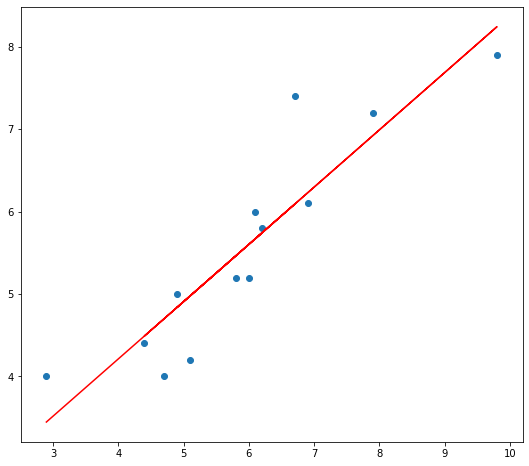

In [94]:
plt.figure(figsize=(9,8))
plt.plot(X,h,'r')
plt.scatter(X,y)

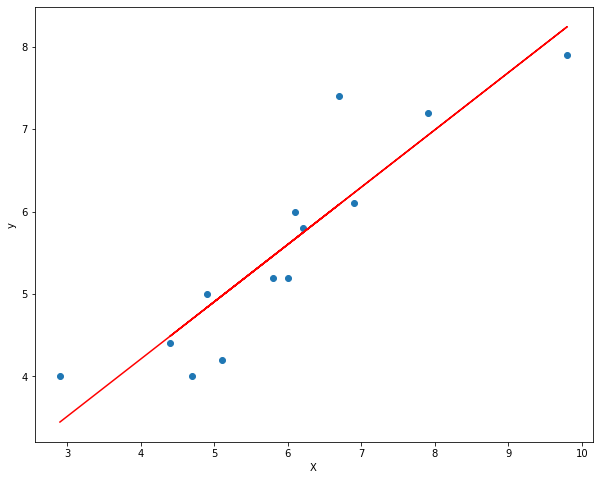

## Plot loss function
### Repeat your implementaion version and save loss for each iteration (epoch)

In [95]:
def gradient_descent (X,y,num_of_iterations):
    theta_0=0
    theta_1=0
    learning_rate=0.01
    loss=[]
    for i in range(0,num_of_iterations):
        print(f"****************** Iteration {i} ********************")
        h=theta_0 + theta_1 * X
        print("h(x): ",h)
        error_vector=(h-y)
        print("Error Vector:\n",error_vector)
        j=norm(error_vector)**2/(2*X.shape[0])
        print("j= ",j)
        loss.append(j)
        d_theta_0=np.sum(error_vector)/(X.shape[0])
        d_theta_1=np.sum(error_vector*X)/(X.shape[0])
        Gradient_Vector=np.array([[d_theta_0],[d_theta_1]])
        print("Gradient Vector:\n",Gradient_Vector)
        Gradient_Vector_Norm=norm(Gradient_Vector)
        print("Gradient Vector Norm:\n",Gradient_Vector_Norm)
        if Gradient_Vector_Norm <0.1:
            break
        theta_0=theta_0-learning_rate*d_theta_0
        print("theta_0_new : ",theta_0)
        theta_1=theta_1-learning_rate*d_theta_1
        print("theta_1_new : ",theta_1)
        
    return h , error_vector , j,Gradient_Vector,Gradient_Vector_Norm,theta_0,theta_1,loss
            

In [97]:
h , error_vector , j,Gradient_Vector,Gradient_Vector_Norm,theta_0,theta_1,loss=gradient_descent (X,y,20)
print("****************** Training Report ********************")
print("Gradient Descent converged after 14 iterations")
print("theta_0_Opt :",theta_0)
print("theta_1_Opt :",theta_1)
print("Error Vector:\n",error_vector)
print('Cost =',j)
print("h(x) = y_predict:\n",h)
print("y_actual:\n",y)

****************** Iteration 0 ********************
h(x):  [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
Error Vector:
 [-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]
j=  16.305384479692314
Gradient Vector:
 [[ -5.56923074]
 [-35.04384604]]
Gradient Vector Norm:
 35.483622652335995
theta_0_new :  0.0556923073976923
theta_1_new :  0.35043846043215376
****************** Iteration 1 ********************
h(x):  [1.07196388 2.40362993 1.7728408  2.82415618 3.48998929 2.47371772
 2.19336688 2.2284107  2.15832307 1.84292842 1.702753   1.59762157
 2.08823544]
Error Vector:
 [-2.92803612 -4.99637017 -3.2271592  -4.37584363 -4.41001081 -3.62628219
 -3.80663312 -3.5715895  -3.04167674 -2.35707139 -2.297247   -2.80237853
 -3.11176436]
j=  6.175608808043304
Gradient Vector:
 [[ -3.42708175]
 [-21.33845263]]
Gradient Vector Norm:
 21.611905283072655
theta_0_new :  0.08996312489803082
theta_1_new

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Error Vector:
[-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]

j = 16.305384479692318

Gradient Vector:
[[ -5.56923074]
 [-35.04384604]]

Gradient Vector Norm:
35.483622652336

theta_0_new : 0.0556923073976923
theta_1_new : 0.3504384604321538

****************** Iteration 1 ********************

h(x):[1.07196388 2.40362993 1.7728408  2.82415618 3.48998929 2.47371772
 2.19336688 2.2284107  2.15832307 1.84292842 1.702753   1.59762157
 2.08823544]

Error Vector:
[-2.92803612 -4.99637017 -3.2271592  -4.37584363 -4.41001081 -3.62628219
 -3.80663312 -3.5715895  -3.04167674 -2.35707139 -2.297247   -2.80237853
 -3.11176436]

j = 6.175608808043303

Gradient Vector:
[[ -3.42708175]
 [-21.33845263]]

Gradient Vector Norm:
21.61190528307266

theta_0_new : 0.08996312489803082
theta_1_new : 0.

### Plot loss vs. iterations

Text(0, 0.5, 'Loss')

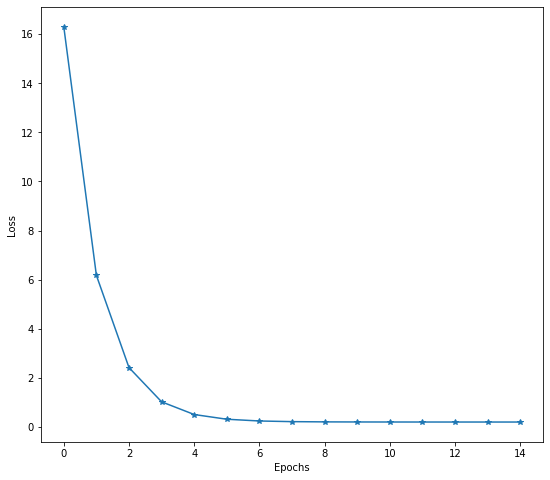

In [102]:
plt.figure(figsize=(9,8))
plt.plot(loss,'*-')
plt.xlabel('Epochs')
plt.ylabel('Loss')

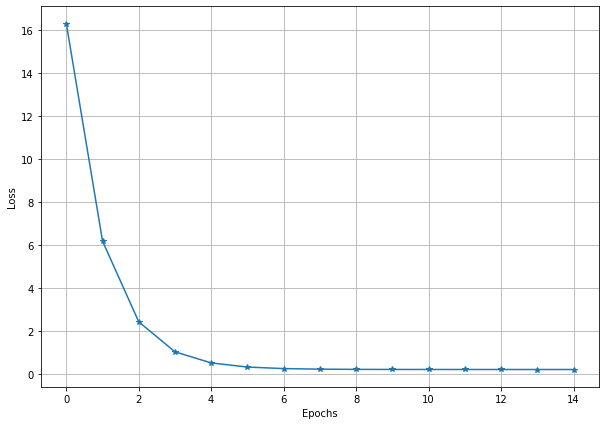

## Multivariate LR

#### Read MultiVarLR csv file into numpy array.
#### The first three columns are x1,x2, and x3.
#### The last column is the target label y.

In [103]:
data2 = np.genfromtxt('MultiVarLR.csv',delimiter=',')

In [104]:
data2

array([[ 73.,  80.,  75., 152.],
       [ 93.,  88.,  93., 185.],
       [ 89.,  91.,  90., 180.],
       [ 96.,  98., 100., 196.],
       [ 73.,  66.,  70., 142.],
       [ 53.,  46.,  55., 101.],
       [ 69.,  74.,  77., 149.],
       [ 47.,  56.,  60., 115.],
       [ 87.,  79.,  90., 175.],
       [ 79.,  70.,  88., 164.],
       [ 69.,  70.,  73., 141.],
       [ 70.,  65.,  74., 141.],
       [ 93.,  95.,  91., 184.],
       [ 79.,  80.,  73., 152.],
       [ 70.,  73.,  78., 148.],
       [ 93.,  89.,  96., 192.],
       [ 78.,  75.,  68., 147.],
       [ 81.,  90.,  93., 183.],
       [ 88.,  92.,  86., 177.],
       [ 78.,  83.,  77., 159.],
       [ 82.,  86.,  90., 177.],
       [ 86.,  82.,  89., 175.],
       [ 78.,  83.,  85., 175.],
       [ 76.,  83.,  71., 149.],
       [ 96.,  93.,  95., 192.]])

In [105]:
X2=data2[:,:-1]
X2

array([[ 73.,  80.,  75.],
       [ 93.,  88.,  93.],
       [ 89.,  91.,  90.],
       [ 96.,  98., 100.],
       [ 73.,  66.,  70.],
       [ 53.,  46.,  55.],
       [ 69.,  74.,  77.],
       [ 47.,  56.,  60.],
       [ 87.,  79.,  90.],
       [ 79.,  70.,  88.],
       [ 69.,  70.,  73.],
       [ 70.,  65.,  74.],
       [ 93.,  95.,  91.],
       [ 79.,  80.,  73.],
       [ 70.,  73.,  78.],
       [ 93.,  89.,  96.],
       [ 78.,  75.,  68.],
       [ 81.,  90.,  93.],
       [ 88.,  92.,  86.],
       [ 78.,  83.,  77.],
       [ 82.,  86.,  90.],
       [ 86.,  82.,  89.],
       [ 78.,  83.,  85.],
       [ 76.,  83.,  71.],
       [ 96.,  93.,  95.]])

In [109]:
X2.shape

(25, 3)

In [23]:
X2

array([[ 73.,  80.,  75.],
       [ 93.,  88.,  93.],
       [ 89.,  91.,  90.],
       [ 96.,  98., 100.],
       [ 73.,  66.,  70.],
       [ 53.,  46.,  55.],
       [ 69.,  74.,  77.],
       [ 47.,  56.,  60.],
       [ 87.,  79.,  90.],
       [ 79.,  70.,  88.],
       [ 69.,  70.,  73.],
       [ 70.,  65.,  74.],
       [ 93.,  95.,  91.],
       [ 79.,  80.,  73.],
       [ 70.,  73.,  78.],
       [ 93.,  89.,  96.],
       [ 78.,  75.,  68.],
       [ 81.,  90.,  93.],
       [ 88.,  92.,  86.],
       [ 78.,  83.,  77.],
       [ 82.,  86.,  90.],
       [ 86.,  82.,  89.],
       [ 78.,  83.,  85.],
       [ 76.,  83.,  71.],
       [ 96.,  93.,  95.]])

In [108]:
y2=data2[:,-1]
y2=y2.reshape(-1,1)
y2

array([[152.],
       [185.],
       [180.],
       [196.],
       [142.],
       [101.],
       [149.],
       [115.],
       [175.],
       [164.],
       [141.],
       [141.],
       [184.],
       [152.],
       [148.],
       [192.],
       [147.],
       [183.],
       [177.],
       [159.],
       [177.],
       [175.],
       [175.],
       [149.],
       [192.]])

In [110]:
y2.shape

(25, 1)

In [38]:
y2

array([[152.],
       [185.],
       [180.],
       [196.],
       [142.],
       [101.],
       [149.],
       [115.],
       [175.],
       [164.],
       [141.],
       [141.],
       [184.],
       [152.],
       [148.],
       [192.],
       [147.],
       [183.],
       [177.],
       [159.],
       [177.],
       [175.],
       [175.],
       [149.],
       [192.]])

### Generalize your implementation to work for MultiVariables
#### Vectorize your implementation.
<b>Notes:</b> 
- You need to add column that contains ones to the data. This column represent x feature for theta_0.
- Use learninig rate = 0.0001.

In [113]:
x_0=np.ones((X2.shape[0],1))
X2=np.hstack((x_0,X2))
X2

array([[  1.,  73.,  80.,  75.],
       [  1.,  93.,  88.,  93.],
       [  1.,  89.,  91.,  90.],
       [  1.,  96.,  98., 100.],
       [  1.,  73.,  66.,  70.],
       [  1.,  53.,  46.,  55.],
       [  1.,  69.,  74.,  77.],
       [  1.,  47.,  56.,  60.],
       [  1.,  87.,  79.,  90.],
       [  1.,  79.,  70.,  88.],
       [  1.,  69.,  70.,  73.],
       [  1.,  70.,  65.,  74.],
       [  1.,  93.,  95.,  91.],
       [  1.,  79.,  80.,  73.],
       [  1.,  70.,  73.,  78.],
       [  1.,  93.,  89.,  96.],
       [  1.,  78.,  75.,  68.],
       [  1.,  81.,  90.,  93.],
       [  1.,  88.,  92.,  86.],
       [  1.,  78.,  83.,  77.],
       [  1.,  82.,  86.,  90.],
       [  1.,  86.,  82.,  89.],
       [  1.,  78.,  83.,  85.],
       [  1.,  76.,  83.,  71.],
       [  1.,  96.,  93.,  95.]])

In [114]:
weights=np.zeros((X2.shape[1],1))
weights

array([[0.],
       [0.],
       [0.],
       [0.]])

In [123]:
def gradient_descent_Multifeatures (X,y,num_of_iterations):
    weights=np.zeros((X2.shape[1],1))
    learning_rate=0.0001
    loss=[]
    for i in range(0,num_of_iterations):
        print(f"****************** Iteration {i} ********************")
        h=X@weights
        print("h(x): ",h)
        error_vector=(h-y)
        print("Error Vector:\n",error_vector)
        j=norm(error_vector)**2/(2*X.shape[0])
        print("j= ",j)
        loss.append(j)
        Gradient_Vector=(X.T@error_vector)/X.shape[0]
        print("Gradient Vector:\n",Gradient_Vector)
        Gradient_Vector_Norm=norm(Gradient_Vector)
        print("Gradient Vector Norm:\n",Gradient_Vector_Norm)
        if Gradient_Vector_Norm <0.2:
            break
        weights=weights-learning_rate*Gradient_Vector
        print("thetas_new :\n",weights)
        
    return h , error_vector , j,Gradient_Vector,Gradient_Vector_Norm,weights,loss
            

In [124]:
 h , error_vector , j,Gradient_Vector,Gradient_Vector_Norm,weights,loss=gradient_descent_Multifeatures (X2,y2,8000)
print("****************** Training Report ********************")
print("Gradient Descent converged after 2575 iterations")
print("theta_Opt :",weights)
print("Error Vector:\n",error_vector)
print('Cost =',j)
print("h(x) = y_predict:\n",h)
print("y_actual:\n",y)

****************** Iteration 0 ********************
h(x):  [[0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]]
Error Vector:
 [[-152.]
 [-185.]
 [-180.]
 [-196.]
 [-142.]
 [-101.]
 [-149.]
 [-115.]
 [-175.]
 [-164.]
 [-141.]
 [-141.]
 [-184.]
 [-152.]
 [-148.]
 [-192.]
 [-147.]
 [-183.]
 [-177.]
 [-159.]
 [-177.]
 [-175.]
 [-175.]
 [-149.]
 [-192.]]
j=  13405.98
Gradient Vector:
 [[  -162.04]
 [-13075.8 ]
 [-13147.2 ]
 [-13467.08]]
Gradient Vector Norm:
 22917.545989219703
thetas_new :
 [[0.016204]
 [1.30758 ]
 [1.31472 ]
 [1.346708]]
****************** Iteration 1 ********************
h(x):  [[301.650244]
 [362.560348]
 [357.234064]
 [389.057244]
 [276.510624]
 [203.864004]
 [291.22502 ]
 [215.899264]
 [338.842264]
 [313.855728]
 [280.579308]
 [276.659996]
 [369.069972]
 [306.802308]
 [292.564588]
 [367.915192]
 [292.187588]
 [349.498828]
 [351.854372]
 [314.82572 ]
 [341.507404]
 [340.1

Gradient Vector Norm:
 1793.2781754977793
thetas_new :
 [[0.00875444]
 [0.69298544]
 [0.69451609]
 [0.78857387]]
****************** Iteration 63 ********************
h(x):  [[165.30101836]
 [198.91118543]
 [195.85707033]
 [213.45531967]
 [151.63492383]
 [112.05628532]
 [159.93912781]
 [118.78640287]
 [186.13690642]
 [172.76523039]
 [154.00676801]
 [152.01574689]
 [202.1956503 ]
 [167.88178327]
 [160.72617103]
 [201.97142312]
 [159.77334808]
 [191.98439232]
 [192.70430552]
 [172.42664155]
 [187.53359182]
 [186.73889537]
 [178.73523247]
 [166.30922748]
 [206.03986992]]
Error Vector:
 [[13.30101836]
 [13.91118543]
 [15.85707033]
 [17.45531967]
 [ 9.63492383]
 [11.05628532]
 [10.93912781]
 [ 3.78640287]
 [11.13690642]
 [ 8.76523039]
 [13.00676801]
 [11.01574689]
 [18.1956503 ]
 [15.88178327]
 [12.72617103]
 [ 9.97142312]
 [12.77334808]
 [ 8.98439232]
 [15.70430552]
 [13.42664155]
 [10.53359182]
 [11.73889537]
 [ 3.73523247]
 [17.30922748]
 [14.03986992]]
j=  80.83885616774924
Gradient Vect

h(x):  [[152.48893625]
 [183.68892152]
 [180.75730379]
 [197.13241589]
 [139.96874347]
 [103.66391964]
 [147.85251388]
 [110.00497038]
 [172.10048953]
 [160.0492808 ]
 [142.28940233]
 [140.58684956]
 [186.47366908]
 [154.64956621]
 [148.62387371]
 [186.62429888]
 [147.07813853]
 [177.51541895]
 [177.66904475]
 [158.97666137]
 [173.34214537]
 [172.566086  ]
 [165.15505928]
 [153.10778646]
 [190.17852646]]
Error Vector:
 [[ 0.48893625]
 [-1.31107848]
 [ 0.75730379]
 [ 1.13241589]
 [-2.03125653]
 [ 2.66391964]
 [-1.14748612]
 [-4.99502962]
 [-2.89951047]
 [-3.9507192 ]
 [ 1.28940233]
 [-0.41315044]
 [ 2.47366908]
 [ 2.64956621]
 [ 0.62387371]
 [-5.37570112]
 [ 0.07813853]
 [-5.48458105]
 [ 0.66904475]
 [-0.02333863]
 [-3.65785463]
 [-2.433914  ]
 [-9.84494072]
 [ 4.10778646]
 [-1.82147354]]
j=  5.530637273668646
Gradient Vector:
 [[  -1.13823912]
 [ -90.93269919]
 [ -91.54160365]
 [-103.7833953 ]]
Gradient Vector Norm:
 165.592601610515
thetas_new :
 [[0.00802632]
 [0.62663151]
 [0.627632

 [191.60951787]]
Error Vector:
 [[ 1.57246213]
 [ 0.14381314]
 [ 2.10302565]
 [ 2.7101214 ]
 [-0.97631456]
 [ 3.63240796]
 [ 0.15734216]
 [-3.85903685]
 [-1.36747563]
 [-2.27026665]
 [ 2.47685933]
 [ 0.8679998 ]
 [ 3.75174488]
 [ 3.56173706]
 [ 1.96989292]
 [-3.80652989]
 [ 0.85799833]
 [-3.88310413]
 [ 1.84617048]
 [ 1.03373212]
 [-2.14568362]
 [-0.96932124]
 [-8.44812281]
 [ 4.93885291]
 [-0.39048213]]
j=  4.482400599605672
Gradient Vector:
 [[ 0.14031291]
 [11.55368827]
 [11.27032997]
 [ 2.68434123]]
Gradient Vector Norm:
 16.362561714043082
thetas_new :
 [[0.00776257]
 [0.60197983]
 [0.60422554]
 [0.8144997 ]]
****************** Iteration 180 ********************
h(x):  [[153.37781097]
 [184.91220653]
 [181.87346472]
 [198.46189932]
 [140.84615492]
 [104.50455199]
 [148.97353781]
 [111.00742689]
 [173.41879858]
 [161.53593067]
 [143.29863685]
 [141.69398868]
 [187.5127859 ]
 [155.36069056]
 [149.7857918 ]
 [187.95993117]
 [147.66508453]
 [178.89689962]
 [178.61771163]
 [159.8293861

 [-0.59306646]]
j=  4.195678662334532
Gradient Vector:
 [[ 0.03253333]
 [ 2.21776352]
 [ 1.69181619]
 [-6.01550224]]
Gradient Vector Norm:
 6.630840272921032
thetas_new :
 [[0.00753602]
 [0.58428722]
 [0.58907753]
 [0.84782878]]
****************** Iteration 239 ********************
h(x):  [[153.37386366]
 [185.03314628]
 [181.91974365]
 [198.61158466]
 [140.88763438]
 [104.70290774]
 [149.19790715]
 [111.32710357]
 [173.68223886]
 [162.01058578]
 [143.45028193]
 [141.93701029]
 [187.46103143]
 [155.18392944]
 [150.04094562]
 [188.16571013]
 [147.41511069]
 [179.19985468]
 [178.53321886]
 [159.7581899 ]
 [174.88434546]
 [174.01735545]
 [166.54082011]
 [153.50264281]
 [191.42705314]]
Error Vector:
 [[ 1.37386366]
 [ 0.03314628]
 [ 1.91974365]
 [ 2.61158466]
 [-1.11236562]
 [ 3.70290774]
 [ 0.19790715]
 [-3.67289643]
 [-1.31776114]
 [-1.98941422]
 [ 2.45028193]
 [ 0.93701029]
 [ 3.46103143]
 [ 3.18392944]
 [ 2.04094562]
 [-3.83428987]
 [ 0.41511069]
 [-3.80014532]
 [ 1.53321886]
 [ 0.7581

 [[ 1.28254072]
 [ 0.01689838]
 [ 1.84903643]
 [ 2.61423486]
 [-1.16730924]
 [ 3.79613256]
 [ 0.29205118]
 [-3.47700094]
 [-1.21397662]
 [-1.70890368]
 [ 2.48703375]
 [ 1.04502374]
 [ 3.30796784]
 [ 2.94888697]
 [ 2.15829814]
 [-3.78346702]
 [ 0.1234941 ]
 [-3.65842611]
 [ 1.36021912]
 [ 0.60771908]
 [-2.02013235]
 [-0.9260951 ]
 [-8.39875998]
 [ 4.22433621]
 [-0.64203693]]
j=  3.9896643008529513
Gradient Vector:
 [[ 0.0447106 ]
 [ 2.67271967]
 [ 2.00961712]
 [-4.80171948]]
Gradient Vector Norm:
 5.851538295772107
thetas_new :
 [[0.00729924]
 [0.56885381]
 [0.57686328]
 [0.87467029]]
****************** Iteration 293 ********************
h(x):  [[153.28296135]
 [185.01900898]
 [181.85017271]
 [198.61689522]
 [140.833524  ]
 [104.79912789]
 [149.29570702]
 [111.52798927]
 [173.79010575]
 [162.29816518]
 [143.48957274]
 [142.04878045]
 [187.30771136]
 [154.94674363]
 [150.16236784]
 [188.21988313]
 [147.12022198]
 [179.34648982]
 [178.35950102]
 [159.60716081]
 [174.98387965]
 [174.077171

 [-0.69808782]]
j=  3.8145248429277183
Gradient Vector:
 [[ 0.04959571]
 [ 2.5610993 ]
 [ 1.78123507]
 [-4.20721398]]
Gradient Vector Norm:
 5.237856165170297
thetas_new :
 [[0.00702745]
 [0.5537434 ]
 [0.56588415]
 [0.90007478]]
****************** Iteration 350 ********************
h(x):  [[153.20663601]
 [185.00992321]
 [181.79237773]
 [198.63051836]
 [140.78388401]
 [104.89021134]
 [149.39650706]
 [111.72696634]
 [173.89428112]
 [162.57122701]
 [143.53267135]
 [142.15706878]
 [187.17096271]
 [154.72894686]
 [150.28444109]
 [188.27603169]
 [146.84540881]
 [179.49677071]
 [178.20421937]
 [159.47315502]
 [175.08675318]
 [174.1381154 ]
 [166.67375324]
 [152.96521955]
 [191.30072372]]
Error Vector:
 [[ 1.20663601]
 [ 0.00992321]
 [ 1.79237773]
 [ 2.63051836]
 [-1.21611599]
 [ 3.89021134]
 [ 0.39650706]
 [-3.27303366]
 [-1.10571888]
 [-1.42877299]
 [ 2.53267135]
 [ 1.15706878]
 [ 3.17096271]
 [ 2.72894686]
 [ 2.28444109]
 [-3.72396831]
 [-0.15459119]
 [-3.50322929]
 [ 1.20421937]
 [ 0.473

 [[ 0.05284413]
 [ 2.3725026 ]
 [ 1.50417247]
 [-3.77395753]]
Gradient Vector Norm:
 4.704981543199634
thetas_new :
 [[0.00674058]
 [0.53996901]
 [0.55674064]
 [0.92240113]]
****************** Iteration 406 ********************
h(x):  [[153.14381461]
 [185.00034032]
 [181.74348282]
 [198.64446171]
 [140.73743995]
 [104.96722992]
 [149.48829698]
 [111.90682796]
 [173.98265708]
 [162.80743696]
 [143.57172988]
 [142.25039681]
 [187.05272256]
 [154.5388264 ]
 [150.39392648]
 [188.32428436]
 [146.60314852]
 [179.6341935 ]
 [178.07064992]
 [159.35868385]
 [175.17999654]
 [174.19050887]
 [166.73789291]
 [152.74433904]
 [191.24875283]]
Error Vector:
 [[ 1.14381461e+00]
 [ 3.40322934e-04]
 [ 1.74348282e+00]
 [ 2.64446171e+00]
 [-1.26256005e+00]
 [ 3.96722992e+00]
 [ 4.88296984e-01]
 [-3.09317204e+00]
 [-1.01734292e+00]
 [-1.19256304e+00]
 [ 2.57172988e+00]
 [ 1.25039681e+00]
 [ 3.05272256e+00]
 [ 2.53882640e+00]
 [ 2.39392648e+00]
 [-3.67571564e+00]
 [-3.96851482e-01]
 [-3.36580650e+00]
 [ 1.07

 [-3.38225477]]
Gradient Vector Norm:
 4.2319225096154955
thetas_new :
 [[0.00643604]
 [0.52717301]
 [0.54900483]
 [0.94240031]]
****************** Iteration 462 ********************
h(x):  [[153.09047586]
 [184.9891804 ]
 [181.7003019 ]
 [198.65754993]
 [140.69240668]
 [105.03284513]
 [149.57255546]
 [112.07185692]
 [174.05789792]
 [163.01466973]
 [143.60693489]
 [142.33148407]
 [186.94741358]
 [154.3687133 ]
 [150.49312396]
 [188.36538617]
 [146.38451457]
 [179.76111391]
 [177.95253245]
 [159.25815604]
 [175.26506666]
 [174.23533908]
 [166.79735855]
 [152.54940813]
 [191.20052421]]
Error Vector:
 [[ 1.09047586]
 [-0.0108196 ]
 [ 1.7003019 ]
 [ 2.65754993]
 [-1.30759332]
 [ 4.03284513]
 [ 0.57255546]
 [-2.92814308]
 [-0.94210208]
 [-0.98533027]
 [ 2.60693489]
 [ 1.33148407]
 [ 2.94741358]
 [ 2.3687133 ]
 [ 2.49312396]
 [-3.63461383]
 [-0.61548543]
 [-3.23888609]
 [ 0.95253245]
 [ 0.25815604]
 [-1.73493334]
 [-0.76466092]
 [-8.20264145]
 [ 3.54940813]
 [-0.79947579]]
j=  3.562570292263

 [191.15352217]]
Error Vector:
 [[ 1.04321413]
 [-0.02381274]
 [ 1.66032023]
 [ 2.67053892]
 [-1.35334519]
 [ 4.09132078]
 [ 0.6539643 ]
 [-2.76883353]
 [-0.8750792 ]
 [-0.7944564 ]
 [ 2.6403509 ]
 [ 1.40539721]
 [ 2.84892313]
 [ 2.20877826]
 [ 2.58769619]
 [-3.59794548]
 [-0.82290983]
 [-3.11552603]
 [ 0.84289247]
 [ 0.16554892]
 [-1.65323613]
 [-0.72446831]
 [-8.14459545]
 [ 3.36881452]
 [-0.84647783]]
j=  3.4680260037524255
Gradient Vector:
 [[ 0.05868295]
 [ 2.03673534]
 [ 1.0529261 ]
 [-3.00903588]]
Gradient Vector Norm:
 3.7834752344579994
thetas_new :
 [[0.00609221]
 [0.51446767]
 [0.5420661 ]
 [0.96153286]]
****************** Iteration 522 ********************
h(x):  [[153.04248445]
 [184.97595804]
 [181.65968711]
 [198.67075208]
 [140.64589471]
 [105.09222645]
 [149.65528288]
 [112.23374577]
 [174.12595854]
 [163.20855656]
 [143.64088703]
 [142.40655704]
 [186.84735505]
 [154.20622474]
 [150.5892173 ]
 [188.40262272]
 [146.17376227]
 [179.88647825]
 [177.84115412]
 [159.164086

 [-2.71007144]]
Gradient Vector Norm:
 3.4253984093051595
thetas_new :
 [[0.00576888]
 [0.50385584]
 [0.53685253]
 [0.9769447 ]]
****************** Iteration 576 ********************
h(x):  [[153.0063004 ]
 [184.96324216]
 [181.62754225]
 [198.68194789]
 [140.60564151]
 [105.13730354]
 [149.72365128]
 [112.36741727]
 [174.17760025]
 [163.36119135]
 [143.66846235]
 [142.46500027]
 [186.76732044]
 [154.07554605]
 [150.6675993 ]
 [188.4309288 ]
 [146.00270405]
 [179.99067709]
 [177.75276012]
 [159.09002661]
 [175.41628872]
 [174.30735728]
 [166.90558424]
 [152.22064669]
 [191.11296173]]
Error Vector:
 [[ 1.0063004 ]
 [-0.03675784]
 [ 1.62754225]
 [ 2.68194789]
 [-1.39435849]
 [ 4.13730354]
 [ 0.72365128]
 [-2.63258273]
 [-0.82239975]
 [-0.63880865]
 [ 2.66846235]
 [ 1.46500027]
 [ 2.76732044]
 [ 2.07554605]
 [ 2.6675993 ]
 [-3.5690712 ]
 [-0.99729595]
 [-3.00932291]
 [ 0.75276012]
 [ 0.09002661]
 [-1.58371128]
 [-0.69264272]
 [-8.09441576]
 [ 3.22064669]
 [-0.88703827]]
j=  3.396705862137

 [[ 0.06295486]
 [ 1.77561056]
 [ 0.74697805]
 [-2.45635567]]
Gradient Vector Norm:
 3.1222452746844658
thetas_new :
 [[0.00545265]
 [0.49449823]
 [0.53270557]
 [0.99009524]]
****************** Iteration 627 ********************
h(x):  [[152.97741198]
 [184.95073545]
 [181.60057352]
 [198.69195251]
 [140.56905781]
 [105.17355322]
 [149.78337611]
 [112.48409572]
 [174.21911022]
 [163.48858377]
 [143.69217288]
 [142.5132385 ]
 [186.69948396]
 [153.96421089]
 [150.73526401]
 [188.45372673]
 [145.85570861]
 [180.08216782]
 [177.6783999 ]
 [159.02821032]
 [175.47555805]
 [174.33263346]
 [166.94897223]
 [152.09864243]
 [191.07794847]]
Error Vector:
 [[ 0.97741198]
 [-0.04926455]
 [ 1.60057352]
 [ 2.69195251]
 [-1.43094219]
 [ 4.17355322]
 [ 0.78337611]
 [-2.51590428]
 [-0.78088978]
 [-0.51141623]
 [ 2.69217288]
 [ 1.5132385 ]
 [ 2.69948396]
 [ 1.96421089]
 [ 2.73526401]
 [-3.54627327]
 [-1.14429139]
 [-2.91783218]
 [ 0.6783999 ]
 [ 0.02821032]
 [-1.52444195]
 [-0.66736654]
 [-8.05102777]
 [ 

 [[ 0.06497054]
 [ 1.64640763]
 [ 0.61104446]
 [-2.19797719]]
Gradient Vector Norm:
 2.8141354476125526
thetas_new :
 [[0.00508145]
 [0.48458569]
 [0.52878427]
 [1.00356523]]
****************** Iteration 685 ********************
h(x):  [[152.94997094]
 [184.93613306]
 [181.57344743]
 [198.70268948]
 [140.52916495]
 [105.20828725]
 [149.846053  ]
 [112.606442  ]
 [174.25886477]
 [163.61599034]
 [143.71665499]
 [142.56088454]
 [186.63049251]
 [153.85035461]
 [150.80541965]
 [188.47561303]
 [145.70402139]
 [180.17867334]
 [177.60338509]
 [158.96638266]
 [175.53742624]
 [174.35706667]
 [166.99490451]
 [151.9758199 ]
 [191.04094195]]
Error Vector:
 [[ 0.94997094]
 [-0.06386694]
 [ 1.57344743]
 [ 2.70268948]
 [-1.47083505]
 [ 4.20828725]
 [ 0.846053  ]
 [-2.393558  ]
 [-0.74113523]
 [-0.38400966]
 [ 2.71665499]
 [ 1.56088454]
 [ 2.63049251]
 [ 1.85035461]
 [ 2.80541965]
 [-3.52438697]
 [-1.29597861]
 [-2.82132666]
 [ 0.60338509]
 [-0.03361734]
 [-1.46257376]
 [-0.64293333]
 [-8.00509549]
 [ 

j=  3.251215322574733
Gradient Vector:
 [[ 0.0667459 ]
 [ 1.5288329 ]
 [ 0.49660222]
 [-1.97189852]]
Gradient Vector Norm:
 2.5449523755988857
thetas_new :
 [[0.00470588]
 [0.47554638]
 [0.52564159]
 [1.01542575]]
****************** Iteration 742 ********************
h(x):  [[152.92785002]
 [184.9215738 ]
 [181.55003582]
 [198.71260909]
 [140.491739  ]
 [105.23659334]
 [149.90266643]
 [112.71685971]
 [174.29124395]
 [163.72524707]
 [143.73839708]
 [142.60116124]
 [186.57021346]
 [153.75027682]
 [150.86799697]
 [188.49349263]
 [145.56939375]
 [180.26630042]
 [177.53842805]
 [158.9133582 ]
 [175.59300319]
 [174.3771966 ]
 [167.03676416]
 [151.86971096]
 [191.0072724 ]]
Error Vector:
 [[ 0.92785002]
 [-0.0784262 ]
 [ 1.55003582]
 [ 2.71260909]
 [-1.508261  ]
 [ 4.23659334]
 [ 0.90266643]
 [-2.28314029]
 [-0.70875605]
 [-0.27475293]
 [ 2.73839708]
 [ 1.60116124]
 [ 2.57021346]
 [ 1.75027682]
 [ 2.86799697]
 [-3.50650737]
 [-1.43060625]
 [-2.73369958]
 [ 0.53842805]
 [-0.0866418 ]
 [-1.4069

 [[ 0.90844489]
 [-0.09431384]
 [ 1.52777257]
 [ 2.72272498]
 [-1.54698062]
 [ 4.26176443]
 [ 0.95913393]
 [-2.17310022]
 [-0.67998114]
 [-0.17158789]
 [ 2.75971199]
 [ 1.63858022]
 [ 2.51212327]
 [ 1.65321339]
 [ 2.92962353]
 [-3.49055807]
 [-1.56250884]
 [-2.64584072]
 [ 0.47643254]
 [-0.13671481]
 [-1.35186773]
 [-0.60466005]
 [-7.92111366]
 [ 2.76869474]
 [-1.02655245]]
j=  3.214543657177706
Gradient Vector:
 [[ 0.06849762]
 [ 1.40886472]
 [ 0.38921317]
 [-1.75038593]]
Gradient Vector Norm:
 2.281431460371032
thetas_new :
 [[0.00427967]
 [0.46630391]
 [0.52286642]
 [1.02712518]]
****************** Iteration 805 ********************
h(x):  [[152.90816752]
 [184.90543038]
 [181.52743846]
 [198.7228826 ]
 [140.45241171]
 [105.26212733]
 [149.96000371]
 [112.82859399]
 [174.32043358]
 [163.82995413]
 [143.7600373 ]
 [142.63913428]
 [186.51124497]
 [153.65174062]
 [150.93056638]
 [188.50967235]
 [145.43547869]
 [180.35551629]
 [177.47550024]
 [158.8625367 ]
 [175.64897897]
 [174.3956037

 [[ 0.89815272]
 [-0.10451658]
 [ 1.51498085]
 [ 2.72889696]
 [-1.5708744 ]
 [ 4.27530763]
 [ 0.99296249]
 [-2.10722435]
 [-0.66450803]
 [-0.11269701]
 [ 2.77229498]
 [ 1.65961598]
 [ 2.47834241]
 [ 1.59644635]
 [ 2.96614692]
 [-3.48194767]
 [-1.64033731]
 [-2.59297618]
 [ 0.44069337]
 [-0.16530128]
 [-1.31899339]
 [-0.59476074]
 [-7.89569316]
 [ 2.71059407]
 [-1.04693742]]
j=  3.195071265121498
Gradient Vector:
 [[ 0.06950669]
 [ 1.33774651]
 [ 0.33015255]
 [-1.62356665]]
Gradient Vector Norm:
 2.1305788568438633
thetas_new :
 [[0.00400358]
 [0.4608155 ]
 [0.52143284]
 [1.03386337]]
****************** Iteration 845 ********************
h(x):  [[152.89791575]
 [184.89522926]
 [181.51467566]
 [198.72904782]
 [140.42853906]
 [105.27562154]
 [149.99378342]
 [112.89437384]
 [174.33585052]
 [163.88870416]
 [143.77259855]
 [142.6601132 ]
 [186.47753242]
 [153.59508202]
 [150.96702945]
 [188.51825222]
 [145.35778543]
 [180.40830892]
 [177.43983952]
 [158.83401854]
 [175.68180293]
 [174.405470

 [-1.06861119]]
j=  3.1761086253356847
Gradient Vector:
 [[ 0.0705551 ]
 [ 1.26211953]
 [ 0.2712004 ]
 [-1.49247194]]
Gradient Vector Norm:
 1.974574860825332
thetas_new :
 [[0.00368836]
 [0.45497127]
 [0.52008557]
 [1.04086351]]
****************** Iteration 890 ********************
h(x):  [[152.88819989]
 [184.88385305]
 [181.50163414]
 [198.73566711]
 [140.40268439]
 [105.28859493]
 [150.0295284 ]
 [112.96394051]
 [174.35066476]
 [163.94839743]
 [143.78573209]
 [142.68113903]
 [186.44272502]
 [153.53630052]
 [151.00527761]
 [188.52652914]
 [145.27658387]
 [180.4643689 ]
 [177.40329441]
 [158.80503999]
 [175.71640738]
 [174.41508669]
 [167.13194804]
 [151.6499164 ]
 [190.93092173]]
Error Vector:
 [[ 0.88819989]
 [-0.11614695]
 [ 1.50163414]
 [ 2.73566711]
 [-1.59731561]
 [ 4.28859493]
 [ 1.0295284 ]
 [-2.03605949]
 [-0.64933524]
 [-0.05160257]
 [ 2.78573209]
 [ 1.68113903]
 [ 2.44272502]
 [ 1.53630052]
 [ 3.00527761]
 [-3.47347086]
 [-1.72341613]
 [-2.5356311 ]
 [ 0.40329441]
 [-0.194

h(x):  [[152.87846503]
 [184.86990779]
 [181.48715719]
 [198.74345744]
 [140.37196296]
 [105.30186764]
 [150.07090584]
 [113.04441502]
 [174.36581083]
 [164.01419218]
 [143.80072317]
 [142.70391037]
 [186.40359019]
 [153.46982311]
 [151.04910359]
 [188.53503952]
 [145.18393742]
 [180.52952479]
 [177.36258035]
 [158.77309579]
 [175.75629251]
 [174.42511835]
 [167.16344002]
 [151.5840229 ]
 [190.90572911]]
Error Vector:
 [[ 0.87846503]
 [-0.13009221]
 [ 1.48715719]
 [ 2.74345744]
 [-1.62803704]
 [ 4.30186764]
 [ 1.07090584]
 [-1.95558498]
 [-0.63418917]
 [ 0.01419218]
 [ 2.80072317]
 [ 1.70391037]
 [ 2.40359019]
 [ 1.46982311]
 [ 3.04910359]
 [-3.46496048]
 [-1.81606258]
 [-2.47047521]
 [ 0.36258035]
 [-0.22690421]
 [-1.24370749]
 [-0.57488165]
 [-7.83655998]
 [ 2.5840229 ]
 [-1.09427089]]
j=  3.1558552669788185
Gradient Vector:
 [[ 0.07176293]
 [ 1.17256583]
 [ 0.20664934]
 [-1.34237304]]
Gradient Vector Norm:
 1.7957532867027841
thetas_new :
 [[0.00328263]
 [0.4480401 ]
 [0.51873197]
 

 [190.88193392]]
Error Vector:
 [[ 0.87086538]
 [-0.14397827]
 [ 1.47419533]
 [ 2.7509039 ]
 [-1.65769365]
 [ 4.31255022]
 [ 1.10975932]
 [-1.88007489]
 [-0.62200864]
 [ 0.07260432]
 [ 2.81458333]
 [ 1.72369391]
 [ 2.36802279]
 [ 1.4089973 ]
 [ 3.08979836]
 [-3.45806051]
 [-1.90168196]
 [-2.40902539]
 [ 0.32597065]
 [-0.25526811]
 [-1.20643022]
 [-0.56658344]
 [-7.80677308]
 [ 2.52494205]
 [-1.11806608]]
j=  3.1390794053546993
Gradient Vector:
 [[ 0.0728497 ]
 [ 1.08949917]
 [ 0.15200307]
 [-1.2082562 ]]
Gradient Vector Norm:
 1.6356355022742488
thetas_new :
 [[0.00287038]
 [0.44160033]
 [0.51771692]
 [1.0561827 ]]
****************** Iteration 1004 ********************
h(x):  [[152.87075065]
 [184.85578126]
 [181.47398258]
 [198.75103035]
 [140.34180029]
 [105.31271479]
 [150.11041324]
 [113.1211955 ]
 [174.37817892]
 [164.07355862]
 [143.81481475]
 [142.7240132 ]
 [186.36743427]
 [153.40798722]
 [151.09047935]
 [188.54204629]
 [145.09688878]
 [180.59201114]
 [177.32536835]
 [158.74426

 [[ 0.07381191]
 [ 1.0137372 ]
 [ 0.10667067]
 [-1.0903386 ]]
Gradient Vector Norm:
 1.4944323989463018
thetas_new :
 [[0.00245963]
 [0.43571766]
 [0.51699849]
 [1.06260684]]
****************** Iteration 1060 ********************
h(x):  [[152.86524046]
 [184.8425046 ]
 [181.46280891]
 [198.75789031]
 [140.31422745]
 [105.32080199]
 [150.14559259]
 [113.18951511]
 [174.38739176]
 [164.12345045]
 [143.82717129]
 [142.74050335]
 [186.33628033]
 [153.35433272]
 [151.1269186 ]
 [188.5473236 ]
 [145.02058844]
 [180.64788969]
 [177.29366238]
 [158.72003788]
 [175.82779288]
 [174.44006272]
 [167.2208926 ]
 [151.47296153]
 [190.85986368]]
Error Vector:
 [[ 0.86524046]
 [-0.1574954 ]
 [ 1.46280891]
 [ 2.75789031]
 [-1.68577255]
 [ 4.32080199]
 [ 1.14559259]
 [-1.81048489]
 [-0.61260824]
 [ 0.12345045]
 [ 2.82717129]
 [ 1.74050335]
 [ 2.33628033]
 [ 1.35433272]
 [ 3.1269186 ]
 [-3.4526764 ]
 [-1.97941156]
 [-2.35211031]
 [ 0.29366238]
 [-0.27996212]
 [-1.17220712]
 [-0.55993728]
 [-7.7791074 ]
 [

 [[ 0.86095007]
 [-0.17195251]
 [ 1.45182942]
 [ 2.76510846]
 [-1.71503682]
 [ 4.32753562]
 [ 1.181983  ]
 [-1.73986541]
 [-0.60494552]
 [ 0.17197827]
 [ 2.83975429]
 [ 1.75609759]
 [ 2.30513414]
 [ 1.30029008]
 [ 3.16419342]
 [-3.44821454]
 [-2.05708261]
 [-2.29406056]
 [ 0.26234781]
 [-0.30353479]
 [-1.13761207]
 [-0.55422238]
 [-7.7508116 ]
 [ 2.42274922]
 [-1.16267742]]
j=  3.112421731754961
Gradient Vector:
 [[ 0.07479741]
 [ 0.93370265]
 [ 0.06358371]
 [-0.97046319]]
Gradient Vector Norm:
 1.3502729269634461
thetas_new :
 [[0.00198397]
 [0.42949343]
 [0.51646042]
 [1.06918744]]
****************** Iteration 1124 ********************
h(x):  [[152.86089637]
 [184.82782234]
 [181.45166755]
 [198.76521895]
 [140.28451326]
 [105.32762457]
 [150.18253502]
 [113.26120542]
 [174.39515564]
 [164.17268953]
 [143.83994355]
 [142.75632233]
 [186.3046704 ]
 [153.29948206]
 [151.16475547]
 [188.5518451 ]
 [144.9417493 ]
 [180.70682202]
 [177.26188476]
 [158.69611967]
 [175.86291144]
 [174.44585

 [[ 0.07546482]
 [ 0.87792721]
 [ 0.03654975]
 [-0.88984751]]
Gradient Vector Norm:
 1.2528430018449213
thetas_new :
 [[0.00162329]
 [0.42514971]
 [0.51622313]
 [1.07364516]]
****************** Iteration 1172 ********************
h(x):  [[152.85878925]
 [184.81718134]
 [181.4443164 ]
 [198.77037787]
 [140.26343966]
 [105.33130555]
 [150.20814199]
 [113.31086439]
 [174.39933947]
 [164.20484335]
 [143.84866883]
 [142.76634807]
 [186.2834529 ]
 [153.26239717]
 [151.19071374]
 [188.55433996]
 [144.88790601]
 [180.74783111]
 [177.24080917]
 [158.68049749]
 [175.88715282]
 [174.44921398]
 [167.2696588 ]
 [151.3883271 ]
 [190.82103642]]
Error Vector:
 [[ 0.85878925]
 [-0.18281866]
 [ 1.4443164 ]
 [ 2.77037787]
 [-1.73656034]
 [ 4.33130555]
 [ 1.20814199]
 [-1.68913561]
 [-0.60066053]
 [ 0.20484335]
 [ 2.84866883]
 [ 1.76634807]
 [ 2.2834529 ]
 [ 1.26239717]
 [ 3.19071374]
 [-3.44566004]
 [-2.11209399]
 [-2.25216889]
 [ 0.24080917]
 [-0.31950251]
 [-1.11284718]
 [-0.55078602]
 [-7.7303412 ]
 [

j=  3.09621017873798
Gradient Vector:
 [[ 0.07617372]
 [ 0.81712537]
 [ 0.00995155]
 [-0.80477321]]
Gradient Vector Norm:
 1.1494586849308759
thetas_new :
 [[0.00119863]
 [0.42040867]
 [0.51609657]
 [1.07838157]]
****************** Iteration 1228 ********************
h(x):  [[152.85737503]
 [184.80518925]
 [181.43669958]
 [198.77605196]
 [140.24011517]
 [105.33428677]
 [150.23592403]
 [113.3647083 ]
 [174.40272336]
 [164.2378217 ]
 [143.85801148]
 [142.77631885]
 [186.26110213]
 [153.22306393]
 [151.2186177 ]
 [188.55643053]
 [144.83026456]
 [180.79247833]
 [177.21886122]
 [158.66447124]
 [175.91335601]
 [174.45222284]
 [167.29152377]
 [151.35336449]
 [190.80366127]]
Error Vector:
 [[ 0.85737503]
 [-0.19481075]
 [ 1.43669958]
 [ 2.77605196]
 [-1.75988483]
 [ 4.33428677]
 [ 1.23592403]
 [-1.6352917 ]
 [-0.59727664]
 [ 0.2378217 ]
 [ 2.85801148]
 [ 1.77631885]
 [ 2.26110213]
 [ 1.22306393]
 [ 3.2186177 ]
 [-3.44356947]
 [-2.16973544]
 [-2.20752167]
 [ 0.21886122]
 [-0.33552876]
 [-1.0866

****************** Iteration 1285 ********************
h(x):  [[152.85690468]
 [184.79346478]
 [181.4298873 ]
 [198.78146749]
 [140.21771348]
 [105.3360912 ]
 [150.26206405]
 [113.41533666]
 [174.40476714]
 [164.26696932]
 [143.86667941]
 [142.78480512]
 [186.24073286]
 [153.18694467]
 [151.24461661]
 [188.55778984]
 [144.77679406]
 [180.83464041]
 [177.19911639]
 [158.65030279]
 [175.93791503]
 [174.45442801]
 [167.31221839]
 [151.32202646]
 [190.78723668]]
Error Vector:
 [[ 0.85690468]
 [-0.20653522]
 [ 1.4298873 ]
 [ 2.78146749]
 [-1.78228652]
 [ 4.3360912 ]
 [ 1.26206405]
 [-1.58466334]
 [-0.59523286]
 [ 0.26696932]
 [ 2.86667941]
 [ 1.78480512]
 [ 2.24073286]
 [ 1.18694467]
 [ 3.24461661]
 [-3.44221016]
 [-2.22320594]
 [-2.16535959]
 [ 0.19911639]
 [-0.34969721]
 [-1.06208497]
 [-0.54557199]
 [-7.68778161]
 [ 2.32202646]
 [-1.21276332]]
j=  3.08917849188828
Gradient Vector:
 [[ 0.07683651]
 [ 0.7586604 ]
 [-0.01273137]
 [-0.72579551]]
Gradient Vector Norm:
 1.0528108368765023
thet

Error Vector:
 [[ 0.85733025]
 [-0.21910928]
 [ 1.42322864]
 [ 2.78714209]
 [-1.80590305]
 [ 4.33689248]
 [ 1.28905679]
 [-1.53241924]
 [-0.59433027]
 [ 0.29507436]
 [ 2.87549979]
 [ 1.7926191 ]
 [ 2.22039927]
 [ 1.15058852]
 [ 3.27119256]
 [-3.44144976]
 [-2.27761248]
 [-2.12165813]
 [ 0.17968747]
 [-0.36336335]
 [-1.03682524]
 [-0.54395781]
 [-7.66628229]
 [ 2.29131633]
 [-1.22980416]]
j=  3.082716974641315
Gradient Vector:
 [[ 0.0774925 ]
 [ 0.69906493]
 [-0.03285833]
 [-0.64821675]]
Gradient Vector Norm:
 0.957058767568627
thetas_new :
 [[2.60906825e-04]
 [4.11184851e-01]
 [5.16257402e-01]
 [1.08719996e+00]]
****************** Iteration 1350 ********************
h(x):  [[152.85734381]
 [184.78069924]
 [181.42313218]
 [198.7872275 ]
 [140.19374041]
 [105.33689603]
 [150.28945991]
 [113.46836072]
 [174.40567365]
 [164.29547831]
 [143.87563048]
 [142.79272828]
 [186.22010114]
 [153.15005301]
 [151.27158731]
 [188.55855651]
 [144.72158137]
 [180.87899583]
 [177.17940491]
 [158.63644018

 [[ 0.07801726]
 [ 0.64999908]
 [-0.04710198]
 [-0.58661893]]
Gradient Vector Norm:
 0.8802987344275318
thetas_new :
 [[-1.82347334e-04]
 [ 4.07344193e-01]
 [ 5.16487512e-01]
 [ 1.09071301e+00]]
****************** Iteration 1407 ********************
h(x):  [[152.85842029]
 [184.77003839]
 [181.41798513]
 [198.79193714]
 [140.17403009]
 [105.33670087]
 [150.31154446]
 [113.51107586]
 [174.4054466 ]
 [164.31687943]
 [143.88274238]
 [142.79836203]
 [186.20402496]
 [153.12105944]
 [151.29311415]
 [188.55866493]
 [144.67771265]
 [180.9148831 ]
 [177.16427642]
 [158.62602981]
 [175.98413822]
 [174.45685194]
 [167.35173387]
 [151.26706338]
 [190.75593455]]
Error Vector:
 [[ 0.85842029]
 [-0.22996161]
 [ 1.41798513]
 [ 2.79193714]
 [-1.82596991]
 [ 4.33670087]
 [ 1.31154446]
 [-1.48892414]
 [-0.5945534 ]
 [ 0.31687943]
 [ 2.88274238]
 [ 1.79836203]
 [ 2.20402496]
 [ 1.12105944]
 [ 3.29311415]
 [-3.44133507]
 [-2.32228735]
 [-2.0851169 ]
 [ 0.16427642]
 [-0.37397019]
 [-1.01586178]
 [-0.5431480

h(x):  [[152.85991739]
 [184.76039699]
 [181.41369525]
 [198.79612306]
 [140.15643215]
 [105.33588296]
 [150.33093143]
 [113.54855076]
 [174.4045152 ]
 [164.33445817]
 [143.88890585]
 [142.80273126]
 [186.19033746]
 [153.09617687]
 [151.31184717]
 [188.55837101]
 [144.63969038]
 [180.94648795]
 [177.15157807]
 [158.61747535]
 [176.0021507 ]
 [174.45714462]
 [167.36734583]
 [151.24716345]
 [190.74359109]]
Error Vector:
 [[ 0.85991739]
 [-0.23960301]
 [ 1.41369525]
 [ 2.79612306]
 [-1.84356785]
 [ 4.33588296]
 [ 1.33093143]
 [-1.45144924]
 [-0.5954848 ]
 [ 0.33445817]
 [ 2.88890585]
 [ 1.80273126]
 [ 2.19033746]
 [ 1.09617687]
 [ 3.31184717]
 [-3.44162899]
 [-2.36030962]
 [-2.05351205]
 [ 0.15157807]
 [-0.38252465]
 [-0.9978493 ]
 [-0.54285538]
 [-7.63265417]
 [ 2.24716345]
 [-1.25640891]]
j=  3.0739640812507054
Gradient Vector:
 [[ 0.07847602]
 [ 0.60596834]
 [-0.05805049]
 [-0.53313378]]
Gradient Vector Norm:
 0.8129929928666532
thetas_new :
 [[-6.12747090e-04]
 [ 4.03893920e-01]
 [ 5.

 [190.73126412]]
Error Vector:
 [[ 0.86193757]
 [-0.24946729]
 [ 1.40964703]
 [ 2.80033823]
 [-1.86136158]
 [ 4.33444601]
 [ 1.35022038]
 [-1.41418616]
 [-0.5971153 ]
 [ 0.35078644]
 [ 2.8949611 ]
 [ 1.8065237 ]
 [ 2.1771281 ]
 [ 1.07196701]
 [ 3.33032745]
 [-3.44229506]
 [-2.39767158]
 [-2.02196877]
 [ 0.13950385]
 [-0.3904743 ]
 [-0.97998487]
 [-0.54295014]
 [-7.61704465]
 [ 2.22832451]
 [-1.26873588]]
j=  3.0704290228325726
Gradient Vector:
 [[ 0.07891423]
 [ 0.56280621]
 [-0.0670604 ]
 [-0.48238697]]
Gradient Vector Norm:
 0.7484467664848146
thetas_new :
 [[-1.06922217e-03]
 [ 4.00508195e-01]
 [ 5.17142821e-01]
 [ 1.09672694e+00]]
****************** Iteration 1520 ********************
h(x):  [[152.86197557]
 [184.75036705]
 [181.4095819 ]
 [198.80040846]
 [140.13834135]
 [105.33441685]
 [150.35053975]
 [113.58643062]
 [174.40285165]
 [164.35104681]
 [143.89506069]
 [142.80658172]
 [186.17691291]
 [153.07157085]
 [151.33063207]
 [188.5576907 ]
 [144.60171383]
 [180.97855435]
 [177.1

thetas_new :
 [[-0.00151225]
 [ 0.39746813]
 [ 0.51753805]
 [ 1.09930058]]
****************** Iteration 1576 ********************
h(x):  [[152.86424839]
 [184.74132576]
 [181.40616566]
 [198.80421468]
 [140.12221282]
 [105.33258061]
 [150.36774875]
 [113.61965522]
 [174.40077282]
 [164.36458421]
 [143.90039424]
 [142.8094727 ]
 [186.16549094]
 [153.050456  ]
 [151.34697941]
 [188.55676555]
 [144.56879473]
 [181.00678432]
 [177.12903326]
 [158.60280433]
 [176.03619852]
 [174.45661826]
 [167.39720897]
 [151.2120646 ]
 [190.72002155]]
Error Vector:
 [[ 0.86424839]
 [-0.25867424]
 [ 1.40616566]
 [ 2.80421468]
 [-1.87778718]
 [ 4.33258061]
 [ 1.36774875]
 [-1.38034478]
 [-0.59922718]
 [ 0.36458421]
 [ 2.90039424]
 [ 1.8094727 ]
 [ 2.16549094]
 [ 1.050456  ]
 [ 3.34697941]
 [-3.44323445]
 [-2.43120527]
 [-1.99321568]
 [ 0.12903326]
 [-0.39719567]
 [-0.96380148]
 [-0.54338174]
 [-7.60279103]
 [ 2.2120646 ]
 [-1.27997845]]
j=  3.067477373498648
Gradient Vector:
 [[ 0.07930385]
 [ 0.52342295]
 

h(x):  [[152.86671116]
 [184.73288949]
 [181.40321727]
 [198.80772059]
 [140.10730901]
 [105.33044399]
 [150.38342425]
 [113.64990168]
 [174.39835841]
 [164.37605563]
 [143.90519475]
 [142.81169451]
 [186.15539003]
 [153.03162636]
 [151.36175302]
 [188.55564711]
 [144.53915359]
 [181.03257311]
 [177.12008813]
 [158.5972127 ]
 [176.05062965]
 [174.45594414]
 [167.41001366]
 [151.19824016]
 [190.70993372]]
Error Vector:
 [[ 0.86671116]
 [-0.26711051]
 [ 1.40321727]
 [ 2.80772059]
 [-1.89269099]
 [ 4.33044399]
 [ 1.38342425]
 [-1.35009832]
 [-0.60164159]
 [ 0.37605563]
 [ 2.90519475]
 [ 1.81169451]
 [ 2.15539003]
 [ 1.03162636]
 [ 3.36175302]
 [-3.44435289]
 [-2.46084641]
 [-1.96742689]
 [ 0.12008813]
 [-0.4027873 ]
 [-0.94937035]
 [-0.54405586]
 [-7.58998634]
 [ 2.19824016]
 [-1.29006628]]
j=  3.065042249050502
Gradient Vector:
 [[ 0.07964504]
 [ 0.48806801]
 [-0.07850772]
 [-0.3985743 ]]
Gradient Vector Norm:
 0.6399833232820641
thetas_new :
 [[-0.00195732]
 [ 0.3946371 ]
 [ 0.5179651 ]

j=  3.0631275690599398
Gradient Vector:
 [[ 0.07992838]
 [ 0.45802789]
 [-0.08158173]
 [-0.36637899]]
Gradient Vector Norm:
 0.5975510300038643
thetas_new :
 [[-0.00235628]
 [ 0.39227417]
 [ 0.51836594]
 [ 1.10354953]]
****************** Iteration 1682 ********************
h(x):  [[152.86914719]
 [184.72544948]
 [181.40080204]
 [198.81077802]
 [140.09427647]
 [105.32823153]
 [150.39695396]
 [113.67599351]
 [174.39586248]
 [164.38527668]
 [143.90929212]
 [142.81328613]
 [186.14691198]
 [153.01569314]
 [151.37441172]
 [188.554464  ]
 [144.51384167]
 [181.05489135]
 [177.11269571]
 [158.59271489]
 [176.0630532 ]
 [174.4551366 ]
 [167.42111109]
 [151.1868694 ]
 [190.70120071]]
Error Vector:
 [[ 0.86914719]
 [-0.27455052]
 [ 1.40080204]
 [ 2.81077802]
 [-1.90572353]
 [ 4.32823153]
 [ 1.39695396]
 [-1.32400649]
 [-0.60413752]
 [ 0.38527668]
 [ 2.90929212]
 [ 1.81328613]
 [ 2.14691198]
 [ 1.01569314]
 [ 3.37441172]
 [-3.445536  ]
 [-2.48615833]
 [-1.94510865]
 [ 0.11269571]
 [-0.40728511]
 [-

 [190.69302572]]
Error Vector:
 [[ 0.87168869]
 [-0.28163267]
 [ 1.39865918]
 [ 2.81366005]
 [-1.91803643]
 [ 4.32584755]
 [ 1.40958476]
 [-1.2996609 ]
 [-0.60682257]
 [ 0.39329916]
 [ 2.9130773 ]
 [ 1.81449066]
 [ 2.13920439]
 [ 1.0010928 ]
 [ 3.38614958]
 [-3.4468278 ]
 [-2.50955522]
 [-1.92422116]
 [ 0.10607736]
 [-0.41120129]
 [-0.92537594]
 [-0.54581166]
 [-7.56848928]
 [ 2.17673734]
 [-1.30697428]]
j=  3.0613949011556825
Gradient Vector:
 [[ 0.08019839]
 [ 0.42876761]
 [-0.08371027]
 [-0.33586532]]
Gradient Vector Norm:
 0.5568539870501611
thetas_new :
 [[-0.00277263]
 [ 0.38997081]
 [ 0.51879624]
 [ 1.10537259]]
****************** Iteration 1734 ********************
h(x):  [[152.87173934]
 [184.71823197]
 [181.39861968]
 [198.81371487]
 [140.08172909]
 [105.32579939]
 [150.40982386]
 [113.70079984]
 [174.39312323]
 [164.39344547]
 [143.91314857]
 [142.81451078]
 [186.13906045]
 [153.00081901]
 [151.38637102]
 [188.55314597]
 [144.49000409]
 [181.07617475]
 [177.10595476]
 [158.5

j=  3.0597283776513633
Gradient Vector:
 [[ 0.08047259]
 [ 0.39835394]
 [-0.08499889]
 [-0.30505155]]
Gradient Vector Norm:
 0.5152115671515285
thetas_new :
 [[-0.00323861]
 [ 0.38757477]
 [ 0.51928606]
 [ 1.10722815]]
****************** Iteration 1792 ********************
h(x):  [[152.87471582]
 [184.7106064 ]
 [181.39648107]
 [198.81678839]
 [140.06857019]
 [105.3229313 ]
 [150.42315666]
 [113.72648406]
 [174.38989877]
 [164.40126975]
 [143.91709981]
 [142.81547241]
 [186.13115255]
 [152.98570814]
 [151.39867352]
 [188.55157691]
 [144.46556231]
 [181.0982813 ]
 [177.09927976]
 [158.58490416]
 [176.08702736]
 [174.45295404]
 [167.44272935]
 [151.16638572]
 [190.68421733]]
Error Vector:
 [[ 0.87471582]
 [-0.2893936 ]
 [ 1.39648107]
 [ 2.81678839]
 [-1.93142981]
 [ 4.3229313 ]
 [ 1.42315666]
 [-1.27351594]
 [-0.61010123]
 [ 0.40126975]
 [ 2.91709981]
 [ 1.81547241]
 [ 2.13115255]
 [ 0.98570814]
 [ 3.39867352]
 [-3.44842309]
 [-2.53443769]
 [-1.9017187 ]
 [ 0.09927976]
 [-0.41509584]
 [-

j=  3.058461381513991
Gradient Vector:
 [[ 0.08069236]
 [ 0.3734165 ]
 [-0.08533869]
 [-0.28048646]]
Gradient Vector Norm:
 0.4815666965712312
thetas_new :
 [[-0.0036496 ]
 [ 0.38560869]
 [ 0.51972073]
 [ 1.10871909]]
****************** Iteration 1843 ********************
h(x):  [[152.87737504]
 [184.70425836]
 [181.3948285 ]
 [198.81932536]
 [140.0576894 ]
 [105.32031462]
 [150.43405408]
 [113.74746518]
 [174.38696238]
 [164.4071681 ]
 [143.92029481]
 [142.81601895]
 [186.12486528]
 [152.97358902]
 [151.40866114]
 [188.55013636]
 [144.44578124]
 [181.1163955 ]
 [177.09406417]
 [158.58201887]
 [176.09696401]
 [174.45179678]
 [167.4517716 ]
 [151.15848694]
 [190.67712627]]
Error Vector:
 [[ 0.87737504]
 [-0.29574164]
 [ 1.3948285 ]
 [ 2.81932536]
 [-1.9423106 ]
 [ 4.32031462]
 [ 1.43405408]
 [-1.25253482]
 [-0.61303762]
 [ 0.4071681 ]
 [ 2.92029481]
 [ 1.81601895]
 [ 2.12486528]
 [ 0.97358902]
 [ 3.40866114]
 [-3.44986364]
 [-2.55421876]
 [-1.8836045 ]
 [ 0.09406417]
 [-0.41798113]
 [-0

 [ 1.11011616]]
****************** Iteration 1895 ********************
h(x):  [[152.88010069]
 [184.69811721]
 [181.39333788]
 [198.82176213]
 [140.04722427]
 [105.31758853]
 [150.44442638]
 [113.76742488]
 [174.3839088 ]
 [164.41235516]
 [143.92330585]
 [142.81633284]
 [186.11903271]
 [152.96225255]
 [151.41810925]
 [188.54862965]
 [144.4271212 ]
 [181.13367681]
 [177.08930653]
 [158.5794784 ]
 [176.10640314]
 [174.45055387]
 [167.46040765]
 [151.15132007]
 [190.67036148]]
Error Vector:
 [[ 0.88010069]
 [-0.30188279]
 [ 1.39333788]
 [ 2.82176213]
 [-1.95277573]
 [ 4.31758853]
 [ 1.44442638]
 [-1.23257512]
 [-0.6160912 ]
 [ 0.41235516]
 [ 2.92330585]
 [ 1.81633284]
 [ 2.11903271]
 [ 0.96225255]
 [ 3.41810925]
 [-3.45137035]
 [-2.5728788 ]
 [-1.86632319]
 [ 0.08930653]
 [-0.4205216 ]
 [-0.89359686]
 [-0.54944613]
 [-7.53959235]
 [ 2.15132007]
 [-1.32963852]]
j=  3.0573131511368374
Gradient Vector:
 [[ 0.08090152]
 [ 0.3491697 ]
 [-0.08503733]
 [-0.25721897]]
Gradient Vector Norm:
 0.449

 [[ 0.88266318]
 [-0.30737486]
 [ 1.39209324]
 [ 2.82392771]
 [-1.96208584]
 [ 4.3149905 ]
 [ 1.45356386]
 [-1.2150006 ]
 [-0.61899587]
 [ 0.41657037]
 [ 2.92593327]
 [ 1.81643776]
 [ 2.11402063]
 [ 0.95243006]
 [ 3.42638426]
 [-3.45280987]
 [-2.58917888]
 [-1.85106534]
 [ 0.08528683]
 [-0.42258903]
 [-0.88529656]
 [-0.55065832]
 [-7.53195966]
 [ 2.14529753]
 [-1.33561052]]
j=  3.0563837240649576
Gradient Vector:
 [[ 0.08107895]
 [ 0.32816867]
 [-0.08426352]
 [-0.23756722]]
Gradient Vector Norm:
 0.42167167098193614
thetas_new :
 [[-0.00447471]
 [ 0.38203789]
 [ 0.5205874 ]
 [ 1.11135243]]
****************** Iteration 1945 ********************
h(x):  [[152.88271531]
 [184.69251596]
 [181.39206934]
 [198.82397064]
 [140.03772953]
 [105.31493733]
 [150.4537442 ]
 [113.78534618]
 [174.38094474]
 [164.41665017]
 [143.92598488]
 [142.81643818]
 [186.11392292]
 [152.95223777]
 [151.42654712]
 [188.54716065]
 [144.41050073]
 [181.14923613]
 [177.08520914]
 [158.5773718 ]
 [176.11486712]
 [174

 0.393016961546966
thetas_new :
 [[-0.00492116]
 [ 0.38029543]
 [ 0.52104732]
 [ 1.11260179]]
****************** Iteration 2000 ********************
h(x):  [[152.88556523]
 [184.68668467]
 [181.39083952]
 [198.82625669]
 [140.02789382]
 [105.31201193]
 [150.46330317]
 [113.80372147]
 [174.37768084]
 [164.42068793]
 [143.92870673]
 [142.81636737]
 [186.10881231]
 [152.94213424]
 [151.43515308]
 [188.54553736]
 [144.39359326]
 [181.16523411]
 [177.08118424]
 [158.57538793]
 [176.1235349 ]
 [174.44792557]
 [167.47620226]
 [151.13918631]
 [190.65801114]]
Error Vector:
 [[ 0.88556523]
 [-0.31331533]
 [ 1.39083952]
 [ 2.82625669]
 [-1.97210618]
 [ 4.31201193]
 [ 1.46330317]
 [-1.19627853]
 [-0.62231916]
 [ 0.42068793]
 [ 2.92870673]
 [ 1.81636737]
 [ 2.10881231]
 [ 0.94213424]
 [ 3.43515308]
 [-3.45446264]
 [-2.60640674]
 [-1.83476589]
 [ 0.08118424]
 [-0.42461207]
 [-0.8764651 ]
 [-0.55207443]
 [-7.52379774]
 [ 2.13918631]
 [-1.34198886]]
j=  3.055455601812972
Gradient Vector:
 [[ 0.0812646

h(x):  [[152.88806745]
 [184.68176882]
 [181.3898738 ]
 [198.82817427]
 [140.01963941]
 [105.30941567]
 [150.47125138]
 [113.81899225]
 [174.37479039]
 [164.42375381]
 [143.93094866]
 [142.81616651]
 [186.10466711]
 [152.93386764]
 [151.44226907]
 [188.54409594]
 [144.37964731]
 [181.17856549]
 [177.07797895]
 [158.57387846]
 [176.13073043]
 [174.44667262]
 [167.48288421]
 [151.13444027]
 [190.65279587]]
Error Vector:
 [[ 0.88806745]
 [-0.31823118]
 [ 1.3898738 ]
 [ 2.82817427]
 [-1.98036059]
 [ 4.30941567]
 [ 1.47125138]
 [-1.18100775]
 [-0.62520961]
 [ 0.42375381]
 [ 2.93094866]
 [ 1.81616651]
 [ 2.10466711]
 [ 0.93386764]
 [ 3.44226907]
 [-3.45590406]
 [-2.62035269]
 [-1.82143451]
 [ 0.07797895]
 [-0.42612154]
 [-0.86926957]
 [-0.55332738]
 [-7.51711579]
 [ 2.13444027]
 [-1.34720413]]
j=  3.0547451813762865
Gradient Vector:
 [[ 0.08141343]
 [ 0.28735667]
 [-0.08136486]
 [-0.20074031]]
Gradient Vector Norm:
 0.36894296378017666
thetas_new :
 [[-0.00532786]
 [ 0.3788132 ]
 [ 0.5214581

 [190.64684284]]
Error Vector:
 [[ 0.89106899]
 [-0.32390838]
 [ 1.38883845]
 [ 2.83037902]
 [-1.98985298]
 [ 4.3062698 ]
 [ 1.48030745]
 [-1.16361823]
 [-0.62870358]
 [ 0.4269157 ]
 [ 2.9334785 ]
 [ 1.81577571]
 [ 2.10006293]
 [ 0.92460099]
 [ 3.45033168]
 [-3.45765018]
 [-2.63611568]
 [-1.80621082]
 [ 0.07448778]
 [-0.42768231]
 [-0.86108379]
 [-0.5548643 ]
 [-7.50947844]
 [ 2.1293038 ]
 [-1.35315716]]
j=  3.0539863372225353
Gradient Vector:
 [[ 0.0815798 ]
 [ 0.26637481]
 [-0.0791395 ]
 [-0.18252552]]
Gradient Vector Norm:
 0.3423294120294142
thetas_new :
 [[-0.00581686]
 [ 0.37715386]
 [ 0.52193967]
 [ 1.11479374]]
****************** Iteration 2110 ********************
h(x):  [[152.89111835]
 [184.67600009]
 [181.38882246]
 [198.83041449]
 [140.00999433]
 [105.30621778]
 [150.48045239]
 [113.83665999]
 [174.37123873]
 [164.42696339]
 [143.93351877]
 [142.81576803]
 [186.09999029]
 [152.92445403]
 [151.45046031]
 [188.54232097]
 [144.36363315]
 [181.19403313]
 [177.07443332]
 [158.5

 [[ 0.8938923 ]
 [-0.32905528]
 [ 1.38797321]
 [ 2.83236986]
 [-1.99842313]
 [ 4.30328117]
 [ 1.48840542]
 [-1.14807807]
 [-0.63201379]
 [ 0.42943611]
 [ 2.9357175 ]
 [ 1.81527561]
 [ 2.09605629]
 [ 0.91645511]
 [ 3.45749932]
 [-3.45930724]
 [-2.6500946 ]
 [-1.79256514]
 [ 0.07151522]
 [-0.42893073]
 [-0.85377522]
 [-0.55633979]
 [-7.50262647]
 [ 2.12496145]
 [-1.35849004]]
j=  3.053352611062112
Gradient Vector:
 [[ 0.08172556]
 [ 0.24756065]
 [-0.07670825]
 [-0.16661839]]
Gradient Vector Norm:
 0.31876509805979747
thetas_new :
 [[-0.00629046]
 [ 0.37566506]
 [ 0.52239162]
 [ 1.11580469]]
****************** Iteration 2168 ********************
h(x):  [[152.89394024]
 [184.67085881]
 [181.38795936]
 [198.83240303]
 [140.0014341 ]
 [105.30323018]
 [150.48853968]
 [113.8521795 ]
 [174.36792982]
 [164.42947541]
 [143.93575443]
 [142.81526609]
 [186.09599076]
 [152.91632119]
 [151.45761782]
 [188.54066451]
 [144.34967457]
 [181.20766137]
 [177.07146715]
 [158.57104977]
 [176.14634587]
 [174.

 [[ 0.89644272]
 [-0.33356107]
 [ 1.38727268]
 [ 2.83410745]
 [-2.00589958]
 [ 4.30055782]
 [ 1.49540843]
 [-1.13464719]
 [-0.63502179]
 [ 0.43137561]
 [ 2.93763522]
 [ 1.81472472]
 [ 2.0926781 ]
 [ 0.90951991]
 [ 3.46366494]
 [-3.46081467]
 [-2.66209332]
 [-1.78073815]
 [ 0.06906152]
 [-0.42989535]
 [-0.84746309]
 [-0.55769479]
 [-7.49668296]
 [ 2.12140193]
 [-1.36310906]]
j=  3.052838066016983
Gradient Vector:
 [[ 0.0818492 ]
 [ 0.23124901]
 [-0.07426026]
 [-0.15315945]]
Gradient Vector Norm:
 0.2985762912913355
thetas_new :
 [[-0.00673212]
 [ 0.37437359]
 [ 0.52279918]
 [ 1.11666687]]
****************** Iteration 2222 ********************
h(x):  [[152.89648919]
 [184.666358  ]
 [181.38726058]
 [198.83413862]
 [139.99396635]
 [105.30050799]
 [150.49553348]
 [113.86559257]
 [174.36492325]
 [164.43140818]
 [143.93766931]
 [142.81471386]
 [186.09261853]
 [152.909397  ]
 [151.46377476]
 [188.53915777]
 [144.33769319]
 [181.21947328]
 [177.06901871]
 [158.57008841]
 [176.15264955]
 [174.4

 [[ 0.89882146]
 [-0.3376521 ]
 [ 1.3866825 ]
 [ 2.83568167]
 [-2.01266792]
 [ 4.29799805]
 [ 1.50169799]
 [-1.12259159]
 [-0.63784121]
 [ 0.43292282]
 [ 2.9393422 ]
 [ 1.81413346]
 [ 2.08971467]
 [ 0.90337933]
 [ 3.46917576]
 [-3.46222851]
 [-2.67279748]
 [-1.77009385]
 [ 0.06695277]
 [-0.43066859]
 [-0.84180024]
 [-0.55897573]
 [-7.49133005]
 [ 2.11836333]
 [-1.36726306]]
j=  3.0524019269983067
Gradient Vector:
 [[ 0.08195823]
 [ 0.216565  ]
 [-0.07178127]
 [-0.14131246]]
Gradient Vector Norm:
 0.2806052609419467
thetas_new :
 [[-0.00715803]
 [ 0.37321043]
 [ 0.52317881]
 [ 1.11743145]]
****************** Iteration 2274 ********************
h(x):  [[152.89886644]
 [184.66227154]
 [181.3866719 ]
 [198.83571103]
 [139.9872059 ]
 [105.29794947]
 [150.50181478]
 [113.87763221]
 [174.36210536]
 [164.43294978]
 [143.93937376]
 [142.8141216 ]
 [186.08966028]
 [152.90326611]
 [151.46927785]
 [188.53774469]
 [144.3270044 ]
 [181.23010401]
 [177.06691448]
 [158.56931789]
 [176.15830487]
 [174.

 [190.62856429]]
Error Vector:
 [[ 0.90129377]
 [-0.34179943]
 [ 1.3861287 ]
 [ 2.83727511]
 [-2.01951146]
 [ 4.29531753]
 [ 1.50800806]
 [-1.11050392]
 [-0.64078469]
 [ 0.43428532]
 [ 2.94103941]
 [ 1.81344571]
 [ 2.08681067]
 [ 0.89730404]
 [ 3.47467855]
 [-3.46370503]
 [-2.68346719]
 [-1.75939233]
 [ 0.06492986]
 [-0.43135377]
 [-0.83612445]
 [-0.56032309]
 [-7.48594484]
 [ 2.1154687 ]
 [-1.37143571]]
j=  3.0519885951039587
Gradient Vector:
 [[ 0.08206558]
 [ 0.20179915]
 [-0.06902065]
 [-0.12966112]]
Gradient Vector Norm:
 0.26274229396384136
thetas_new :
 [[-0.0076173 ]
 [ 0.37204024]
 [ 0.52357295]
 [ 1.11818908]]
****************** Iteration 2330 ********************
h(x):  [[152.90133706]
 [184.65812886]
 [181.38611952]
 [198.83730264]
 [139.98037036]
 [105.29527042]
 [150.50811658]
 [113.8897039 ]
 [174.35916366]
 [164.43430706]
 [143.94106846]
 [142.81343303]
 [186.08676134]
 [152.89720031]
 [151.47477296]
 [188.53626906]
 [144.31634992]
 [181.24079193]
 [177.0648959 ]
 [158.

j=  3.0516440736308743
Gradient Vector:
 [[ 0.08215839]
 [ 0.18875845]
 [-0.0663552 ]
 [-0.1195932 ]]
Gradient Vector Norm:
 0.24715440203675515
thetas_new :
 [[-0.00805251]
 [ 0.3710063 ]
 [ 0.52393158]
 [ 1.11884871]]
****************** Iteration 2383 ********************
h(x):  [[152.9035868 ]
 [184.65444218]
 [181.38566559]
 [198.83871783]
 [139.97430115]
 [105.29281298]
 [150.51366956]
 [113.90033452]
 [174.35647406]
 [164.43534206]
 [143.94254841]
 [142.81274553]
 [186.0842658 ]
 [152.89192716]
 [151.479593  ]
 [188.53491989]
 [144.30701942]
 [181.25022976]
 [177.06319602]
 [158.56811044]
 [176.16896361]
 [174.43841378]
 [167.51890013]
 [151.11300557]
 [190.62481638]]
Error Vector:
 [[ 0.9035868 ]
 [-0.34555782]
 [ 1.38566559]
 [ 2.83871783]
 [-2.02569885]
 [ 4.29281298]
 [ 1.51366956]
 [-1.09966548]
 [-0.64352594]
 [ 0.43534206]
 [ 2.94254841]
 [ 1.81274553]
 [ 2.0842658 ]
 [ 0.89192716]
 [ 3.479593  ]
 [-3.46508011]
 [-2.69298058]
 [-1.74977024]
 [ 0.06319602]
 [-0.43188956]
 [

 [-1.37886629]]
j=  3.0513119365984323
Gradient Vector:
 [[ 0.08225102]
 [ 0.17545678]
 [-0.06341264]
 [-0.10954245]]
Gradient Vector Norm:
 0.2314541439069213
thetas_new :
 [[-0.0085293 ]
 [ 0.36995121]
 [ 0.52430776]
 [ 1.11951224]]
****************** Iteration 2441 ********************
h(x):  [[152.90594796]
 [184.65065457]
 [181.3852363 ]
 [198.84017149]
 [139.9680781 ]
 [105.29021505]
 [150.51932102]
 [113.9111466 ]
 [174.35364072]
 [164.43623669]
 [143.94404101]
 [142.81196565]
 [186.08178443]
 [152.88663075]
 [151.4844767 ]
 [188.53349904]
 [144.29757954]
 [181.25985556]
 [177.0615439 ]
 [158.56765178]
 [176.174039  ]
 [174.43710056]
 [167.52374968]
 [151.11067593]
 [190.62107149]]
Error Vector:
 [[ 0.90594796]
 [-0.34934543]
 [ 1.3852363 ]
 [ 2.84017149]
 [-2.0319219 ]
 [ 4.29021505]
 [ 1.51932102]
 [-1.0888534 ]
 [-0.64635928]
 [ 0.43623669]
 [ 2.94404101]
 [ 1.81196565]
 [ 2.08178443]
 [ 0.88663075]
 [ 3.4844767 ]
 [-3.46650096]
 [-2.70242046]
 [-1.74014444]
 [ 0.0615439 ]
 [

 [190.61765463]]
Error Vector:
 [[ 0.90816477]
 [-0.35283016]
 [ 1.38487474]
 [ 2.84150962]
 [-2.03763767]
 [ 4.28775784]
 [ 1.52447306]
 [-1.07900366]
 [-0.64902873]
 [ 0.43690933]
 [ 2.94538907]
 [ 1.81118188]
 [ 2.07957529]
 [ 0.88186504]
 [ 3.48890918]
 [-3.46783882]
 [-2.71097671]
 [-1.73134974]
 [ 0.06010811]
 [-0.43269856]
 [-0.82133679]
 [-0.56414319]
 [-7.4718172 ]
 [ 2.10866688]
 [-1.38234537]]
j=  3.051020250479218
Gradient Vector:
 [[ 0.08233513]
 [ 0.16309758]
 [-0.06047226]
 [-0.10040541]]
Gradient Vector Norm:
 0.21706688964768867
thetas_new :
 [[-0.00900661]
 [ 0.36897046]
 [ 0.52466687]
 [ 1.12012021]]
****************** Iteration 2499 ********************
h(x):  [[152.90820274]
 [184.64711073]
 [181.38486888]
 [198.84153233]
 [139.96226544]
 [105.28771559]
 [150.52456007]
 [113.92116263]
 [174.35092547]
 [164.43691949]
 [143.94541173]
 [142.81116803]
 [186.07953843]
 [152.88178508]
 [151.48898387]
 [188.53213824]
 [144.28887919]
 [181.26879896]
 [177.06008445]
 [158.5

 [190.61491198]]
Error Vector:
 [[ 0.90998828]
 [-0.35564777]
 [ 1.38460601]
 [ 2.84259282]
 [-2.0422535 ]
 [ 4.2857228 ]
 [ 1.52860586]
 [-1.07110781]
 [-0.6512311 ]
 [ 0.437348  ]
 [ 2.94646119]
 [ 1.81050132]
 [ 2.07784085]
 [ 0.87808592]
 [ 3.49245085]
 [-3.4689417 ]
 [-2.71780618]
 [-1.7242804 ]
 [ 0.05900617]
 [-0.43293189]
 [-0.81762886]
 [-0.56517366]
 [-7.46825228]
 [ 2.1071359 ]
 [-1.38508802]]
j=  3.0508011115775475
Gradient Vector:
 [[ 0.08240011]
 [ 0.1533407 ]
 [-0.0580081 ]
 [-0.09333187]]
Gradient Vector Norm:
 0.20586142406045854
thetas_new :
 [[-0.00941022]
 [ 0.36819592]
 [ 0.52495702]
 [ 1.12059428]]
****************** Iteration 2548 ********************
h(x):  [[152.91002471]
 [184.64429638]
 [181.3846009 ]
 [198.84261431]
 [139.95765505]
 [105.28568202]
 [150.52868749]
 [113.92904808]
 [174.34872484]
 [164.43735575]
 [143.94648228]
 [142.8104874 ]
 [186.07780694]
 [152.87801167]
 [151.49252067]
 [188.53103625]
 [144.28205924]
 [181.27585936]
 [177.05898486]
 [158.

****************** Iteration 0 ********************

h(x):
[[0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]]

Error Vector:
[[-152.]
 [-185.]
 [-180.]
 [-196.]
 [-142.]
 [-101.]
 [-149.]
 [-115.]
 [-175.]
 [-164.]
 [-141.]
 [-141.]
 [-184.]
 [-152.]
 [-148.]
 [-192.]
 [-147.]
 [-183.]
 [-177.]
 [-159.]
 [-177.]
 [-175.]
 [-175.]
 [-149.]
 [-192.]]

j = [[13405.98]]

Gradient Vector:
[[  -162.04]
 [-13075.8 ]
 [-13147.2 ]
 [-13467.08]]

Gradient Vector Norm:
22917.545989219703

thetas_new :
[[0.016204]
 [1.30758 ]
 [1.31472 ]
 [1.346708]]

****************** Iteration 1 ********************

h(x):
[[301.650244]
 [362.560348]
 [357.234064]
 [389.057244]
 [276.510624]
 [203.864004]
 [291.22502 ]
 [215.899264]
 [338.842264]
 [313.855728]
 [280.579308]
 [276.659996]
 [369.069972]
 [306.802308]
 [292.564588]
 [367.915192]
 [292.187588]
 [349.498828]
 [351.854372]
 [314.82572 ]
 [341.507404]
 


j = [[4.61656359]]

Gradient Vector:
[[ 0.27048255]
 [22.29122171]
 [22.14210581]
 [13.40178414]]

Gradient Vector Norm:
34.1592212092051

thetas_new :
[[0.007828  ]
 [0.60793688]
 [0.60959196]
 [0.80190911]]

****************** Iteration 160 ********************

h(x):
[[153.29776051]
 [184.76759781]
 [181.75889884]
 [198.30069184]
 [140.7539275 ]
 [104.374714  ]
 [148.81227944]
 [110.83255788]
 [173.22792154]
 [161.27428063]
 [143.16627515]
 [141.52816134]
 [187.43092331]
 [155.34156357]
 [149.61253347]
 [187.7829171 ]
 [147.67612133]
 [178.69153916]
 [178.55291747]
 [159.77003902]
 [174.45538087]
 [173.64685143]
 [166.1853119 ]
 [153.74271059]
 [191.24318648]]

Error Vector:
[[ 1.29776051]
 [-0.23240219]
 [ 1.75889884]
 [ 2.30069184]
 [-1.2460725 ]
 [ 3.374714  ]
 [-0.18772056]
 [-4.16744212]
 [-1.77207846]
 [-2.72571937]
 [ 2.16627515]
 [ 0.52816134]
 [ 3.43092331]
 [ 3.34156357]
 [ 1.61253347]
 [-4.2170829 ]
 [ 0.67612133]
 [-4.30846084]
 [ 1.55291747]
 [ 0.77003902]
 [-2.5446191


Gradient Vector:
[[ 0.05054002]
 [ 2.50405387]
 [ 1.69638505]
 [-4.07997587]]

Gradient Vector Norm:
5.079051625794106

thetas_new :
[[0.00694741]
 [0.54970366]
 [0.56311616]
 [0.90670724]]

****************** Iteration 366 ********************

h(x):
[[153.18765104]
 [185.00738398]
 [181.77779609]
 [198.63460729]
 [140.77048855]
 [104.91348339]
 [149.4235539 ]
 [111.77995925]
 [173.92099481]
 [162.64190555]
 [143.54426028]
 [142.18509037]
 [187.13578263]
 [154.67245854]
 [150.31684864]
 [188.29062187]
 [146.77363785]
 [179.53717234]
 [178.16437961]
 [159.43893233]
 [175.11428963]
 [174.15393239]
 [166.69259027]
 [152.89928155]
 [191.28549027]]

Error Vector:
[[ 1.18765104e+00]
 [ 7.38397894e-03]
 [ 1.77779609e+00]
 [ 2.63460729e+00]
 [-1.22951145e+00]
 [ 3.91348339e+00]
 [ 4.23553900e-01]
 [-3.22004075e+00]
 [-1.07900519e+00]
 [-1.35809445e+00]
 [ 2.54426028e+00]
 [ 1.18509037e+00]
 [ 3.13578263e+00]
 [ 2.67245854e+00]
 [ 2.31684864e+00]
 [-3.70937813e+00]
 [-2.26362151e-01]
 [-3.462


Error Vector:
[[ 1.05906677]
 [-0.01906614]
 [ 1.67394631]
 [ 2.66600654]
 [-1.33726586]
 [ 4.07166341]
 [ 0.62581019]
 [-2.82391179]
 [-0.89760635]
 [-0.85939202]
 [ 2.62886286]
 [ 1.38034472]
 [ 2.88260868]
 [ 2.26357906]
 [ 2.55513581]
 [-3.61027753]
 [-0.75161577]
 [-3.15827239]
 [ 0.88029302]
 [ 0.19705476]
 [-1.68143314]
 [-0.73801009]
 [-8.16473813]
 [ 3.43037807]
 [-0.83017761]]

j = [[3.49931904]]

Gradient Vector:
[[ 0.05771934]
 [ 2.09352229]
 [ 1.12481174]
 [-3.13452662]]

Gradient Vector Norm:
3.9340342785778684

thetas_new :
[[0.00621449]
 [0.51880133]
 [0.54434846]
 [0.95508934]]

****************** Iteration 501 ********************

h(x):
[[153.05828874]
 [184.98071109]
 [181.67328314]
 [198.66622506]
 [140.66196358]
 [105.07262773]
 [149.62717136]
 [112.17875109]
 [174.10349897]
 [163.14377353]
 [143.62942015]
 [142.38156851]
 [186.88097163]
 [154.26091801]
 [150.55671356]
 [188.39032758]
 [146.24492767]
 [179.8437921 ]
 [177.87847291]
 [159.19551943]
 [175.31993156]


Gradient Vector Norm:
2.8851808679546265

thetas_new :
[[0.00517211]
 [0.48691027]
 [0.52965969]
 [1.00044951]]

****************** Iteration 671 ********************

h(x):
[[152.95611016]
 [184.93968423]
 [181.57967369]
 [198.70015849]
 [140.53862696]
 [105.20048512]
 [149.83140994]
 [112.57786792]
 [174.24993686]
 [163.58681846]
 [143.71097315]
 [142.55003448]
 [186.64640305]
 [153.87667277]
 [150.78911002]
 [188.47069244]
 [145.73921652]
 [180.15608035]
 [177.62062509]
 [158.9805396 ]
 [175.52300334]
 [174.35155616]
 [166.98413565]
 [152.00402202]
 [191.04961251]]

Error Vector:
[[ 0.95611016]
 [-0.06031577]
 [ 1.57967369]
 [ 2.70015849]
 [-1.46137304]
 [ 4.20048512]
 [ 0.83140994]
 [-2.42213208]
 [-0.75006314]
 [-0.41318154]
 [ 2.71097315]
 [ 1.55003448]
 [ 2.64640305]
 [ 1.87667277]
 [ 2.78911002]
 [-3.52930756]
 [-1.26078348]
 [-2.84391965]
 [ 0.62062509]
 [-0.0194604 ]
 [-1.47699666]
 [-0.64844384]
 [-8.01586435]
 [ 3.00402202]
 [-0.95038749]]

j = [[3.30267855]]

Gradient Vec


Error Vector:
[[ 0.89514574]
 [-0.10781655]
 [ 1.51106689]
 [ 2.73084518]
 [-1.57845858]
 [ 4.27929897]
 [ 1.00354287]
 [-2.0866282 ]
 [-0.6599494 ]
 [-0.09474143]
 [ 2.77620083]
 [ 1.66597547]
 [ 2.46793919]
 [ 1.57891136]
 [ 2.97750718]
 [-3.47940485]
 [-1.66448982]
 [-2.57640534]
 [ 0.4297383 ]
 [-0.17401765]
 [-1.30873565]
 [-0.59181887]
 [-7.88771291]
 [ 2.69280653]
 [-1.05333237]]

j = [[3.18929359]]

Gradient Vector:
[[ 0.06981868]
 [ 1.31543379]
 [ 0.31234278]
 [-1.58448171]]

Gradient Vector Norm:
2.084077976533682

thetas_new :
[[0.00391301]
 [0.45909209]
 [0.52101618]
 [1.03594654]]

****************** Iteration 858 ********************

h(x):
[[152.89492096]
 [184.89193   ]
 [181.51077056]
 [198.73099389]
 [140.42096168]
 [105.27959806]
 [150.00434857]
 [112.91494005]
 [174.34039217]
 [163.9066167 ]
 [143.77649767]
 [142.66645539]
 [186.4671502 ]
 [153.57758043]
 [150.97837102]
 [188.5207858 ]
 [145.33367471]
 [180.42485726]
 [177.42890849]
 [158.82532305]
 [175.692045  ]



j = [[3.13364395]]

Gradient Vector:
[[ 0.07322217]
 [ 1.0604331 ]
 [ 0.13409635]
 [-1.16251395]]

Gradient Vector Norm:
1.5809175737940502

thetas_new :
[[0.00271698]
 [0.43934449]
 [0.51741761]
 [1.0586694 ]]

****************** Iteration 1025 ********************

h(x):
[[152.86847827]
 [184.85075815]
 [181.46962479]
 [198.75365346]
 [140.33128481]
 [105.31600186]
 [150.12393345]
 [113.14745793]
 [174.38192454]
 [164.09307135]
 [143.81958544]
 [142.73051131]
 [186.35534259]
 [153.38720644]
 [151.10452974]
 [188.54418394]
 [145.06742693]
 [180.61345942]
 [177.31302031]
 [158.73479235]
 [175.8071253 ]
 [174.43616346]
 [167.20414753]
 [151.50408698]
 [190.87321845]]

Error Vector:
[[ 0.86847827]
 [-0.14924185]
 [ 1.46962479]
 [ 2.75365346]
 [-1.66871519]
 [ 4.31600186]
 [ 1.12393345]
 [-1.85254207]
 [-0.61807546]
 [ 0.09307135]
 [ 2.81958544]
 [ 1.73051131]
 [ 2.35534259]
 [ 1.38720644]
 [ 3.10452974]
 [-3.45581606]
 [-1.93257307]
 [-2.38654058]
 [ 0.31302031]
 [-0.26520765]
 [-1.1928


****************** Iteration 1213 ********************

h(x):
[[152.85765384]
 [184.80835593]
 [181.4386451 ]
 [198.77456737]
 [140.24623254]
 [105.33361463]
 [150.22869383]
 [113.35069898]
 [174.40196097]
 [164.22943433]
 [143.85559277]
 [142.77381681]
 [186.26685037]
 [153.23320804]
 [151.2113823 ]
 [188.55594951]
 [144.84518629]
 [180.78084312]
 [177.22447916]
 [158.66854757]
 [175.90654663]
 [174.45150472]
 [167.28582084]
 [151.36230178]
 [190.80819104]]

Error Vector:
[[ 0.85765384]
 [-0.19164407]
 [ 1.4386451 ]
 [ 2.77456737]
 [-1.75376746]
 [ 4.33361463]
 [ 1.22869383]
 [-1.64930102]
 [-0.59803903]
 [ 0.22943433]
 [ 2.85559277]
 [ 1.77381681]
 [ 2.26685037]
 [ 1.23320804]
 [ 3.2113823 ]
 [-3.44405049]
 [-2.15481371]
 [-2.21915688]
 [ 0.22447916]
 [-0.33145243]
 [-1.09345337]
 [-0.54849528]
 [-7.71417916]
 [ 2.36230178]
 [-1.19180896]]

j = [[3.09810152]]

Gradient Vector:
[[ 0.07600314]
 [ 0.83191194]
 [ 0.0161406 ]
 [-0.82518961]]

Gradient Vector Norm:
1.1743306016249782

the

j = [[3.08093673]]

Gradient Vector:
[[ 0.07768268]
 [ 0.68143438]
 [-0.03822127]
 [-0.62584391]]

Gradient Vector Norm:
0.9292625429812614

thetas_new :
[[1.05721015e-04]
 [4.09805309e-01]
 [5.16328818e-01]
 [1.08847276e+00]]

****************** Iteration 1370 ********************

h(x):
[[152.85765547]
 [184.77690181]
 [181.42124876]
 [198.78891522]
 [140.18668823]
 [105.33691434]
 [150.29740684]
 [113.48373445]
 [174.40569232]
 [164.30334497]
 [143.87820054]
 [142.79483451]
 [186.21425803]
 [153.13954181]
 [151.27935608]
 [188.5586489 ]
 [144.70572863]
 [180.89189574]
 [177.17388125]
 [158.63261398]
 [175.97096751]
 [174.45640071]
 [167.34039603]
 [151.28216683]
 [190.76490734]]

Error Vector:
[[ 0.85765547]
 [-0.22309819]
 [ 1.42124876]
 [ 2.78891522]
 [-1.81331177]
 [ 4.33691434]
 [ 1.29740684]
 [-1.51626555]
 [-0.59430768]
 [ 0.30334497]
 [ 2.87820054]
 [ 1.79483451]
 [ 2.21425803]
 [ 1.13954181]
 [ 3.27935608]
 [-3.4413511 ]
 [-2.29427137]
 [-2.10810426]
 [ 0.17388125]
 [-0.3673


Gradient Vector Norm:
0.7094021690677589

thetas_new :
[[-0.00136962]
 [ 0.39842177]
 [ 0.51740706]
 [ 1.09850006]]

****************** Iteration 1558 ********************

h(x):
[[152.86348878]
 [184.74418166]
 [181.40721562]
 [198.80301801]
 [140.1272896 ]
 [105.33321212]
 [150.36235945]
 [113.60925245]
 [174.40148731]
 [164.36044949]
 [143.89873096]
 [142.80861746]
 [186.169031  ]
 [153.05701927]
 [151.34187421]
 [188.5570889 ]
 [144.57906189]
 [180.99793459]
 [177.13220068]
 [158.60481892]
 [176.03122793]
 [174.45678668]
 [167.39281938]
 [151.21697505]
 [190.7234824 ]]

Error Vector:
[[ 0.86348878]
 [-0.25581834]
 [ 1.40721562]
 [ 2.80301801]
 [-1.8727104 ]
 [ 4.33321212]
 [ 1.36235945]
 [-1.39074755]
 [-0.59851269]
 [ 0.36044949]
 [ 2.89873096]
 [ 1.80861746]
 [ 2.169031  ]
 [ 1.05701927]
 [ 3.34187421]
 [-3.4429111 ]
 [-2.42093811]
 [-2.00206541]
 [ 0.13220068]
 [-0.39518108]
 [-0.96877207]
 [-0.54321332]
 [-7.60718062]
 [ 2.21697505]
 [-1.2765176 ]]

j = [[3.0683589]]

Gradient


h(x):
[[152.87113341]
 [184.71986512]
 [181.39909988]
 [198.81305276]
 [140.08456024]
 [105.32637401]
 [150.40693331]
 [113.69522954]
 [174.39377   ]
 [164.39166282]
 [143.91228598]
 [142.81426075]
 [186.14080547]
 [153.00413537]
 [151.38369208]
 [188.55345862]
 [144.49533728]
 [181.07138987]
 [177.10744362]
 [158.58959776]
 [176.07219731]
 [174.45440323]
 [167.4293244 ]
 [151.1788249 ]
 [190.6947436 ]]

Error Vector:
[[ 0.87113341]
 [-0.28013488]
 [ 1.39909988]
 [ 2.81305276]
 [-1.91543976]
 [ 4.32637401]
 [ 1.40693331]
 [-1.30477046]
 [-0.60623   ]
 [ 0.39166282]
 [ 2.91228598]
 [ 1.81426075]
 [ 2.14080547]
 [ 1.00413537]
 [ 3.38369208]
 [-3.44654138]
 [-2.50466272]
 [-1.92861013]
 [ 0.10744362]
 [-0.41040224]
 [-0.92780269]
 [-0.54559677]
 [-7.5706756 ]
 [ 2.1788249 ]
 [-1.3052564 ]]

j = [[3.06174134]]

Gradient Vector:
[[ 0.08014325]
 [ 0.43479541]
 [-0.08334247]
 [-0.34208225]]

Gradient Vector Norm:
0.5651868895173271

thetas_new :
[[-0.00268444]
 [ 0.39044546]
 [ 0.51870433]
 


Error Vector:
[[ 0.88031032]
 [-0.30234169]
 [ 1.3932307 ]
 [ 2.82194356]
 [-1.9535554 ]
 [ 4.31737721]
 [ 1.44519484]
 [-1.23109676]
 [-0.61632767]
 [ 0.41272257]
 [ 2.92352774]
 [ 1.81634792]
 [ 2.11860659]
 [ 0.96142048]
 [ 3.41880695]
 [-3.45148733]
 [-2.57425469]
 [-1.86504124]
 [ 0.08896222]
 [-0.42070169]
 [-0.89289825]
 [-0.54954381]
 [-7.53895134]
 [ 2.15080297]
 [-1.33014032]]

j = [[3.05723277]]

Gradient Vector:
[[ 0.08091656]
 [ 0.3474056 ]
 [-0.08499077]
 [-0.25555019]]

Gradient Vector Norm:
0.4469535430912353

thetas_new :
[[-0.0041102 ]
 [ 0.38355655]
 [ 0.52020648]
 [ 1.11024435]]

****************** Iteration 1900 ********************

h(x):
[[152.88036272]
 [184.69754388]
 [181.39320407]
 [198.82198879]
 [140.04625024]
 [105.31732435]
 [150.44538632]
 [113.76927159]
 [174.38361319]
 [164.41281375]
 [143.923583  ]
 [142.8163515 ]
 [186.11850055]
 [152.96121333]
 [151.41898074]
 [188.54848341]
 [144.42540263]
 [181.13527822]
 [177.0888766 ]
 [158.57925362]
 [176.1072


j = [[3.05441513]]

Gradient Vector:
[[ 0.08148478]
 [ 0.27841891]
 [-0.08047891]
 [-0.19292066]]

Gradient Vector Norm:
0.35756411257059656

thetas_new :
[[-0.00553149]
 [ 0.37810649]
 [ 0.52166037]
 [ 1.11413741]]

****************** Iteration 2075 ********************

h(x):
[[152.88937738]
 [184.67926344]
 [181.38940638]
 [198.82914847]
 [140.01544515]
 [105.30804686]
 [150.47526401]
 [113.82669867]
 [174.37326895]
 [164.42519889]
 [143.9320729 ]
 [142.81601494]
 [186.10261122]
 [152.92974149]
 [151.44584754]
 [188.54333603]
 [144.37264611]
 [181.18530632]
 [177.07641063]
 [158.57316574]
 [176.13435911]
 [174.44600617]
 [167.486265  ]
 [151.13212832]
 [190.65015957]]

Error Vector:
[[ 0.88937738]
 [-0.32073656]
 [ 1.38940638]
 [ 2.82914847]
 [-1.98455485]
 [ 4.30804686]
 [ 1.47526401]
 [-1.17330133]
 [-0.62673105]
 [ 0.42519889]
 [ 2.9320729 ]
 [ 1.81601494]
 [ 2.10261122]
 [ 0.92974149]
 [ 3.44584754]
 [-3.45666397]
 [-2.62735389]
 [-1.81469368]
 [ 0.07641063]
 [-0.42683426]
 [-0


Gradient Vector Norm:
0.28735363163994726

thetas_new :
[[-0.00699415]
 [ 0.37364879]
 [ 0.52303433]
 [ 1.11714464]]

****************** Iteration 2254 ********************

h(x):
[[152.89796138]
 [184.66381527]
 [181.38688917]
 [198.83511735]
 [139.98975765]
 [105.29892577]
 [150.49944954]
 [113.87309945]
 [174.36317969]
 [164.43239116]
 [143.93873369]
 [142.81435549]
 [186.09076627]
 [152.90556485]
 [151.46720864]
 [188.53828351]
 [144.33102125]
 [181.22609842]
 [177.06769616]
 [158.56959759]
 [176.156176  ]
 [174.44148923]
 [167.50675468]
 [151.11943218]
 [190.63422254]]

Error Vector:
[[ 0.89796138]
 [-0.33618473]
 [ 1.38688917]
 [ 2.83511735]
 [-2.01024235]
 [ 4.29892577]
 [ 1.49944954]
 [-1.12690055]
 [-0.63682031]
 [ 0.43239116]
 [ 2.93873369]
 [ 1.81435549]
 [ 2.09076627]
 [ 0.90556485]
 [ 3.46720864]
 [-3.46171649]
 [-2.66897875]
 [-1.77390158]
 [ 0.06769616]
 [-0.43040241]
 [-0.843824  ]
 [-0.55851077]
 [-7.49324532]
 [ 2.11943218]
 [-1.36577746]]

j = [[3.05255505]]

Gradie


j = [[3.05134431]]

Gradient Vector:
[[ 0.08224185]
 [ 0.17678791]
 [-0.0637174 ]
 [-0.11053819]]

Gradient Vector Norm:
0.23301563415237017

thetas_new :
[[-0.00847995]
 [ 0.37005682]
 [ 0.52426964]
 [ 1.11944626]]

****************** Iteration 2435 ********************

h(x):
[[152.90570863]
 [184.65103484]
 [181.38527769]
 [198.84002553]
 [139.96870236]
 [105.29047928]
 [150.51875605]
 [113.91006608]
 [174.35392839]
 [164.43615457]
 [143.94389244]
 [142.81204733]
 [186.08202978]
 [152.887157  ]
 [151.48398949]
 [188.53364327]
 [144.29852067]
 [181.25889231]
 [177.06170546]
 [158.56769416]
 [176.17353178]
 [174.43723423]
 [167.52326427]
 [151.11090294]
 [190.62144601]]

Error Vector:
[[ 0.90570863]
 [-0.34896516]
 [ 1.38527769]
 [ 2.84002553]
 [-2.03129764]
 [ 4.29047928]
 [ 1.51875605]
 [-1.08993392]
 [-0.64607161]
 [ 0.43615457]
 [ 2.94389244]
 [ 1.81204733]
 [ 2.08202978]
 [ 0.887157  ]
 [ 3.48398949]
 [-3.46635673]
 [-2.70147933]
 [-1.74110769]
 [ 0.06170546]
 [-0.43230584]
 [-0

#### Predict y values using the LR equation 
##### X@thetas

In [126]:
h=X2@weights
print("h(x) = y_predict:\n",h)

h(x) = y_predict:
 [[152.91099637]
 [184.64281272]
 [181.38446819]
 [198.8431854 ]
 [139.95522625]
 [105.2845922 ]
 [150.53085163]
 [113.93318063]
 [174.34754891]
 [164.43754799]
 [143.94704015]
 [142.81011161]
 [186.07691277]
 [152.87604883]
 [151.4943701 ]
 [188.53044781]
 [144.27849537]
 [181.27956687]
 [177.05842637]
 [158.56695943]
 [176.18438562]
 [174.43425395]
 [167.53368834]
 [151.10633452]
 [190.61342106]]


In [127]:
print('y\n',y2)

y
 [[152.]
 [185.]
 [180.]
 [196.]
 [142.]
 [101.]
 [149.]
 [115.]
 [175.]
 [164.]
 [141.]
 [141.]
 [184.]
 [152.]
 [148.]
 [192.]
 [147.]
 [183.]
 [177.]
 [159.]
 [177.]
 [175.]
 [175.]
 [149.]
 [192.]]


h(x) = y_predict:
[[152.91099637]
 [184.64281272]
 [181.38446819]
 [198.8431854 ]
 [139.95522625]
 [105.2845922 ]
 [150.53085163]
 [113.93318063]
 [174.34754891]
 [164.43754799]
 [143.94704015]
 [142.81011161]
 [186.07691277]
 [152.87604883]
 [151.4943701 ]
 [188.53044781]
 [144.27849537]
 [181.27956687]
 [177.05842637]
 [158.56695943]
 [176.18438562]
 [174.43425395]
 [167.53368834]
 [151.10633452]
 [190.61342106]]

y:
[[152.]
 [185.]
 [180.]
 [196.]
 [142.]
 [101.]
 [149.]
 [115.]
 [175.]
 [164.]
 [141.]
 [141.]
 [184.]
 [152.]
 [148.]
 [192.]
 [147.]
 [183.]
 [177.]
 [159.]
 [177.]
 [175.]
 [175.]
 [149.]
 [192.]]



### Plot loss vs. iterations

Text(0, 0.5, 'Loss')

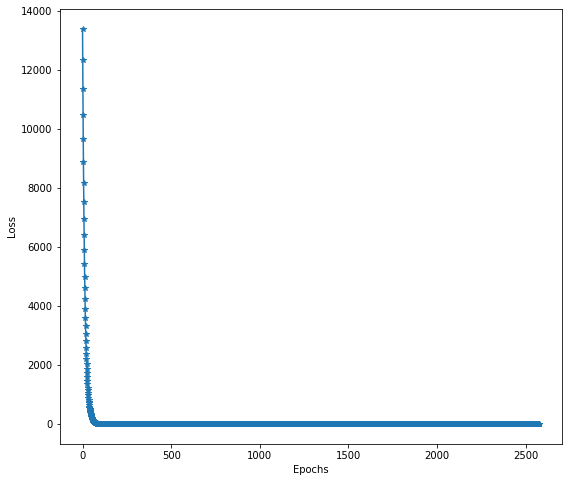

In [128]:
plt.figure(figsize=(9,8))
plt.plot(loss,'*-')
plt.xlabel('Epochs')
plt.ylabel('Loss')

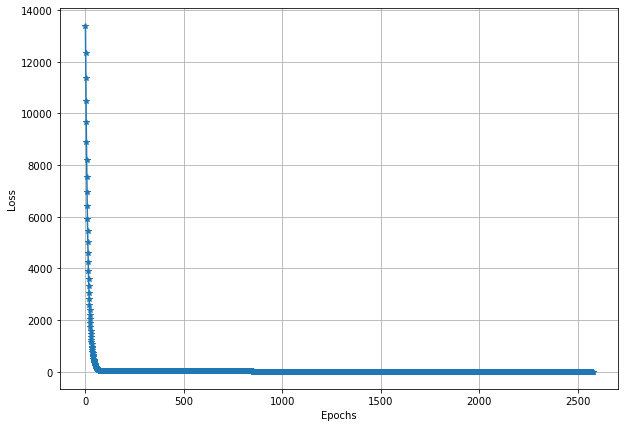

#### Use R2 score to evaluate LR equation output

In [130]:
r2_score(y2, h)

0.9890065057519923

0.9890065057519923